## Comienzo

### Comprensión del problema

#### Objetivo general

Desarrollar un sistema inteligente capaz de detectar y proponer soluciones a errores en datos de cronometraje deportivo, aprendiendo de la corecciones (issues) realizadas manualmente por cronometradores en distintas carreras y de los tiempos que estos mismos atletas hacen durante la carrera. 

#### Objetivo del análisis actual

Realizar un análisis descriptivo y exploratorio de los datasets históricos (athletes.json e issues.json) provenientes de diferentes competiciones (deportes como ciclismo o running) para comprender la estructura de los datos, su calidad, las relaciones entre variables y los patrones asociados a los errores detectados.

#### Datos disponibles

Se tienen datos de distintas carreras, para cada carrera obtenemos un total de dos json. 

- athletes: Contiene la info. de los atletas, sus tiempos, etapas, posiciones, estados... 

- issues: registra los errores detectados durante el cronometraje y las correcciones aplicadas manualmente.

Tenemos datos de distintas carreras con distinto número de atletas, etapas y deportes.

En pasos siguientes analizaremos la estructura de cada uno de los json

#### Variables importantes

Como variables importantes las tenemos en varios grupos:

- Temporales: tiempos por etapa, timestamp de detección/corrección, duración entre controles.

- Categóricas: tipo de error, estado del atleta, deporte, categoría de edad, sexo.

- Numéricas: tiempos totales, diferencias entre splits, número de issues por atleta.

- Relacionales: vinculación entre el atleta afectado y el issue correspondiente.

#### Resultados esperados

- Comprender la estructura jerárquica y variabilidad entre carreras.

- Cuantificar la calidad de los datos y los tipos de errores más frecuentes.

- Detectar patrones espaciales o temporales en los issues.

- Evaluar la posibilidad de reconstruir el “antes y después” de una corrección.

- Generar una base sólida para la creación futura de modelos predictivos.

## Análisis descriptivo y carga de datos

### Carga y comprobaciones iniciales

Como primera parte vamos a cargar los datos necesarios que vamos a reescructurar y analizar. Son datos de varias carreras de distintos tipos, organizados en archivos json como antes adelantábamos, en athletes e issues. 

In [1]:
import pandas as pd
import unidecode
import json
from pathlib import Path
import uuid
import numpy as np
import re
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import Levenshtein
from scipy import stats
from collections import deque
from Levenshtein import distance as levenshtein_distance
from itertools import combinations
from collections import Counter
import plotly.express as px
import plotly.graph_objects as go
import warnings
from scipy.stats import chi2_contingency, ttest_ind, mannwhitneyu, fisher_exact
from sklearn.linear_model import LogisticRegression
from scipy.cluster.hierarchy import linkage, dendrogram


pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

data_dir = r"C:\Users\mario\Desktop\MasterCienciadeDatos\TFM\TFM_MarioSoto\raiz\datos\historicos\datos"

#### Análisis estructural

Los datos que vamos a estudiar vienen dados en dos archivos json por carrera como comentábamos antes, uno para los datos de atletas (athletes) y otro para los problemas que ocurren en carrera (issues). Estos archivos están compùestos estructuralmente de maneras distintas, tanto cadauno por separado como para cada carrera, teniendo campos distintos en algunos casos. Vamos a definir de forma ganeral lo que se encuentra dentro de cada uno. 

- athletes (list[dict]): Es el archivo que tiene la información de los atletas y viene ordenados en dos niveles principales.

- - Nivel 1: La estructura principal es una lista (list) de diccionarios (dict), donde cada diccionario representa un atleta. Cada diccionario contiene campos simples como id (int | str), name (str), surname (str), gender (str), nationality (str), birthdate (str | None), user_id (int | None), importID (str | None), featured (bool | None) y otros campos administrativos o personales (str | int | bool | None).

- - Nivel 2: Dentro de cada diccionario de atleta, el campo events es un diccionario (dict) que funciona como una lista implícita, donde cada clave representa un evento distinto en el que participa el atleta. Cada valor es un diccionario (dict) que contiene información detallada sobre ese evento.

- - Nivel 3: Dentro de cada evento, encontramos varios bloques funcionales: campos de identificación y metadatos (event (str), dorsal (int | str), chip (list[str]), team (str), team_type (list | dict), category (str), attributes (dict[str, str | list[str]])), tiempos principales (gunTime (float | None), startTime (float | None), netTime (float | None), rawTime (float | None)), información de control (issuesCount (dict[str, int]), splitsMissing (int)), y bloques complejos como times (dict[str, dict]), rankings (dict[str, dict]), leader (dict[str, float | str]), calculatedTimes (dict[str, dict[str, float]]), commentatorTimes (dict[str, float | None]), backups (dict[str, dict[str, float | str]]), custom-rankings (list[dict]), commentator (dict[str, str | float | int]) y penalties (list[dict]).

- - Nivel 4: Dentro del bloque times, cada punto de control como "Salida", "5K", "10K", "15K", "19K" y "Meta" es un diccionario (dict) con campos simples (time (float | None), split (int | None), order (int | None), raw (dict), average (float | None), weight (float | None), incidence (bool | None), isBackup (bool | None), offset (float | None) y location (str | None)).

- - Nivel 5: Dentro de raw (subdiccionario de cada punto de control), se guardan los datos originales del dispositivo (chip (str), device (str), time (float | str), valid (bool), manual (bool | list[bool]), times (dict[str, float | None]), offset (float | None), type (str), originalTime (float | None), rawTime (float | None), id (str | int), isBackup (bool | None), backupOffset (float | None) y otros metadatos).

- issues: Es un archivo más simple (es una lista de elementos) y además suele ser más homogéneo entre carreras, ya que el software para crearlo es el mismo. También contiene varios niveles

- - Nivel 1: La estructura principal es una lista (list) de diccionarios (dict), donde cada diccionario representa un registro asociado a un atleta. Cada registro contiene campos simples como id (int | str), type (str), time (float | str | None), athlete_id (int), priority (int | None), collection (str) y event (str).

- - Nivel 2: Dentro de cada registro, el campo data es un diccionario (dict) que contiene información detallada del atleta y su participación. Aquí encontramos datos planos como document (str), Licencia (str | None), statusNote (str | None), birthdate (str | None), club (str | None), TIEMPO ESTIMADO (float | str | None), name (str), surname (str) y gender (str), además de la lista nationality (list[str]).

- - Nivel 3: Dentro de data, el campo events es un diccionario (dict) que funciona como lista implícita ("[]"), donde cada elemento representa un evento o participación específica del atleta. Cada evento es un diccionario (dict) con campos como gunTimeModeConfig (dict con wave (str | int)), gunTime (float | None), status (str), auto_category (bool | None), category (str), dorsal (int | str), chip (list[str]), auto_chip (bool | None) y attributes (dict[str, bool]).

- - Nivel 3: Dentro de data, el campo events es un diccionario (dict) que funciona como lista implícita ("[]"), donde cada elemento representa un evento o participación específica del atleta. Cada evento es un diccionario (dict) con campos como gunTimeModeConfig (dict con wave (str | int)), gunTime (float | None), status (str), auto_category (bool | None), category (str), dorsal (int | str), chip (list[str]), auto_chip (bool | None) y attributes (dict[str, bool]).

- - Los subniveles más internos incluyen configuraciones específicas (gunTimeModeConfig) y atributos especiales (attributes), que son diccionarios (dict) con valores simples (bool | str | int). Esta estructura organiza jerárquicamente los datos del atleta, sus eventos y los tiempos registrados, con una profundidad de aproximadamente cuatro a cinco niveles

Para más información se puede consultar el glosario de términos

#### Normalización estructural

Ok, una vez conocemos los datos de los que disponemos y su estructura, pasamos a normalizar los datos con un opbejtico firme: **Transformar los datos en crudo a dataframes** para poder estudiarlos de mejor forma

El modelo propuesto es un modelo de tablas relacionales extraídas de athletes e issues, que tendrán claves y relaciones entre sí para poder estudiarlas de forma conjunta. Se usarán para cada tabla todas las carreras que se tengan disponibles. 

Explicamos el modelo de tablas relacionales:

- *athletes_df*: **Datos generales de los atletas**. En esta tabla se almacenan los datos personales y fijos de cada atleta, como nombre, apellidos, género, club, nacionalidad o fecha de nacimiento. (PK: athlete_id, Relaciones: [1:N] con athletes_events_df)

- *athletes_events_df*: **Datos de los eventos en los que participa el atleta**. Contiene la información específica del atleta en un evento concreto: dorsal, chip, categoría, estado, tipo de carrera, oleada, etc. (PK: event_id*, FK: athlete_id [N:1], Relaciones: [1:N] con athletes_time_df, athletes_rankings_df, athletes_commentator_df y athletes_backups_df)

- *athletes_time_df*: **Datos de tiempos y splits en cada evento**. Registra los tiempos cronometrados de cada atleta en los diferentes puntos de control (splits) de la carrera, como 5K, 10K, 15K o Meta. Incluye tiempos oficiales, netos, brutos y promedios. (PK: time_id*, FK: athlete_id [N:1], event_id [N:1], Relaciones: [1:1] con athletes_rankings_df, [1:N] con athletes_backups_df y [1:0..1] con athletes_commentator_df)

- *athletes_rankings_df*: **Datos de clasificación o ranking del atleta**. Contiene las posiciones obtenidas por el atleta en cada split, tanto generales como por categoría. Se calculan a partir de los tiempos de la tabla de tiempos. (PK: ranking_id*, FK: athlete_id [N:1], event_id [N:1], Relaciones: [1:1] con athletes_time_df)

- *athletes_commentator_df*: **Información de los comentaristas de la carrera**. Almacena los datos observados o comunicados por los comentaristas, incluyendo nombre del comentarista, tiempo registrado manualmente, posición general y posición por categoría del atleta. (PK: commentator_id*, FK: athlete_id [N:1], event_id [N:1], Relaciones: [0..1:1] con athletes_time_df)

- *athletes_backups_df*: **Datos de respaldo de tiempos (backups)**. Contiene los registros alternativos o backups físicos tomados desde dispositivos secundarios. Permite contrastar los tiempos oficiales y reconstruir resultados en caso de fallos. (PK: backup_id*, FK: athlete_id [N:1], event_id [N:1], Relaciones: [N:1] con athletes_time_df)

- *athletes_locations_df*: **Datos geoespaciales o puntos de control de cronometraje**. Registra la información de localización de los puntos de medición: coordenadas GPS, nombre del punto, tipo de control o distancia asociada. Permite mapear los tiempos con ubicaciones físicas.
(PK: location_id, FK: event_id [N:1], Relaciones: [N:1] con athletes_time_df)*

- *athletes_event_chips_df*: **Asociación entre atleta y chips utilizados en el evento**. Registra los identificadores de chips electrónicos asignados a cada atleta (uno o varios por evento), lo que permite vincular los registros de tiempo con los dispositivos.
(PK: chip_id, FK: athlete_id [N:1], event_id [N:1])*

- *athletes_custom_rankings_df*: **Clasificaciones personalizadas**. Contiene rankings adicionales definidos por la organización o personalizados para grupos concretos (por ejemplo, equipos, género, categoría o club). Puede incluir nombres y valores de ranking específicos.
(PK: custom_ranking_id, FK: athlete_id [N:1], event_id [N:1])*

- *athletes_penalties_df*: **Penalizaciones o sanciones aplicadas a los atletas**. Registra información sobre penalizaciones impuestas durante el evento, incluyendo tiempo añadido, motivos, juez responsable o tipo de sanción.
(PK: penalty_id, FK: athlete_id [N:1], event_id [N:1])*

- *athletes_team_type_df*: **Información del tipo de equipo o modalidad del atleta**. Define si el atleta participa como parte de un equipo, en modalidad individual, en relevos o en otro formato definido por la organización.
(PK: team_type_id, FK: athlete_id [N:1], event_id [N:1])*

- *issues_df*: **Datos generales de los issues**. Contiene información básica de cada issue, como tipo, timestamp, prioridad y colección. (PK: issue_id, FK: athlete_id [N:1] a athletes_df, Relaciones: [1:N] con issues_events_df, issues_times_df, issues_attributes_df y issues_chips_df)

- *issues_data_df*: **Datos de las modificaciones de datos descriptivos del atleta**. 

- *issues_events_df*: **Eventos asociados a cada issue**. Contiene los eventos afectados por un issue, incluyendo gunTime, wave y demás campos propios del evento. (PK: issue_id + event_index, FK: issue_id [N:1] a issues_df, athlete_id [N:1] a athletes_df, Relaciones: [1:N] con issues_times_df, issues_attributes_df y issues_chips_df)

- *issues_times_df*: **Tiempos y splits registrados dentro de un evento de un issue**. Guarda los tiempos en cada punto de control (splits) afectados por el issue. (PK: issue_id + event_index + split, FK: issue_id [N:1] a issues_df, athlete_id [N:1] a athletes_df, event_index [N:1] a issues_events_df, Relaciones: [0..N:1] con issues_events_df)

- *issues_attributes_df*: **Atributos específicos de un evento dentro de un issue**. Contiene atributos como “Discapacitado visual”, “Sillas” o “Discapacitado intelectual” y sus valores, asociados a un evento afectado por el issue. (PK: issue_id + event_index + attribute, FK: issue_id [N:1] a issues_df, athlete_id [N:1] a athletes_df, event_index [N:1] a issues_events_df, Relaciones: [0..N:1] con issues_events_df)

- *issues_chips_df*: **Chips asociados a un evento dentro de un issue**. Guarda los chips afectados por un issue en cada evento. (PK: issue_id + event_index + chip, FK: issue_id [N:1] a issues_df, athlete_id [N:1] a athletes_df, event_index [N:1] a issues_events_df, Relaciones: [0..N:1] con issues_events_df)

#### Esquema

#### Estructura de Datos de Carreras y Atletas

El sistema de datos está organizado jerárquicamente para reflejar carreras, atletas, eventos y los distintos registros asociados. Se describe a continuación de forma detallada:

1. `races`
- Tabla principal que contiene información de cada carrera.
- **PK:** `race_id`
- Relaciona con los atletas y sus issues.
- Otros campos planos: metadatos de la carrera.

2. `athletes_df` (1:N desde `races`)
- Contiene los atletas inscritos en cada carrera.
- **PK:** `athlete_id`
- **FK:** `race_id` → `races.race_id`
- Sub-tablas relacionadas:

2.1 `athletes_events_df` (1:N desde `athletes_df`)
- Registra los eventos de cada atleta dentro de la carrera.
- **PK:** `event_id`
- **FK:** `athlete_id` → `athletes_df.athlete_id`, `race_id` → `races.race_id`
- Sub-tablas relacionadas:

2.1.1 `athletes_time_df` (1:N desde `athletes_events_df`)
- Tiempos de cada atleta por split.
- **FK:** `athlete_id`, `event_id`
- **PK parcial:** `split`

2.1.2 `athletes_rankings_df` (1:N)
- Clasificaciones por split.
- **FK:** `athlete_id`, `event_id`
- **PK parcial:** `split`

2.1.3 `athletes_commentator_df` (0..N:1)
- Tiempos usados por el comentarista.
- **FK:** `athlete_id`, `event_id`
- **PK parcial:** `split`

2.1.4 `athletes_backups_df` (1:N)
- Backups de tiempos por split.
- **FK:** `athlete_id`, `event_id`
- **PK parcial:** `split`

2.1.5 `athletes_locations_df` (1:N)
- Ubicaciones del atleta por split.
- **FK:** `athlete_id`, `event_id`

2.1.6 `athletes_event_chips_df` (1:N)
- Chips asignados a cada evento del atleta.
- **FK:** `athlete_id`, `event_id`
- Campos: `chip`

2.1.7 `athletes_custom_rankings_df` (1:N)
- Rankings personalizados por evento.
- **FK:** `athlete_id`, `event_id`
- Campos: `ranking_name`, `ranking_value`

2.1.8 `athletes_penalties_df` (0..N:1)
- Penalizaciones asociadas al atleta por evento.
- **FK:** `athlete_id`, `event_id`

2.1.9 `athletes_team_type_df` (0..N:1)
- Tipo de equipo del atleta en cada evento.
- **FK:** `athlete_id`, `event_id`
- Campos: `team_type`

3. `issues_df` (1:N desde `athletes_df`)
- Problemas o ajustes registrados por cronometradores.
- **PK:** `issue_id`
- **FK:** `athlete_id` → `athletes_df.athlete_id`, `race_id` → `races.race_id`
- Sub-tablas relacionadas:

3.1 `issues_data_df` (1:N desde issues_df)
- Contiene los datos generales del atleta asociados al issue (todo lo que está dentro del campo "data" excepto "events").
- **FK**: issue_id → issues_df.issue_id, athlete_id → athletes_df.athlete_id, race_id → races.race_id
- Campos: prefijados con data_ (por ejemplo data_bib, data_gender, data_category, etc.)
- Sirve para comparar el estado de los datos del atleta al momento del issue.

3.2 `issues_events_df` (1:N)
- Eventos afectados por un issue.
- **FK:** `issue_id`, `athlete_id`, `race_id`
- **PK parcial:** `event_index`
- **FK:** `event_id` → `athletes_events_df.event_id`
- Sub-tablas:

3.2.1 `issues_times_df` (0..N:1)
- Ajustes de tiempo por split.
- **FK:** `issue_id`, `athlete_id`, `race_id`, `event_index`, `event_id`
- **PK parcial:** `split`

3.2.2 `issues_attributes_df` (0..N:1)
- Atributos modificados por el issue.
- **FK:** `issue_id`, `athlete_id`, `race_id`, `event_index`, `event_id`
- Campos: `attribute`, `value`

3.2.3 `issues_chips_df` (0..N:1)
- Chips asociados al issue.
- **FK:** `issue_id`, `athlete_id`, `race_id`, `event_index`, `event_id`
- Campos: `chip`

- Otros campos planos del issue: información adicional de contexto o metadatos.



#### Justificación de la Separación de DataFrames

**Complejidad del JSON**

El JSON de atletas es jerárquico y muy anidado y contiene información de cada atleta, eventos, splits, rankings, backups y otros datos complementarios.  
Si tratáramos de aplanarlo en una sola tabla, generaríamos muchísima duplicación de datos (el mismo atleta repetido por cada split o evento) y un número enorme de columnas, difícil de manejar y propenso a errores.


**Normalización de la información**

Se decidió aplicar un principio de normalización, similar al de bases de datos relacionales, separando cada tipo de entidad en su propio df:


**Ventajas**

1. **Evita duplicación de datos:**
2. **Escalable:** soporta múltiples atletas, eventos y carreras sin cambiar la estructura.  
3. **Modulable:** La información se procesa de forma conjunta o separada  
4. Los cambios pueden más fácil de aplicar  
5. Se pueden realizar joins/consultas de manera sencilla.


Ahora que ya sabemos las tablas que vamos a usar pasamos a transformar los datos que tenemos en formato .json en dataframes que poder estudiar y analizar

#### Cambio de estructura

In [4]:
def flatten_dict(d, parent_key='', sep='_'):
    
    items = []  # se guardan las tuplas (clave, valor)
    for k, v in d.items():  # Iteramos sobre cada clave y valor del diccionario
        # si hay clave padre, se concatena; si no, se usa la clave tal cual
        new_key = f"{parent_key}{sep}{k}" if parent_key else k
        if isinstance(v, dict):  # si el valor es otro diccionario
            # llamada recursiva aplanar el hijo
            items.extend(flatten_dict(v, new_key, sep=sep).items())
        else:
            # si no es diccionario, lo agregamos a la lista
            items.append((new_key, v))
    return dict(items)


def parse_athletes_json(data):
    
    athletes_rows, events_rows, times_rows = [], [], []
    rankings_rows, commentator_rows, backups_rows = [], [], []
    locations_rows, chips_rows, custom_rankings_rows = [], [], []
    penalties_rows, team_type_rows = [], []

    # iteramos sobre cada atleta
    for athlete in data:
        athlete_id = athlete.get("id")

        # aplanamos el diccionario del atleta, excluyendo "events" por que la tratamos mas tarde
        athlete_flat = flatten_dict({k: v for k, v in athlete.items() if k != "events"})
        athlete_flat["athlete_id"] = athlete_id  # id para referencia
        athletes_rows.append(athlete_flat)  #lo añadimos

        # ahora iteramos eventos
        for event in athlete.get("events", []):
            # id para evento
            event_id = event.get("event") or event.get("id") or f"{athlete_id}_{len(events_rows)}"
            
            # aplanamos los datos de eventos y evadimos subentidades complejas 
            event_flat = flatten_dict({
                k: v for k, v in event.items()
                if k not in ["times", "rankings", "commentator", "backups",
                             "locations", "chip", "custom-rankings",
                             "penalties", "team_type"]
            })
            # añadimos referencias al atleta y al evento
            event_flat.update({"athlete_id": athlete_id, "event_id": event_id})
            events_rows.append(event_flat)

            # splits
            for split_name, split_data in event.get("times", {}).items():
                time_flat = flatten_dict(split_data)  #aplnamos splits
                # mismo de antes
                time_flat.update({"athlete_id": athlete_id, "event_id": event_id, "split": split_name})
                times_rows.append(time_flat)

            # rankings
            for split_name, ranking_data in event.get("rankings", {}).items():
                rank_flat = flatten_dict(ranking_data)
                rank_flat.update({"athlete_id": athlete_id, "event_id": event_id, "split": split_name})
                rankings_rows.append(rank_flat)

            # commentator
            for key, value in event.get("commentator", {}).items():
                if "_" in key:  # separa el split del nombre del campo
                    split, field = key.split("_", 1)
                    commentator_rows.append({
                        "athlete_id": athlete_id,
                        "event_id": event_id,
                        "split": split,
                        field: value
                    })

            # backups
            for split_name, backup_data in event.get("backups", {}).items():
                backup_flat = flatten_dict(backup_data)
                backup_flat.update({"athlete_id": athlete_id, "event_id": event_id, "split": split_name})
                backups_rows.append(backup_flat)

            # localizaciones
            for loc in event.get("locations", []):
                loc_flat = flatten_dict(loc)
                loc_flat.update({"athlete_id": athlete_id, "event_id": event_id})
                locations_rows.append(loc_flat)

            # chips
            for chip in event.get("chip", []):
                chips_rows.append({"athlete_id": athlete_id, "event_id": event_id, "chip": chip})

            # rankings
            custom_rankings = event.get("custom-rankings", {})
            if isinstance(custom_rankings, dict):
                for key, val in custom_rankings.items():
                    custom_rankings_rows.append({
                        "athlete_id": athlete_id,
                        "event_id": event_id,
                        "ranking_name": key,
                        "ranking_value": val
                    })
            elif isinstance(custom_rankings, list):
                for item in custom_rankings:
                    if isinstance(item, dict):
                        custom_rankings_rows.append({
                            "athlete_id": athlete_id,
                            "event_id": event_id,
                            **flatten_dict(item)
                        })
                    else:
                        custom_rankings_rows.append({
                            "athlete_id": athlete_id,
                            "event_id": event_id,
                            "ranking_value": item
                        })

            # penalizaciones
            for pen in event.get("penalties", []):
                pen_flat = flatten_dict(pen)
                pen_flat.update({"athlete_id": athlete_id, "event_id": event_id})
                penalties_rows.append(pen_flat)

            # tipos de equipo
            for t in event.get("team_type", []):
                team_type_rows.append({"athlete_id": athlete_id, "event_id": event_id, "team_type": t})

    return {
        "athletes_df": pd.DataFrame(athletes_rows),
        "athletes_events_df": pd.DataFrame(events_rows),
        "athletes_time_df": pd.DataFrame(times_rows),
        "athletes_rankings_df": pd.DataFrame(rankings_rows),
        "athletes_commentator_df": pd.DataFrame(commentator_rows),
        "athletes_backups_df": pd.DataFrame(backups_rows),
        "athletes_locations_df": pd.DataFrame(locations_rows),
        "athletes_event_chips_df": pd.DataFrame(chips_rows),
        "athletes_custom_rankings_df": pd.DataFrame(custom_rankings_rows),
        "athletes_penalties_df": pd.DataFrame(penalties_rows),
        "athletes_team_type_df": pd.DataFrame(team_type_rows)
    }


def parse_issues_json_flat(data):
    issues_rows, issues_data_rows = [], []
    events_rows, times_rows = [], []
    attributes_rows, chips_rows = [], []

    # Aplanar posibles listas dentro de data
    flat_issues = []
    for sublist in data:
        if isinstance(sublist, list):
            flat_issues.extend(sublist)
        else:
            flat_issues.append(sublist)

    # --- Detectar todas las claves posibles dentro de data.events ---
    all_event_keys = set()
    for issue in flat_issues:
        athlete_data = issue.get("data", {})
        for event_val in athlete_data.get("events", []):
            flat = flatten_dict(event_val)
            all_event_keys.update({f"data_events_{k}" for k in flat.keys()})

    # --- Procesar cada issue ---
    for issue in flat_issues:
        if not isinstance(issue, dict):
            continue

        issue_id = issue.get("id")
        athlete_data = issue.get("data", {})
        athlete_id = issue.get("athlete_id") or athlete_data.get("id")

        # ============================
        # NUEVO: event_id_issue FINAL
        # ============================
        event_id_issue = issue.get("event", "independiente")
        # ============================

        # --- 1) issues_df (general) ---
        general = {k: v for k, v in issue.items() if k != "data"}
        general.update({
            "issue_id": issue_id,
            "athlete_id": athlete_id,
            "event_id": event_id_issue
        })
        issues_rows.append(general)

        # --- 2) issues_data_df ---
        data_gen = {f"data_{k}": v for k, v in athlete_data.items() if k != "events"}
        data_gen.update({
            "issue_id": issue_id,
            "athlete_id": athlete_id,
            "event_id": event_id_issue
        })
        issues_data_rows.append(data_gen)

        # --- 3) issues_events_df ---
        for idx, event_val in enumerate(athlete_data.get("events", [])):
            flat = flatten_dict(event_val)
            flat_prefixed = {f"data_events_{k}": v for k, v in flat.items()}

            complete_event = {k: flat_prefixed.get(k, "") for k in all_event_keys}
            complete_event.update({
                "issue_id": issue_id,
                "athlete_id": athlete_id,
                "event_index": idx,
                "event_id": event_id_issue
            })
            events_rows.append(complete_event)

            # --- 4) issues_times_df ---
            for split_name, split_data in event_val.get("times", {}).items():
                time_flat = flatten_dict(split_data)
                time_flat.update({
                    "issue_id": issue_id,
                    "athlete_id": athlete_id,
                    "event_index": idx,
                    "event_id": event_id_issue,
                    "split": split_name
                })
                times_rows.append(time_flat)

            # --- 5) issues_attributes_df ---
            for attr_key, attr_val in event_val.get("attributes", {}).items():
                attributes_rows.append({
                    "issue_id": issue_id,
                    "athlete_id": athlete_id,
                    "event_index": idx,
                    "event_id": event_id_issue,
                    "attribute": attr_key,
                    "value": attr_val
                })

            # --- 6) issues_chips_df ---
            for chip in event_val.get("chip", []):
                chips_rows.append({
                    "issue_id": issue_id,
                    "athlete_id": athlete_id,
                    "event_index": idx,
                    "event_id": event_id_issue,
                    "chip": chip
                })

    # --- Convertir a DataFrames ---
    return {
        "issues_df": pd.DataFrame(issues_rows),
        "issues_data_df": pd.DataFrame(issues_data_rows),
        "issues_events_df": pd.DataFrame(events_rows),
        "issues_times_df": pd.DataFrame(times_rows),
        "issues_attributes_df": pd.DataFrame(attributes_rows),
        "issues_chips_df": pd.DataFrame(chips_rows)
    }



def load_all_json(folder_path):
    folder = Path(folder_path)
    races_file = Path(r"C:\Users\mario\Desktop\MasterCienciadeDatos\TFM\TFM_MarioSoto\raiz\datos\historicos\races\races.json")
    races_file.parent.mkdir(parents=True, exist_ok=True)

    # si hay archivo de races, se carga
    races = []
    if races_file.exists():
        with open(races_file, "r", encoding="utf-8") as f:
            races = json.load(f)

    # Mapa nombre carrera -> race_id
    race_map = {r["race_name"].lower(): r["race_id"] for r in races}

    combined = {
        "athletes_df": [], "athletes_events_df": [], "athletes_time_df": [],
        "athletes_rankings_df": [], "athletes_commentator_df": [], "athletes_backups_df": [],
        "athletes_locations_df": [], "athletes_event_chips_df": [],
        "athletes_custom_rankings_df": [], "athletes_penalties_df": [], "athletes_team_type_df": [],
        "issues_df": [], "issues_data_df": [], "issues_events_df": [], "issues_times_df": [],
        "issues_attributes_df": [], "issues_chips_df": []
    }

    # --- Procesar archivos de atletas ---
    for file in folder.glob("*athletes*.json"):
        race_name = file.stem.replace("athletes_", "").replace(".athletes", "").replace(".issues", "").lower()
        if race_name not in race_map:
            race_id = str(uuid.uuid4())
            race_map[race_name] = race_id
            races.append({"race_id": race_id, "race_name": race_name})
        else:
            race_id = race_map[race_name]

        with open(file, "r", encoding="utf-8") as f:
            data = json.load(f)

        dfs = parse_athletes_json(data)
        for name, df in dfs.items():
            if not df.empty:
                df["race_id"] = race_id
            combined[name].append(df)

    # --- Procesar archivos de issues ---
    for file in folder.glob("*issues*.json"):
        race_name = file.stem.replace("issues_", "").replace(".athletes", "").replace(".issues", "").lower()
        race_id = race_map.get(race_name)
        if race_id is None:
            print(f"No se encontró race_id para {race_name}, saltando...")
            continue

        with open(file, "r", encoding="utf-8") as f:
            data = json.load(f)

        dfs = parse_issues_json_flat(data)
        for name, df in dfs.items():
            if not df.empty:
                df["race_id"] = race_id
            combined[name].append(df)

    # --- Guardar races.json ---
    with open(races_file, "w", encoding="utf-8") as f:
        json.dump(races, f, indent=4, ensure_ascii=False)

    # --- Concatenar y limpiar ---
    result = {}
    for name, dfs_list in combined.items():
        if dfs_list:
            df_concat = pd.concat(dfs_list, ignore_index=True, sort=True)
            
            # --- Fix específico para event_id_issue ---
            if "event_id" in df_concat.columns:
                # Convertimos toda la columna a string, reemplazando None o dict/list por "independiente"
                df_concat["event_id"] = df_concat["event_id"].apply(
                    lambda x: str(x) if isinstance(x, str) else "independiente"
                )
            
            # Eliminamos sólo las columnas complejas que NO sean event_id_issue
            complex_cols = [
                col for col in df_concat.columns
                if col != "event_id" and df_concat[col].apply(lambda x: isinstance(x, (dict, list))).any()
            ]
            df_clean = df_concat.drop(columns=complex_cols, errors='ignore')
            result[name] = df_clean
        else:
            result[name] = pd.DataFrame()


    # simplemente aseguramos que existan y los dejamos tal cual
    for name in [
        "issues_df", "issues_data_df", "issues_events_df",
        "issues_times_df", "issues_attributes_df", "issues_chips_df"
    ]:
        if name in result and not result[name].empty:
            # NO MERGE — NO HACEMOS NADA
            result[name] = result[name]

    print(f"Se procesaron {len(races)} carreras. races.json actualizado en {races_file}")
    return result, pd.DataFrame(races)


In [5]:
dfs, races_df = load_all_json(data_dir)
copia = dfs.copy()

No se encontró race_id para athlete_159_issues, saltando...
No se encontró race_id para athlete_l6554352_issues, saltando...
No se encontró race_id para atleta_l6554352_issues, saltando...
No se encontró race_id para af4215f0-e856-11ef-aee0-f3683f511a40, saltando...
Se procesaron 4 carreras. races.json actualizado en C:\Users\mario\Desktop\MasterCienciadeDatos\TFM\TFM_MarioSoto\raiz\datos\historicos\races\races.json


Ahora que tenemos la carrera vamos a quedarnos con los dfs que nos interesan, ya que son los que tienen las variables que vamos a usar para nuestro cometido

In [6]:
nombres_dfs = [
    "athletes_df",
    "athletes_events_df",
    "athletes_time_df",
    "issues_df",
    "issues_data_df",
    "issues_events_df",
    "issues_times_df"
]

dfs_filtrados = {k: v for k, v in copia.items() if k in nombres_dfs}

In [9]:
athletes_df = dfs_filtrados.get("athletes_df")
athletes_events_df = dfs_filtrados.get("athletes_events_df")
athletes_time_df = dfs_filtrados.get("athletes_time_df")
issues_df = dfs_filtrados.get("issues_df")
issues_data_df = dfs_filtrados.get("issues_data_df")
issues_events_df = dfs_filtrados.get("issues_events_df")
issues_times_df = dfs_filtrados.get("issues_times_df")

NameError: name 'dfs_filtrados' is not defined

In [8]:
dfs = dfs_filtrados

In [21]:
dfs['athletes_events_df']['event_id'].unique()

array(['Mitja', 'Mitja cadires', 'Stage 1', 'Stage 2', 'Stage 3',
       'Stage 4', 'Stage 5', 'Stage 6', 'General Ranking',
       'Medio Maratón', 'Carrera Profuturo', 'Medio Maratón ponderada',
       'Marato', 'Cadires'], dtype=object)

In [22]:
dfs['issues_df']['event_id'].unique()

array(['independiente', 'Mitja', 'General Ranking', 'Stage 1', 'Stage 2',
       'Stage 3', 'Stage 4', 'Stage 5', 'Stage 6', 'Medio Maratón',
       'Carrera Profuturo'], dtype=object)

In [23]:
for name, df in dfs.items():
    print(f"{name}: {len(df)} filas")

athletes_df: 106905 filas
athletes_events_df: 109642 filas
athletes_time_df: 558466 filas
issues_df: 537970 filas
issues_data_df: 537970 filas
issues_events_df: 401376 filas
issues_times_df: 366 filas


### Comprobación datos de tiempo

Queremos comprobar la escala de los datos temporales, ya que será clave para la conversión de los mismos para su tratamiento y análisis

In [ ]:
def sugerir_conversion_global(dic_dfs, id_col='race_id'):
    """
    Para cada carrera (race_id) en todos los DataFrames del diccionario,
    calcula el número máximo de dígitos de cualquier columna numérica 
    y sugiere conversión a ms o ns según tenga <16 o >=16 dígitos.
    """
    max_digitos_por_race = {}

    for nombre_df, df in dic_dfs.items():
        if df.empty or id_col not in df.columns:
            continue
        
        numericos = df.select_dtypes(include=[np.number])
        if numericos.empty:
            continue

        for race_id, grupo in df.groupby(id_col):
            max_digitos = 0
            for col in numericos.columns:
                serie = grupo[col].dropna().abs().astype(np.int64)
                if not serie.empty:
                    max_col = serie.astype(str).str.len().max()
                    if max_col > max_digitos:
                        max_digitos = max_col
            if race_id in max_digitos_por_race:
                max_digitos_por_race[race_id] = max(max_digitos_por_race[race_id], max_digitos)
            else:
                max_digitos_por_race[race_id] = max_digitos

    resultados = []
    for race_id, max_dig in max_digitos_por_race.items():
        sugerencia = 'ms' if max_dig < 16 else 'ns'
        resultados.append({
            'race_id': race_id,
            'max_digitos': max_dig,
            'sugerencia': sugerencia
        })

    return pd.DataFrame(resultados)

# Uso
conversion_df = sugerir_conversion_global(copia)
print(conversion_df)

                                race_id  max_digitos sugerencia
0  1a83229e-2547-42a3-b5b4-36c7425c4d8f           13         ms
1  331e7589-6440-4968-9b44-484ba589824e           13         ms
2  cf6f71f2-1235-45e3-802e-02833b71ae8b           13         ms


Podemos ver que los valores más altos para el tiempo no pasan de 14/15 dígitos, por lo que sospechamos que su timestamp se expresa en milisegundos

Vemos que justo esta en el año en el que empiez la carrera, todo se pasa a milisegundos. Probablemente sea algo típico en todas las carreras.

También sospechamos que algunas variables son la misma o con valores muy similares

#### Variables iguales en teoría

| Columna 1         | Columna 2          
| ----------------- | ------------------ 
| originalTime      | raw_times_official
| originalTime      | raw_times_real     
| raw_backupOffset  | offset             
| raw_times_rawTime | raw_rawTime      
| rawTime           | raw_rawTime        
| raw_originalTime  | raw_times_rawTime  

Esto nos ayudará a detectar variables redundantes

### Resumen detallado de todo el flujo de limpieza y análisis de DataFrames


Aquí detallaremos la limpieza de los datos a realizar para poder para poder pasa al descriptivo y al AED



#### 1. Revisión de columnas con datos complejos
- Se itera sobre cada DataFrame dentro de un diccionario de DataFrames.
- Si un DataFrame está vacío:
  - Se indica que está vacío y se pasa al siguiente.
- Para cada columna del DataFrame:
  - Se toma la primera fila no nula como muestra representativa.
  - Si el valor es una lista o un diccionario:
    - Se considera que la columna contiene datos complejos.
- Al finalizar cada DataFrame:
  - Se imprime un listado de columnas complejas si existen.
  - Si no hay columnas complejas, se indica que todos los campos son simples.

---

#### 2. Resumen numérico básico de los datos
- Se verifica la existencia de los DataFrames relevantes (por ejemplo, atletas e issues).
- Se cuentan elementos únicos importantes:
  - Número de carreras únicas. 
  - Número de atletas únicos. (por carrera)
  - Número de issues únicos. (por carrera)
- Si algún DataFrame está vacío, el conteo para ese conjunto se establece en cero.

---

#### 3. Conversión de columnas temporales y de duración
- Se define un conjunto de patrones de columnas que probablemente contienen información temporal.
- Se identifican formatos de fechas y datetime estándar con expresiones regulares.
- Para cada DataFrame:
  - Se ignoran los vacíos.
  - Para cada columna:
    - Se convierte automáticamente cualquier columna explícita de fecha de nacimiento a datetime.
    - Se procesan solo columnas cuyos nombres contengan los patrones definidos.
    - Se procesan únicamente columnas de tipo numérico o texto.
    - Si la columna es texto:
      - Se detectan strings con formato ISO de fecha o datetime.
      - Se convierten a `datetime`.
    - Si la columna es numérica:
      - Se calcula el valor medio absoluto para inferir si representa milisegundos desde 1970 o duraciones.
      - Según el rango del valor:
        - Milisegundos 1970 → convertir a `datetime` con unidad ms.
        - Duraciones → convertir a `timedelta` con unidad ms. Se crea nueva columna con _td
  - Se procesan columnas especiales y sus columnas asociadas de tipo:
    - Se extraen horas y minutos de la columna `wave`.
    - Se suman al día indicado por `gunTime` para generar un datetime completo.
  - Se reasignan los DataFrames procesados en el diccionario original.

---

#### 4. Identificación y visualización de valores faltantes
- Para cada DataFrame y carrera:
  - Se genera un heatmap de valores nulos usando colores para identificar su ubicación.
  - Se imprime por consola la cantidad de valores nulos por columna.
  - Si el DataFrame está vacío, se indica que no se puede generar el heatmap.

---

#### 5. Descripción detallada de cada columna
- Para cada DataFrame y cada columna:
  - Se detectan todos los tipos de datos presentes.
  - Se cuentan los valores nulos.
  - Se cuentan los strings vacíos si la columna es de tipo texto.
  - Se muestran ejemplos generales de valores (hasta un límite definido).
  - Se generan ejemplos por tipo de dato, limitados por tipo.
- Esto permite conocer la composición exacta y variabilidad de cada columna antes de aplicar transformaciones.

---

#### 6. Homogeneización de columnas con tipos mixtos
- Se identifican columnas clave que no deben modificarse (por ejemplo, `_id` o `_index` presentes en más de un DataFrame).
- Para cada columna de cada DataFrame:
  - Se detectan los tipos de datos presentes: numérico, string, vacío, nulo, u otros.
  - Se aplica una regla especial para el ID de atletas:
    - Todos los valores se convierten a string.
  - Se protegen columnas clave o con tipos no permitidos (`otro`) para no modificarlas. (las temporales sobre todo)
  - Si la columna contiene más de un tipo de dato permitido, se aplica homogeneización según la combinación detectada:
    - Números + strings → convertir todos a strings.
    - Vacíos → convertir a NaN.
    - Nulos → convertir a strings vacíos.
    - Combinaciones mixtas → aplicar reglas combinadas de los anteriores.
  - Se genera un reporte con:
    - Columnas modificadas y la acción aplicada.
    - Columnas no modificadas y la razón de no modificación.
  - Se propaga la armonización a columnas clave en otros DataFrames si corresponde.
- Se devuelve un diccionario con:
  - DataFrames armonizados.
  - Reporte de cambios.
  - Tipos detectados por columna.

---

#### 7. Detección de duplicados
- Para cada DataFrame:
  - Si se trata de la tabla de atletas:
    - Se detectan duplicados basados en el ID de atleta.
  - Para otros DataFrames:
    - Se detectan duplicados exactos en todas las columnas.
- Se guarda información sobre:
  - Número de duplicados encontrados.
  - DataFrame con los registros duplicados.
- Se imprime un resumen del número de duplicados por DataFrame.

---

Podemos comprobar varios valores, como por ejemplo si todos los campos tienen valores complejos

In [ ]:

def check_complex_fields(result):
    for name, df in result.items():
        if df.empty:
            print(f"{name}: está vacía.")
            continue

        complex_cols = [] 

        for col in df.columns:
            sample = df[col].dropna().head(1)
            
            if not sample.empty:
                val = sample.iloc[0]
                
                if isinstance(val, (list, dict)):
                    complex_cols.append(col)

        if complex_cols:
            print(f"{name}: contiene campos complejos -> {complex_cols}")
        else:
            print(f"{name}: todos los campos son simples.")

check_complex_fields(dfs)

athletes_df: todos los campos son simples.
athletes_events_df: todos los campos son simples.
athletes_time_df: todos los campos son simples.
issues_df: todos los campos son simples.
issues_data_df: todos los campos son simples.
issues_events_df: todos los campos son simples.
issues_times_df: todos los campos son simples.


No vemos valores complejos en los dfs

In [ ]:
def resumen_por_carrera(dfs):
    athletes_df = dfs.get('athletes_df', pd.DataFrame())
    issues_df = dfs.get('issues_df', pd.DataFrame())

    if athletes_df.empty:
        print("No hay datos de atletas.")
        return

    carreras = athletes_df['race_id'].unique()

    resultados = []
    for race in carreras:
        num_atletas = athletes_df.loc[athletes_df['race_id'] == race, 'athlete_id'].nunique()
        num_issues = issues_df.loc[issues_df['race_id'] == race, 'issue_id'].nunique() if not issues_df.empty else 0
        resultados.append({
            'race_id': race,
            'num_atletas': num_atletas,
            'num_issues': num_issues
        })

    for r in resultados:
        print(f"🏁 Carrera {r['race_id']}: {r['num_atletas']} atletas, {r['num_issues']} issues")

resumen_por_carrera(dfs)

🏁 Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f: 31683 atletas, 402 issues
🏁 Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b: 456 atletas, 205 issues
🏁 Carrera ad64fc28-2968-4993-a182-f642c0310a93: 47901 atletas, 34992 issues
🏁 Carrera 331e7589-6440-4968-9b44-484ba589824e: 26865 atletas, 402 issues


Vemos que dependiendo de la carrera tenemos hay un número de atletas distinto, vemos por ejemplo que normalmente en las carreras de maratones y medias maratones suele haber un número alto de personas. También es algo a remarcar que en una de las carreras hay un número muy grande de issues, lo cuál veremos más tarde. 

In [53]:

def campos_resumen_por_carrera(dfs_dic, id_col="race_id"):
    """
    Recorre un diccionario de DataFrames y genera un resumen de columnas
    para cada DataFrame, indicando:
      - tipo, ejemplo, cardinalidad, % missing
      - en qué carreras (race_id) aparece la columna con valores no nulos
      - número de carreras donde aparece (o 'Todas' si está en todas)
    
    dfs_dic: diccionario de DataFrames
    id_col: columna que identifica la carrera
    """
    for name, df in dfs_dic.items():
        print(f"\n=== {name} ===")
        try:
            resumen = []

            if df.empty:
                print("DataFrame vacío")
                continue

            for col in df.columns:
                sample = df[col].dropna().head(1)
                ejemplo = sample.iloc[0] if not sample.empty else None
                tipo = type(ejemplo).__name__ if ejemplo is not None else "NaN"
                cardinalidad = df[col].nunique()
                missing_pct = df[col].isna().mean() * 100

                if id_col in df.columns:
                    carreras_nonnull = df.loc[df[col].notna(), id_col].unique()
                    dfs_aparece = list(carreras_nonnull)
                    total_carreras = df[id_col].nunique()
                    num_carreras = len(carreras_nonnull)
                    carreras_info = "Todas" if num_carreras == total_carreras else num_carreras
                else:
                    dfs_aparece = []
                    carreras_info = None

                resumen.append({
                    "campo": col,
                    "tipo": tipo,
                    "ejemplo": ejemplo,
                    "cardinalidad": cardinalidad,
                    "% missing": missing_pct,
                    "carreras": dfs_aparece,
                    "num_carreras": carreras_info
                })

            resumen_df = pd.DataFrame(resumen)
            display(resumen_df)

        except Exception as e:
            print(f"Error en campos_resumen para {name}: {e}")

campos_resumen_por_carrera(dfs)


=== athletes_df ===


,campo,tipo,ejemplo,cardinalidad,% missing,carreras,num_carreras
0,CATEGORY_ORIGINAL,str,,8,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
1,Código Postal,str,,28,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
2,Dorsal entregado,str,,3,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
3,Edad,float64,26.0,63,80.762359,[ad64fc28-2968-4993-a182-f642c0310a93],1
4,LEGEND TYPE,str,,4,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
5,LICENCIA,str,,2063,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
6,LICENCIA CAT,str,,1,99.974744,[331e7589-6440-4968-9b44-484ba589824e],1
7,Licencia,str,,1246,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
8,MEDALLA,str,,4,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
9,Mejora,float64,17.0,8116,80.762359,[ad64fc28-2968-4993-a182-f642c0310a93],1



=== athletes_events_df ===


,campo,tipo,ejemplo,cardinalidad,% missing,carreras,num_carreras
0,athlete_id,str,31,83657,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
1,attributes_ADVENTURE,str,,2,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
2,attributes_Camp.España,str,,2,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
3,attributes_Clasif. Campionat Catalunya,str,,3,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
4,attributes_Clasif. Campionat Catalunya Master,str,,15,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
5,attributes_Clasif. Campionat Catalunya Universitari,str,,3,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
6,attributes_Clasif. Discapacitat,str,,3,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
7,attributes_Cto de España Absoluto,str,,3,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
8,attributes_Cto de España Master,str,,16,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
9,attributes_D. Fisico/Intelectual,str,,4,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas



=== athletes_time_df ===


,campo,tipo,ejemplo,cardinalidad,% missing,carreras,num_carreras
0,athlete_id,str,31,72011,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
1,average,float64,0.0,41695,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
2,averageNet,NaN,None,0,100.000000,[],0
3,distance,int64,0,48,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
4,event_id,str,Mitja,9,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
5,incidence,bool,True,1,99.810750,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
6,isBackup,bool,True,2,99.718761,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
7,location,str,,19,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
8,net,NaN,None,0,100.000000,[],0
9,netTime,float64,0.0,465117,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas



=== issues_df ===


,campo,tipo,ejemplo,cardinalidad,% missing,carreras,num_carreras
0,athlete_id,str,L6554352,59432,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
1,collection,str,athlete,2,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
2,event_id,str,independiente,9,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
3,id,str,af4215f0-e856-11ef-aee0-f3683f511a40,35595,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
4,issue_id,str,af4215f0-e856-11ef-aee0-f3683f511a40,35595,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
5,priority,float64,2.0,2,64.265702,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
6,race_id,str,1a83229e-2547-42a3-b5b4-36c7425c4d8f,4,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
7,time,Timestamp,2025-02-11 09:00:47.695000,37970,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
8,type,str,changeRanking,6,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
9,event_std,str,independiente,3,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas



=== issues_data_df ===


,campo,tipo,ejemplo,cardinalidad,% missing,carreras,num_carreras
0,athlete_id,str,L6554352,59432,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
1,data_Dorsal entregado,str,,3,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
2,data_LICENCIA,str,,5,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
3,data_Licencia,str,,1243,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
4,data_MEDALLA,str,,2,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
5,data_TALLA,str,,16,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
6,data_TIEMPO ESTIMADO,str,,12,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
7,data_Teléfono emergencia,str,,50,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
8,data_birthdate,Timestamp,1996-11-10 00:00:00,681,99.795551,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
9,data_club,str,,44,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas



=== issues_events_df ===


,campo,tipo,ejemplo,cardinalidad,% missing,carreras,num_carreras
0,athlete_id,str,L6554352,59419,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
1,data_events_attributes_ADVENTURE,str,,2,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
2,data_events_attributes_D. Fisico/Intelectual,str,,2,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
3,data_events_attributes_Discapacitado intelectual,str,,3,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
4,data_events_attributes_Discapacitado visual,str,,3,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
5,data_events_attributes_Españoles,str,,3,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
6,data_events_attributes_Fed. AD Maratón,str,,2,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
7,data_events_attributes_Sillas,str,,2,0.000000,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
8,data_events_auto_category,bool,False,2,86.763557,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",3
9,data_events_auto_chip,bool,False,2,99.972445,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas



=== issues_times_df ===


,campo,tipo,ejemplo,cardinalidad,% missing,carreras,num_carreras
0,athlete_id,str,FB39347C,168,0.0,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
1,event_id,str,Mitja,7,0.0,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
2,event_index,int64,0,1,0.0,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
3,issue_id,str,255c8590-ec3f-11ef-a9ce-21a37501454e,213,0.0,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
4,race_id,str,1a83229e-2547-42a3-b5b4-36c7425c4d8f,4,0.0,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
5,split,str,15K,10,0.0,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
6,time,int64,2387000,193,0.0,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
7,event_std,str,media,2,0.0,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas
8,time_td,Timedelta,0 days 00:39:47,193,0.0,"[1a83229e-2547-42a3-b5b4-36c7425c4d8f, cf6f71f2-1235-45e3-802e-02833b71ae8b, ad64fc28-2968-4993-a182-f642c0310a93, 331e7589-6440-4968-9b44-484ba589824e]",Todas


Podemos ver que en la parte de la información de los atletas más general, vemos que cada uno de los campos esta más o menos establecido de manera ordenada, podemos ver como la mayoría de campos de tipo string, indicando que la mayoría de estos datos van a tratarse en forma de cadena, incluso siendo algunos id, pero que contienen letras y números. 

También vemos como en la cardinalidad hay datos básicos como que hay un número igual de atletas a los registros del dataframe, lo cual es lógico. En el lado de los datos perdidos vemos como la mayoría de los elementos no tienen muchos, pero destacan algunos como statusNote (alguna nota referente al estado del atleta). Posteriormente veremos como solucionar el problema de los missings.

Vemos como en los datos de cada evento de cada atleta hay algunas variables que también tiene muchos valores perdidos: [attributes_Discapacitado intelectual, attributes_Discapacitado visual, attributes_Sillas...], y también vemos como algunas variable podrían necesitar un cambio de tipo (gunTime a datetime, gunTimeModeConfig_wave a Tiempo tipo mm:ss, conviene transformar a segundos o timedelta) 

En el caso del dataframe de los tiempos, también vamos bastantes como casi perdidas completamente: [incidence, isbackup, location, offset, originalTime, raw_backupOffset y algunos raw mas...], además de que también vemos algunas variables con tipos a cambiar (raw_time, raw_created, raw_originaltime…). 

En resumen aprendemos de estos dataframes que hay variables que tendremos que cambiar de tipo y también columnas con muchos valores perdidos que deberemos tratar posteriormente.

Vemos a partir de este dataframe que hay algunos campos que están en algunos dataframes y otros que están en todos, que será principalmente en los que nos centraremos, ya que son campos naturales a todos los datafram,es que podremos encontrarnoslos en cualquiera. 

Por otro lado, nos fijaremos más en variables ocn un bajo porcentaje de missings, aunque también dependerá del contexto. 

### Eliminar y estandarizar eventos

En esta parte pasamos a crear una nueva columna llamada event_std, que nos servirá para estandarizar los eventos y poder analizarlos de fomea agrupada. También se eliminarán los eventos y todas sus filas dependientes que no nos vayan a servir en este caso. 

- cadires: cajones de salida (no nos incumbe aquí)
- ponderada
- ranking: para ranking general,...

In [9]:
def remove_forbidden_events(dfs: dict):
    """
    Elimina de todos los DataFrames los eventos que contengan palabras prohibidas.
    """

    FORBIDDEN_WORDS = ['cadires', 'ponderada', 'ranking', 'carrera']

    for key, df in dfs.items():
        if 'event_id' in df.columns:
            mask_valid = df['event_id'].apply(
                lambda x: isinstance(x, str) and not any(word in unidecode.unidecode(x.lower()) for word in FORBIDDEN_WORDS)
            )
            dfs[key] = df[mask_valid].reset_index(drop=True)
    return dfs

def create_event_std_column(dfs: dict):
    """
    Crea una columna 'event_std' con los eventos normalizados: 'media', 'maraton', 'stage'.
    Si el evento es 'independiente', se deja tal cual.
    Eventos que no correspondan a estas categorías se marcan como None.
    """
    def clean_event(event_name):
        if not isinstance(event_name, str):
            return None
        name = unidecode.unidecode(event_name.lower())
        if name == "independiente":
            return "independiente"
        elif 'mitja' in name or 'medio maraton' in name:
            return 'media'
        elif 'maraton' in name or 'marato' in name or 'carrera' in name:
            return 'maraton'
        elif 'stage' in name:
            return 'stage'
        else:
            return None

    for key, df in dfs.items():
        if 'event_id' in df.columns:
            df['event_std'] = df['event_id'].apply(clean_event)
            dfs[key] = df

    return dfs

In [10]:
dfs_cleaned = remove_forbidden_events(dfs)
dfs_final = create_event_std_column(dfs_cleaned)

In [11]:
dfs = dfs_final

In [27]:
dfs['issues_df']['event_id'].unique()

array(['independiente', 'Mitja', 'Stage 1', 'Stage 2', 'Stage 3',
       'Stage 4', 'Stage 5', 'Stage 6', 'Medio Maratón'], dtype=object)

In [31]:
dfs['issues_df']['event_std'].unique()

array(['independiente', 'media', 'stage'], dtype=object)

### Estudio de tiempo


**athletes_df**

- **birthdate**
  - Tipo actual: str ("1979-07-23")
  - Conversión recomendada: datetime (`pd.to_datetime`)
  - Significado: Fecha de nacimiento del atleta. Útil para calcular edad.

---

**athletes_events_df**

- **gunTime**
  - Tipo actual: str
  - Conversión recomendada: datetime (`pd.to_datetime`)
  - Significado: Hora de salida de la carrera (pistola).

- **commentatorTimes_\***
  - Tipo actual: int (ms)
  - Conversión recomendada: datetime (`pd.to_datetime(..., unit='ms')`)
  - Significado: Hora de los splits registrados para comentarista.

- **calculatedTimes_\*_net**
  - Tipo actual: float (ms)
  - Conversión recomendada: timedelta (`pd.to_timedelta(..., unit='ms')`)
  - Significado: Tiempo neto acumulado hasta cada split.

- **calculatedTimes_\*_official**
  - Tipo actual: float (ms)
  - Conversión recomendada: timedelta (`pd.to_timedelta(..., unit='ms')`)
  - Significado: Tiempo oficial acumulado hasta cada split (incluye retrasos).

- **startRawTime**
  - Tipo actual: Timestamp 
  - Conversión recomendada: datetime (`pd.to_datetime(..., unit='ms')`).
  - Significado: Tiempo de cruce por la meta del atleta.

- **startTime, startNetTime**
  - Tipo actual: float (ms)
  - Conversión recomendada: timedelta (`pd.to_timedelta`) o datetime absoluto si representa un timestamp.
  - Significado: Tiempo relativo desde gunTime hasta startRawTime.

---

**athletes_time_df**

- **rawTime, originalTime**
  - Tipo actual: int/float (ms)
  - Conversión recomendada: datetime (`pd.to_datetime(..., unit='ms')`)
  - Significado: Timestamp absoluto registrado por el chip o dispositivo al pasar por un split.

- **netTime, time, offset**
  - Tipo actual: int/float (ms)
  - Conversión recomendada: timedelta (`pd.to_timedelta(..., unit='ms')`)
  - Significado: Tiempo acumulado relativo desde salida o desplazamiento temporal en el split.


Pasamos a aplicar la función de conversión temporal

In [12]:
def convertir_temporales(dfs):
    
    temporal_patterns = ['time', 'raw', 'offset', 'start', 'data_events_time']
    regex_date = re.compile(r"^\d{4}-\d{2}-\d{2}$")
    regex_datetime = re.compile(r"^\d{4}-\d{2}-\d{2}T\d{2}:\d{2}:\d{2}(?:\.\d+)?Z?$")
    pattern_gun = re.compile(r"^data_events_\d+_guntime$", re.IGNORECASE)
    pattern_wave = re.compile(r"^data_events_\d+_guntimemodeconfig_wave$", re.IGNORECASE)

    for df_name, df in dfs.items():
        if df.empty:
            continue

        df = df.copy()

        for col in df.columns:
            col_lower = col.lower().strip().replace(" ", "")
            serie = df[col]

            if col_lower.endswith("birthdate"):
                df[col] = pd.to_datetime(serie, errors='coerce', utc=False)
                continue

            if not any(p in col_lower for p in temporal_patterns):
                continue  

            if not (pd.api.types.is_numeric_dtype(serie) or pd.api.types.is_string_dtype(serie)):
                continue

            if pd.api.types.is_string_dtype(serie):
                mask_fecha = serie.astype(str).str.match(regex_datetime) | serie.astype(str).str.match(regex_date)
                if mask_fecha.any():
                    df[col] = pd.to_datetime(serie, errors='coerce', utc=True)
                    continue

            # timestamps
            if pd.api.types.is_numeric_dtype(serie):
                valores_no_nulos = serie.dropna()
                if valores_no_nulos.empty:
                    continue
                valor_medio = valores_no_nulos.abs().median()

                if valor_medio > 1e15:  # nanosegundos
                    df[col] = pd.to_datetime(serie, errors='coerce')
                elif 1e10 <= valor_medio <= 1e15:  # milisegundos → datetime
                    df[col] = pd.to_datetime(serie, unit='ms', errors='coerce')
                elif 1e3 <= valor_medio < 1e10:  # duraciones en ms
                    df[f"{col}_td"] = pd.to_timedelta(serie, unit='ms')

        # variables espciales
        gun_cols = [c for c in df.columns if pattern_gun.match(c)]
        for gun_col in gun_cols:
            match = re.search(r"data_events_(\d+)_guntime", gun_col, re.IGNORECASE)
            if not match:
                continue
            num = match.group(1)
            wave_col = f"data_events_{num}_guntimemodeconfig_wave"

            if wave_col in df.columns:
                gun_datetime = pd.to_datetime(df[gun_col], errors='coerce', utc=True)
                hora_str = df[wave_col].astype(str).str.strip()

                horas = pd.to_numeric(hora_str.str.split(":", expand=True)[0], errors='coerce').fillna(0).astype(int)
                minutos = pd.to_numeric(hora_str.str.split(":", expand=True)[1], errors='coerce').fillna(0).astype(int)

                wave_datetime = pd.to_datetime(gun_datetime.dt.date.astype(str), utc=True) \
                                + pd.to_timedelta(horas, unit='h') \
                                + pd.to_timedelta(minutos, unit='m')

                df[wave_col] = wave_datetime

        dfs[df_name] = df

    return dfs

In [13]:
dfs2 = convertir_temporales(dfs)

Para comprobar el cambio podemos fijarnos en los tipos de cada variable

In [ ]:

def tipos_y_ejemplos(dic_dfs):
    for nombre_df, df in dic_dfs.items():
        info = []
        for col in df.columns:
            tipo = df[col].dtype
            ejemplo = df[col].dropna().iloc[0] if not df[col].dropna().empty else None
            info.append({"Columna": col, "Tipo": tipo, "Ejemplo": ejemplo})
        
        resumen = pd.DataFrame(info)
        print(f"\n=== DataFrame: {nombre_df} ===")
        print(resumen)

In [19]:
tipos_y_ejemplos(dfs2)


=== DataFrame: athletes_df ===
                Columna            Tipo                               Ejemplo
0     CATEGORY_ORIGINAL          object                             Master 50
1         Código Postal          object                                  8031
2      Dorsal entregado          object                                    Sí
3                  Edad         float64                                  26.0
4           LEGEND TYPE          object                              PLATINUM
5              LICENCIA          object                                M17973
6          LICENCIA CAT          object                                      
7              Licencia          object                                      
8               MEDALLA          object                                    No
9                Mejora         float64                                  17.0
10           Nº BOLETIN         float64                             4920971.0
11                 Pais         

### Missings

Ahora que hemos convertido los tiempos de manera efectiva vamos a estudiar los valores perdidos con gráficos pertinentes

In [ ]:
def missing_heatmap(df, df_name="DataFrame"):
    plt.figure(figsize=(12,6))
    sns.heatmap(df.isna(), cbar=False)
    plt.title(f"Missingness en {df_name}")
    plt.show()

def missing_summary(df, df_name="DataFrame"):
    print(f"\n Missingness por campo en {df_name}")
    print(df.isna().sum())


=== athletes_df ===


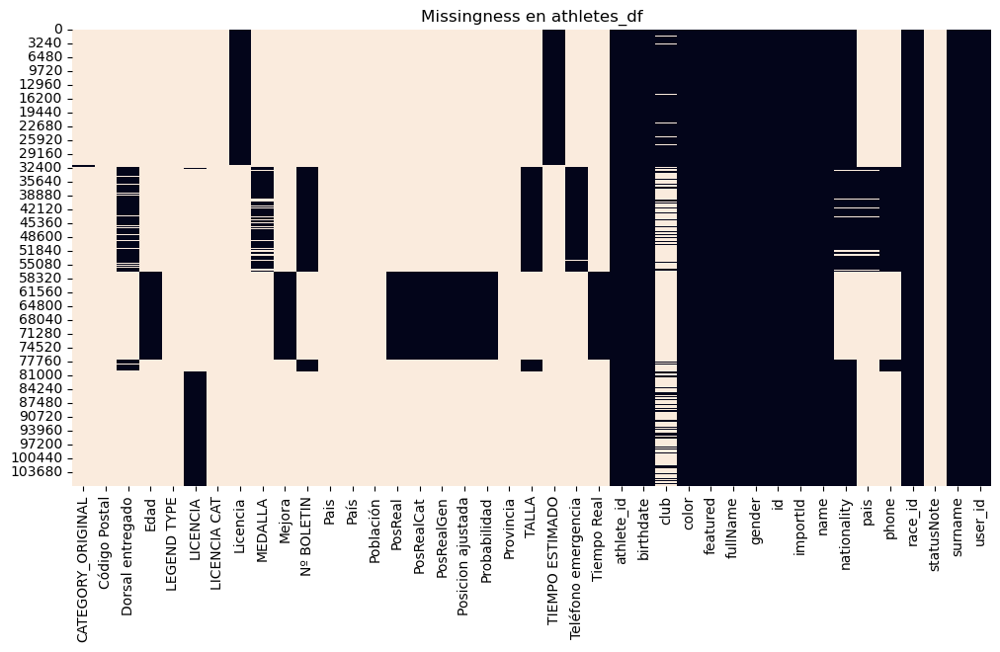


=== athletes_events_df ===


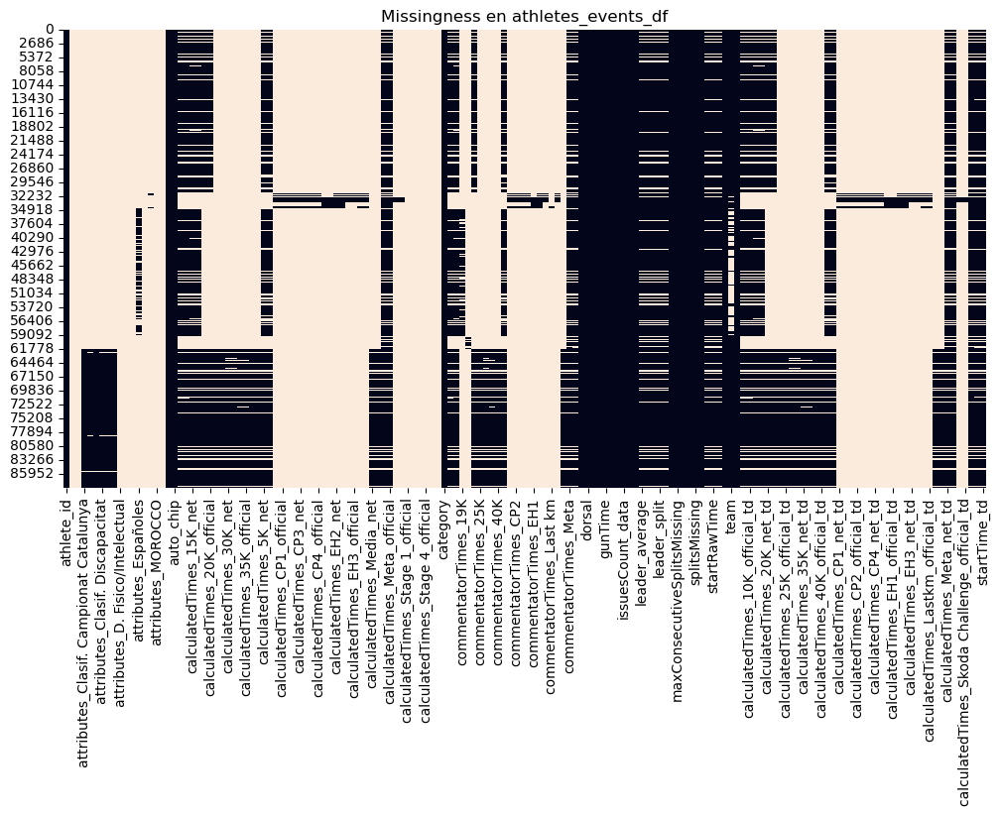


=== athletes_time_df ===


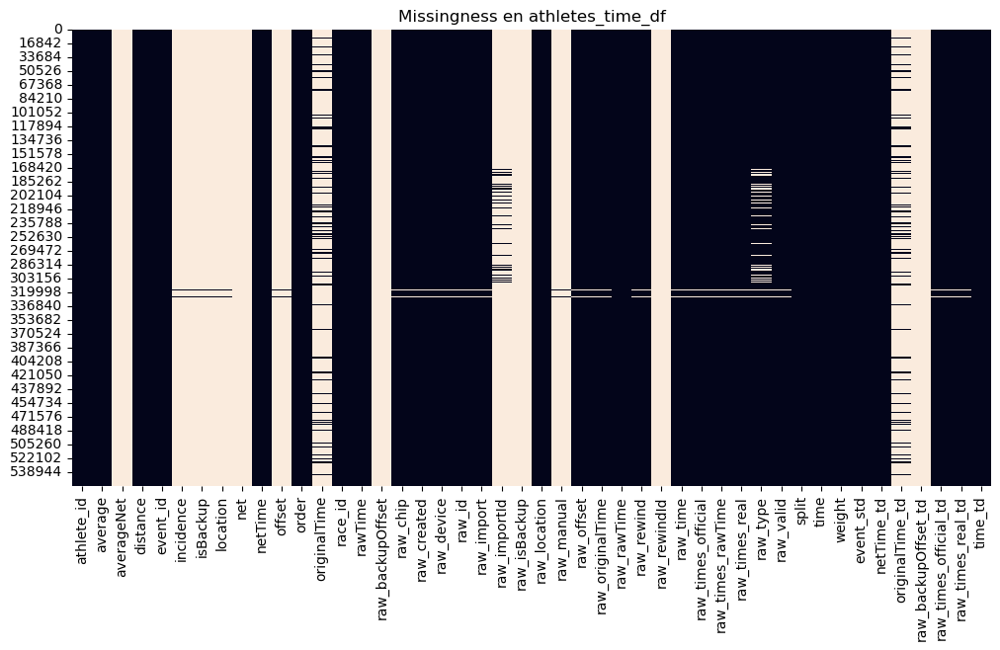


=== issues_df ===


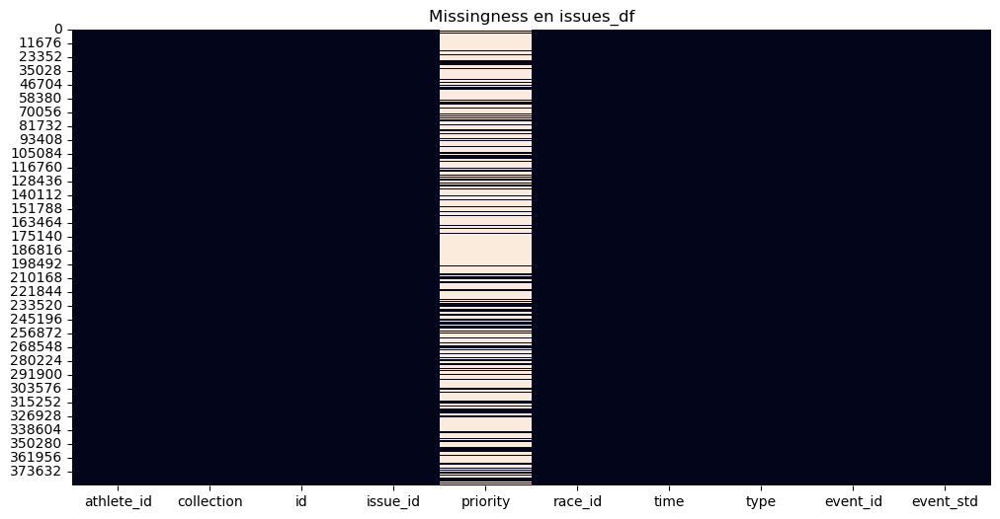


=== issues_data_df ===


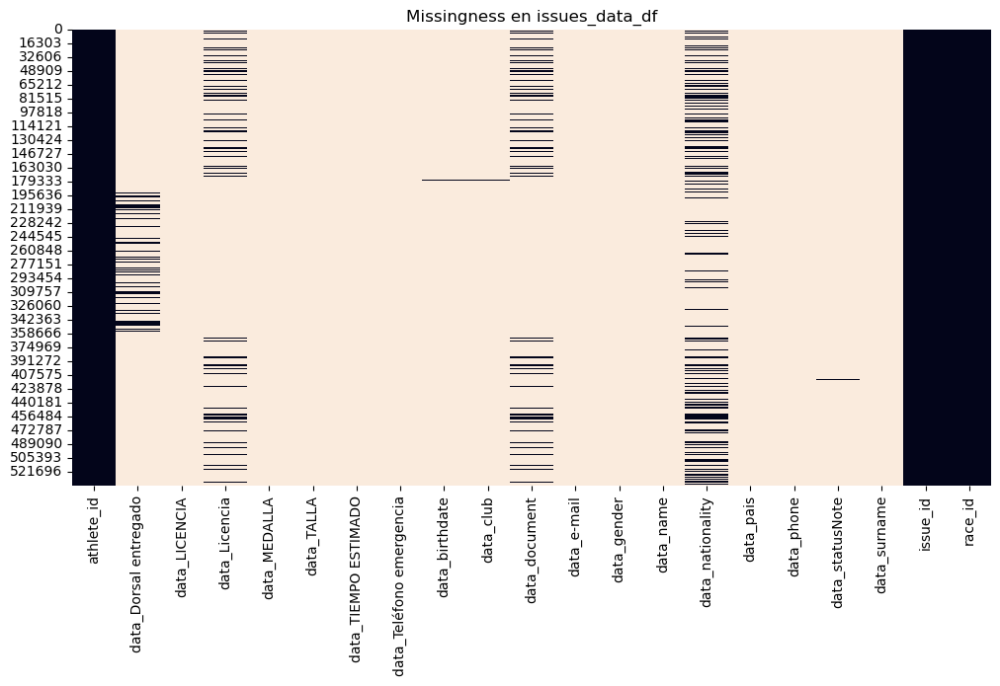


=== issues_events_df ===


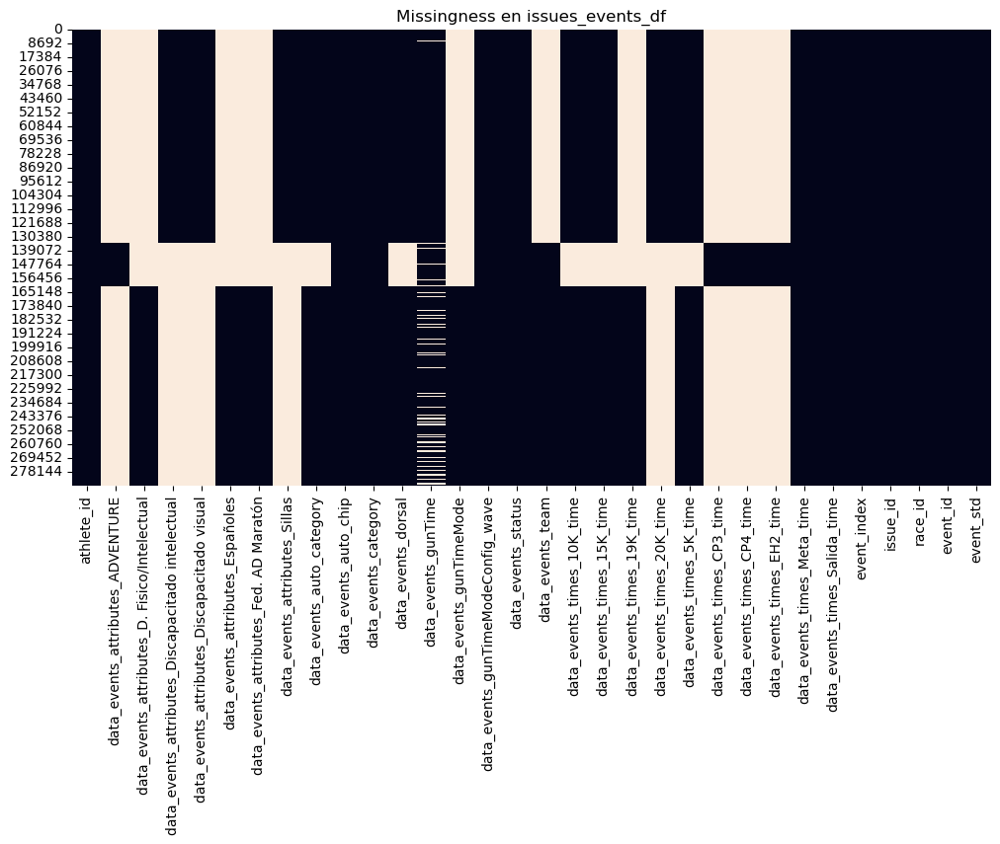


=== issues_times_df ===


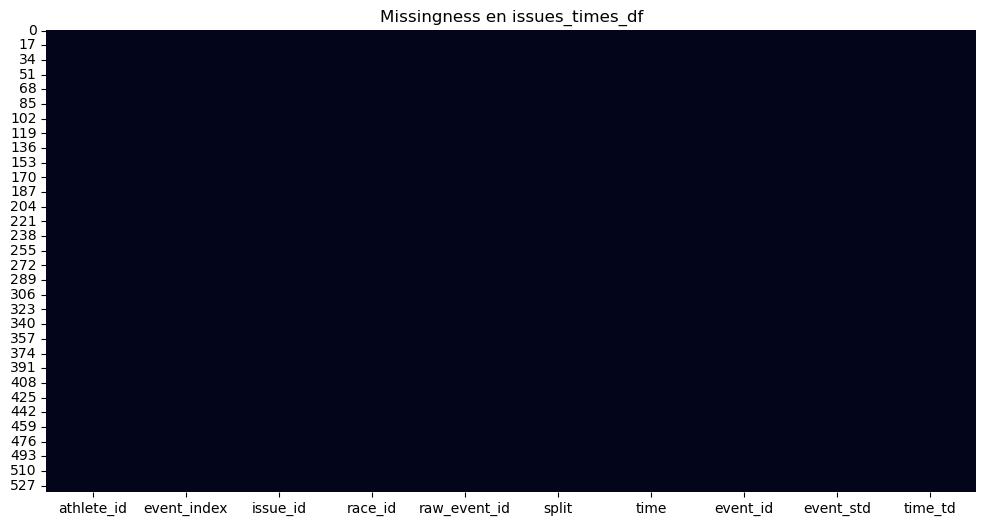

In [21]:
for name, df in dfs2.items():
    print(f"\n=== {name} ===")
    try:
        if df.empty:
            print(f"{name} está vacío, no se puede mostrar heatmap")
        else:
            missing_heatmap(df, name)
    except Exception as e:
        print(f"Error en missing_heatmap para {name}: {e}")

- Las variables en el daraframe de athletes_df son generales y su ausencia no indican un fallo enorme (en este caso solo tenemos como ausencia significativa a statusNote, que son notas sobre el porque se ha cambiado el estado del atleta, que nos puede ser útil en algunos casos). 

- En athletes_events_df tampoco vemos muchos fallos, sobre todo porque la mayoría hacen referencia a datos de tiempo faltantes y es justo lo que queremos estudiar.

- En athletes_times_df vemos un problema parecido, con el que no trataremos con las variables con mas de ese porcentaje de issues que no sirvan en nuestro proyecto. 

- En todos los dataframes de issues, al ser problemas individuales, cualquier información que podamos obtener es importante, por lo que tampoco prescindimos de ninguna columna. 

**birthdate** (fecha de nacimiento)

- Tipo: fecha personal, estática, no derivada de sensores.

- 11% de missings

**gunTime, raw_time** y otros timestamps de carrera

- eventos en tiempo real (inicio de carrera, pasos por meta, etc.).

- Missings < 1.5 % (muy pocos).

Estos tiempos se usan para calcular intervalos (netTime, split, etc.). No conviene imputar: introducir un tiempo inventado rompe la secuencia de tiempos reales. En caso de necesitar valores completos para visualización, se puede: Propagar hacia adelante (ffill) dentro de cada athlete_id (si la lógica lo permite). Pero solo para visualización, no para análisis de rendimiento.

Se mantiene NaT. Añadir columna binaria _is_missing. Solo en casos de debugging o plots, usar una fecha simbólica.

**Variables de tiempo numéricas** (e.g. startTime, startNetTime, startRawTime, calculatedTimes_*, leader_time, etc.)

Representan tiempos en milisegundos o timedeltas. Missings entre 13 % y 16 %. No se deben imputar con -1 si van a participar en análisis de rendimiento. Podría sesgar promedios o percentiles. Mejor mantener NaN, y si se necesita calcular estadísticas, trabajar con funciones que lo ignoren (np.nanmean, etc.). Si es necesario un marcador explícito, usa -1 pero documentando que es “faltante”, no valor válido.

Recomendación: Mantener NaN (o -1 solo si tu pipeline no admite NaN). 

No vamos a prescindir de ninguna fila ni valor con vacios o nulos, ya que creemos que son parte del problema y conviene mantenerlos. Son totalmente missings MCAR dada la aleatoriedad de la que gozan. 

Pasamos a evaluar la consistencia de los tipos de datos en las variables. 

### Consistencia datos

In [22]:
def describe_dfs(dfs_dict, n_examples=10, n_examples_by_type=3):
    
    for df_name, df in dfs_dict.items():
        print(f"=== DataFrame: {df_name} ===")
        if df.empty:
            print("DataFrame vacío.\n")
            continue
        
        for col in df.columns:
            col_data = df[col]
            types_present = col_data.map(type).unique()
            n_nulls = col_data.isna().sum()
            n_empty_strings = col_data.eq('').sum() if col_data.dtype == object else 0
            examples = col_data.dropna().unique()[:n_examples]
            
            examples_by_type = {}
            for t in types_present:
                examples_of_type = col_data[col_data.map(type) == t].dropna().unique()[:n_examples_by_type]
                examples_by_type[t.__name__] = examples_of_type
            
            print(f"Columna: {col}")
            print(f"  Tipos de datos distintos: {types_present}")
            print(f"  Nulos: {n_nulls}, Strings vacíos: {n_empty_strings}")
            print(f"  Ejemplos generales: {examples}")
            print(f"  Ejemplos por tipo de dato: {examples_by_type}")
        print("\n")

In [23]:
describe_dfs(dfs2, 5, 5)

=== DataFrame: athletes_df ===
Columna: CATEGORY_ORIGINAL
  Tipos de datos distintos: [<class 'float'> <class 'str'>]
  Nulos: 106449, Strings vacíos: 0
  Ejemplos generales: ['Master 50' 'Femina Elite' 'Master 40' 'Elite' 'Master 60']
  Ejemplos por tipo de dato: {'float': array([], dtype=object), 'str': array(['Master 50', 'Femina Elite', 'Master 40', 'Elite', 'Master 60'],
      dtype=object)}
Columna: Código Postal
  Tipos de datos distintos: [<class 'float'> <class 'str'>]
  Nulos: 106878, Strings vacíos: 0
  Ejemplos generales: ['8031' '34660' '75016' 'E45 AE12' '33209']
  Ejemplos por tipo de dato: {'float': array([], dtype=object), 'str': array(['8031', '34660', '75016', 'E45 AE12', '33209'], dtype=object)}
Columna: Dorsal entregado
  Tipos de datos distintos: [<class 'float'> <class 'str'>]
  Nulos: 82970, Strings vacíos: 2
  Ejemplos generales: ['Sí' '' 'Si']
  Ejemplos por tipo de dato: {'float': array([], dtype=object), 'str': array(['Sí', '', 'Si'], dtype=object)}
Columna:

Vemos bastantes inconsistencias, que tratamos de la siguiente forma: 

- Si la inconsistencias se dan entre variables que tienen diferencias en sus caracteres, por ejemplo numeros en una y letras en otra, se convierten segun el tipo más normal para esa variable (en nuestro caso la mayoria son ids, que pasarán a ser strings). 

- Si la inconsistencia es con solo datos numéricos, pero estan en formatos distintos, se pasan todos a int o float. Si son todos letras u otros caracteres, se pasan todos a str

In [14]:

def armonizar_columnas(db_dict: dict) -> dict:

    def detectar_tipos(serie):
        tipos = set()
        for v in serie:
            if pd.isna(v):
                tipos.add("nulo")
            elif isinstance(v, (int, float)):
                tipos.add("num")
            elif isinstance(v, str):
                if v.strip() == "":
                    tipos.add("vacio")
                else:
                    tipos.add("str")
            else:
                tipos.add("otro")
        return tipos

    # identificar claves compartidas (_id, _index) y columnas que no deben tocarse
    clave_cols = set()
    col_count = {}
    for df in db_dict.values():
        for col in df.columns:
            if col.endswith("_id") or col.endswith("_index"):
                col_count[col] = col_count.get(col, 0) + 1
    clave_cols = {col for col, c in col_count.items() if c > 1}

    report = {"modificadas": [], "no_modificadas": []}
    tipos_detectados_por_columna = {}

    for nombre_df, df in db_dict.items():
        tipos_detectados_por_columna[nombre_df] = {}
        for col in df.columns:
            tipos = detectar_tipos(df[col])
            tipos_detectados_por_columna[nombre_df][col] = list(tipos)

            # athlete_id 
            if col == "athlete_id":
                df[col] = df[col].apply(lambda x: str(x) if isinstance(x, (int, float)) else x)
                df[col] = df[col].astype(str)
                report["modificadas"].append({
                    "tabla": nombre_df,
                    "columna": col,
                    "tipos_detectados": list(tipos),
                    "accion": "athlete_id → convertir todos a str"
                })
                continue  # Saltamos reglas generales para esta columna

            # proteger columnas claves
            if col in clave_cols or "otro" in tipos:
                report["no_modificadas"].append({
                    "tabla": nombre_df,
                    "columna": col,
                    "razon": "columna protegida (clave o tipo no permitido)",
                    "tipos_detectados": list(tipos)
                })
                continue
            if len(tipos) <= 1:
                report["no_modificadas"].append({
                    "tabla": nombre_df,
                    "columna": col,
                    "razon": "solo un tipo",
                    "tipos_detectados": list(tipos)
                })
                continue

            accion = None

            if tipos == {"num", "str"}:
                df[col] = df[col].apply(lambda x: str(x) if isinstance(x, (int, float)) else x)
                accion = "num → str"

            elif tipos == {"num", "vacio"}:
                df[col] = df[col].replace("", np.nan)
                accion = "vacio → NaN"

            elif tipos == {"str", "nulo"}:
                df[col] = df[col].replace({np.nan: ""})
                accion = "nulo → ''"

            elif tipos == {"num", "str", "nulo"}:
                df[col] = df[col].apply(lambda x: str(x) if isinstance(x, (int, float)) else ("" if pd.isna(x) else x))
                accion = "num → str, nulo → ''"

            elif tipos == {"num", "str", "vacio"}:
                df[col] = df[col].apply(lambda x: str(x) if isinstance(x, (int, float)) else x)
                accion = "num → str"

            elif tipos == {"num", "nulo", "vacio"}:
                df[col] = df[col].replace("", np.nan)
                accion = "vacio → NaN"

            elif tipos == {"str", "nulo", "vacio"}:
                df[col] = df[col].replace({np.nan: ""})
                accion = "nulo → ''"

            elif tipos == {"num", "str", "nulo", "vacio"}:
                df[col] = df[col].apply(lambda x: str(x) if isinstance(x, (int, float)) else ("" if pd.isna(x) else x))
                accion = "num → str, nulo → ''"

            if accion:
                report["modificadas"].append({
                    "tabla": nombre_df,
                    "columna": col,
                    "tipos_detectados": list(tipos),
                    "accion": accion
                })
                if col in clave_cols:
                    for otro_nombre, otro_df in db_dict.items():
                        if otro_nombre != nombre_df and col in otro_df.columns:
                            db_dict[otro_nombre][col] = df[col].copy()
            else:
                report["no_modificadas"].append({
                    "tabla": nombre_df,
                    "columna": col,
                    "razon": "sin regla aplicable",
                    "tipos_detectados": list(tipos)
                })

    return {
        "dataframes": db_dict,
        "report": report,
        "tipos_detectados": tipos_detectados_por_columna
    }

In [15]:
resultado = armonizar_columnas(dfs2)

C:\Users\mario\AppData\Local\Temp\ipykernel_20744\2913278447.py:90: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[col] = df[col].replace("", np.nan)
C:\Users\mario\AppData\Local\Temp\ipykernel_20744\2913278447.py:74: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[col] = df[col].replace("", np.nan)


In [27]:
describe_dfs(resultado['dataframes'], 5, 5)

=== DataFrame: athletes_df ===
Columna: CATEGORY_ORIGINAL
  Tipos de datos distintos: [<class 'str'>]
  Nulos: 0, Strings vacíos: 106449
  Ejemplos generales: ['' 'Master 50' 'Femina Elite' 'Master 40' 'Elite']
  Ejemplos por tipo de dato: {'str': array(['', 'Master 50', 'Femina Elite', 'Master 40', 'Elite'],
      dtype=object)}
Columna: Código Postal
  Tipos de datos distintos: [<class 'str'>]
  Nulos: 0, Strings vacíos: 106878
  Ejemplos generales: ['' '8031' '34660' '75016' 'E45 AE12']
  Ejemplos por tipo de dato: {'str': array(['', '8031', '34660', '75016', 'E45 AE12'], dtype=object)}
Columna: Dorsal entregado
  Tipos de datos distintos: [<class 'str'>]
  Nulos: 0, Strings vacíos: 82972
  Ejemplos generales: ['' 'Sí' 'Si']
  Ejemplos por tipo de dato: {'str': array(['', 'Sí', 'Si'], dtype=object)}
Columna: Edad
  Tipos de datos distintos: [<class 'float'>]
  Nulos: 86339, Strings vacíos: 0
  Ejemplos generales: [26. 34. 29. 25. 47.]
  Ejemplos por tipo de dato: {'float': array([26

Vesmos como se h arreglado el problema que teníamos con los tipos de las variables.

In [16]:
dfs_final = resultado['dataframes']

### Guardar dataframes limpios

Una vez ya tenemos el diccionario de dataframes totalmente transformado, pasamos a guardarlo en un archivo pickle para su mejor manipulacion

In [17]:
with open('dfs_final.pkl', 'wb') as f:
    pickle.dump(dfs_final, f)

In [2]:
with open('dfs_final.pkl', 'rb') as f:
    dfs_final = pickle.load(f)

In [3]:
dfs = dfs_final

### Duplicados

Pasamos a ver los duplicados por columna

In [34]:
duplicados_info = {}

for df_name, df in dfs_final.items():
    if df.empty:
        continue

    dup = df[df.duplicated(keep=False)]
    
    duplicados_info[df_name] = {
        'num_duplicados': dup.shape[0],
        'duplicados_df': dup
    }

for df_name, info in duplicados_info.items():
    print(f"{df_name}: {info['num_duplicados']} duplicados")


athletes_df: 0 duplicados
athletes_events_df: 0 duplicados
athletes_time_df: 0 duplicados
issues_df: 0 duplicados
issues_data_df: 294 duplicados
issues_events_df: 0 duplicados
issues_times_df: 0 duplicados


El unico dataframe que podemos ver que tiene duplicados es issues_data_df, pero ello se debe a su construcción, ya que no tiene id propio. 

## Análisis descriptivo

Vamos a pasar a hacer un análisis descriptivo simple de la carrera, que nos enseñe valores clave para poder entender la mayoría de variables

- Estadísticas para variables numéricas (media, mediana, desviación estándar, rango, IQR, skew, kurtosis).

- Información sobre fechas (mínima, máxima, rango, año/mes más frecuente).

- Resumen de duraciones (timedelta).

- Resumen de booleanos (% True/False).

- Resumen de categóricas/texto (moda, frecuencia, top 5 valores, % nulos + vacíos).

In [ ]:
def descriptive_template(dfs_dic, race_col="race_id", athlete_col="athlete_id", event_col="event",
                                            variables_analizar=None):
    """
    Analiza variables de athletes_df agregadas por evento dentro de cada carrera,
    manteniendo estadísticas completas: numéricas, fechas, timedelta, booleanas y categóricas.
    Además genera un resumen global por evento (todas las carreras).
    """
    athletes_df = dfs_dic.get("athletes_df")
    athletes_events_df = dfs_dic.get("athletes_events_df")

    if athletes_df is None or athletes_events_df is None:
        print("Faltan los DataFrames 'athletes_df' o 'athletes_events_df'.")
        return

    if variables_analizar is None:
        variables_analizar = ["gender", "birthdate", "club", "nationality", "statusNote"]

    athletes_min = [athlete_col, race_col] + variables_analizar
    merged = athletes_events_df[[athlete_col, race_col, event_col, "event_std"]].merge(
    athletes_df[athletes_min],
    on=[athlete_col, race_col],
    how="left")

    print("\n" + "="*100)
    print("ANÁLISIS COMPLETO POR CARRERA Y EVENTO")
    print("="*100)
    for (race_id, event), grupo in merged.groupby([race_col, event_col]):
        print(f"\n🔹 Carrera: {race_id} | Evento: {event} | Atletas: {grupo.shape[0]}")
        _resumen_completo(grupo, variables_analizar)

    print("\n" + "="*100)
    print("RESUMEN COMPLETO POR EVENT_STD (TODAS LAS CARRERAS)")
    print("="*100)

    for event_std, grupo_event in merged.groupby("event_std"):
        if event_std == "stage":
            for race_id, grupo_race in grupo_event.groupby(race_col):
                grupo_race_unico = grupo_race.drop_duplicates(subset=[athlete_col])
                print(f"\n🔹 Evento stage | Carrera: {race_id} | Atletas: {grupo_race_unico.shape[0]}")
                _resumen_completo(grupo_race_unico, variables_analizar)
        else:
            print(f"\n🔹 Evento estándar: {event_std} | Atletas totales: {grupo_event[athlete_col].nunique()}")
            _resumen_completo(grupo_event, variables_analizar)


    print("\n🏁 ANÁLISIS FINALIZADO")


def _resumen_completo(df, variables):
    """
    Función interna que hace el análisis completo de un DataFrame reducido
    para un conjunto de variables, manteniendo toda la lógica de tipos.
    """
    for col in variables:
        serie = df[col]
        tipo = str(serie.dtype)
        nulos = serie.isna().sum()
        vacios = (serie == "").sum() if serie.dtype == "object" else 0
        unicos = serie.nunique(dropna=True)

        print(f"\n🧩 Columna: {col}")
        print(f"   Tipo: {tipo} | Valores únicos: {unicos:,} | Nulos: {nulos:,} | Vacíos: {vacios:,}")

        if pd.api.types.is_numeric_dtype(serie):
            desc = serie.describe(percentiles=[.25, .5, .75])
            media = desc.get("mean", np.nan)
            mediana = desc.get("50%", np.nan)
            desv = desc.get("std", np.nan)
            minimo = desc.get("min", np.nan)
            maximo = desc.get("max", np.nan)
            q1 = desc.get("25%", np.nan)
            q3 = desc.get("75%", np.nan)
            rango = maximo - minimo if pd.notna(maximo) and pd.notna(minimo) else np.nan
            iqr = q3 - q1 if pd.notna(q3) and pd.notna(q1) else np.nan

            print(f"   ▫️ Media: {media:.3f}" if pd.notna(media) else "   ▫️ Media: no aplica")
            print(f"   ▫️ Mediana: {mediana:.3f}" if pd.notna(mediana) else "   ▫️ Mediana: no aplica")
            print(f"   ▫️ Desviación estándar: {desv:.3f}" if pd.notna(desv) else "   ▫️ Desviación estándar: no aplica")
            print(f"   ▫️ Mínimo: {minimo:.3f}" if pd.notna(minimo) else "   ▫️ Mínimo: no aplica")
            print(f"   ▫️ Máximo: {maximo:.3f}" if pd.notna(maximo) else "   ▫️ Máximo: no aplica")
            print(f"   ▫️ Rango: {rango:.3f}" if pd.notna(rango) else "   ▫️ Rango: no aplica")
            print(f"   ▫️ Q1 (25%): {q1:.3f} | Q3 (75%): {q3:.3f} | IQR: {iqr:.3f}")
            print(f"   ▫️ Skew: {serie.skew():.3f} | Kurtosis: {serie.kurt():.3f}")

        elif pd.api.types.is_datetime64_any_dtype(serie):
            try:
                serie = serie.dt.tz_localize(None)
            except Exception:
                pass
            rango = (serie.max() - serie.min()).days if not serie.empty else "no aplica"
            años = serie.dt.year.mode()
            meses = serie.dt.month.mode()
            print(f"   ▫️ Fecha mínima: {serie.min()}")
            print(f"   ▫️ Fecha máxima: {serie.max()}")
            print(f"   ▫️ Rango de días: {rango}")
            print(f"   ▫️ Año más frecuente: {años.iloc[0] if not años.empty else 'no aplica'}")
            print(f"   ▫️ Mes más frecuente: {meses.iloc[0] if not meses.empty else 'no aplica'}")

        elif pd.api.types.is_timedelta64_dtype(serie):
            print(f"   ▫️ Duración mínima: {serie.min()}")
            print(f"   ▫️ Duración media: {serie.mean()}")
            print(f"   ▫️ Duración máxima: {serie.max()}")
            print(f"   ▫️ Rango de tiempo: {serie.max() - serie.min()}")

        elif pd.api.types.is_bool_dtype(serie):
            prop_true = serie.mean() * 100
            print(f"   ▫️ % Verdaderos (True): {prop_true:.2f}%")
            print(f"   ▫️ % Falsos (False): {100 - prop_true:.2f}%")

        else:
            try:
                modo = serie.mode(dropna=True)
                valor_mas_frecuente = modo.iloc[0] if not modo.empty else "no aplica"
            except Exception:
                valor_mas_frecuente = "no aplica"

            try:
                frecuencia_moda = serie.value_counts(dropna=True).iloc[0] if not serie.value_counts(dropna=True).empty else 0
                top5 = serie.value_counts(dropna=True).head(5)
            except Exception:
                frecuencia_moda = 0
                top5 = pd.Series(dtype="object")

            prop_nulos_vacios = (nulos + vacios) / len(df) if len(df) > 0 else np.nan

            print(f"   ▫️ Moda: {valor_mas_frecuente} ({frecuencia_moda} ocurrencias)")
            print(f"   ▫️ % Nulos + Vacíos: {prop_nulos_vacios*100:.2f}%")
            if not top5.empty:
                print("   ▫️ Top 5 valores:")
                for valor, freq in top5.items():
                    print(f"      - {valor}: {freq:,}")

In [37]:
resuultado = descriptive_template(dfs_final, 'race_id', 'athlete_id', 'event', None)


ANÁLISIS COMPLETO POR CARRERA Y EVENTO

🔹 Carrera: 1a83229e-2547-42a3-b5b4-36c7425c4d8f | Evento: Mitja | Atletas: 31679

🧩 Columna: gender
   Tipo: object | Valores únicos: 3 | Nulos: 0 | Vacíos: 0
   ▫️ Moda: male (19290 ocurrencias)
   ▫️ % Nulos + Vacíos: 0.00%
   ▫️ Top 5 valores:
      - male: 19,290
      - female: 12,349
      - mixed: 40

🧩 Columna: birthdate
   Tipo: datetime64[ns] | Valores únicos: 12,826 | Nulos: 35 | Vacíos: 0
   ▫️ Fecha mínima: 1925-05-07 00:00:00
   ▫️ Fecha máxima: 2009-07-01 00:00:00
   ▫️ Rango de días: 30736
   ▫️ Año más frecuente: 1996.0
   ▫️ Mes más frecuente: 7.0

🧩 Columna: club
   Tipo: object | Valores únicos: 3,352 | Nulos: 0 | Vacíos: 1,485
   ▫️ Moda: Independiente (22629 ocurrencias)
   ▫️ % Nulos + Vacíos: 4.69%
   ▫️ Top 5 valores:
      - Independiente: 22,629
      - : 1,485
      - PRORUNNERS BARCELONA: 152
      - FUN RUNNERS CLUB ESPORTIU: 107
      - BCTeam: 60

🧩 Columna: nationality
   Tipo: object | Valores únicos: 98 | Nulos

Podemos sacar algunas conclusiones interesantes para el análisis posterior: 

- birthdate tiene algunos valores demasiado bajos, por lo que es posible que tengamos que arreglar esta variable o avisar pre carrera de que algunos atletas pueden tener mal la fevha de nacimiento. 

- Cada atleta tiene un promedio de 5-6 issues, lo cuál es bastante y estudiaremos posteriormente. 

- La mayoría de los starttime están concentrados en valores bajos, con algtunos puntos altos que podrían ser outliers y estaría bien estudiar. 

- Hay algunos valores etremos en nettime que podrían ser atletas atipicos. 

- Algunos valores no nulos existentes en offset que podrian indicar un ajuste del guntime del atleta en concreto. 

- Mayor participación en medias maratones que en las demas. 

- Mayoría de hombres

- Muchos más clubes distintos en maratón

- Más españoles que de otras nacinalidades

- La mayoría son jóvenes adultos, aunque las maratones suelen tener más participantes de más edad

## EDA

Según hemos ido estudiando a lo largo de lo que llevamos de proyecto, vamos a hacer un análisis exploratorio enfocado a varias cuestiones y objetivos hipotéticos más concisos de los que planteamos al principio. 

- Detección de atletas con datos anómalos o inconsistentes (PRE-CARRERA)

- - Identificar atletas cuyos tiempos o registros no se ajustan al comportamiento esperado de otros atletas de la misma carrera o categoría (o usando informacion tambien de optras carreras incluso, para tener mas muestra).

- - Detectar problemas de cronometraje, errores de importación, duplicados de chips o inconsistencias de dispositivos antes de la carrera empiece (sobre todo centrado en datos personales y descriptivos)


- Conexión con incidencias históricas (issues)

- - Explorar los issues (sobretodo los de tipo athletetime o changestatus, que parecen ser los más extrapolables) para entender qué situaciones generan errores o descalificaciones.

- - Identificar correlaciones entre tipos de issues, splits afectados y características del atleta.


- Preparación para modelado predictivo (IN & POST-CARRERA)

- - Definir features confiables y derivadas. 

- - Analizar relaciones entre variables para preparar modelos de detección no supervisada, predicción de tiempos esperados (expected_time).


- Rellenar datos faltantes y predecir tiempos esperados (IN & POST-CARRERA)

- - Predecir tiempos en splits faltantes usando el comportamiento del atleta y de atletas similares.

- - Permitir reconstruir series completas para detectar errores o completar registros incompletos.


- Alertar automáticamente a cronometradores (IN CARRERA)

- - Detectar y reportar splits faltantes o valores anómalos antes de que afecten resultados oficiales.

- - Proporcionar justificación basada en reglas y comparación con otros atletas.

Para ello, enfocaremos nuestro análisis exploratorio a las variables **temporales** (ya que son las que más información nos dan sobre el contexto de la carrera con los datos que tenemos), aunque también estudireamos variables que nos parezcan importantes. Abajo un pequeño resumen de lo que vamos a hacer.

🔹 **NIVEL 1 — Atleta (athletes_df)**

- *Objetivo*: Validar y depurar los datos personales y estructurales de los atletas para evitar errores de identificación o clasificación.

- - name, surname, fullName: detección de duplicados, errores de importación, o uniones incorrectas.  
  → Técnica: comparación difusa (fuzzy matching) o Levehenstein.  

- - gender: validación lógica frente a nombre y categorías de participación.  
  → Técnica: detección de inconsistencias por reglas y proporciones. Uso de lista de nombres comunes y sus géneos para poder detectar problemas. 

- - birthdate: cálculo de edad, detección de valores extremos o imposibles.  
  → Técnica: percentiles + validación de rango (mín/max) según categoría.  

- - club: análisis de frecuencia, detección de duplicados textuales (errores de digitación).  
  → Técnica: limpieza y agrupación léxica (Levenshtein o fuzzy matching).  

- - nationality: homogenización de códigos ISO, detección de outliers geográficos.  

---

🔹 **NIVEL 2 — Eventos (athletes_events_df)**

- *Objetivo*: Evaluar la consistencia y calidad de los datos de participación por evento.

- - startTime, startRawTime, gunTime: detección de incoherencias (salidas negativas, retrasos inusuales).  
  → diferencias temporales, límites ±3σ.  

- - auto_category, category: comparativa entre categoría asignada automática y real.  
  → tabla de contingencia + tasa de error de asignación.  

- - status, realStatus: identificación de discrepancias o combinaciones imposibles.  

- - splitsMissing, maxConsecutiveSplitsMissing: detección de participantes con seguimiento irregular.  
  → conteos, detección de secuencias vacías.  

---

🔹 **NIVEL 3 — Tiempos / Splits (athletes_time_df)**

- *Objetivo*: Analizar la dinámica temporal, detectar anomalías, interpolar tiempos faltantes, estimar consistencia y preparar alertas pre-carrera.

- - time, netTime: cálculo de tiempos en segundos, verificación de orden creciente.  
  → detección de outliers (IQR).

- - average: detección de velocidades imposibles.  
  → umbrales físicos + IQR sobre medias.

- - time_split_sec (derivada): ritmo por tramo o km, comparación de categoría o histórico del atleta.

- - offset: análisis de ajustes manuales y latencias del chip.  
  → relacionarlo con ciertas variables.

- - isBackup, raw_manual, raw_valid: evaluación de calidad de registro y proporción de correcciones.  
  → Técnica: agregaciones y comparativas por evento.

- - incidence: conteo y relación con registros corregidos o penalizados.  

- *Conexión con issues históricos*:  
  - Relacionar registros anómalos con issues previos (athletetime, changestatus).  
  - Identificar correlaciones entre tipo de issue, prioridad, splits afectados y características del atleta.

- *Preparación para modelado predictivo*:  
  - Features confiables: netTime, time, average, offset, pace_split, acumulado_desviacion.  
  - Técnicas: regresión, Random Forest, XGBoost, detección no supervisada (Isolation Forest, LOF).

- *Interpolación y predicción de tiempos faltantes*:  
  - Técnicas: splines cúbicos, regresión polinómica, filtros de Kalman.  
  - Objetivo: reconstruir series completas para detectar errores o completar registros incompletos.

- *Alertas automáticas in-carrera*:  
  - Detección de splits faltantes o valores anómalos antes de afectar resultados oficiales.  
  - Justificación basada en reglas y comparación con otros atletas.

- *Técnicas avanzadas sugeridas*:  
  - Detección de anomalías: Isolation Forest, DBSCAN, LOF (comparar con z-score).  
  - Interpolación temporal: splines cúbicos, regresión polinómica, Kalman Filters.  
  - Predicción de tiempos: modelos de regresión (Random Forest, XGBoost) para estimar meta o tramos faltantes.
 

---

🔹 **NIVEL 4 — Issues / Incidencias**

- *Objetivo*: Analizar el comportamiento histórico de errores y su relación con los datos de atletas, eventos y tiempos.

- - type: distribución de tipos de incidencias (athleteTime, changeStatus, etc.).  
  → Técnica: análisis de frecuencia.  

- - time: evolución temporal de incidencias (pre-carrera, en carrera, post-carrera).  
  → Técnica: series temporales.  

- *Objetivo final de este nivel*:  
  Identificar patrones recurrentes de error y sus causas probables (dispositivo, categoría, atleta, tipo de evento), con análisis contextual temporal (pre, durante y post carrera).  

---

🔹 **Variables temporales clave y su valor analítico**

| Variable temporal | Qué mide | Qué se hace con ella | Qué aporta |
|------------------|---------|--------------------|-----------|
| gunTime | Salida oficial | Comparar con startTime y startNetTime | Mide el retraso de salida real |
| startTime | Inicio registrado | Validar si coincide con gunTime o difiere excesivamente | Detecta salidas adelantadas o retrasadas |
| startRawTime | Tiempo crudo del chip | Comparar con startTime | Identifica errores del chip o correcciones |
| startNetTime | Diferencia neta desde la salida oficial | Analizar negativos o desviaciones | Indica posibles ajustes erróneos o chips mal sincronizados |
| time / netTime | Tiempos por split | Convertir a segundos, validar secuencia, outliers | Evalúa ritmo y consistencia |
| originalTime | Tiempo inicial antes de correcciones | Comparar con netTime | Mide el impacto de correcciones manuales |
| rawTime | Tiempo crudo del dispositivo | Analizar desviación respecto a netTime | Detección de fallos de hardware |
| offset / raw_offset | Diferencia entre tiempos ajustados | Analizar magnitud y signo | Mide compensaciones y latencias |
| created | Timestamp del registro | Ordenar cronológicamente los eventos | Permite reconstruir secuencia temporal real |
| penalties.offset | Penalización añadida | Incorporar al tiempo total | Evalúa efecto de sanciones en ranking final |



Empezamos conviertiendo el diccionario en dfs separados:

In [38]:
dfs = dfs_final

athletes_df = dfs['athletes_df']
athletes_events_df = dfs['athletes_events_df']
athletes_time_df = dfs['athletes_time_df']

issues_df = dfs['issues_df']
issues_events_df = dfs['issues_events_df']
issues_data_df = dfs['issues_data_df']
issues_times_df = dfs['issues_times_df']

### Nivel Atletas

Pasamos con el reporte de datos simples de atletas

In [ ]:
def eda_athletes(df, max_dist=2, top_n=50):
    """
    Exploración básica del DataFrame de atletas.
    Analiza de forma global y además por carrera (race_id).
    Detecta inconsistencias, errores comunes y posibles valores similares.
    """

    def detectar_casi_iguales(columna):
        valores = columna.dropna().astype(str).str.strip().str.lower()
        conteo = valores.value_counts()
        top_valores = conteo.head(top_n).index.tolist()
        posibles_errores = {}
        for val in valores.unique():
            if val in top_valores:
                continue
            for top_val in top_valores:
                if Levenshtein.distance(val, top_val) <= max_dist:
                    posibles_errores[val] = top_val
                    break
        return posibles_errores

    def analizar_subdf(subdf):
        """Analiza un subconjunto de atletas (general o por carrera)."""
        report = {}

        # ---- Nombres y apellidos ----
        report['nombres_apellidos'] = {}
        for col in ['fullName', 'name', 'surname']:
            if col not in subdf.columns:
                continue
            uniques = subdf[col].dropna().unique()
            n_null = subdf[col].isnull().sum()
            casi_iguales = detectar_casi_iguales(subdf[col])
            report['nombres_apellidos'][col] = {
                'n_unicos': len(uniques),
                'n_null': int(n_null),
                'ejemplos': list(uniques[:10]),
                'casi_iguales': casi_iguales
            }

        # ---- Club ----
        if 'club' in subdf.columns:
            report['club'] = {}
            subdf['club_clean'] = subdf['club'].astype(str).str.strip().str.lower()
            n_null_club = subdf['club'].isnull().sum()
            top_clubs = subdf['club'].value_counts().head(10).to_dict()
            club_casi_iguales = detectar_casi_iguales(subdf['club'])
            report['club'] = {
                'n_null': int(n_null_club),
                'n_unicos': subdf['club'].nunique(),
                'top': top_clubs,
                'casi_iguales': club_casi_iguales
            }

        # ---- Género ----
        if 'gender' in subdf.columns:
            report['gender'] = {}
            genders = subdf['gender'].dropna().unique()
            n_null_gender = subdf['gender'].isnull().sum()
            report['gender']['unicos'] = list(genders)
            report['gender']['n_null'] = int(n_null_gender)
            report['gender']['conteo'] = subdf['gender'].value_counts().to_dict()

        # ---- Fechas de nacimiento ----
        if 'birthdate' in subdf.columns:
            report['birthdate'] = {}
            subdf['birthdate'] = pd.to_datetime(subdf['birthdate'], errors='coerce')
            edades = (pd.Timestamp.now() - subdf['birthdate']).dt.days // 365
            report['birthdate']['edades_estadisticas'] = edades.describe().to_dict()
            report['birthdate']['outliers'] = subdf.loc[
                (edades < 10) | (edades > 90),
                ['fullName', 'birthdate']
            ].to_dict(orient='records')

        # ---- Nacionalidad ----
        if 'nationality' in subdf.columns:
            report['nationality'] = {}
            subdf['nationality_clean'] = subdf['nationality'].astype(str).str.upper().str.strip()
            n_null_nat = subdf['nationality_clean'].isnull().sum()
            codigos_invalidos = subdf.loc[
                ~subdf['nationality_clean'].str.match(r'^[A-Z]{2}$', na=False),
                'nationality_clean'
            ].unique()
            report['nationality']['n_null'] = int(n_null_nat)
            report['nationality']['codigos_invalidos'] = list(codigos_invalidos)
            report['nationality']['conteo'] = subdf['nationality_clean'].value_counts().to_dict()

            valores = subdf['nationality_clean'].dropna().unique()
            codigos_2 = [v for v in valores if len(v) == 2 and v.isalpha()]
            codigos_no_2 = [v for v in valores if len(v) != 2 and v.isalpha()]
            
            casi_iguales_nac = {}
            for val in codigos_no_2:
                for v2 in codigos_2:
                    if Levenshtein.distance(val, v2) <= max_dist:
                        casi_iguales_nac[val] = v2
                        break
            report['nationality']['casi_iguales'] = casi_iguales_nac

        # ---- Featured ----
        if 'featured' in subdf.columns:
            report['featured'] = {}
            report['featured']['conteo'] = subdf['featured'].value_counts().to_dict()
            try:
                report['featured']['proporcion'] = float(subdf['featured'].mean())
            except:
                report['featured']['proporcion'] = None

        return report

    # --- Análisis general ---
    general_report = analizar_subdf(df)

    # --- Análisis por carrera ---
    race_reports = {}
    if 'race_id' in df.columns:
        for race_id, group in df.groupby('race_id'):
            race_reports[race_id] = analizar_subdf(group)

    # --- Consolidar resultado ---
    return {
        'general': general_report,
        'por_carrera': race_reports
    }

In [40]:
report_eda = eda_athletes(athletes_df)

In [41]:
report_eda

{'general': {'nombres_apellidos': {'fullName': {'n_unicos': 87301,
    'n_null': 0,
    'ejemplos': ['Abdezaliz Merzougui',
     'Floriane Hot',
     'Laura Santos',
     'Nicolas Navarro',
     'Dmitrijs Serjogins',
     'Maxime Lopes',
     'Ruben Ortiz Martínez',
     'Benjamin Franke',
     'Samuel Martin López',
     'Ciaran Lewis'],
    'casi_iguales': {'julia hartig': 'julia martin',
     'charles martinez': 'carlos martinez',
     'david curtin': 'david martin',
     'carlos martínez': 'carlos martinez',
     'julie martin': 'julia martin',
     'carlos martin': 'carlos martinez',
     'david gonzález hernández': 'david gonzález fernández',
     'david martinez': 'david martin',
     'stephen murray': 'stephen murphy',
     'david martín': 'david martin',
     'marc fernandez': 'marc hernandez'}},
   'name': {'n_unicos': 15851,
    'n_null': 0,
    'ejemplos': ['Abdezaliz',
     'Floriane',
     'Laura',
     'Nicolas',
     'Dmitrijs',
     'Maxime',
     'Ruben',
     'Benjam

In [ ]:
def mostrar_reporte_tabular(reporte, titulo="REPORTE"):
    """Muestra de forma tabular un reporte generado por eda_athletes() (nivel general o por carrera)."""
    print(f"\n{'='*80}\n{titulo}\n{'='*80}")

    if 'nombres_apellidos' in reporte:
        for col, data in reporte['nombres_apellidos'].items():
            print(f"\n=== {col} ===")
            print(f"Únicos: {data['n_unicos']}, Nulos: {data['n_null']}")
            print(f"Ejemplos: {', '.join(map(str, data['ejemplos']))}")
            if data.get('casi_iguales'):
                casi = pd.DataFrame(list(data['casi_iguales'].items()), columns=[col, 'Sugerido'])
                print("Posibles errores tipográficos (casi iguales):")
                print(casi.head(10).to_string(index=False))

    if 'club' in reporte:
        club = reporte['club']
        print("\n=== Clubes ===")
        print(f"Únicos: {club['n_unicos']}, Nulos: {club['n_null']}")
        print("Top 10 clubes:")
        print(pd.Series(club['top']).head(10))
        if club.get('casi_iguales'):
            casi_club = pd.DataFrame(list(club['casi_iguales'].items()), columns=['Club', 'Sugerido'])
            print("Posibles errores tipográficos (casi iguales):")
            print(casi_club.head(10).to_string(index=False))

    if 'gender' in reporte:
        g = reporte['gender']
        print("\n=== Gender ===")
        print(f"Únicos: {g['unicos']}, Nulos: {g['n_null']}")
        print("Conteo:")
        print(pd.Series(g['conteo']))

    if 'birthdate' in reporte:
        b = reporte['birthdate']
        print("\n=== Birthdate ===")
        print("Estadísticas de edades:")
        print(pd.Series(b['edades_estadisticas']))
        print("Outliers (edades sospechosas):")
        outliers = pd.DataFrame(b['outliers'])
        if not outliers.empty:
            print(outliers.head(5).to_string(index=False))
        else:
            print("  No se detectaron outliers.")

    if 'nationality' in reporte:
        n = reporte['nationality']
        print("\n=== Nationality ===")
        print(f"Nulos: {n['n_null']}")
        print(f"Códigos inválidos: {', '.join(map(str, n['codigos_invalidos'][:10]))}")
        print("Top 10 códigos:")
        print(pd.Series(n['conteo']).head(10))
        print("\nPosibles nacionalidades mal escritas (según distancia de Levenshtein):")
        if n.get('casi_iguales'):
            for invalido, sugerido in n['casi_iguales'].items():
                print(f"  - '{invalido}' → posible '{sugerido}'")
        else:
            print("  No se detectaron nacionalidades sospechosas.")

    if 'featured' in reporte:
        f = reporte['featured']
        print("\n=== Featured ===")
        print(f"Conteo: {f['conteo']}, Proporción: {f['proporcion']:.3f}" if f.get('proporcion') is not None else f"Conteo: {f['conteo']}")


The history saving thread hit an unexpected error (OperationalError('database or disk is full')).History will not be written to the database.


In [19]:
mostrar_reporte_tabular(report_eda['general'], titulo="REPORTE GENERAL")


REPORTE GENERAL

=== fullName ===
Únicos: 55354, Nulos: 0
Ejemplos: Abdezaliz Merzougui, Floriane Hot, Laura Santos, Nicolas Navarro, Dmitrijs Serjogins, Maxime Lopes, Ruben Ortiz Martínez, Benjamin Franke, Samuel Martin López, Ciaran Lewis
Posibles errores tipográficos (casi iguales):
       fullName      Sugerido
      sue evans     sam evans
     max wilson   mark wilson
  thomas marion thomas martin
  thomas bastin thomas martin
xavier armengol xavi armengol
  thomas machin thomas martin
  thomas curtin thomas martin
     phil smith    paul smith

=== name ===
Únicos: 12304, Nulos: 0
Ejemplos: Abdezaliz, Floriane, Laura, Nicolas, Dmitrijs, Maxime, Ruben, Benjamin, Samuel, Ciaran
Posibles errores tipográficos (casi iguales):
   name Sugerido
 samuel   manuel
    tom      pol
  núria    maria
 marina    marta
  jhoan     joan
   luca    laura
mariona    maria
   mark     marc
  ronan     joan
  lucas     luis

=== surname ===
Únicos: 44775, Nulos: 0
Ejemplos: Merzougui, Hot, Santos,

In [43]:
for race_id, rep in report_eda['por_carrera'].items():
    mostrar_reporte_tabular(rep, titulo=f"REPORTE CARRERA {race_id}")


REPORTE CARRERA 1a83229e-2547-42a3-b5b4-36c7425c4d8f

=== fullName ===
Únicos: 31629, Nulos: 0
Ejemplos: Abdezaliz Merzougui, Floriane Hot, Laura Santos, Nicolas Navarro, Dmitrijs Serjogins, Maxime Lopes, Ruben Ortiz Martínez, Benjamin Franke, Samuel Martin López, Ciaran Lewis
Posibles errores tipográficos (casi iguales):
         fullName          Sugerido
      maria serra        marc serra
  david fernandez   david hernandez
gustavo rodriguez gustavo rodrigues
        sam evans         sue evans
 carlos dominguez  carlos domínguez

=== name ===
Únicos: 8057, Nulos: 0
Ejemplos: Abdezaliz, Floriane, Laura, Nicolas, Dmitrijs, Maxime, Ruben, Benjamin, Samuel, Ciaran
Posibles errores tipográficos (casi iguales):
     name  Sugerido
   samuel    manuel
   ciaran     clara
      tom       pol
      isa       ana
alexandre alejandro
    núria     maria
    jhoan      joan
     luca     laura
  mariona     maria
     mark      marc

=== surname ===
Únicos: 27128, Nulos: 0
Ejemplos: Merzougu

- 1a83229e-2547-42a3-b5b4-36c7425c4d8f: 31,629 atletas; mediana edad 34; mayoría hombres; club dominante: Independiente; nacionalidad principal ES; algunos outliers de edad muy alta; varios errores tipográficos en nombres y clubes.

- 331e7589-6440-4968-9b44-484ba589824e: 26,797 atletas; mediana edad 37; menor proporción de mujeres; clubes más dispersos; nacionalidades más diversas (ESP, FRA, GBR, GER, IRL); outliers extremos en edades muy jóvenes y viejas; errores tipográficos frecuentes.

- ad64fc28-2968-4993-a182-f642c0310a93: 32,551 atletas; mediana edad 35; mayoría hombres; club dominante: Club Deportivo Repsol; presencia internacional (KEN, THA, ESP); errores tipográficos en nombres y clubes; outliers de edad presentes.

- cf6f71f2-1235-45e3-802e-02833b71ae8b: 456 atletas; mediana edad 47; alta proporción de mixed; clubes pequeños y dispersos; nacionalidad casi toda ESP; prácticamente sin errores tipográficos; evento más especializado y reducido.

Como reflexión sobre este dataframe: 

- La mayoría de nombres y apellidos son nombres únicos, pero podemos ver algunos parecidos a otros a través de distancia de levehenstein con ligeras diferencias y que además no tienen sentido o por lo menos no son comunes (sasa, torr,... ), por lo que podríamnos tener un indicio de problemas de inmportación o escritura de nombres que habría que solucionar antes de empezar la carrera. 

- En los clubes ocurre algo similar, los nombres de los clubes varían siendo el mismo club de una persona a otra (runpac = runnpac), por lo que podríamos arreglarlo también antes de empezar la carrera. 

- Podemos ver que hay personas con rangos de edad muy avnazados (hay corriendo una persona de ¡100 años!), y aunque es posible, siempre esta bien comprobar edades que no cumplan con la edad mínima de competición o edades muy avanzadas 

- La variable featured en este caos no nos da información alguna, por lo que probablemente tengamos que identificar a los atletas más destacados en la propia carrera y asi tratarlos de forma más específica post carrera. 

### Nivel Atletas (Eventos)

#### Analizar categorías por carrera

Para esta parte vamos a pasar a estudiar ciertas variables interesantes: 

- La relación entre category y auto-category, para ver cuántas de las categorías se añadieron de forma automática (suponiendo que a través de alguna característica del atleta). 
- Distribución de los tiempos de salida de cada atleta (startTime) y detección a través de IQR de datos anómnalos de salida. 
- Comprobación de status de atleta para observar si tiene sentido con lo expresado en los datos y distribución de los mismos por categoría. 
- Proporción de backups
- Conteo de missing splits (seguidos o en general)

In [ ]:
def analizar_categorias_por_carrera(df):
    """
    Analiza el porcentaje de valores True en las columnas
    'auto_category' y 'auto_chip', de forma general y por carrera (race_id).
    No genera gráficos.
    """
    print("=== Análisis general de las categorías ===")

    cols = ['auto_category', 'auto_chip']
    existentes = [c for c in cols if c in df.columns]

    if not existentes:
        print("No existen columnas 'auto_category' ni 'auto_chip' en el DataFrame.")
        return None, None

    auto_summary = (df[existentes].agg(['mean']).T * 100).rename(columns={'mean': '%_True'})
    print(auto_summary, '\n')

    if 'race_id' not in df.columns:
        print("No existe columna 'race_id' — no se puede analizar por carrera.")
        return auto_summary, None

    print("=== Análisis por carrera ===")
    resumenes = []

    for race_id, subdf in df.groupby('race_id'):
        resumen = (subdf[existentes].agg(['mean']).T * 100).rename(columns={'mean': '%_True'})
        resumen['race_id'] = race_id
        resumenes.append(resumen.reset_index())

    resumenes_df = pd.concat(resumenes, ignore_index=True)
    print(resumenes_df.head(20).to_string(index=False))  

    return auto_summary, resumenes_df

In [45]:
auto_summary, resumenes_por_carrera = analizar_categorias_por_carrera(athletes_events_df)

=== Análisis general de las categorías ===
                  %_True
auto_category  66.348791
auto_chip      69.719780 

=== Análisis por carrera ===
        index    %_True                              race_id
auto_category 98.970927 1a83229e-2547-42a3-b5b4-36c7425c4d8f
    auto_chip 99.753780 1a83229e-2547-42a3-b5b4-36c7425c4d8f
auto_category  0.435624 331e7589-6440-4968-9b44-484ba589824e
    auto_chip  0.655298 331e7589-6440-4968-9b44-484ba589824e
auto_category 99.945127 ad64fc28-2968-4993-a182-f642c0310a93
    auto_chip 99.937811 ad64fc28-2968-4993-a182-f642c0310a93
auto_category  0.000000 cf6f71f2-1235-45e3-802e-02833b71ae8b
    auto_chip 98.026316 cf6f71f2-1235-45e3-802e-02833b71ae8b


Homogeneidad extrema en las asignaciones, el sistema de clasificación automática está funcionando correctamente y de forma consistente y hay un riesgo bajo de errores humanos en la categorización inicial. Sin embargo, esta homogeneidad también implica que si existe un error sistemático (auto_category), afectará a muchos atletas, pero en principio no prece importar. 

Por otro laod en otras carreras no hay casi asignaciones automáticas. 

La mínima diferencia entre auto_category y auto_chip indica que algunos atletas podrían haber recibido el chip de forma manual (por sustitución o duplicación detectada). Pueden ser indicadores de problemas de lectura del chip o errores de importación.

Pasamos a analizar la salida 

#### Valores negativos en variables clave de tiempo

In [ ]:
def verificar_valores_negativos(df, columnas, group_col=None):
    """
    Verifica valores negativos en columnas numéricas de un DataFrame.
    
    Args:
        df (pd.DataFrame): DataFrame a analizar.
        columnas (list): Lista de columnas numéricas a verificar.
        group_col (str): Columna para agrupar (opcional, p.ej. 'race_id').
    
    Retorna:
        resumen_df (pd.DataFrame): Resumen de valores negativos por grupo (si group_col)
                                   o global si no se indica group_col.
    """
    print("=== Análisis global ===")
    for col in columnas:
        if col in df.columns:
            neg_count = (df[col] < 0).sum()
            print(f"Valores negativos en {col}: {neg_count}")
        else:
            print(f"La columna '{col}' no existe en el DataFrame.")
    print()

    if group_col and group_col in df.columns:
        print(f"=== Valores negativos por {group_col} ===")
        resumen = []
        for grp, subdf in df.groupby(group_col):
            fila = {group_col: grp}
            for col in columnas:
                fila[f'negativos_{col}'] = int((subdf[col] < 0).sum()) if col in subdf.columns else 0
            resumen.append(fila)
        resumen_df = pd.DataFrame(resumen)
        print(resumen_df.to_string(index=False))
        return resumen_df
    elif group_col:
        print(f"La columna de agrupamiento '{group_col}' no existe en el DataFrame.")
    
    return None

In [26]:
columnas_a_verificar = ['startTime', 'startNetTime']
resumen_negativos = verificar_valores_negativos(
    athletes_events_df,
    columnas=columnas_a_verificar,
    group_col='race_id'
)

=== Análisis global ===
Valores negativos en startTime: 0
Valores negativos en startNetTime: 525

=== Valores negativos por race_id ===
                             race_id  negativos_startTime  negativos_startNetTime
1a83229e-2547-42a3-b5b4-36c7425c4d8f                    0                      28
331e7589-6440-4968-9b44-484ba589824e                    0                      60
cf6f71f2-1235-45e3-802e-02833b71ae8b                    0                     437


Vemos como en todas las carreras hay startNetTime que son negativos, es decir, hay atletas ue empezaron antes de la hora de salida (gunTime). Por lo que se puede observar startNetTime es la diferencia entre el gunTime de ese evento y el rawTime del atleta, y el startTime es el startNertTime corregido. 

#### Normalidad startTime y similares

Vamos a pasar a calcular la normalidad de estas variables con una funcion especifica. El objetivo es ver como las vamos a tratar a partir de ahora

- Para cada grupo (o para todo si no hay grupo)

- - Ignora valores nulos.

- - Verifica cuántos datos hay (n).

- Si hay pocos datos (<3)

- - No se puede hacer test de normalidad → se salta.

- Shapiro-Wilk

- - Se usa solo si hay ≤ 5000 datos.

- - Devuelve un estadístico y un p-valor.

- - Decide que los datos son normales si p-valor > alpha (0.05 por defecto).

- D’Agostino K²

- - Se usa siempre que haya ≥ 3 datos.

- - Evalúa si los datos se desvían de la normalidad considerando asimetría y curtosis.

- - Si falla (por ejemplo por pocos datos), se ignora.

- Anderson-Darling

- - Siempre que haya datos suficientes.

- - Devuelve un estadístico y lo compara con un valor crítico al 5% (no p-valor).

- - Determina si los datos son normales según si el estadístico es menor que el crítico.

- Kolmogorov-Smirnov

- - Solo si hay ≥ 8 datos.

- - Compara la distribución del grupo con una normal teórica basada en la media y desviación estándar del grupo.

- - Devuelve un p-valor que indica si los datos se pueden considerar normales.

In [ ]:
def test_normalidad(df, col, group_col=None, alpha=0.05, transform=None):
    """
    Realiza tests de normalidad sobre una columna numérica con opción de transformación.
    Soporta agrupación por una o varias columnas.

    Args:
        df (pd.DataFrame): DataFrame con los datos.
        col (str): Columna numérica a evaluar.
        group_col (str or list[str], opcional): Columna(s) para agrupar.
        alpha (float): Nivel de significancia (default 0.05).
        transform (str or None): 'log', 'sqrt' o None. Aplica transformación antes del test.

    Retorna:
        pd.DataFrame: Tabla con estadísticos de normalidad por grupo.
    """

    resultados = []

    def aplicar_transformacion(data, transform):
        if transform == 'log':
            return np.log(data[data > 0])  # evitar log(0)
        elif transform == 'sqrt':
            return np.sqrt(data[data >= 0])
        else:
            return data

    def evaluar_normalidad(subdf, group):
        data = subdf[col].dropna()
        data = aplicar_transformacion(data, transform)
        n = len(data)
        if n < 3:
            return None  # No hay suficientes datos

        # Shapiro-Wilk (recomendado para n < 5000)
        stat_shapiro, p_shapiro = stats.shapiro(data) if n <= 5000 else (None, None)
        
        # D’Agostino K²
        try:
            stat_dagostino, p_dagostino = stats.normaltest(data)
        except Exception:
            stat_dagostino, p_dagostino = None, None
        
        # Anderson-Darling
        ad_result = stats.anderson(data, dist='norm')
        stat_anderson = ad_result.statistic
        crit_val_5 = ad_result.critical_values[2] if len(ad_result.critical_values) >= 3 else None
        normal_ad = stat_anderson < crit_val_5 if crit_val_5 else None

        # Kolmogorov-Smirnov (comparado con N(media, std))
        mean, std = np.mean(data), np.std(data, ddof=1)
        if n >= 8:
            stat_ks, p_ks = stats.kstest(data, 'norm', args=(mean, std))
        else:
            stat_ks, p_ks = None, None

        result = {
            'n': n,
            'shapiro_stat': stat_shapiro,
            'shapiro_p': p_shapiro,
            'dagostino_stat': stat_dagostino,
            'dagostino_p': p_dagostino,
            'anderson_stat': stat_anderson,
            'anderson_normal_5%': normal_ad,
            'ks_stat': stat_ks,
            'ks_p': p_ks,
            'normal_shapiro': p_shapiro > alpha if p_shapiro is not None else None,
            'normal_dagostino': p_dagostino > alpha if p_dagostino is not None else None,
            'normal_ks': p_ks > alpha if p_ks is not None else None
        }

        # Agregar identificadores de grupo
        if isinstance(group, tuple):
            for col_name, val in zip(group_col, group):
                result[col_name] = val
        elif group_col:
            result[group_col] = group
        else:
            result['group'] = 'global'

        resultados.append(result)

    # --- Agrupación ---
    if group_col is not None:
        if isinstance(group_col, list):
            df_grouped = df.groupby(group_col)
        elif isinstance(group_col, str):
            df_grouped = df.groupby([group_col])
        else:
            raise ValueError("group_col debe ser str, list o None")

        for group_vals, subdf in df_grouped:
            evaluar_normalidad(subdf, group_vals)
    else:
        evaluar_normalidad(df, group='global')

    # --- Orden de columnas ---
    df_result = pd.DataFrame(resultados)
    group_cols = group_col if isinstance(group_col, list) else ([group_col] if group_col else ['group'])
    col_order = group_cols + [c for c in df_result.columns if c not in group_cols]
    return df_result[col_order]

In [47]:
resultados_normalidad = test_normalidad(athletes_events_df, 'startNetTime', group_col=['event', 'race_id'])
print(resultados_normalidad.head(10))

               event                               race_id      n  \
0  Carrera Profuturo  ad64fc28-2968-4993-a182-f642c0310a93   1933   
1             Marato  331e7589-6440-4968-9b44-484ba589824e  22592   
2      Medio Maratón  ad64fc28-2968-4993-a182-f642c0310a93  20954   
3              Mitja  1a83229e-2547-42a3-b5b4-36c7425c4d8f  27462   
4            Stage 1  cf6f71f2-1235-45e3-802e-02833b71ae8b    447   
5            Stage 2  cf6f71f2-1235-45e3-802e-02833b71ae8b    444   
6            Stage 3  cf6f71f2-1235-45e3-802e-02833b71ae8b    447   
7            Stage 4  cf6f71f2-1235-45e3-802e-02833b71ae8b    442   
8            Stage 5  cf6f71f2-1235-45e3-802e-02833b71ae8b    433   
9            Stage 6  cf6f71f2-1235-45e3-802e-02833b71ae8b    433   

   shapiro_stat     shapiro_p  dagostino_stat   dagostino_p  anderson_stat  \
0      0.724559  9.228705e-49     1675.563823  0.000000e+00      43.802353   
1           NaN           NaN    10760.967309  0.000000e+00     338.937782   
2     

Vemos como todas las pruebas de normalidad usadas marcan una normalidad falsa para todos los eventos de las carreras, por lo que podemos suponer que el tiempo neto en el que un atleta empieza no es normal. 

In [48]:
resultados_normalidad = test_normalidad(athletes_events_df, 'startTime', group_col=['event', 'race_id'])
print(resultados_normalidad.head(10))

               event                               race_id      n  \
0  Carrera Profuturo  ad64fc28-2968-4993-a182-f642c0310a93   1933   
1             Marato  331e7589-6440-4968-9b44-484ba589824e  22592   
2      Medio Maratón  ad64fc28-2968-4993-a182-f642c0310a93  20954   
3              Mitja  1a83229e-2547-42a3-b5b4-36c7425c4d8f  27462   
4            Stage 1  cf6f71f2-1235-45e3-802e-02833b71ae8b    447   
5            Stage 2  cf6f71f2-1235-45e3-802e-02833b71ae8b    444   
6            Stage 3  cf6f71f2-1235-45e3-802e-02833b71ae8b    447   
7            Stage 4  cf6f71f2-1235-45e3-802e-02833b71ae8b    442   
8            Stage 5  cf6f71f2-1235-45e3-802e-02833b71ae8b    433   
9            Stage 6  cf6f71f2-1235-45e3-802e-02833b71ae8b    433   

   shapiro_stat     shapiro_p  dagostino_stat   dagostino_p  anderson_stat  \
0      0.948055  1.370593e-25      173.516327  2.096082e-38      16.689297   
1           NaN           NaN     9959.684547  0.000000e+00     346.925324   
2     

c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: Input data has range zero. The results may not be accurate.
  res = hypotest_fun_out(*samples, **kwds)
c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_morestats.py:2248: RuntimeWarning: invalid value encountered in divide
  w = (y - xbar) / s
c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_distn_infrastructure.py:2071: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


Todos estos warnings aparecen porque startTime contiene valores constantes o muy pocos valores distintos en algunos grupos. Esto es típico para datos que empiezan en cero (como la desviación desde el gunTime).

In [49]:
resultados_normalidad = test_normalidad(athletes_events_df, 'startTime', group_col=['event', 'race_id'], transform='sqrt')
print(resultados_normalidad.head(10))

               event                               race_id      n  \
0  Carrera Profuturo  ad64fc28-2968-4993-a182-f642c0310a93   1933   
1             Marato  331e7589-6440-4968-9b44-484ba589824e  22592   
2      Medio Maratón  ad64fc28-2968-4993-a182-f642c0310a93  20954   
3              Mitja  1a83229e-2547-42a3-b5b4-36c7425c4d8f  27462   
4            Stage 1  cf6f71f2-1235-45e3-802e-02833b71ae8b    447   
5            Stage 2  cf6f71f2-1235-45e3-802e-02833b71ae8b    444   
6            Stage 3  cf6f71f2-1235-45e3-802e-02833b71ae8b    447   
7            Stage 4  cf6f71f2-1235-45e3-802e-02833b71ae8b    442   
8            Stage 5  cf6f71f2-1235-45e3-802e-02833b71ae8b    433   
9            Stage 6  cf6f71f2-1235-45e3-802e-02833b71ae8b    433   

   shapiro_stat     shapiro_p  dagostino_stat   dagostino_p  anderson_stat  \
0      0.975600  1.219514e-17       61.029247  5.593291e-14      13.616089   
1           NaN           NaN      101.349031  9.825113e-23      68.584945   
2     

c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: Input data has range zero. The results may not be accurate.
  res = hypotest_fun_out(*samples, **kwds)
c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_morestats.py:2248: RuntimeWarning: invalid value encountered in divide
  w = (y - xbar) / s
c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_distn_infrastructure.py:2071: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


En casi todos los eventos grandes (Marato, Medio Maratón, Mitja):

- startTime no sigue distribución normal según Shapiro, D’Agostino y Anderson.

- En eventos pequeños o stages:

Transformar los datos (sqrt) puede mejorar la normalidad en algunos tests (KS muestra True en algunos stages)

En conclusión no deberíamos considerar normal a startTime ya que cuándo tenemos mucha muestra no tiene mucha validez

#### Análisis de consistencia gunTime y startTime

Análisis robusto de consistencia de salida por carrera y oleadas

=== Pistoletazos detectados (gunTime por carrera y oleada) ===


,race_id,gunTime_local,event_id,num_athletes
0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 07:31:06+00:00,Mitja,5062
1,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 07:40:32+00:00,Mitja,3744
2,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 07:50:25+00:00,Mitja,3093
3,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:00:13+00:00,Mitja,3621
4,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:10:11+00:00,Mitja,4412
5,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:20:03+00:00,Mitja,3690
6,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:30:09+00:00,Mitja,4763
7,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00,Mitja,3300
8,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 07:31:15.272000+00:00,Marato,3315
9,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 07:40:06.273000+00:00,Marato,2302



=== Distribución porcentual global del delay (IQR) ===


C:\Users\mario\AppData\Local\Temp\ipykernel_2248\2087295109.py:72: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  ).apply(lambda g: detectar_outliers(g.copy()))  # usamos copy() para evitar warning de SettingWithCopy


delay_category
Normal                     99.30
Extremadamente temprana     0.63
Extremadamente tardía       0.07
No evaluado                 0.00
Name: proportion, dtype: float64


Atletas tardíos según IQR: 65 (0.07%)
Atletas tardíos según percentil 95: 3791 (4.28%)
Atletas tardíos según percentil 99: 770 (0.87%)

=== Distribución porcentual del delay por carrera (IQR) ===


,event_id,race_id,delay_category,porcentaje
0,Carrera Profuturo,ad64fc28-2968-4993-a182-f642c0310a93,Normal,99.324831
1,Carrera Profuturo,ad64fc28-2968-4993-a182-f642c0310a93,Extremadamente temprana,0.562641
2,Carrera Profuturo,ad64fc28-2968-4993-a182-f642c0310a93,Extremadamente tardía,0.075019
3,Carrera Profuturo,ad64fc28-2968-4993-a182-f642c0310a93,No evaluado,0.037509
4,Marato,331e7589-6440-4968-9b44-484ba589824e,Normal,99.757986
5,Marato,331e7589-6440-4968-9b44-484ba589824e,Extremadamente temprana,0.204781
6,Marato,331e7589-6440-4968-9b44-484ba589824e,Extremadamente tardía,0.037233
7,Medio Maratón,ad64fc28-2968-4993-a182-f642c0310a93,Normal,99.923002
8,Medio Maratón,ad64fc28-2968-4993-a182-f642c0310a93,Extremadamente temprana,0.076998
9,Mitja,1a83229e-2547-42a3-b5b4-36c7425c4d8f,Normal,99.747515



Atletas con retrasos extremos (tardíos): 65


,athlete_id,event_id,category,gender,startTime_td,startRawTime_dt,delay_sec,delay_category,race_id,gunTime_local
413,YY9857Y4,Mitja,Senior F,female,0 days 00:09:11.540000,2025-02-16 08:49:36.540,551.540,Extremadamente tardía,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00
814,38B6ZY98,Mitja,F35,female,0 days 00:09:15.457000,2025-02-16 08:49:40.457,555.457,Extremadamente tardía,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00
1006,537C6Z18,Mitja,Senior M,male,0 days 00:06:29.890000,2025-02-16 08:46:54.890,389.890,Extremadamente tardía,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00
1922,A873YZ55,Mitja,Senior F,female,0 days 00:06:28.026000,2025-02-16 08:46:53.026,388.026,Extremadamente tardía,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00
4081,2YDDDF44,Mitja,Senior F,female,0 days 00:06:15.507000,2025-02-16 08:46:40.507,375.507,Extremadamente tardía,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00
4867,B6963C14,Mitja,Sub 23 F,female,0 days 00:14:26.124000,2025-02-16 08:54:51.124,866.124,Extremadamente tardía,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00
5144,DY5F24Z2,Mitja,M60,male,0 days 00:06:00.440000,2025-02-16 08:46:25.440,360.440,Extremadamente tardía,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00
5180,Y69C6F18,Mitja,Senior M,male,0 days 00:17:40.070000,2025-02-16 08:58:05.070,1060.070,Extremadamente tardía,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00
5366,Y19Y27C6,Mitja,Senior M,male,0 days 00:07:11.232000,2025-02-16 08:47:36.232,431.232,Extremadamente tardía,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00
5870,8493ZD4A,Mitja,Senior F,female,0 days 00:06:47.058000,2025-02-16 08:47:12.058,407.058,Extremadamente tardía,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00



Atletas que salieron antes (tempranos): 554


,athlete_id,event_id,category,gender,startTime_td,startRawTime_dt,delay_sec,delay_category,race_id,gunTime_local
1202,AD218DFZ,Mitja,M50,male,0 days,2025-02-16 08:00:12.785,-0.215,Extremadamente temprana,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:00:13+00:00
1476,ZF425222,Mitja,Senior F,female,0 days,2025-02-16 08:10:10.336,-0.664,Extremadamente temprana,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:10:11+00:00
1649,DA951878,Mitja,Sub 23 F,female,0 days,2025-02-16 08:40:24.876,-0.124,Extremadamente temprana,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:40:25+00:00
1793,A45FZC12,Mitja,Sub 23 F,female,0 days,2025-02-16 07:20:27.194,-638.806,Extremadamente temprana,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 07:31:06+00:00
4581,6371D3FZ,Mitja,M40,male,0 days,2025-02-16 08:10:10.750,-0.250,Extremadamente temprana,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:10:11+00:00
5081,BDZ42688,Mitja,Senior F,female,0 days,2025-02-16 07:20:29.346,-636.654,Extremadamente temprana,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 07:31:06+00:00
5528,D8FBFZ7F,Mitja,Senior M,male,0 days,2025-02-16 08:00:11.237,-1.763,Extremadamente temprana,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:00:13+00:00
6244,6CFC283F,Mitja,F45,female,0 days,2025-02-16 08:10:10.930,-0.070,Extremadamente temprana,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:10:11+00:00
6816,6CZY3FAF,Mitja,M40,male,0 days,2025-02-16 08:20:02.294,-0.706,Extremadamente temprana,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:20:03+00:00
6964,746233DA,Mitja,Senior F,female,0 days,2025-02-16 08:10:10.936,-0.064,Extremadamente temprana,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:10:11+00:00


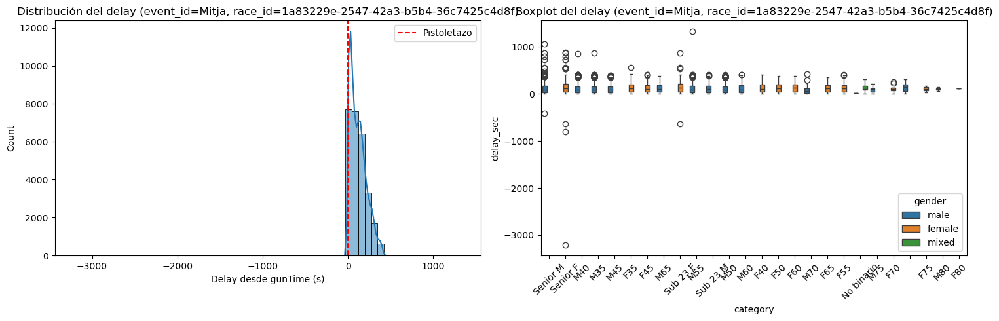

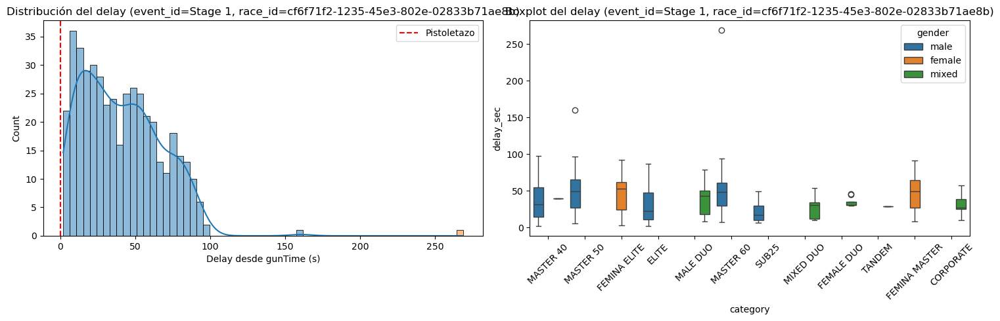

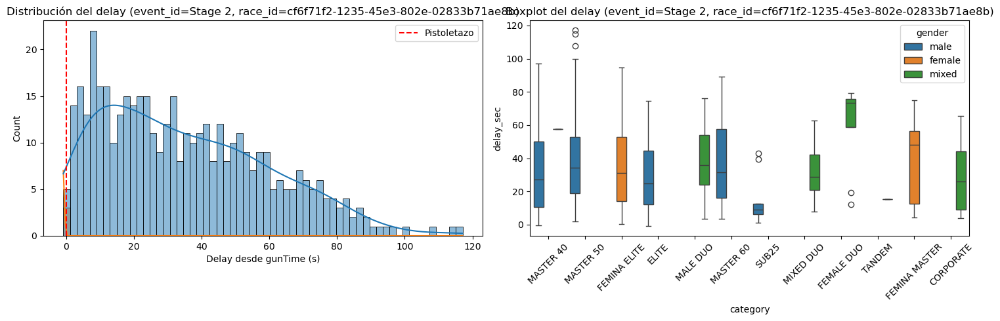

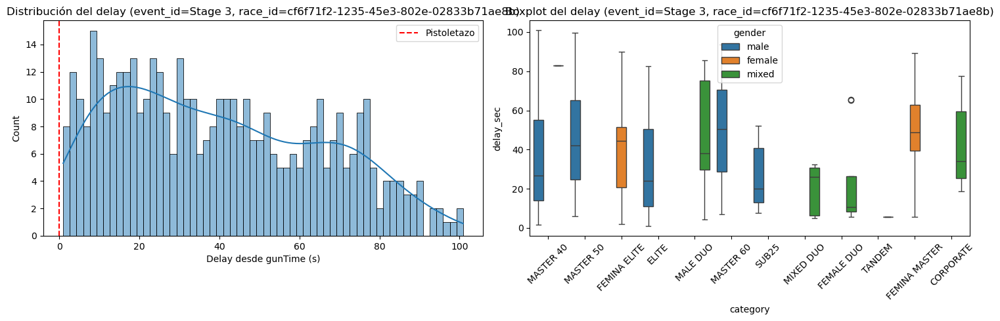

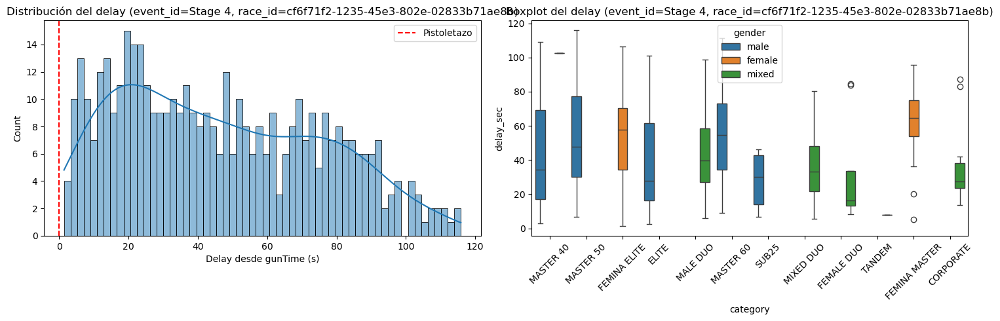

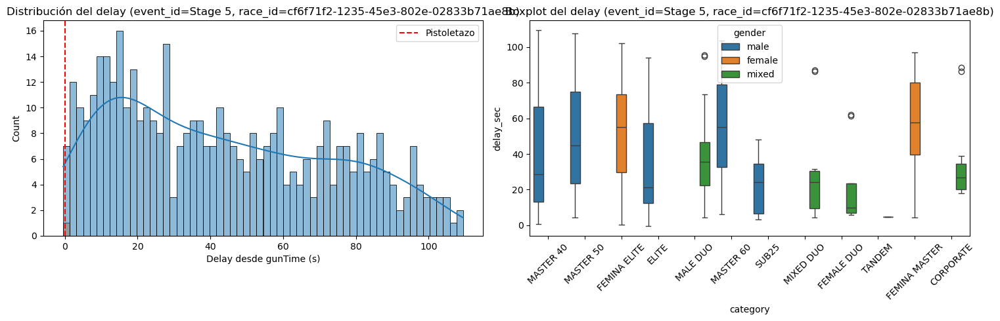

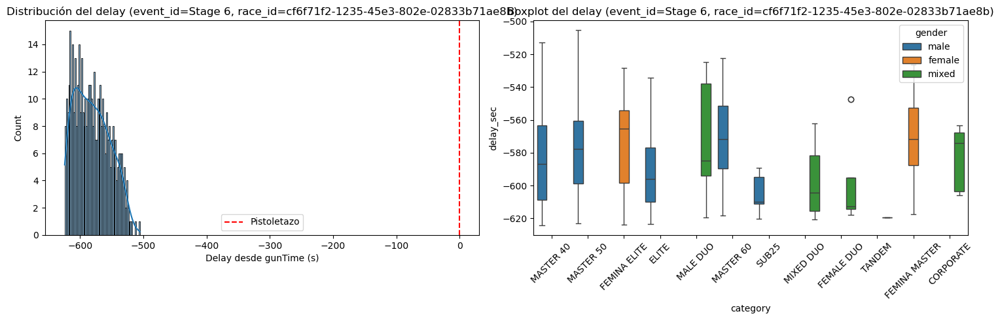

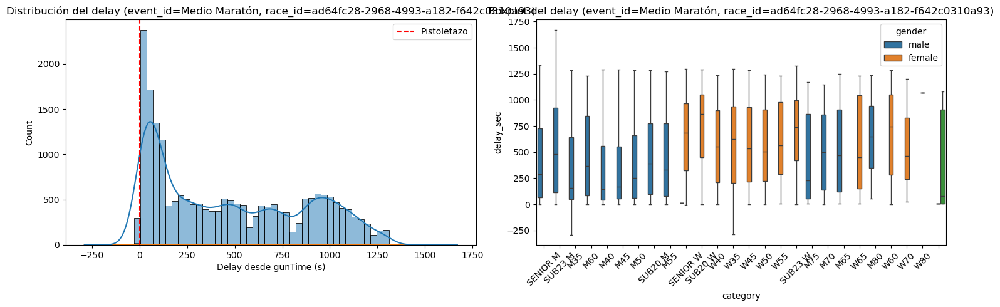

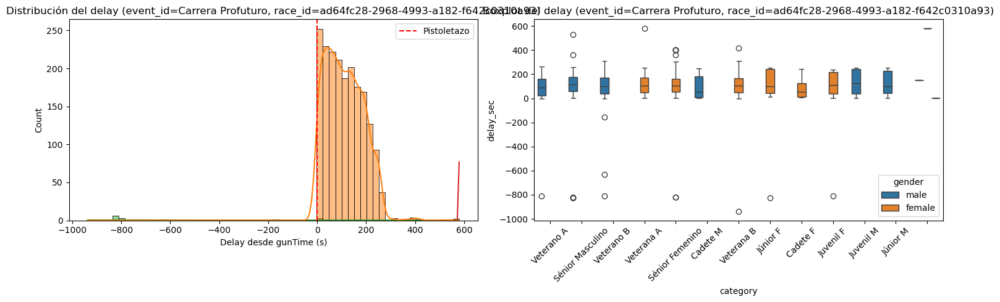

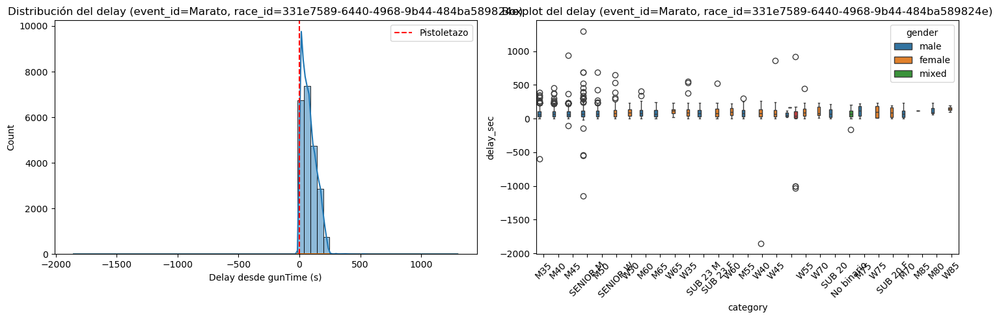

In [ ]:
print("Análisis robusto de consistencia de salida por carrera y oleadas")

if 'gender' not in athletes_events_df.columns:
    athletes_events_df = athletes_events_df.merge(
        athletes_df[['athlete_id', 'gender']], on='athlete_id', how='left'
    )

athletes_events_df['gunTime'] = pd.to_datetime(
    athletes_events_df['gunTime'], errors='coerce'
)
athletes_events_df['gunTime_local'] = athletes_events_df['gunTime']

athletes_events_df['startRawTime_dt'] = pd.to_datetime(
    athletes_events_df['startRawTime'], errors='coerce'
)

athletes_events_df['delay_sec'] = athletes_events_df['startNetTime_td'].dt.total_seconds()

def detectar_outliers(grupo, k=3, min_athletes=100):
    if len(grupo) < min_athletes:
        grupo['delay_category'] = 'No evaluado'
        grupo['upper_bound'] = np.nan
        grupo['percentile_95'] = np.nan
        grupo['percentile_99'] = np.nan
        grupo['tardio_95'] = False
        grupo['tardio_99'] = False
        return grupo
    
    # IQR
    Q1 = grupo['delay_sec'].quantile(0.25)
    Q3 = grupo['delay_sec'].quantile(0.75)
    IQR = Q3 - Q1
    upper_bound = Q3 + k * IQR

    # Percentiles
    p95 = grupo['delay_sec'].quantile(0.95)
    p99 = grupo['delay_sec'].quantile(0.99)

    grupo['delay_category'] = np.select(
        [
            grupo['delay_sec'] < 0,
            grupo['delay_sec'] > upper_bound
        ],
        ['Extremadamente temprana', 'Extremadamente tardía'],
        default='Normal'
    )
    grupo['upper_bound'] = upper_bound
    grupo['percentile_95'] = p95
    grupo['percentile_99'] = p99
    grupo['tardio_95'] = grupo['delay_sec'] > p95
    grupo['tardio_99'] = grupo['delay_sec'] > p99

    return grupo

gun_summary = (
    athletes_events_df.groupby(['race_id', 'gunTime_local', 'event_id'])
    .size()
    .reset_index(name='num_athletes')
    .sort_values(['race_id', 'gunTime_local', 'event_id'])
)
print("\n=== Pistoletazos detectados (gunTime por carrera y oleada) ===")
display(gun_summary)


athletes_events_df = athletes_events_df.groupby(
    ['race_id', 'gunTime_local', 'event_id'], group_keys=False
).apply(lambda g: detectar_outliers(g.copy()))  # usamos copy() para evitar warning de SettingWithCopy

delay_summary = athletes_events_df['delay_category'].value_counts(normalize=True) * 100
print("\n=== Distribución porcentual global del delay (IQR) ===")
display(delay_summary.round(2))

outliers_iqr = (athletes_events_df['delay_category'] == 'Extremadamente tardía').sum()
outliers_95 = athletes_events_df['tardio_95'].sum()
outliers_99 = athletes_events_df['tardio_99'].sum()
total_atletas = len(athletes_events_df)

print(f"\nAtletas tardíos según IQR: {outliers_iqr} ({100*outliers_iqr/total_atletas:.2f}%)")
print(f"Atletas tardíos según percentil 95: {outliers_95} ({100*outliers_95/total_atletas:.2f}%)")
print(f"Atletas tardíos según percentil 99: {outliers_99} ({100*outliers_99/total_atletas:.2f}%)")

resumen_por_carrera = (
    athletes_events_df.groupby(['event_id', 'race_id'])['delay_category']
    .value_counts(normalize=True)
    .mul(100)
    .rename('porcentaje')
    .reset_index()
)
print("\n=== Distribución porcentual del delay por carrera (IQR) ===")
display(resumen_por_carrera)

outliers_tardios = athletes_events_df[athletes_events_df['delay_category'] == 'Extremadamente tardía']
outliers_tempranos = athletes_events_df[athletes_events_df['delay_category'] == 'Extremadamente temprana']

print(f"\nAtletas con retrasos extremos (tardíos): {len(outliers_tardios)}")
display(outliers_tardios[['athlete_id', 'event_id', 'category', 'gender', 
                          'startTime_td', 'startRawTime_dt', 'delay_sec', 'delay_category', 'race_id', 'gunTime_local']].head(10))

print(f"\nAtletas que salieron antes (tempranos): {len(outliers_tempranos)}")
display(outliers_tempranos[['athlete_id', 'event_id', 'category', 'gender', 
                            'startTime_td', 'startRawTime_dt', 'delay_sec', 'delay_category', 'race_id', 'gunTime_local']].head(10))

for event in athletes_events_df['event_id'].unique():
    df_event = athletes_events_df[athletes_events_df['event_id'] == event]
    
    for race in df_event['race_id'].unique():
        df_race = df_event[df_event['race_id'] == race]

        if df_race['delay_sec'].dropna().shape[0] < 2:
            print(f"Saltando event_id={event}, race_id={race}: muy pocos datos ({len(df_race)} filas)")
            continue
        
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))
        
        sns.histplot(
            data=df_race,
            x='delay_sec',
            hue='delay_category',
            bins=60,
            kde=True,
            ax=axes[0]
        )
        axes[0].set_title(f"Distribución del delay (event_id={event}, race_id={race})")
        axes[0].set_xlabel("Delay desde gunTime (s)")
        axes[0].axvline(0, color='red', linestyle='--', label='Pistoletazo')
        axes[0].legend()
        
        sns.boxplot(
            data=df_race,
            x='category',
            y='delay_sec',
            hue='gender',
            ax=axes[1]
        )
        axes[1].set_title(f"Boxplot del delay (event_id={event}, race_id={race})")
        axes[1].tick_params(axis='x', rotation=45)
        
        plt.tight_layout()
        plt.show()

- Distribución global de delays

- - Casi todos los atletas salen “normales”:

- - 99.3 % dentro de lo esperado (IQR)

- - - Extremadamente tempranos: 0.63 %

- - - Extremadamente tardíos: 0.07 % (muy pocos, solo 65 atletas según IQR)

- - - La gran mayoría respeta los tiempos de salida, y los retrasos importantes son raros, en nuestra lógica.

- Distribución por carrera/evento

- - Eventos grandes como Marato o Medio Maratón: casi todos los atletas salen normales (>99 %).

- - Eventos más pequeños o stages (por ejemplo Stage 6):

- - Hay más atletas “extremadamente tempranos” (hasta 94 % en Stage 6 es “extremamente temprana”) → esto probablemente indica error con este evento.


- Cantidad de atletas extremos

- - Tardíos: 65 atletas (0.07 %) → muy raro

- - Tempranos: 554 atletas (0.63 %) → un poco más frecuente, pero sigue siendo minoría


- Patrón por evento y hora

- - Varios delays extremadamente tempranos corresponden a atletas que salieron segundos o minutos antes de su hora asignada (startTime < gunTime).

- - Los retrasos extremos son más esporádicos, algunos superan los 10–15 minutos.


- Conclusiones

- - La distribución global de startTime está muy concentrada cerca del gunTime.

- - Los outliers extremos son mínimos pero existentes.

- - Hay eventos que pueden tener errores no corregidos (como stage 6)

In [52]:
raros_df = athletes_events_df[
    athletes_events_df['delay_category'].isin(['Extremadamente temprana', 'Extremadamente tardía'])
]

porcentaje_raros_por_oleada = (
    raros_df['gunTime_local']
    .value_counts(normalize=True)
    .rename('porcentaje_sobre_raros')
    .mul(100)
    .reset_index()
    .rename(columns={'index': 'gunTime_local'})
    .sort_values('gunTime_local')
)

print("\n=== Distribución de casos raros por oleada (porcentaje sobre los raros) ===")
display(porcentaje_raros_por_oleada.round(2))

desglose_raros = (
    raros_df.groupby(['gunTime_local', 'delay_category'])
    .size()
    .groupby(level=0)
    .apply(lambda x: 100 * x / x.sum())
    .unstack(fill_value=0)
    .round(2)
)

desglose_raros = desglose_raros.loc[~desglose_raros.index.duplicated(keep='first')]

print("\n=== Desglose porcentual de tipos de rareza (tempranos/tardíos) por oleada ===")
display(desglose_raros)


=== Distribución de casos raros por oleada (porcentaje sobre los raros) ===


,gunTime_local,porcentaje_sobre_raros
17,2025-02-16 07:31:06+00:00,0.32
15,2025-02-16 07:40:32+00:00,0.48
12,2025-02-16 08:00:13+00:00,0.65
5,2025-02-16 08:10:11+00:00,1.78
16,2025-02-16 08:20:03+00:00,0.32
13,2025-02-16 08:30:09+00:00,0.65
1,2025-02-16 08:40:25+00:00,8.72
6,2025-03-16 07:31:15.272000+00:00,1.45
18,2025-03-16 07:40:06.273000+00:00,0.32
7,2025-03-16 07:45:23.272000+00:00,1.13



=== Desglose porcentual de tipos de rareza (tempranos/tardíos) por oleada ===


,delay_category,Extremadamente tardía,Extremadamente temprana
gunTime_local,gunTime_local,,
2025-02-16 07:31:06+00:00,2025-02-16 07:31:06+00:00,0.00,100.00
2025-02-16 07:40:32+00:00,2025-02-16 07:40:32+00:00,0.00,100.00
2025-02-16 08:00:13+00:00,2025-02-16 08:00:13+00:00,0.00,100.00
2025-02-16 08:10:11+00:00,2025-02-16 08:10:11+00:00,0.00,100.00
2025-02-16 08:20:03+00:00,2025-02-16 08:20:03+00:00,50.00,50.00
2025-02-16 08:30:09+00:00,2025-02-16 08:30:09+00:00,0.00,100.00
2025-02-16 08:40:25+00:00,2025-02-16 08:40:25+00:00,94.44,5.56
2025-03-16 07:31:15.272000+00:00,2025-03-16 07:31:15.272000+00:00,11.11,88.89
2025-03-16 07:40:06.273000+00:00,2025-03-16 07:40:06.273000+00:00,0.00,100.00


El número de gun times detectados y su distribución de atletas confirman la segmentación del evento en oleadas bien definidas (aproximadamente cada 10 minutos).

#### Estudio de meta


=== Análisis de META para race_id = 1a83229e-2547-42a3-b5b4-36c7425c4d8f, event_id = Mitja ===


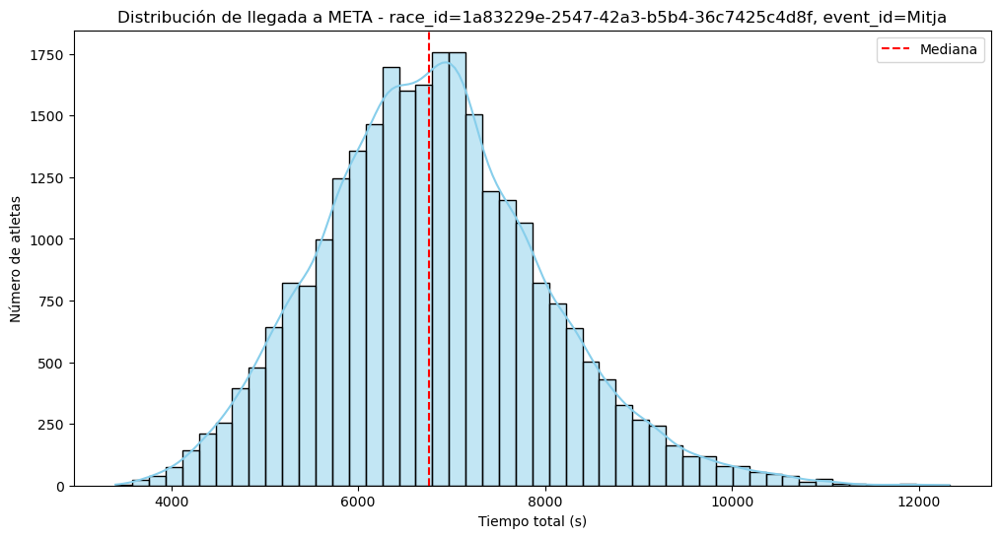

Mediana total a META: 6756.9 s
MAD: 777.6 s
Atletas outliers MAD: 1448 de 27163
Atletas outliers percentil 1: 271
Atletas outliers percentil 99: 271

Ejemplos de outliers MAD:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
1,160,0.20712,NaN,21097,Mitja,NaN,NaN,,NaN,4364800.0,NaN,6,4369570.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:43:55.570,NaN,160,2025-02-16 08:43:58.737,TS2P8 3,160,False,,NaN,Meta,NaN,0.0,2025-02-16 08:43:55.570,2025-02-16 08:43:55.570,False,,2025-02-16T08:43:55.570Z,4369570.0,2025-02-16 08:43:55.570,4369570.0,2,True,Meta,4369570,7.000000,media,0 days 01:12:44.800000,0 days 01:12:49.570000,NaT,0 days 01:12:49.570000,0 days 01:12:49.570000,0 days 01:12:49.570000,2025-02-16 07:31:10.770,4364.800
2,191,0.18266,NaN,21097,Mitja,NaN,NaN,,NaN,3848838.0,NaN,6,3853482.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:35:19.482,NaN,191,2025-02-16 08:35:22.974,TS2P8 3,191,False,,NaN,Meta,NaN,0.0,2025-02-16 08:35:19.482,2025-02-16 08:35:19.482,False,,2025-02-16T08:35:19.482Z,3853482.0,2025-02-16 08:35:19.482,3853482.0,2,True,Meta,3853482,7.000000,media,0 days 01:04:08.838000,0 days 01:04:13.482000,NaT,0 days 01:04:13.482000,0 days 01:04:13.482000,0 days 01:04:13.482000,2025-02-16 07:31:10.644,3848.838
3,191,0.18266,NaN,21097,Mitja,NaN,NaN,,NaN,3848838.0,NaN,6,3853482.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:35:19.482,NaN,191,2025-02-16 08:35:22.974,TS2P8 3,191,False,,NaN,Meta,NaN,0.0,2025-02-16 08:35:19.482,2025-02-16 08:35:19.482,False,,2025-02-16T08:35:19.482Z,3853482.0,2025-02-16 08:35:19.482,3853482.0,2,True,Meta,3853482,7.000000,media,0 days 01:04:08.838000,0 days 01:04:13.482000,NaT,0 days 01:04:13.482000,0 days 01:04:13.482000,0 days 01:04:13.482000,2025-02-16 07:31:10.644,3848.838
4,192,0.18659,NaN,21097,Mitja,NaN,NaN,,NaN,3931167.0,NaN,6,3936398.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:36:42.398,NaN,40192,2025-02-16 08:36:45.876,TS2P8 3,192,False,,NaN,Meta,NaN,0.0,2025-02-16 08:36:42.398,2025-02-16 08:36:42.398,False,,2025-02-16T08:36:42.398Z,3936398.0,2025-02-16 08:36:42.398,3936398.0,2,True,Meta,3936398,7.000000,media,0 days 01:05:31.167000,0 days 01:05:36.398000,NaT,0 days 01:05:36.398000,0 days 01:05:36.398000,0 days 01:05:36.398000,2025-02-16 07:31:11.231,3931.167
5,192,0.18659,NaN,21097,Mitja,NaN,NaN,,NaN,3931167.0,NaN,6,3936398.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:36:42.398,NaN,40192,2025-02-16 08:36:45.876,TS2P8 3,192,False,,NaN,Meta,NaN,0.0,2025-02-16 08:36:42.398,2025-02-16 08:36:42.398,False,,2025-02-16T08:36:42.398Z,3936398.0,2025-02-16 08:36:42.398,3936398.0,2,True,Meta,3936398,7.000000,media,0 days 01:05:31.167000,0 days 01:05:36.398000,NaT,0 days 01:05:36.398000,0 days 01:05:36.398000,0 days 01:05:36.398000,2025-02-16 07:31:11.231,3931.167
6,195,0.19062,NaN,21097,Mitja,NaN,NaN,,NaN,4014802.0,NaN,6,4021437.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:38:07.437,NaN,40195,2025-02-16 08:38:11.641,TS2P8 3,195,False,,NaN,Meta,NaN,0.0,2025-02-16 08:38:07.437,2025-02-16 08:38:07.437,False,,2025-02-16T08:38:07.437Z,4021437.0,2025-02-16 08:38:07.437,4021437.0,2,True,Meta,4021437,7.000000,media,0 days 01:06:54.802000,0 days 01:07:01.437000,NaT,0 days 01:07:01.437000,0 days 01:07:01.437000,0 days 01:07:01.437000,2025-02-16 07:31:12.635,4014.802
7,195,0.19062,NaN,21097,Mitja,NaN,NaN,,NaN,4014802.0,NaN,6,4021437.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:38:07.437,NaN,40195,2025-02-16 08:38:11.641,TS2P8 3,195,False,,NaN,Meta,NaN,0.0,2025-02-16 08:38:07.437,2025-02-16 08:38:07.437,False,,2025-02-16T08:38:07.437Z,4021437.0,2025-02-16 08:38:07.437,4021437.0,2,True,Meta,4021437,7.000000,media,0 days 01:06:54.802000,0 days 01:07:01


Ejemplos de outliers percentiles:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
2,191,0.18266,NaN,21097,Mitja,NaN,NaN,,NaN,3848838.0,NaN,6,3853482.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:35:19.482,NaN,191,2025-02-16 08:35:22.974,TS2P8 3,191,False,,NaN,Meta,NaN,0.0,2025-02-16 08:35:19.482,2025-02-16 08:35:19.482,False,,2025-02-16T08:35:19.482Z,3853482.0,2025-02-16 08:35:19.482,3853482.0,2,True,Meta,3853482,7.0,media,0 days 01:04:08.838000,0 days 01:04:13.482000,NaT,0 days 01:04:13.482000,0 days 01:04:13.482000,0 days 01:04:13.482000,2025-02-16 07:31:10.644,3848.838
3,191,0.18266,NaN,21097,Mitja,NaN,NaN,,NaN,3848838.0,NaN,6,3853482.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:35:19.482,NaN,191,2025-02-16 08:35:22.974,TS2P8 3,191,False,,NaN,Meta,NaN,0.0,2025-02-16 08:35:19.482,2025-02-16 08:35:19.482,False,,2025-02-16T08:35:19.482Z,3853482.0,2025-02-16 08:35:19.482,3853482.0,2,True,Meta,3853482,7.0,media,0 days 01:04:08.838000,0 days 01:04:13.482000,NaT,0 days 01:04:13.482000,0 days 01:04:13.482000,0 days 01:04:13.482000,2025-02-16 07:31:10.644,3848.838
4,192,0.18659,NaN,21097,Mitja,NaN,NaN,,NaN,3931167.0,NaN,6,3936398.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:36:42.398,NaN,40192,2025-02-16 08:36:45.876,TS2P8 3,192,False,,NaN,Meta,NaN,0.0,2025-02-16 08:36:42.398,2025-02-16 08:36:42.398,False,,2025-02-16T08:36:42.398Z,3936398.0,2025-02-16 08:36:42.398,3936398.0,2,True,Meta,3936398,7.0,media,0 days 01:05:31.167000,0 days 01:05:36.398000,NaT,0 days 01:05:36.398000,0 days 01:05:36.398000,0 days 01:05:36.398000,2025-02-16 07:31:11.231,3931.167
5,192,0.18659,NaN,21097,Mitja,NaN,NaN,,NaN,3931167.0,NaN,6,3936398.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:36:42.398,NaN,40192,2025-02-16 08:36:45.876,TS2P8 3,192,False,,NaN,Meta,NaN,0.0,2025-02-16 08:36:42.398,2025-02-16 08:36:42.398,False,,2025-02-16T08:36:42.398Z,3936398.0,2025-02-16 08:36:42.398,3936398.0,2,True,Meta,3936398,7.0,media,0 days 01:05:31.167000,0 days 01:05:36.398000,NaT,0 days 01:05:36.398000,0 days 01:05:36.398000,0 days 01:05:36.398000,2025-02-16 07:31:11.231,3931.167
6,195,0.19062,NaN,21097,Mitja,NaN,NaN,,NaN,4014802.0,NaN,6,4021437.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:38:07.437,NaN,40195,2025-02-16 08:38:11.641,TS2P8 3,195,False,,NaN,Meta,NaN,0.0,2025-02-16 08:38:07.437,2025-02-16 08:38:07.437,False,,2025-02-16T08:38:07.437Z,4021437.0,2025-02-16 08:38:07.437,4021437.0,2,True,Meta,4021437,7.0,media,0 days 01:06:54.802000,0 days 01:07:01.437000,NaT,0 days 01:07:01.437000,0 days 01:07:01.437000,0 days 01:07:01.437000,2025-02-16 07:31:12.635,4014.802
7,195,0.19062,NaN,21097,Mitja,NaN,NaN,,NaN,4014802.0,NaN,6,4021437.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:38:07.437,NaN,40195,2025-02-16 08:38:11.641,TS2P8 3,195,False,,NaN,Meta,NaN,0.0,2025-02-16 08:38:07.437,2025-02-16 08:38:07.437,False,,2025-02-16T08:38:07.437Z,4021437.0,2025-02-16 08:38:07.437,4021437.0,2,True,Meta,4021437,7.0,media,0 days 01:06:54.802000,0 days 01:07:01.437000,NaT,0 days 01:07:01.437000,0 days 01:07:01.437000,0 days 01:07:01.437000,2025-02-16 07:31:12.635,4014.802
98,1B1425ZA,0.18900,NaN,21097,Mitja,NaN,NaN,,NaN,3981200.0,NaN,6,3987280.0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,2025-02-16 08:37:33.280,NaN,597,2025-02-16 08:37:38.464,TS2P8 3,1B1425ZA,False,,NaN,Meta,NaN,0.0,2025-02-16 08:37:33.280,2025-02-16 08:37:33.280,False,,2025-02-16T08:37:33.280Z,3987280.0,2025-02-16 08:37:33.280,3987280.0,2,True,Meta,3987280,7.0,media,0 days 01:06:21.200000,0 days 01:06:27.280000,NaT,0 days 01:06


=== Análisis de META para race_id = cf6f71f2-1235-45e3-802e-02833b71ae8b, event_id = Stage 1 ===


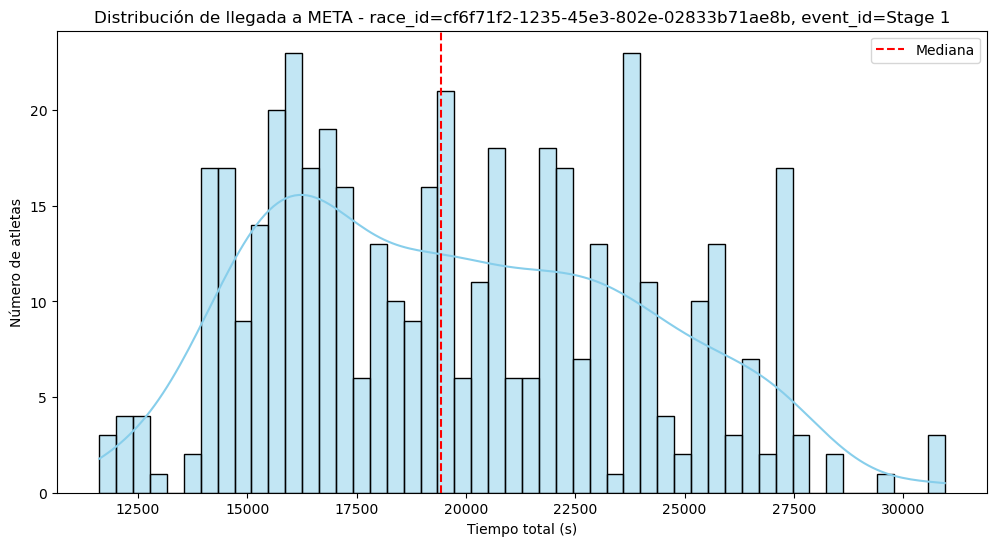

Mediana total a META: 19427.9 s
MAD: 3378.6 s
Atletas outliers MAD: 3 de 445
Atletas outliers percentil 1: 5
Atletas outliers percentil 99: 5

Ejemplos de outliers MAD:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27683,ed3c0f57-5bc7-5670-8de2-a5a9456c534a,0.34112,NaN,90999,Stage 1,NaN,NaN,,NaN,30950211.0,NaN,10,31041453.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-01 15:38:26.524,NaN,240,2025-05-01 15:38:51.183,TS2P8 243,ed3c0f57-5bc7-5670-8de2-a5a9456c534a,False,,NaN,E1 - META,NaN,0.0,2025-05-01 15:38:26.524,2025-05-01 15:38:26.524,False,,2025-05-01T15:38:26.524Z,31041453.0,2025-05-01 15:38:26.524,31041453.0,2,True,Meta,31041453,10.999997,stage,0 days 08:35:50.211000,0 days 08:37:21.453000,NaT,0 days 08:37:21.453000,0 days 08:37:21.453000,0 days 08:37:21.453000,2025-05-01 07:02:36.313,30950.211
28443,23e386ac-b354-5d95-8a18-67cd7cd83148,0.34113,NaN,90999,Stage 1,NaN,NaN,,NaN,30950158.0,NaN,10,31042630.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-01 15:38:27.701,NaN,209,2025-05-01 15:38:51.183,TS2P8 243,23e386ac-b354-5d95-8a18-67cd7cd83148,False,,NaN,E1 - META,NaN,0.0,2025-05-01 15:38:27.701,2025-05-01 15:38:27.701,False,,2025-05-01T15:38:27.701Z,31042630.0,2025-05-01 15:38:27.701,31042630.0,2,True,Meta,31042630,10.999997,stage,0 days 08:35:50.158000,0 days 08:37:22.630000,NaT,0 days 08:37:22.630000,0 days 08:37:22.630000,0 days 08:37:22.630000,2025-05-01 07:02:37.543,30950.158
28596,69eeb692-8c4c-5d96-90e1-910d66e7e8b2,0.34113,NaN,90999,Stage 1,NaN,NaN,,NaN,30949023.0,NaN,10,31042781.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-01 15:38:27.852,NaN,448,2025-05-01 15:38:51.183,TS2P8 243,69eeb692-8c4c-5d96-90e1-910d66e7e8b2,False,,NaN,E1 - META,NaN,0.0,2025-05-01 15:38:27.852,2025-05-01 15:38:27.852,False,,2025-05-01T15:38:27.852Z,31042781.0,2025-05-01 15:38:27.852,31042781.0,2,True,Meta,31042781,10.999997,stage,0 days 08:35:49.023000,0 days 08:37:22.781000,NaT,0 days 08:37:22.781000,0 days 08:37:22.781000,0 days 08:37:22.781000,2025-05-01 07:02:38.829,30949.023



Ejemplos de outliers percentiles:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27181,4d325944-3693-5adf-a199-43b47210f9db,0.12849,NaN,90999,Stage 1,True,NaN,,NaN,11615986.0,NaN,10,11692671.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-01 10:15:57.742,NaN,,NaT,,nan,NaN,,NaN,E1 - META,False,NaN,NaT,2025-05-01 10:15:57.742,NaN,,,NaN,NaT,NaN,nan,NaN,Meta,11692671,10.999999,stage,0 days 03:13:35.986000,0 days 03:14:52.671000,NaT,NaT,NaT,0 days 03:14:52.671000,2025-05-01 07:02:21.756,11615.986
27294,496b08ff-62c0-5a60-849f-1a99bcfe0f9e,0.13540,NaN,90999,Stage 1,NaN,NaN,,NaN,12317278.0,NaN,10,12321476.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-01 10:26:26.547,NaN,8,2025-05-01 10:26:29.848,TS2P8 243,496b08ff-62c0-5a60-849f-1a99bcfe0f9e,False,,NaN,E1 - META,NaN,0.0,2025-05-01 10:26:26.547,2025-05-01 10:26:26.547,False,,2025-05-01T10:26:26.547Z,12321476.0,2025-05-01 10:26:26.547,12321476.0,2,True,Meta,12321476,10.999999,stage,0 days 03:25:17.278000,0 days 03:25:21.476000,NaT,0 days 03:25:21.476000,0 days 03:25:21.476000,0 days 03:25:21.476000,2025-05-01 07:01:09.269,12317.278
27752,35b3cb57-c982-559f-9b1b-4411975ea175,0.12869,NaN,90999,Stage 1,NaN,NaN,,NaN,11708618.0,NaN,10,11710426.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-01 10:16:15.497,NaN,9,2025-05-01 10:16:34.926,TS2P8 243,35b3cb57-c982-559f-9b1b-4411975ea175,False,,NaN,E1 - META,NaN,0.0,2025-05-01 10:16:15.497,2025-05-01 10:16:15.497,False,,2025-05-01T10:16:15.497Z,11710426.0,2025-05-01 10:16:15.497,11710426.0,2,True,Meta,11710426,10.999999,stage,0 days 03:15:08.618000,0 days 03:15:10.426000,NaT,0 days 03:15:10.426000,0 days 03:15:10.426000,0 days 03:15:10.426000,2025-05-01 07:01:06.879,11708.618
27962,b09f286b-d893-5548-8bdc-64ba245e9604,0.12849,NaN,90999,Stage 1,NaN,NaN,,NaN,11689116.0,NaN,10,11692670.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-01 10:15:57.741,NaN,2,2025-05-01 10:16:04.510,TS2P8 243,b09f286b-d893-5548-8bdc-64ba245e9604,False,,NaN,E1 - META,NaN,0.0,2025-05-01 10:15:57.741,2025-05-01 10:15:57.741,False,,2025-05-01T10:15:57.741Z,11692670.0,2025-05-01 10:15:57.741,11692670.0,2,True,Meta,11692670,10.999999,stage,0 days 03:14:49.116000,0 days 03:14:52.670000,NaT,0 days 03:14:52.670000,0 days 03:14:52.670000,0 days 03:14:52.670000,2025-05-01 07:01:08.625,11689.116
29493,341b2256-a21f-5aa5-84f0-bd5ebb7ce25d,0.13540,NaN,90999,Stage 1,True,NaN,,NaN,12316944.0,NaN,10,12321477.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-01 10:26:26.548,NaN,,NaT,,nan,NaN,,NaN,E1 - META,False,NaN,NaT,2025-05-01 10:26:26.548,NaN,,,NaN,NaT,NaN,nan,NaN,Meta,12321477,10.999999,stage,0 days 03:25:16.944000,0 days 03:25:21.477000,NaT,NaT,NaT,0 days 03:25:21.477000,2025-05-01 07:01:09.604,12316.944
27556,15dde7fc-54de-5aa0-8a4e-464aea30342d,0.32420,NaN,90999,Stage 1,NaN,NaN,,NaN,29462239.0,NaN,10,29502007.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-01 15:12:47.078,NaN,390,2025-05-01 15:16:44.547,TS2P8 243,15dde7fc-54de-5aa0-8a4e-464aea30342d,False,,NaN,E1 - META,NaN,0.0,2025-05-01 15:12:47.078,2025-05-01 15:12:47.078,False,,2025-05-01T15:12:47.078Z,29502007.0,2025-05-01 15:12:47.078,29502007.0,2,True,Meta,29502007,10.999997,stage,0 days 08:11:02.239000,0 days 08:11:42.007000,NaT,0 days 08:11:42.007000,0 days 08:11:42.007000,0 days 08:11:42.007000,2025-05-01 07:01:44.839,29462.239
27683,ed3c0f57-5bc7-5670-8de2-a5a9456c534a,0.34112,NaN,90999,Stage 1,NaN,NaN,,NaN,30950211.0,NaN,10,31041453.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-01 15:38:26.524,NaN,240,2025-05-01 15:38:51.183,TS2P8 243,ed3c0f57-5bc7-5670-8de2-a5a9456c534


=== Análisis de META para race_id = cf6f71f2-1235-45e3-802e-02833b71ae8b, event_id = Stage 2 ===


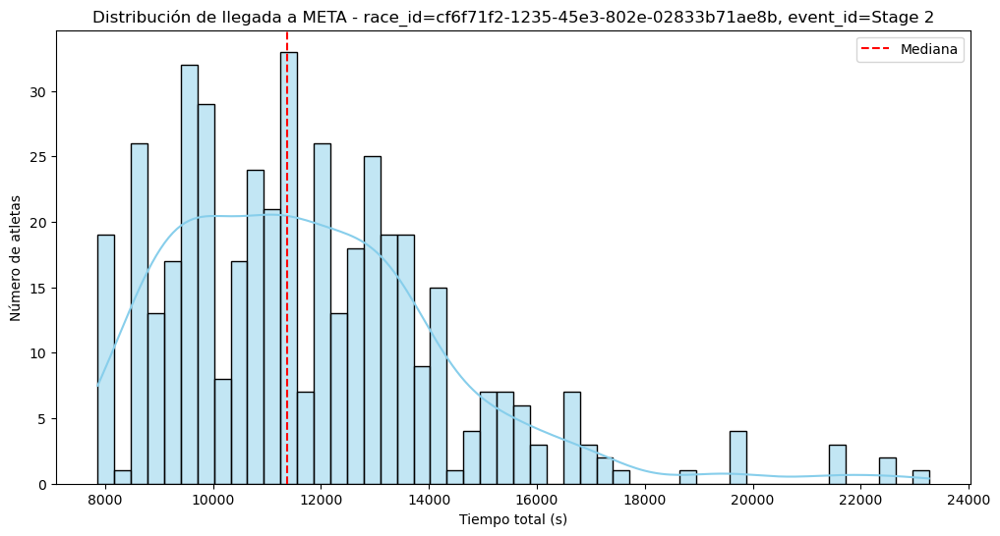

Mediana total a META: 11371.7 s
MAD: 1706.8 s
Atletas outliers MAD: 24 de 443
Atletas outliers percentil 1: 5
Atletas outliers percentil 99: 5

Ejemplos de outliers MAD:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27164,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,0.24984,NaN,68000,Stage 2,NaN,NaN,,NaN,16949850.0,NaN,4,16988800.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 16:03:08.800,NaN,290,2025-05-02 16:03:12.703,TS2P8 243,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,False,,NaN,E2 - META,NaN,0.0,2025-05-02 16:03:08.800,2025-05-02 16:03:08.800,False,,2025-05-02T16:03:08.800Z,16988800.0,2025-05-02 16:03:08.800,16988800.0,2,True,Meta,16988800,4.999998,stage,0 days 04:42:29.850000,0 days 04:43:08.800000,NaT,0 days 04:43:08.800000,0 days 04:43:08.800000,0 days 04:43:08.800000,2025-05-02 11:20:38.950,16949.850
27260,f9bac489-e75d-5587-953a-043f2ee9c4ca,0.25702,NaN,68000,Stage 2,NaN,NaN,,NaN,17441057.0,NaN,4,17477521.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 16:11:17.521,NaN,457,2025-05-02 16:13:44.613,TS2P8 243,f9bac489-e75d-5587-953a-043f2ee9c4ca,False,,NaN,E2 - META,NaN,0.0,2025-05-02 16:11:17.521,2025-05-02 16:11:17.521,False,,2025-05-02T16:11:17.521Z,17477521.0,2025-05-02 16:11:17.521,17477521.0,2,True,Meta,17477521,4.999998,stage,0 days 04:50:41.057000,0 days 04:51:17.521000,NaT,0 days 04:51:17.521000,0 days 04:51:17.521000,0 days 04:51:17.521000,2025-05-02 11:20:36.464,17441.057
27331,4223896e-afbc-5a37-8ae5-624bdd24d9ed,0.31637,NaN,68000,Stage 2,NaN,NaN,,NaN,21459468.0,NaN,4,21513068.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 17:18:33.068,NaN,13,2025-05-02 17:19:14.144,TS2P8 243,4223896e-afbc-5a37-8ae5-624bdd24d9ed,False,,NaN,E2 - META,NaN,0.0,2025-05-02 17:18:33.068,2025-05-02 17:18:33.068,False,,2025-05-02T17:18:33.068Z,21513068.0,2025-05-02 17:18:33.068,21513068.0,2,True,Meta,21513068,4.999998,stage,0 days 05:57:39.468000,0 days 05:58:33.068000,NaT,0 days 05:58:33.068000,0 days 05:58:33.068000,0 days 05:58:33.068000,2025-05-02 11:20:53.600,21459.468
27519,d60bcb98-913f-5234-8330-911129c7e102,0.25475,NaN,68000,Stage 2,NaN,NaN,,NaN,17294121.0,NaN,4,17323197.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 16:08:43.197,NaN,463,2025-05-02 16:13:44.613,TS2P8 243,d60bcb98-913f-5234-8330-911129c7e102,False,,NaN,E2 - META,NaN,0.0,2025-05-02 16:08:43.197,2025-05-02 16:08:43.197,False,,2025-05-02T16:08:43.197Z,17323197.0,2025-05-02 16:08:43.197,17323197.0,2,True,Meta,17323197,4.999998,stage,0 days 04:48:14.121000,0 days 04:48:43.197000,NaT,0 days 04:48:43.197000,0 days 04:48:43.197000,0 days 04:48:43.197000,2025-05-02 11:20:29.076,17294.121
27557,15dde7fc-54de-5aa0-8a4e-464aea30342d,0.33235,NaN,68000,Stage 2,True,NaN,,NaN,22542334.0,NaN,4,22600098.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 17:36:40.098,NaN,,NaT,,nan,NaN,,NaN,E2 - META,False,NaN,NaT,2025-05-02 17:36:40.098,NaN,,,NaN,NaT,NaN,nan,NaN,Meta,22600098,4.999998,stage,0 days 06:15:42.334000,0 days 06:16:40.098000,NaT,NaT,NaT,0 days 06:16:40.098000,2025-05-02 11:20:57.764,22542.334
27666,06cedd2a-fbaf-54b6-bd4b-8ba7feb6c735,0.24431,NaN,68000,Stage 2,NaN,NaN,,NaN,16590281.0,NaN,4,16612830.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 15:56:52.830,NaN,20,2025-05-02 15:56:55.893,TS2P8 243,06cedd2a-fbaf-54b6-bd4b-8ba7feb6c735,False,,NaN,E2 - META,NaN,0.0,2025-05-02 15:56:52.830,2025-05-02 15:56:52.830,False,,2025-05-02T15:56:52.830Z,16612830.0,2025-05-02 15:56:52.830,16612830.0,2,True,Meta,16612830,4.999998,stage,0 days 04:36:30.281000,0 days 04:36:52.830000,NaT,0 days 04:36:52.830000,0 days 04:36:52.830000,0 days 04:36:52.830000,2025-05-02 11:20:22.549,16590.281
27721,69b99897-b308-5b4f-98ea-60ad11015417,0.24593,NaN,68000,Stage 2,NaN,NaN


Ejemplos de outliers percentiles:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27182,4d325944-3693-5adf-a199-43b47210f9db,0.11679,NaN,68000,Stage 2,NaN,NaN,,NaN,7941446.0,NaN,4,7941446.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 12:54:26.446,NaN,1,2025-05-02 12:54:30.791,TS2P8 243,4d325944-3693-5adf-a199-43b47210f9db,False,,NaN,E2 - META,NaN,0.0,2025-05-02 12:54:26.446,2025-05-02 12:54:26.446,False,,2025-05-02T12:54:26.446Z,7941446.0,2025-05-02 12:54:26.446,7941446.0,2,True,Meta,7941446,4.999999,stage,0 days 02:12:21.446000,0 days 02:12:21.446000,NaT,0 days 02:12:21.446000,0 days 02:12:21.446000,0 days 02:12:21.446000,2025-05-02 10:42:04.529,7941.917
27753,35b3cb57-c982-559f-9b1b-4411975ea175,0.11679,NaN,68000,Stage 2,NaN,NaN,,NaN,7940628.0,NaN,4,7941388.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 12:54:26.388,NaN,9,2025-05-02 12:54:30.791,TS2P8 243,35b3cb57-c982-559f-9b1b-4411975ea175,False,,NaN,E2 - META,NaN,0.0,2025-05-02 12:54:26.388,2025-05-02 12:54:26.388,False,,2025-05-02T12:54:26.388Z,7941388.0,2025-05-02 12:54:26.388,7941388.0,2,True,Meta,7941388,4.999999,stage,0 days 02:12:20.628000,0 days 02:12:21.388000,NaT,0 days 02:12:21.388000,0 days 02:12:21.388000,0 days 02:12:21.388000,2025-05-02 10:42:05.760,7940.628
27963,b09f286b-d893-5548-8bdc-64ba245e9604,0.11679,NaN,68000,Stage 2,True,NaN,,NaN,7941447.0,NaN,4,7941447.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 12:54:26.447,NaN,,NaT,,nan,NaN,,NaN,E2 - META,False,NaN,NaT,2025-05-02 12:54:26.447,NaN,,,NaN,NaT,NaN,nan,NaN,Meta,7941447,4.999999,stage,0 days 02:12:21.447000,0 days 02:12:21.447000,NaT,NaT,NaT,0 days 02:12:21.447000,2025-05-02 10:42:04.199,7942.248
28177,21ff2d4d-a5c6-552c-ae14-08a17f94db60,0.11565,NaN,68000,Stage 2,True,NaN,,NaN,7861835.0,NaN,4,7863919.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 12:53:08.919,NaN,,NaT,,nan,NaN,,NaN,E2 - META,False,NaN,NaT,2025-05-02 12:53:08.919,NaN,,,NaN,NaT,NaN,nan,NaN,Meta,7863919,4.999999,stage,0 days 02:11:01.835000,0 days 02:11:03.919000,NaT,NaT,NaT,0 days 02:11:03.919000,2025-05-02 10:42:07.084,7861.835
29418,9ef98b72-d122-533c-968e-394d879f3c3c,0.11565,NaN,68000,Stage 2,NaN,NaN,,NaN,7862912.0,NaN,4,7863918.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 12:53:08.918,NaN,12,2025-05-02 12:53:12.360,TS2P8 243,9ef98b72-d122-533c-968e-394d879f3c3c,False,,NaN,E2 - META,NaN,0.0,2025-05-02 12:53:08.918,2025-05-02 12:53:08.918,False,,2025-05-02T12:53:08.918Z,7863918.0,2025-05-02 12:53:08.918,7863918.0,2,True,Meta,7863918,4.999999,stage,0 days 02:11:02.912000,0 days 02:11:03.918000,NaT,0 days 02:11:03.918000,0 days 02:11:03.918000,0 days 02:11:03.918000,2025-05-02 10:42:06.006,7862.912
27331,4223896e-afbc-5a37-8ae5-624bdd24d9ed,0.31637,NaN,68000,Stage 2,NaN,NaN,,NaN,21459468.0,NaN,4,21513068.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 17:18:33.068,NaN,13,2025-05-02 17:19:14.144,TS2P8 243,4223896e-afbc-5a37-8ae5-624bdd24d9ed,False,,NaN,E2 - META,NaN,0.0,2025-05-02 17:18:33.068,2025-05-02 17:18:33.068,False,,2025-05-02T17:18:33.068Z,21513068.0,2025-05-02 17:18:33.068,21513068.0,2,True,Meta,21513068,4.999998,stage,0 days 05:57:39.468000,0 days 05:58:33.068000,NaT,0 days 05:58:33.068000,0 days 05:58:33.068000,0 days 05:58:33.068000,2025-05-02 11:20:53.600,21459.468
27557,15dde7fc-54de-5aa0-8a4e-464aea30342d,0.33235,NaN,68000,Stage 2,True,NaN,,NaN,22542334.0,NaN,4,22600098.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-02 17:36:40.098,NaN,,NaT,,nan,NaN,,NaN,E2 - META,False,NaN,NaT,2025-05-02 17:36:40.098,NaN,,,NaN,NaT,NaN,nan,NaN,Meta,22600098,4.99


=== Análisis de META para race_id = cf6f71f2-1235-45e3-802e-02833b71ae8b, event_id = Stage 3 ===


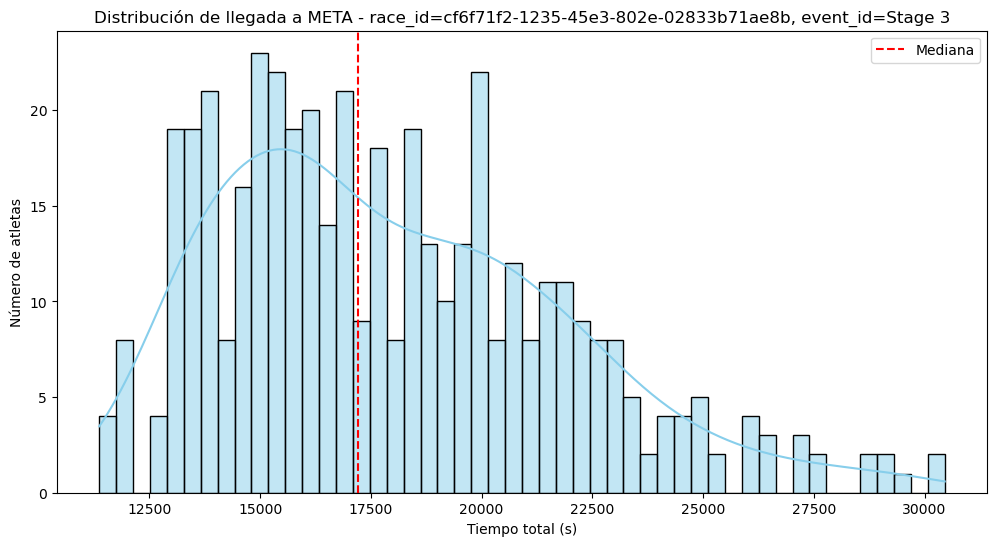

Mediana total a META: 17197.3 s
MAD: 2740.3 s
Atletas outliers MAD: 19 de 446
Atletas outliers percentil 1: 5
Atletas outliers percentil 99: 5

Ejemplos de outliers MAD:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27165,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,0.30464,NaN,89996,Stage 3,NaN,NaN,,NaN,27355408.0,NaN,10,27416569.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 14:40:06.747,NaN,290,2025-05-03 14:40:11.899,TS2P8 243,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,False,,NaN,E3 - META,NaN,0.0,2025-05-03 14:40:06.747,2025-05-03 14:40:06.747,False,,2025-05-03T14:40:06.747Z,27416569.0,2025-05-03 14:40:06.747,27416569.0,2,True,Meta,27416569,10.999997,stage,0 days 07:35:55.408000,0 days 07:36:56.569000,NaT,0 days 07:36:56.569000,0 days 07:36:56.569000,0 days 07:36:56.569000,2025-05-03 07:04:11.339,27355.408
27261,f9bac489-e75d-5587-953a-043f2ee9c4ca,0.30948,NaN,89996,Stage 3,NaN,NaN,,NaN,27759661.0,NaN,10,27852246.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 14:47:22.424,NaN,457,2025-05-03 14:47:27.226,TS2P8 3,f9bac489-e75d-5587-953a-043f2ee9c4ca,False,,NaN,E3 - META,NaN,0.0,2025-05-03 14:47:22.424,2025-05-03 14:47:22.424,False,,2025-05-03T14:47:22.424Z,27852246.0,2025-05-03 14:47:22.424,27852246.0,2,True,Meta,27852246,10.999997,stage,0 days 07:42:39.661000,0 days 07:44:12.246000,NaT,0 days 07:44:12.246000,0 days 07:44:12.246000,0 days 07:44:12.246000,2025-05-03 07:04:42.763,27759.661
27684,ed3c0f57-5bc7-5670-8de2-a5a9456c534a,0.32327,NaN,89996,Stage 3,NaN,NaN,,NaN,29003897.0,NaN,10,29093122.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 15:08:03.300,NaN,240,2025-05-03 15:08:06.528,TS2P8 243,ed3c0f57-5bc7-5670-8de2-a5a9456c534a,False,,NaN,E3 - META,NaN,0.0,2025-05-03 15:08:03.300,2025-05-03 15:08:03.300,False,,2025-05-03T15:08:03.300Z,29093122.0,2025-05-03 15:08:03.300,29093122.0,2,True,Meta,29093122,10.999997,stage,0 days 08:03:23.897000,0 days 08:04:53.122000,NaT,0 days 08:04:53.122000,0 days 08:04:53.122000,0 days 08:04:53.122000,2025-05-03 07:04:39.403,29003.897
27848,2f96ded9-1db9-55dd-ad34-45039f6302d0,0.30948,NaN,89996,Stage 3,NaN,NaN,,NaN,27752060.0,NaN,10,27851855.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 14:47:22.033,NaN,35090,2025-05-03 14:47:25.720,TS2P8 243,2f96ded9-1db9-55dd-ad34-45039f6302d0,False,,NaN,E3 - META,NaN,0.0,2025-05-03 14:47:22.033,2025-05-03 14:47:22.033,False,,2025-05-03T14:47:22.033Z,27851855.0,2025-05-03 14:47:22.033,27851855.0,2,True,Meta,27851855,10.999997,stage,0 days 07:42:32.060000,0 days 07:44:11.855000,NaT,0 days 07:44:11.855000,0 days 07:44:11.855000,0 days 07:44:11.855000,2025-05-03 07:04:49.973,27752.060
28036,5dfb0ad8-6857-5875-b4db-e67220e006bf,0.31861,NaN,89996,Stage 3,NaN,NaN,,NaN,28610493.0,NaN,10,28673712.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 15:01:03.890,NaN,439,2025-05-03 15:01:09.378,TS2P8 243,5dfb0ad8-6857-5875-b4db-e67220e006bf,False,,NaN,E3 - META,NaN,0.0,2025-05-03 15:01:03.890,2025-05-03 15:01:03.890,False,,2025-05-03T15:01:03.890Z,28673712.0,2025-05-03 15:01:03.890,28673712.0,2,True,Meta,28673712,10.999997,stage,0 days 07:56:50.493000,0 days 07:57:53.712000,NaT,0 days 07:57:53.712000,0 days 07:57:53.712000,0 days 07:57:53.712000,2025-05-03 07:04:13.397,28610.493
28066,3304619f-941a-58cb-8d8f-ed03b6665ae7,0.29083,NaN,89996,Stage 3,NaN,NaN,,NaN,26101008.0,NaN,10,26173913.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 14:19:24.091,NaN,223,2025-05-03 14:19:25.515,TS2P8 243,3304619f-941a-58cb-8d8f-ed03b6665ae7,False,,NaN,E3 - META,NaN,0.0,2025-05-03 14:19:24.091,2025-05-03 14:19:24.091,False,,2025-05-03T14:19:24.091Z,26173913.0,2025-05-03 14:19:24.091,26173913.0,2,True,Meta,26173913,10.999997,stage,0 days 07:15:01.008000,0 days 07:1


Ejemplos de outliers percentiles:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27754,35b3cb57-c982-559f-9b1b-4411975ea175,0.12634,NaN,89996,Stage 3,True,NaN,,NaN,11368318.0,NaN,10,11370494.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 10:12:40.672,NaN,,NaT,,nan,NaN,,NaN,E3 - META,False,NaN,NaT,2025-05-03 10:12:40.672,NaN,,,NaN,NaT,NaN,nan,NaN,Meta,11370494,10.999999,stage,0 days 03:09:28.318000,0 days 03:09:30.494000,NaT,NaT,NaT,0 days 03:09:30.494000,2025-05-03 07:03:12.354,11368.318
27784,c690c665-7cf0-5934-86a1-c9703823df0b,0.12853,NaN,89996,Stage 3,NaN,NaN,,NaN,11565813.0,NaN,10,11567602.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 10:15:57.780,NaN,16,2025-05-03 10:16:00.649,TS2P8 243,c690c665-7cf0-5934-86a1-c9703823df0b,False,,NaN,E3 - META,NaN,0.0,2025-05-03 10:15:57.780,2025-05-03 10:15:57.780,False,,2025-05-03T10:15:57.780Z,11567602.0,2025-05-03 10:15:57.780,11567602.0,2,True,Meta,11567602,10.999999,stage,0 days 03:12:45.813000,0 days 03:12:47.602000,NaT,0 days 03:12:47.602000,0 days 03:12:47.602000,0 days 03:12:47.602000,2025-05-03 07:03:11.967,11565.813
27964,b09f286b-d893-5548-8bdc-64ba245e9604,0.12634,NaN,89996,Stage 3,True,NaN,,NaN,11369541.0,NaN,10,11370493.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 10:12:40.671,NaN,,NaT,,nan,NaN,,NaN,E3 - META,False,NaN,NaT,2025-05-03 10:12:40.671,NaN,,,NaN,NaT,NaN,nan,NaN,Meta,11370493,10.999999,stage,0 days 03:09:29.541000,0 days 03:09:30.493000,NaT,NaT,NaT,0 days 03:09:30.493000,2025-05-03 07:03:11.130,11369.541
28178,21ff2d4d-a5c6-552c-ae14-08a17f94db60,0.12634,NaN,89996,Stage 3,NaN,NaN,,NaN,11367363.0,NaN,10,11370491.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 10:12:40.669,NaN,3,2025-05-03 10:12:44.266,TS2P8 243,21ff2d4d-a5c6-552c-ae14-08a17f94db60,False,,NaN,E3 - META,NaN,0.0,2025-05-03 10:12:40.669,2025-05-03 10:12:40.669,False,,2025-05-03T10:12:40.669Z,11370491.0,2025-05-03 10:12:40.669,11370491.0,2,True,Meta,11370491,10.999999,stage,0 days 03:09:27.363000,0 days 03:09:30.491000,NaT,0 days 03:09:30.491000,0 days 03:09:30.491000,0 days 03:09:30.491000,2025-05-03 07:03:13.306,11367.363
28404,1f99fe22-a93d-5198-9eb5-df83def8cefa,0.13159,NaN,89996,Stage 3,NaN,NaN,,NaN,11839732.0,NaN,10,11842465.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 10:20:32.643,NaN,58,2025-05-03 10:20:37.232,TS2P8 243,1f99fe22-a93d-5198-9eb5-df83def8cefa,False,,NaN,E3 - META,NaN,0.0,2025-05-03 10:20:32.643,2025-05-03 10:20:32.643,False,,2025-05-03T10:20:32.643Z,11842465.0,2025-05-03 10:20:32.643,11842465.0,2,True,Meta,11842465,10.999999,stage,0 days 03:17:19.732000,0 days 03:17:22.465000,NaT,0 days 03:17:22.465000,0 days 03:17:22.465000,0 days 03:17:22.465000,2025-05-03 07:03:12.911,11839.732
27684,ed3c0f57-5bc7-5670-8de2-a5a9456c534a,0.32327,NaN,89996,Stage 3,NaN,NaN,,NaN,29003897.0,NaN,10,29093122.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 15:08:03.300,NaN,240,2025-05-03 15:08:06.528,TS2P8 243,ed3c0f57-5bc7-5670-8de2-a5a9456c534a,False,,NaN,E3 - META,NaN,0.0,2025-05-03 15:08:03.300,2025-05-03 15:08:03.300,False,,2025-05-03T15:08:03.300Z,29093122.0,2025-05-03 15:08:03.300,29093122.0,2,True,Meta,29093122,10.999997,stage,0 days 08:03:23.897000,0 days 08:04:53.122000,NaT,0 days 08:04:53.122000,0 days 08:04:53.122000,0 days 08:04:53.122000,2025-05-03 07:04:39.403,29003.897
28445,23e386ac-b354-5d95-8a18-67cd7cd83148,0.33934,NaN,89996,Stage 3,NaN,NaN,,NaN,30449670.0,NaN,10,30539562.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-03 15:32:09.740,NaN,209,2025-05-03 15:32:14.093,TS2P8 243,23e386ac-b354-5d95-8a18-67cd7cd83


=== Análisis de META para race_id = cf6f71f2-1235-45e3-802e-02833b71ae8b, event_id = Stage 4 ===


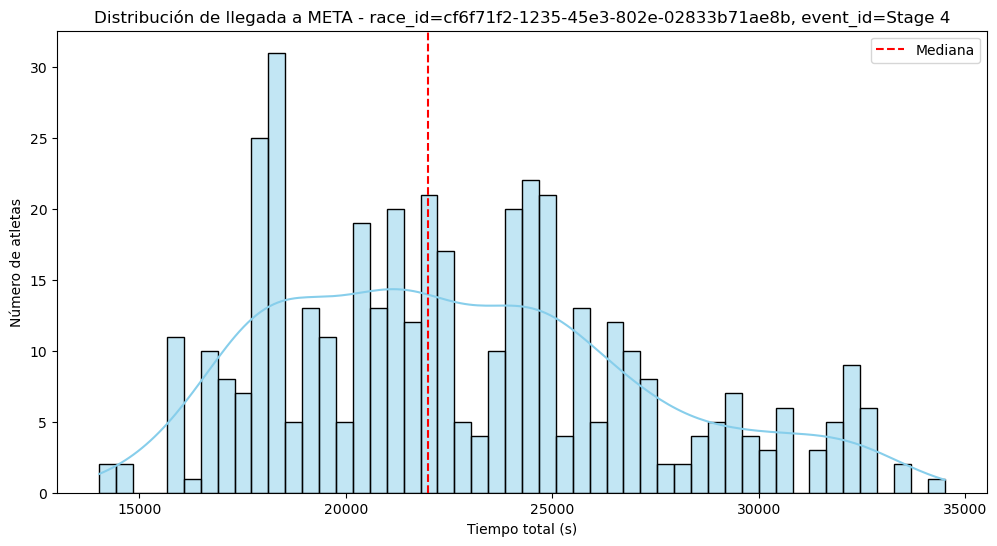

Mediana total a META: 21999.4 s
MAD: 3070.0 s
Atletas outliers MAD: 26 de 426
Atletas outliers percentil 1: 5
Atletas outliers percentil 99: 5

Ejemplos de outliers MAD:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27166,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,0.48783,NaN,104000,Stage 4,NaN,NaN,,NaN,50665971.0,NaN,10,32734330.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 16:08:18.716,NaN,290,2025-05-04 16:08:21.647,TS2P8 243,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,False,,NaN,E4 - META,NaN,0.0,2025-05-04 16:08:18.716,2025-05-04 16:08:18.716,False,,2025-05-04T16:08:18.716Z,32734330.0,2025-05-04 16:08:18.716,32734330.0,2,True,Meta,50734330,10.999995,stage,0 days 14:04:25.971000,0 days 09:05:34.330000,NaT,0 days 09:05:34.330000,0 days 09:05:34.330000,0 days 14:05:34.330000,2025-05-04 07:03:52.745,32665.971
27327,f4245c5a-8811-51c0-b718-8b016f6b8cb5,0.48778,NaN,104000,Stage 4,NaN,NaN,,NaN,50686272.0,NaN,10,32729420.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 16:08:13.806,NaN,400,2025-05-04 16:08:17.002,TS2P8 243,f4245c5a-8811-51c0-b718-8b016f6b8cb5,False,,NaN,E4 - META,NaN,0.0,2025-05-04 16:08:13.806,2025-05-04 16:08:13.806,False,,2025-05-04T16:08:13.806Z,32729420.0,2025-05-04 16:08:13.806,32729420.0,2,True,Meta,50729420,10.999995,stage,0 days 14:04:46.272000,0 days 09:05:29.420000,NaT,0 days 09:05:29.420000,0 days 09:05:29.420000,0 days 14:05:29.420000,2025-05-04 07:03:27.534,32686.272
27345,2e9a0ae4-542a-5766-be7a-a00b2bae2033,0.48216,NaN,104000,Stage 4,NaN,NaN,,NaN,50072032.0,NaN,10,32144719.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 15:58:29.105,NaN,221,2025-05-04 15:58:32.690,TS2P8 243,2e9a0ae4-542a-5766-be7a-a00b2bae2033,False,,NaN,E4 - META,NaN,0.0,2025-05-04 15:58:29.105,2025-05-04 15:58:29.105,False,,2025-05-04T15:58:29.105Z,32144719.0,2025-05-04 15:58:29.105,32144719.0,2,True,Meta,50144719,10.999995,stage,0 days 13:54:32.032000,0 days 08:55:44.719000,NaT,0 days 08:55:44.719000,0 days 08:55:44.719000,0 days 13:55:44.719000,2025-05-04 07:03:57.073,32072.032
27668,06cedd2a-fbaf-54b6-bd4b-8ba7feb6c735,0.30991,NaN,104000,Stage 4,NaN,NaN,,NaN,32178092.0,NaN,10,32230223.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 15:59:54.609,NaN,20,2025-05-04 15:59:57.673,TS2P8 243,06cedd2a-fbaf-54b6-bd4b-8ba7feb6c735,False,,NaN,E4 - META,NaN,0.0,2025-05-04 15:59:54.609,2025-05-04 15:59:54.609,False,,2025-05-04T15:59:54.609Z,32230223.0,2025-05-04 15:59:54.609,32230223.0,2,True,Meta,32230223,10.999997,stage,0 days 08:56:18.092000,0 days 08:57:10.223000,NaT,0 days 08:57:10.223000,0 days 08:57:10.223000,0 days 08:57:10.223000,2025-05-04 07:03:36.517,32178.092
27926,0a6e3323-3dac-5f3e-8fd0-1bd50da1b34f,0.47920,NaN,104000,Stage 4,NaN,NaN,,NaN,49737868.0,NaN,10,31836516.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 15:53:20.902,NaN,125,2025-05-04 15:53:24.832,TS2P8 243,0a6e3323-3dac-5f3e-8fd0-1bd50da1b34f,False,,NaN,E4 - META,NaN,0.0,2025-05-04 15:53:20.902,2025-05-04 15:53:20.902,False,,2025-05-04T15:53:20.902Z,31836516.0,2025-05-04 15:53:20.902,31836516.0,2,True,Meta,49836516,10.999995,stage,0 days 13:48:57.868000,0 days 08:50:36.516000,NaT,0 days 08:50:36.516000,0 days 08:50:36.516000,0 days 13:50:36.516000,2025-05-04 07:04:23.034,31737.868
27932,f692b6a4-11fa-5225-bc0a-c04da4d986b7,0.47779,NaN,104000,Stage 4,NaN,NaN,,NaN,49658351.0,NaN,10,31689728.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 15:50:54.114,NaN,176,2025-05-04 15:50:57.917,TS2P8 243,f692b6a4-11fa-5225-bc0a-c04da4d986b7,False,,NaN,E4 - META,NaN,0.0,2025-05-04 15:50:54.114,2025-05-04 15:50:54.114,False,,2025-05-04T15:50:54.114Z,31689728.0,2025-05-04 15:50:54.114,31689728.0,2,True,Meta,49689728,10.999995,stage,0 days 13:47:38.351000,0 days


Ejemplos de outliers percentiles:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27184,4d325944-3693-5adf-a199-43b47210f9db,0.13530,NaN,104000,Stage 4,NaN,NaN,,NaN,14026555.0,NaN,10,14070787.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 10:57:15.173,NaN,1,2025-05-04 10:57:19.054,TS2P8 243,4d325944-3693-5adf-a199-43b47210f9db,False,,NaN,E4 - META,NaN,0.0,2025-05-04 10:57:15.173,2025-05-04 10:57:15.173,False,,2025-05-04T10:57:15.173Z,14070787.0,2025-05-04 10:57:15.173,14070787.0,2,True,Meta,14070787,10.999999,stage,0 days 03:53:46.555000,0 days 03:54:30.787000,NaT,0 days 03:54:30.787000,0 days 03:54:30.787000,0 days 03:54:30.787000,2025-05-04 07:03:28.618,14026.555
27755,35b3cb57-c982-559f-9b1b-4411975ea175,0.13530,NaN,104000,Stage 4,True,NaN,,NaN,14068267.0,NaN,10,14070800.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 10:57:15.186,NaN,,NaT,,nan,NaN,,NaN,E4 - META,False,NaN,NaT,2025-05-04 10:57:15.186,NaN,,,NaN,NaT,NaN,nan,NaN,Meta,14070800,10.999999,stage,0 days 03:54:28.267000,0 days 03:54:30.800000,NaT,NaT,NaT,0 days 03:54:30.800000,2025-05-04 07:02:46.919,14068.267
27965,b09f286b-d893-5548-8bdc-64ba245e9604,0.14152,NaN,104000,Stage 4,NaN,NaN,,NaN,14714851.0,NaN,10,14718324.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 11:08:02.710,NaN,2,2025-05-04 11:08:06.261,TS2P8 243,b09f286b-d893-5548-8bdc-64ba245e9604,False,,NaN,E4 - META,NaN,0.0,2025-05-04 11:08:02.710,2025-05-04 11:08:02.710,False,,2025-05-04T11:08:02.710Z,14718324.0,2025-05-04 11:08:02.710,14718324.0,2,True,Meta,14718324,10.999999,stage,0 days 04:05:14.851000,0 days 04:05:18.324000,NaT,0 days 04:05:18.324000,0 days 04:05:18.324000,0 days 04:05:18.324000,2025-05-04 07:02:47.859,14714.851
29125,0ef12dba-e013-58ab-b4ab-65a1a1a21889,0.15211,NaN,104000,Stage 4,NaN,NaN,,NaN,15813613.0,NaN,10,15819061.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 11:26:23.447,NaN,78,2025-05-04 11:26:27.937,TS2P8 243,0ef12dba-e013-58ab-b4ab-65a1a1a21889,False,,NaN,E4 - META,NaN,0.0,2025-05-04 11:26:23.447,2025-05-04 11:26:23.447,False,,2025-05-04T11:26:23.447Z,15819061.0,2025-05-04 11:26:23.447,15819061.0,2,True,Meta,15819061,10.999998,stage,0 days 04:23:33.613000,0 days 04:23:39.061000,NaT,0 days 04:23:39.061000,0 days 04:23:39.061000,0 days 04:23:39.061000,2025-05-04 07:02:49.834,15813.613
29420,9ef98b72-d122-533c-968e-394d879f3c3c,0.14152,NaN,104000,Stage 4,True,NaN,,NaN,14714480.0,NaN,10,14718400.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 11:08:02.786,NaN,,NaT,,nan,NaN,,NaN,E4 - META,False,NaN,NaT,2025-05-04 11:08:02.786,NaN,,,NaN,NaT,NaN,nan,NaN,Meta,14718400,10.999999,stage,0 days 04:05:14.480000,0 days 04:05:18.400000,NaT,NaT,NaT,0 days 04:05:18.400000,2025-05-04 07:02:48.306,14714.480
27327,f4245c5a-8811-51c0-b718-8b016f6b8cb5,0.48778,NaN,104000,Stage 4,NaN,NaN,,NaN,50686272.0,NaN,10,32729420.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 16:08:13.806,NaN,400,2025-05-04 16:08:17.002,TS2P8 243,f4245c5a-8811-51c0-b718-8b016f6b8cb5,False,,NaN,E4 - META,NaN,0.0,2025-05-04 16:08:13.806,2025-05-04 16:08:13.806,False,,2025-05-04T16:08:13.806Z,32729420.0,2025-05-04 16:08:13.806,32729420.0,2,True,Meta,50729420,10.999995,stage,0 days 14:04:46.272000,0 days 09:05:29.420000,NaT,0 days 09:05:29.420000,0 days 09:05:29.420000,0 days 14:05:29.420000,2025-05-04 07:03:27.534,32686.272
28037,5dfb0ad8-6857-5875-b4db-e67220e006bf,0.50573,NaN,104000,Stage 4,NaN,NaN,,NaN,52504005.0,NaN,10,34595685.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-04 16:39:20.071,NaN,439,2025-05-04 16:39:25.811,TS2P8 243,5dfb0ad8-6857-5875-b4db-e67


=== Análisis de META para race_id = cf6f71f2-1235-45e3-802e-02833b71ae8b, event_id = Stage 5 ===


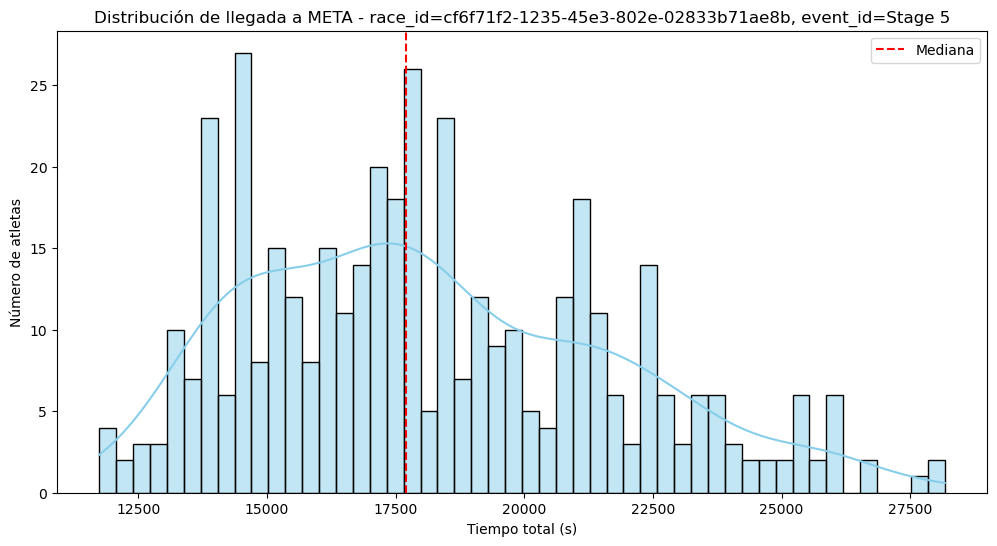

Mediana total a META: 17707.5 s
MAD: 2637.9 s
Atletas outliers MAD: 13 de 420
Atletas outliers percentil 1: 5
Atletas outliers percentil 99: 5

Ejemplos de outliers MAD:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27492,1f9e843d-c956-5658-90f1-b970c45f3d4e,0.29287,NaN,91000,Stage 5,NaN,NaN,,NaN,26595633.0,NaN,10,26650842.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 14:27:28.842,NaN,236,2025-05-05 14:27:33.811,TS2P8 243,1f9e843d-c956-5658-90f1-b970c45f3d4e,False,,NaN,E5 - META,NaN,0.0,2025-05-05 14:27:28.842,2025-05-05 14:27:28.842,False,,2025-05-05T14:27:28.842Z,26650842.0,2025-05-05 14:27:28.842,26650842.0,2,True,Meta,26650842,10.999997,stage,0 days 07:23:15.633000,0 days 07:24:10.842000,NaT,0 days 07:24:10.842000,0 days 07:24:10.842000,0 days 07:24:10.842000,2025-05-05 07:04:13.209,26595.633
27522,d60bcb98-913f-5234-8330-911129c7e102,0.31041,NaN,91000,Stage 5,NaN,NaN,,NaN,28170862.0,NaN,10,28247536.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 14:54:05.536,NaN,463,2025-05-05 14:54:11.261,TS2P8 243,d60bcb98-913f-5234-8330-911129c7e102,False,,NaN,E5 - META,NaN,0.0,2025-05-05 14:54:05.536,2025-05-05 14:54:05.536,False,,2025-05-05T14:54:05.536Z,28247536.0,2025-05-05 14:54:05.536,28247536.0,2,True,Meta,28247536,10.999997,stage,0 days 07:49:30.862000,0 days 07:50:47.536000,NaT,0 days 07:50:47.536000,0 days 07:50:47.536000,0 days 07:50:47.536000,2025-05-05 07:04:34.674,28170.862
28038,5dfb0ad8-6857-5875-b4db-e67220e006bf,0.30434,NaN,91000,Stage 5,NaN,NaN,,NaN,27609580.0,NaN,10,27694692.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 14:44:52.692,NaN,439,2025-05-05 14:44:57.431,TS2P8 243,5dfb0ad8-6857-5875-b4db-e67220e006bf,False,,NaN,E5 - META,NaN,0.0,2025-05-05 14:44:52.692,2025-05-05 14:44:52.692,False,,2025-05-05T14:44:52.692Z,27694692.0,2025-05-05 14:44:52.692,27694692.0,2,True,Meta,27694692,10.999997,stage,0 days 07:40:09.580000,0 days 07:41:34.692000,NaT,0 days 07:41:34.692000,0 days 07:41:34.692000,0 days 07:41:34.692000,2025-05-05 07:04:43.112,27609.580
28068,3304619f-941a-58cb-8d8f-ed03b6665ae7,0.28814,NaN,91000,Stage 5,NaN,NaN,,NaN,26130535.0,NaN,10,26220889.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 14:20:18.889,NaN,223,2025-05-05 14:20:23.294,TS2P8 243,3304619f-941a-58cb-8d8f-ed03b6665ae7,False,,NaN,E5 - META,NaN,0.0,2025-05-05 14:20:18.889,2025-05-05 14:20:18.889,False,,2025-05-05T14:20:18.889Z,26220889.0,2025-05-05 14:20:18.889,26220889.0,2,True,Meta,26220889,10.999997,stage,0 days 07:15:30.535000,0 days 07:17:00.889000,NaT,0 days 07:17:00.889000,0 days 07:17:00.889000,0 days 07:17:00.889000,2025-05-05 07:04:48.354,26130.535
28311,676e33b9-e648-5459-a149-a4bf740ca225,0.29287,NaN,91000,Stage 5,NaN,NaN,,NaN,26596338.0,NaN,10,26651604.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 14:27:29.604,NaN,235,2025-05-05 14:27:35.634,TS2P8 3,676e33b9-e648-5459-a149-a4bf740ca225,False,,NaN,E5 - META,NaN,0.0,2025-05-05 14:27:29.604,2025-05-05 14:27:29.604,False,,2025-05-05T14:27:29.604Z,26651604.0,2025-05-05 14:27:29.604,26651604.0,2,True,Meta,26651604,10.999997,stage,0 days 07:23:16.338000,0 days 07:24:11.604000,NaT,0 days 07:24:11.604000,0 days 07:24:11.604000,0 days 07:24:11.604000,2025-05-05 07:04:13.266,26596.338
28329,e2e8cffb-36f4-5af8-a163-50b07150594e,0.28503,NaN,91000,Stage 5,NaN,NaN,,NaN,25831202.0,NaN,10,25937541.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 14:15:35.541,NaN,55,2025-05-05 14:15:40.036,TS2P8 243,e2e8cffb-36f4-5af8-a163-50b07150594e,False,,NaN,E5 - META,NaN,0.0,2025-05-05 14:15:35.541,2025-05-05 14:15:35.541,False,,2025-05-05T14:15:35.541Z,25937541.0,2025-05-05 14:15:35.541,25937541.0,2,True,Meta,25937541,10.999997,stage,0 days 07:10:31.202000,0 days 07:12:1


Ejemplos de outliers percentiles:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27185,4d325944-3693-5adf-a199-43b47210f9db,0.12930,NaN,91000,Stage 5,NaN,NaN,,NaN,11740502.0,NaN,10,11766655.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 10:19:24.655,NaN,1,2025-05-05 10:19:59.983,TS2P8 243,4d325944-3693-5adf-a199-43b47210f9db,False,,NaN,E5 - META,NaN,0.0,2025-05-05 10:19:24.655,2025-05-05 10:19:24.655,False,,2025-05-05T10:19:24.655Z,11766655.0,2025-05-05 10:19:24.655,11766655.0,2,True,Meta,11766655,10.999999,stage,0 days 03:15:40.502000,0 days 03:16:06.655000,NaT,0 days 03:16:06.655000,0 days 03:16:06.655000,0 days 03:16:06.655000,2025-05-05 07:03:44.153,11740.502
27756,35b3cb57-c982-559f-9b1b-4411975ea175,0.12931,NaN,91000,Stage 5,NaN,NaN,,NaN,11765747.0,NaN,10,11766827.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 10:19:24.827,NaN,35083,2025-05-05 10:19:59.983,TS2P8 243,35b3cb57-c982-559f-9b1b-4411975ea175,False,,NaN,E5 - META,NaN,0.0,2025-05-05 10:19:24.827,2025-05-05 10:19:24.827,False,,2025-05-05T10:19:24.827Z,11766827.0,2025-05-05 10:19:24.827,11766827.0,2,True,Meta,11766827,10.999999,stage,0 days 03:16:05.747000,0 days 03:16:06.827000,NaT,0 days 03:16:06.827000,0 days 03:16:06.827000,0 days 03:16:06.827000,2025-05-05 07:03:19.080,11765.747
27966,b09f286b-d893-5548-8bdc-64ba245e9604,0.12991,NaN,91000,Stage 5,NaN,NaN,,NaN,11820546.0,NaN,10,11822169.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 10:20:20.169,NaN,2,2025-05-05 10:20:25.053,TS2P8 3,b09f286b-d893-5548-8bdc-64ba245e9604,False,,NaN,E5 - META,NaN,0.0,2025-05-05 10:20:20.169,2025-05-05 10:20:20.169,False,,2025-05-05T10:20:20.169Z,11822169.0,2025-05-05 10:20:20.169,11822169.0,2,True,Meta,11822169,10.999999,stage,0 days 03:17:00.546000,0 days 03:17:02.169000,NaT,0 days 03:17:02.169000,0 days 03:17:02.169000,0 days 03:17:02.169000,2025-05-05 07:03:19.623,11820.546
28180,21ff2d4d-a5c6-552c-ae14-08a17f94db60,0.12992,NaN,91000,Stage 5,NaN,NaN,,NaN,11821906.0,NaN,10,11822389.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 10:20:20.389,NaN,3,2025-05-05 10:20:25.053,TS2P8 3,21ff2d4d-a5c6-552c-ae14-08a17f94db60,False,,NaN,E5 - META,NaN,0.0,2025-05-05 10:20:20.389,2025-05-05 10:20:20.389,False,,2025-05-05T10:20:20.389Z,11822389.0,2025-05-05 10:20:20.389,11822389.0,2,True,Meta,11822389,10.999999,stage,0 days 03:17:01.906000,0 days 03:17:02.389000,NaT,0 days 03:17:02.389000,0 days 03:17:02.389000,0 days 03:17:02.389000,2025-05-05 07:03:18.483,11821.906
29421,9ef98b72-d122-533c-968e-394d879f3c3c,0.13312,NaN,91000,Stage 5,NaN,NaN,,NaN,12112460.0,NaN,10,12114144.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 10:25:12.144,NaN,12,2025-05-05 10:25:17.481,TS2P8 243,9ef98b72-d122-533c-968e-394d879f3c3c,False,,NaN,E5 - META,NaN,0.0,2025-05-05 10:25:12.144,2025-05-05 10:25:12.144,False,,2025-05-05T10:25:12.144Z,12114144.0,2025-05-05 10:25:12.144,12114144.0,2,True,Meta,12114144,10.999999,stage,0 days 03:21:52.460000,0 days 03:21:54.144000,NaT,0 days 03:21:54.144000,0 days 03:21:54.144000,0 days 03:21:54.144000,2025-05-05 07:03:19.684,12112.460
27492,1f9e843d-c956-5658-90f1-b970c45f3d4e,0.29287,NaN,91000,Stage 5,NaN,NaN,,NaN,26595633.0,NaN,10,26650842.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-05 14:27:28.842,NaN,236,2025-05-05 14:27:33.811,TS2P8 243,1f9e843d-c956-5658-90f1-b970c45f3d4e,False,,NaN,E5 - META,NaN,0.0,2025-05-05 14:27:28.842,2025-05-05 14:27:28.842,False,,2025-05-05T14:27:28.842Z,26650842.0,2025-05-05 14:27:28.842,26650842.0,2,True,Meta,26650842,10.999997,stage,0 days 07:23:15.633000,0 days 07:24:10.8420


=== Análisis de META para race_id = cf6f71f2-1235-45e3-802e-02833b71ae8b, event_id = Stage 6 ===


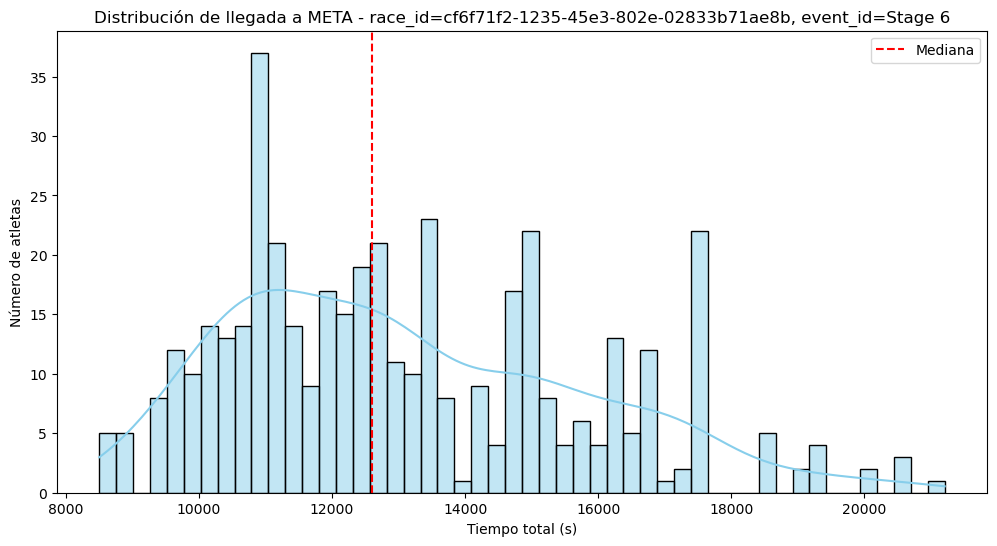

Mediana total a META: 12606.2 s
MAD: 1816.7 s
Atletas outliers MAD: 17 de 433
Atletas outliers percentil 1: 5
Atletas outliers percentil 99: 5

Ejemplos de outliers MAD:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27168,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,0.32848,NaN,61000,Stage 6,NaN,NaN,,NaN,20037285.0,NaN,9,20037285.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 12:47:02.285,NaN,290,2025-05-06 12:47:05.989,TS2P8 243,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,False,,NaN,E6 - META,NaN,0.0,2025-05-06 12:47:02.285,2025-05-06 12:47:02.285,False,,2025-05-06T12:47:02.285Z,20037285.0,2025-05-06 12:47:02.285,20037285.0,2,True,Meta,20037285,9.999998,stage,0 days 05:33:57.285000,0 days 05:33:57.285000,NaT,0 days 05:33:57.285000,0 days 05:33:57.285000,0 days 05:33:57.285000,2025-05-06 07:04:00.707,20581.578
27523,d60bcb98-913f-5234-8330-911129c7e102,0.29430,NaN,61000,Stage 6,NaN,NaN,,NaN,17952035.0,NaN,9,17952035.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 12:12:17.035,NaN,463,2025-05-06 12:12:26.039,TS2P8 243,d60bcb98-913f-5234-8330-911129c7e102,False,,NaN,E6 - META,NaN,0.0,2025-05-06 12:12:17.035,2025-05-06 12:12:17.035,False,,2025-05-06T12:12:17.035Z,17952035.0,2025-05-06 12:12:17.035,17952035.0,2,True,Meta,17952035,9.999998,stage,0 days 04:59:12.035000,0 days 04:59:12.035000,NaT,0 days 04:59:12.035000,0 days 04:59:12.035000,0 days 04:59:12.035000,2025-05-06 07:03:54.658,18502.377
28039,5dfb0ad8-6857-5875-b4db-e67220e006bf,0.30161,NaN,61000,Stage 6,NaN,NaN,,NaN,18397953.0,NaN,9,18397953.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 12:19:42.953,NaN,439,2025-05-06 12:19:46.270,TS2P8 243,5dfb0ad8-6857-5875-b4db-e67220e006bf,False,,NaN,E6 - META,NaN,0.0,2025-05-06 12:19:42.953,2025-05-06 12:19:42.953,False,,2025-05-06T12:19:42.953Z,18397953.0,2025-05-06 12:19:42.953,18397953.0,2,True,Meta,18397953,9.999998,stage,0 days 05:06:37.953000,0 days 05:06:37.953000,NaT,0 days 05:06:37.953000,0 days 05:06:37.953000,0 days 05:06:37.953000,2025-05-06 07:04:01.641,18941.312
28069,3304619f-941a-58cb-8d8f-ed03b6665ae7,0.30771,NaN,61000,Stage 6,NaN,NaN,,NaN,18770191.0,NaN,9,18770191.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 12:25:55.191,NaN,223,2025-05-06 12:25:56.554,TS2P8 243,3304619f-941a-58cb-8d8f-ed03b6665ae7,False,,NaN,E6 - META,NaN,0.0,2025-05-06 12:25:55.191,2025-05-06 12:25:55.191,False,,2025-05-06T12:25:55.191Z,18770191.0,2025-05-06 12:25:55.191,18770191.0,2,True,Meta,18770191,9.999998,stage,0 days 05:12:50.191000,0 days 05:12:50.191000,NaT,0 days 05:12:50.191000,0 days 05:12:50.191000,0 days 05:12:50.191000,2025-05-06 07:04:09.402,19305.789
28151,01f3ab93-17f9-5414-9023-93832a5e40f9,0.30770,NaN,61000,Stage 6,NaN,NaN,,NaN,18769707.0,NaN,9,18769707.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 12:25:54.707,NaN,410,2025-05-06 12:25:58.145,TS2P8 243,01f3ab93-17f9-5414-9023-93832a5e40f9,False,,NaN,E6 - META,NaN,0.0,2025-05-06 12:25:54.707,2025-05-06 12:25:54.707,False,,2025-05-06T12:25:54.707Z,18769707.0,2025-05-06 12:25:54.707,18769707.0,2,True,Meta,18769707,9.999998,stage,0 days 05:12:49.707000,0 days 05:12:49.707000,NaT,0 days 05:12:49.707000,0 days 05:12:49.707000,0 days 05:12:49.707000,2025-05-06 07:04:01.014,19313.693
28341,a3982101-3edf-56e9-8aa5-01609f2ddbe2,0.29429,NaN,61000,Stage 6,NaN,NaN,,NaN,17951744.0,NaN,9,17951744.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 12:12:16.744,NaN,464,2025-05-06 12:12:26.039,TS2P8 243,a3982101-3edf-56e9-8aa5-01609f2ddbe2,False,,NaN,E6 - META,NaN,0.0,2025-05-06 12:12:16.744,2025-05-06 12:12:16.744,False,,2025-05-06T12:12:16.744Z,17951744.0,2025-05-06 12:12:16.744,17951744.0,2,True,Meta,17951744,9.999998,stage,0 days 04:59:11.744000,0 days 04:59:11.744000,


Ejemplos de outliers percentiles:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
27186,4d325944-3693-5adf-a199-43b47210f9db,0.13005,NaN,61000,Stage 6,NaN,NaN,,NaN,7933339.0,NaN,9,7933339.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 09:25:18.339,NaN,1,2025-05-06 09:25:21.096,TS2P8 243,4d325944-3693-5adf-a199-43b47210f9db,False,,NaN,E6 - META,NaN,0.0,2025-05-06 09:25:18.339,2025-05-06 09:25:18.339,False,,2025-05-06T09:25:18.339Z,7933339.0,2025-05-06 09:25:18.339,7933339.0,2,True,Meta,7933339,9.999999,stage,0 days 02:12:13.339000,0 days 02:12:13.339000,NaT,0 days 02:12:13.339000,0 days 02:12:13.339000,0 days 02:12:13.339000,2025-05-06 07:03:36.585,8501.754
27757,35b3cb57-c982-559f-9b1b-4411975ea175,0.13013,NaN,61000,Stage 6,NaN,NaN,,NaN,7938211.0,NaN,9,7938211.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 09:25:23.211,NaN,35083,2025-05-06 09:25:26.350,TS2P8 243,35b3cb57-c982-559f-9b1b-4411975ea175,False,,NaN,E6 - META,NaN,0.0,2025-05-06 09:25:23.211,2025-05-06 09:25:23.211,False,,2025-05-06T09:25:23.211Z,7938211.0,2025-05-06 09:25:23.211,7938211.0,2,True,Meta,7938211,9.999999,stage,0 days 02:12:18.211000,0 days 02:12:18.211000,NaT,0 days 02:12:18.211000,0 days 02:12:18.211000,0 days 02:12:18.211000,2025-05-06 07:02:42.535,8560.676
27967,b09f286b-d893-5548-8bdc-64ba245e9604,0.13085,NaN,61000,Stage 6,NaN,NaN,,NaN,7981990.0,NaN,9,7981990.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 09:26:06.990,NaN,2,2025-05-06 09:26:10.635,TS2P8 243,b09f286b-d893-5548-8bdc-64ba245e9604,False,,NaN,E6 - META,NaN,0.0,2025-05-06 09:26:06.990,2025-05-06 09:26:06.990,False,,2025-05-06T09:26:06.990Z,7981990.0,2025-05-06 09:26:06.990,7981990.0,2,True,Meta,7981990,9.999999,stage,0 days 02:13:01.990000,0 days 02:13:01.990000,NaT,0 days 02:13:01.990000,0 days 02:13:01.990000,0 days 02:13:01.990000,2025-05-06 07:02:41.655,8605.335
28181,21ff2d4d-a5c6-552c-ae14-08a17f94db60,0.13084,NaN,61000,Stage 6,NaN,NaN,,NaN,7981411.0,NaN,9,7981411.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 09:26:06.411,NaN,3,2025-05-06 09:26:10.635,TS2P8 243,21ff2d4d-a5c6-552c-ae14-08a17f94db60,False,,NaN,E6 - META,NaN,0.0,2025-05-06 09:26:06.411,2025-05-06 09:26:06.411,False,,2025-05-06T09:26:06.411Z,7981411.0,2025-05-06 09:26:06.411,7981411.0,2,True,Meta,7981411,9.999999,stage,0 days 02:13:01.411000,0 days 02:13:01.411000,NaT,0 days 02:13:01.411000,0 days 02:13:01.411000,0 days 02:13:01.411000,2025-05-06 07:02:40.736,8605.675
29422,9ef98b72-d122-533c-968e-394d879f3c3c,0.13011,NaN,61000,Stage 6,NaN,NaN,,NaN,7936815.0,NaN,9,7936815.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 09:25:21.815,NaN,12,2025-05-06 09:25:25.233,TS2P8 243,9ef98b72-d122-533c-968e-394d879f3c3c,False,,NaN,E6 - META,NaN,0.0,2025-05-06 09:25:21.815,2025-05-06 09:25:21.815,False,,2025-05-06T09:25:21.815Z,7936815.0,2025-05-06 09:25:21.815,7936815.0,2,True,Meta,7936815,9.999999,stage,0 days 02:12:16.815000,0 days 02:12:16.815000,NaT,0 days 02:12:16.815000,0 days 02:12:16.815000,0 days 02:12:16.815000,2025-05-06 07:02:42.114,8559.701
27168,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,0.32848,NaN,61000,Stage 6,NaN,NaN,,NaN,20037285.0,NaN,9,20037285.0,cf6f71f2-1235-45e3-802e-02833b71ae8b,2025-05-06 12:47:02.285,NaN,290,2025-05-06 12:47:05.989,TS2P8 243,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,False,,NaN,E6 - META,NaN,0.0,2025-05-06 12:47:02.285,2025-05-06 12:47:02.285,False,,2025-05-06T12:47:02.285Z,20037285.0,2025-05-06 12:47:02.285,20037285.0,2,True,Meta,20037285,9.999998,stage,0 days 05:33:57.285000,0 days 05:33:57.285000,NaT,0 days 05:33:57.285000,0 days 0


=== Análisis de META para race_id = ad64fc28-2968-4993-a182-f642c0310a93, event_id = Medio Maratón ===


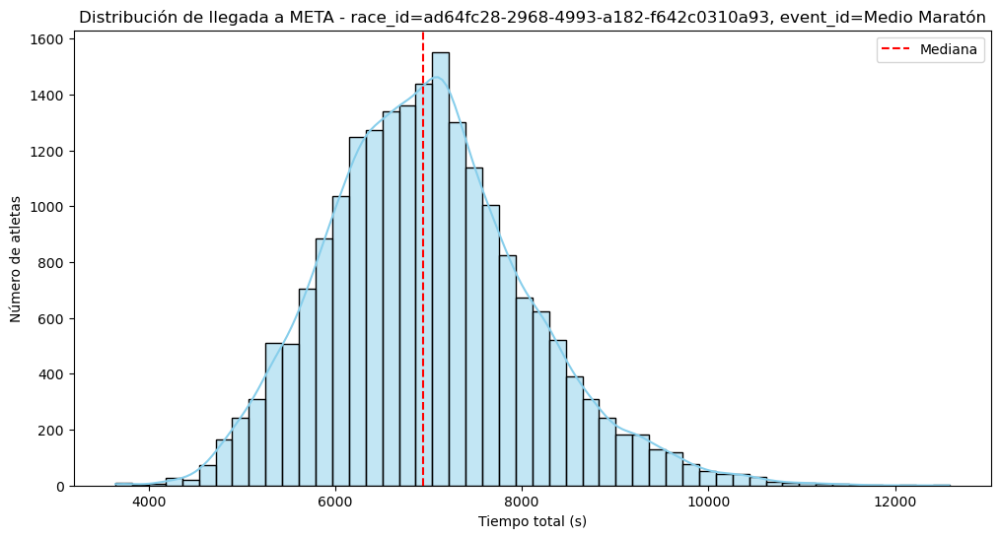

Mediana total a META: 6937.1 s
MAD: 691.5 s
Atletas outliers MAD: 1169 de 20751
Atletas outliers percentil 1: 207
Atletas outliers percentil 99: 207

Ejemplos de outliers MAD:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
29776,1,0.18255,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3849553.0,NaN,6,3851208.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:19:11.708,NaN,50001,2025-04-06 08:19:15.307,TSONE 4,1,False,,NaN,Meta,NaN,0.0,2025-04-06 08:19:11.708,2025-04-06 08:19:11.708,False,,2025-04-06T08:19:11.708Z,3851208.0,2025-04-06 08:19:11.708,3851208.0,2.0,True,Meta,3851208,7.0,media,0 days 01:04:09.553000,0 days 01:04:11.208000,NaT,0 days 01:04:11.208000,0 days 01:04:11.208000,0 days 01:04:11.208000,2025-04-06 07:15:02.155,3849.553
29777,2,0.17891,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3774464.0,NaN,6,3774464.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:17:54.964,NaN,40002,2025-04-06 08:17:59.965,TS2P4 6,2,False,,NaN,Meta,NaN,0.0,2025-04-06 08:17:54.964,2025-04-06 08:17:54.964,False,,2025-04-06T08:17:54.964Z,3774464.0,2025-04-06 08:17:54.964,3774464.0,2.0,True,Meta,3774464,7.0,media,0 days 01:02:54.464000,0 days 01:02:54.464000,NaT,0 days 01:02:54.464000,0 days 01:02:54.464000,0 days 01:02:54.464000,2025-04-06 07:15:00.500,3774.464
29778,3,0.17368,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3664133.0,NaN,6,3664133.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:16:04.633,NaN,3,2025-04-06 08:16:07.537,TSONE 4,3,False,,NaN,Meta,NaN,0.0,2025-04-06 08:16:04.633,2025-04-06 08:16:04.633,False,,2025-04-06T08:16:04.633Z,3664133.0,2025-04-06 08:16:04.633,3664133.0,2.0,True,Meta,3664133,7.0,media,0 days 01:01:04.133000,0 days 01:01:04.133000,NaT,0 days 01:01:04.133000,0 days 01:01:04.133000,0 days 01:01:04.133000,2025-04-06 07:15:00.500,3664.133
29779,4,0.17439,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3679134.0,NaN,6,3679134.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:16:19.634,NaN,4,2025-04-06 08:16:24.009,TS2P4 6,4,False,,NaN,Meta,NaN,0.0,2025-04-06 08:16:19.634,2025-04-06 08:16:19.634,False,,2025-04-06T08:16:19.634Z,3679134.0,2025-04-06 08:16:19.634,3679134.0,2.0,True,Meta,3679134,7.0,media,0 days 01:01:19.134000,0 days 01:01:19.134000,NaT,0 days 01:01:19.134000,0 days 01:01:19.134000,0 days 01:01:19.134000,2025-04-06 07:15:00.500,3679.134
29780,5,0.17983,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3791747.0,NaN,6,3793935.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:18:14.435,NaN,40005,2025-04-06 08:18:20.233,TS2P4 6,5,False,,NaN,Meta,NaN,0.0,2025-04-06 08:18:14.435,2025-04-06 08:18:14.435,False,,2025-04-06T08:18:14.435Z,3793935.0,2025-04-06 08:18:14.435,3793935.0,2.0,True,Meta,3793935,7.0,media,0 days 01:03:11.747000,0 days 01:03:13.935000,NaT,0 days 01:03:13.935000,0 days 01:03:13.935000,0 days 01:03:13.935000,2025-04-06 07:15:02.688,3791.747
29781,6,0.17960,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3787217.0,NaN,6,3789004.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:18:09.504,NaN,6,2025-04-06 08:18:13.605,TS2P4 6,6,False,,NaN,Meta,NaN,0.0,2025-04-06 08:18:09.504,2025-04-06 08:18:09.504,False,,2025-04-06T08:18:09.504Z,3789004.0,2025-04-06 08:18:09.504,3789004.0,2.0,True,Meta,3789004,7.0,media,0 days 01:03:07.217000,0 days 01:03:09.004000,NaT,0 days 01:03:09.004000,0 days 01:03:09.004000,0 days 01:03:09.004000,2025-04-06 07:15:02.287,3787.217
29782,7,0.17278,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3645227.0,NaN,6,3645227.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:15:45.727,NaN,40007,2025-04-06 08:15:49.098,TSONE 4,7,False,,NaN,Meta,NaN,0.0,2025-04-06 08:15:45.727,2025-04-06 08:15:45.727,False,,2025-04-06T08:15:45.727Z,3645227.0,2025-04-06 08:15:45.727,3645227.0,2.0,True,Meta,3645227,7.0,media,0 days 01


Ejemplos de outliers percentiles:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
29776,1,0.18255,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3849553.0,NaN,6,3851208.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:19:11.708,NaN,50001,2025-04-06 08:19:15.307,TSONE 4,1,False,,NaN,Meta,NaN,0.0,2025-04-06 08:19:11.708,2025-04-06 08:19:11.708,False,,2025-04-06T08:19:11.708Z,3851208.0,2025-04-06 08:19:11.708,3851208.0,2.0,True,Meta,3851208,7.0,media,0 days 01:04:09.553000,0 days 01:04:11.208000,NaT,0 days 01:04:11.208000,0 days 01:04:11.208000,0 days 01:04:11.208000,2025-04-06 07:15:02.155,3849.553
29777,2,0.17891,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3774464.0,NaN,6,3774464.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:17:54.964,NaN,40002,2025-04-06 08:17:59.965,TS2P4 6,2,False,,NaN,Meta,NaN,0.0,2025-04-06 08:17:54.964,2025-04-06 08:17:54.964,False,,2025-04-06T08:17:54.964Z,3774464.0,2025-04-06 08:17:54.964,3774464.0,2.0,True,Meta,3774464,7.0,media,0 days 01:02:54.464000,0 days 01:02:54.464000,NaT,0 days 01:02:54.464000,0 days 01:02:54.464000,0 days 01:02:54.464000,2025-04-06 07:15:00.500,3774.464
29778,3,0.17368,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3664133.0,NaN,6,3664133.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:16:04.633,NaN,3,2025-04-06 08:16:07.537,TSONE 4,3,False,,NaN,Meta,NaN,0.0,2025-04-06 08:16:04.633,2025-04-06 08:16:04.633,False,,2025-04-06T08:16:04.633Z,3664133.0,2025-04-06 08:16:04.633,3664133.0,2.0,True,Meta,3664133,7.0,media,0 days 01:01:04.133000,0 days 01:01:04.133000,NaT,0 days 01:01:04.133000,0 days 01:01:04.133000,0 days 01:01:04.133000,2025-04-06 07:15:00.500,3664.133
29779,4,0.17439,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3679134.0,NaN,6,3679134.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:16:19.634,NaN,4,2025-04-06 08:16:24.009,TS2P4 6,4,False,,NaN,Meta,NaN,0.0,2025-04-06 08:16:19.634,2025-04-06 08:16:19.634,False,,2025-04-06T08:16:19.634Z,3679134.0,2025-04-06 08:16:19.634,3679134.0,2.0,True,Meta,3679134,7.0,media,0 days 01:01:19.134000,0 days 01:01:19.134000,NaT,0 days 01:01:19.134000,0 days 01:01:19.134000,0 days 01:01:19.134000,2025-04-06 07:15:00.500,3679.134
29780,5,0.17983,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3791747.0,NaN,6,3793935.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:18:14.435,NaN,40005,2025-04-06 08:18:20.233,TS2P4 6,5,False,,NaN,Meta,NaN,0.0,2025-04-06 08:18:14.435,2025-04-06 08:18:14.435,False,,2025-04-06T08:18:14.435Z,3793935.0,2025-04-06 08:18:14.435,3793935.0,2.0,True,Meta,3793935,7.0,media,0 days 01:03:11.747000,0 days 01:03:13.935000,NaT,0 days 01:03:13.935000,0 days 01:03:13.935000,0 days 01:03:13.935000,2025-04-06 07:15:02.688,3791.747
29781,6,0.17960,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3787217.0,NaN,6,3789004.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:18:09.504,NaN,6,2025-04-06 08:18:13.605,TS2P4 6,6,False,,NaN,Meta,NaN,0.0,2025-04-06 08:18:09.504,2025-04-06 08:18:09.504,False,,2025-04-06T08:18:09.504Z,3789004.0,2025-04-06 08:18:09.504,3789004.0,2.0,True,Meta,3789004,7.0,media,0 days 01:03:07.217000,0 days 01:03:09.004000,NaT,0 days 01:03:09.004000,0 days 01:03:09.004000,0 days 01:03:09.004000,2025-04-06 07:15:02.287,3787.217
29782,7,0.17278,NaN,21097,Medio Maratón,NaN,NaN,,NaN,3645227.0,NaN,6,3645227.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:15:45.727,NaN,40007,2025-04-06 08:15:49.098,TSONE 4,7,False,,NaN,Meta,NaN,0.0,2025-04-06 08:15:45.727,2025-04-06 08:15:45.727,False,,2025-04-06T08:15:45.727Z,3645227.0,2025-04-06 08:15:45.727,3645227.0,2.0,True,Meta,3645227,7.0,media,0 days 01


=== Análisis de META para race_id = ad64fc28-2968-4993-a182-f642c0310a93, event_id = Carrera Profuturo ===


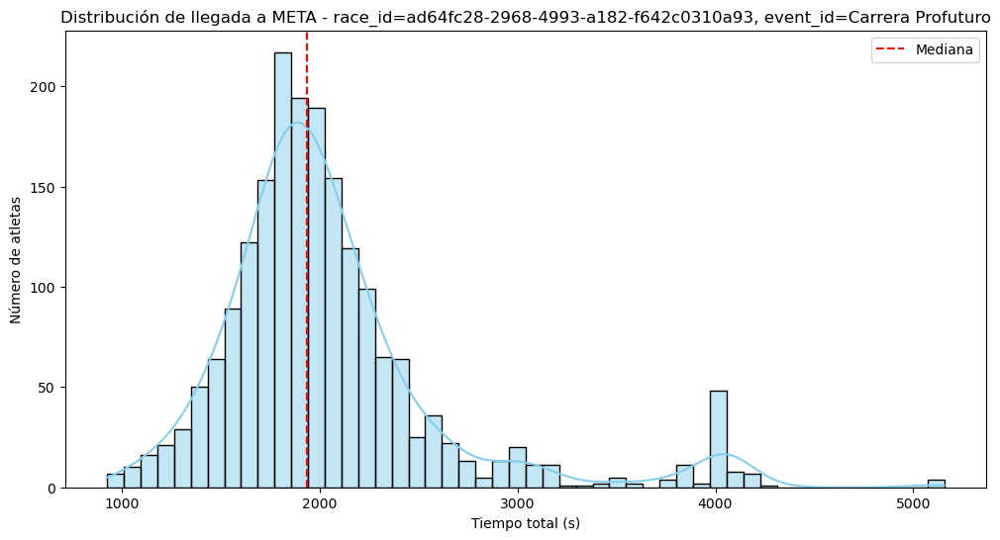

Mediana total a META: 1937.2 s
MAD: 231.8 s
Atletas outliers MAD: 239 de 2005
Atletas outliers percentil 1: 20
Atletas outliers percentil 99: 20

Ejemplos de outliers MAD:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
50459,ba75953f-62fc-5238-aad6-0e5d4f882c47,0.23090,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,1174938.0,NaN,3,1177596.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 07:34:39.083,NaN,29021,2025-04-06 07:34:42.140,TS2P8 87,ba75953f-62fc-5238-aad6-0e5d4f882c47,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 07:34:39.083,2025-04-06 07:34:39.083,False,,2025-04-06T07:34:39.083Z,1177596.0,2025-04-06 07:34:39.083,1177596.0,2.0,True,Meta,1177596,4.0,maraton,0 days 00:19:34.938000,0 days 00:19:37.596000,NaT,0 days 00:19:37.596000,0 days 00:19:37.596000,0 days 00:19:37.596000,2025-04-06 07:15:04.145,1174.938
50470,89d6022f-b823-5d08-a7eb-cce2c093abf6,0.61764,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,2898290.0,NaN,3,3149980.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:07:31.467,NaN,29469,2025-04-06 08:07:33.986,TS2P8 87,89d6022f-b823-5d08-a7eb-cce2c093abf6,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 08:07:31.467,2025-04-06 08:07:31.467,False,,2025-04-06T08:07:31.467Z,3149980.0,2025-04-06 08:07:31.467,3149980.0,2.0,True,Meta,3149980,4.0,maraton,0 days 00:48:18.290000,0 days 00:52:29.980000,NaT,0 days 00:52:29.980000,0 days 00:52:29.980000,0 days 00:52:29.980000,2025-04-06 07:19:13.177,2898.290
50473,9a3dcba7-5a67-5ced-b926-1398c5823f15,0.56382,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,2721967.0,NaN,3,2875476.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:02:56.963,NaN,28675,2025-04-06 08:02:59.819,TS2P8 87,9a3dcba7-5a67-5ced-b926-1398c5823f15,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 08:02:56.963,2025-04-06 08:02:56.963,False,,2025-04-06T08:02:56.963Z,2875476.0,2025-04-06 08:02:56.963,2875476.0,2.0,True,Meta,2875476,4.0,maraton,0 days 00:45:21.967000,0 days 00:47:55.476000,NaT,0 days 00:47:55.476000,0 days 00:47:55.476000,0 days 00:47:55.476000,2025-04-06 07:17:34.996,2721.967
50477,2b8d7297-0e26-56ec-a2e9-f4c14acf791d,0.22048,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,1123454.0,NaN,3,1124454.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 07:33:45.941,NaN,28460,2025-04-06 07:33:49.518,TS2P8 5,2b8d7297-0e26-56ec-a2e9-f4c14acf791d,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 07:33:45.941,2025-04-06 07:33:45.941,False,,2025-04-06T07:33:45.941Z,1124454.0,2025-04-06 07:33:45.941,1124454.0,2.0,True,Meta,1124454,4.0,maraton,0 days 00:18:43.454000,0 days 00:18:44.454000,NaT,0 days 00:18:44.454000,0 days 00:18:44.454000,0 days 00:18:44.454000,2025-04-06 07:15:02.487,1123.454
50478,fd329c81-11d5-5219-98da-a2261a347f83,0.57263,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,2670309.0,NaN,3,2920409.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:03:41.896,NaN,29463,2025-04-06 08:03:43.786,TS2P8 87,fd329c81-11d5-5219-98da-a2261a347f83,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 08:03:41.896,2025-04-06 08:03:41.896,False,,2025-04-06T08:03:41.896Z,2920409.0,2025-04-06 08:03:41.896,2920409.0,2.0,True,Meta,2920409,4.0,maraton,0 days 00:44:30.309000,0 days 00:48:40.409000,NaT,0 days 00:48:40.409000,0 days 00:48:40.409000,0 days 00:48:40.409000,2025-04-06 07:19:11.587,2670.309
50481,60cd8cb7-c57d-5994-8916-aa83d641e75c,0.55195,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,2786269.0,NaN,3,2814944.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 08:01:56.431,NaN,27073,2025-04-06 08:01:59.008,TS2P8 87,60cd8cb7-c57d-5994-8916-aa83d641e75c,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 08:01:56.431,2025-04-06 08:01:56.431,False,,2025-04-06T08:01:56.431Z,2814944.0,2025-04-06 08:01:56.431,2814944.0,2.0,True,Meta,2814944,4.0,maraton,0 days 00:46:26.269000,0 days 00:46:54.9


Ejemplos de outliers percentiles:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
50551,a3024e4e-b8fe-569b-b36b-a0d745972bfd,0.19375,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,987902.0,NaN,3,988144.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 07:31:29.631,NaN,29300,2025-04-06 07:31:33.239,TS2P8 87,a3024e4e-b8fe-569b-b36b-a0d745972bfd,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 07:31:29.631,2025-04-06 07:31:29.631,False,,2025-04-06T07:31:29.631Z,988144.0,2025-04-06 07:31:29.631,988144.0,2.0,True,Meta,988144,4.0,maraton,0 days 00:16:27.902000,0 days 00:16:28.144000,NaT,0 days 00:16:28.144000,0 days 00:16:28.144000,0 days 00:16:28.144000,2025-04-06 07:15:01.729,987.902
50572,e1da17d0-8898-5709-a15e-eae4ec7fb1a8,0.21701,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,1105221.0,NaN,3,1106772.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 07:33:28.259,NaN,28516,2025-04-06 07:33:33.309,TS2P8 5,e1da17d0-8898-5709-a15e-eae4ec7fb1a8,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 07:33:28.259,2025-04-06 07:33:28.259,False,,2025-04-06T07:33:28.259Z,1106772.0,2025-04-06 07:33:28.259,1106772.0,2.0,True,Meta,1106772,4.0,maraton,0 days 00:18:25.221000,0 days 00:18:26.772000,NaT,0 days 00:18:26.772000,0 days 00:18:26.772000,0 days 00:18:26.772000,2025-04-06 07:15:03.038,1105.221
50663,e35227a7-26c1-50d2-9b62-8bb72f3d209f,0.18193,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,927186.0,NaN,3,927842.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 07:30:29.329,NaN,29351,2025-04-06 07:30:33.069,TS2P8 87,e35227a7-26c1-50d2-9b62-8bb72f3d209f,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 07:30:29.329,2025-04-06 07:30:29.329,False,,2025-04-06T07:30:29.329Z,927842.0,2025-04-06 07:30:29.329,927842.0,2.0,True,Meta,927842,4.0,maraton,0 days 00:15:27.186000,0 days 00:15:27.842000,NaT,0 days 00:15:27.842000,0 days 00:15:27.842000,0 days 00:15:27.842000,2025-04-06 07:15:02.143,927.186
50771,5a29cad1-c3bb-5354-a200-99bb6f9712a7,0.19890,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,1013226.0,NaN,3,1014394.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 07:31:55.881,NaN,28119,2025-04-06 07:31:59.218,TS2P8 87,5a29cad1-c3bb-5354-a200-99bb6f9712a7,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 07:31:55.881,2025-04-06 07:31:55.881,False,,2025-04-06T07:31:55.881Z,1014394.0,2025-04-06 07:31:55.881,1014394.0,2.0,True,Meta,1014394,4.0,maraton,0 days 00:16:53.226000,0 days 00:16:54.394000,NaT,0 days 00:16:54.394000,0 days 00:16:54.394000,0 days 00:16:54.394000,2025-04-06 07:15:02.655,1013.226
50925,0cf84ed3-247a-564d-8393-0278e262a252,0.20502,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,1043158.0,NaN,3,1045606.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 07:32:27.093,NaN,27348,2025-04-06 07:32:32.060,TS2P8 5,0cf84ed3-247a-564d-8393-0278e262a252,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 07:32:27.093,2025-04-06 07:32:27.093,False,,2025-04-06T07:32:27.093Z,1045606.0,2025-04-06 07:32:27.093,1045606.0,2.0,True,Meta,1045606,4.0,maraton,0 days 00:17:23.158000,0 days 00:17:25.606000,NaT,0 days 00:17:25.606000,0 days 00:17:25.606000,0 days 00:17:25.606000,2025-04-06 07:15:03.935,1043.158
51018,85c0e87e-6c7c-52f2-8389-d43027fc6aa3,0.19459,NaN,5100,Carrera Profuturo,NaN,NaN,,NaN,992192.0,NaN,3,992384.0,ad64fc28-2968-4993-a182-f642c0310a93,2025-04-06 07:31:33.871,NaN,27282,2025-04-06 07:31:37.153,TS2P8 87,85c0e87e-6c7c-52f2-8389-d43027fc6aa3,False,,NaN,Meta 5K,NaN,0.0,2025-04-06 07:31:33.871,2025-04-06 07:31:33.871,False,,2025-04-06T07:31:33.871Z,992384.0,2025-04-06 07:31:33.871,992384.0,2.0,True,Meta,992384,4.0,maraton,0 days 00:16:32.192000,0 days 00:16:32.384000,NaT,0 days 0


=== Análisis de META para race_id = 331e7589-6440-4968-9b44-484ba589824e, event_id = Marato ===


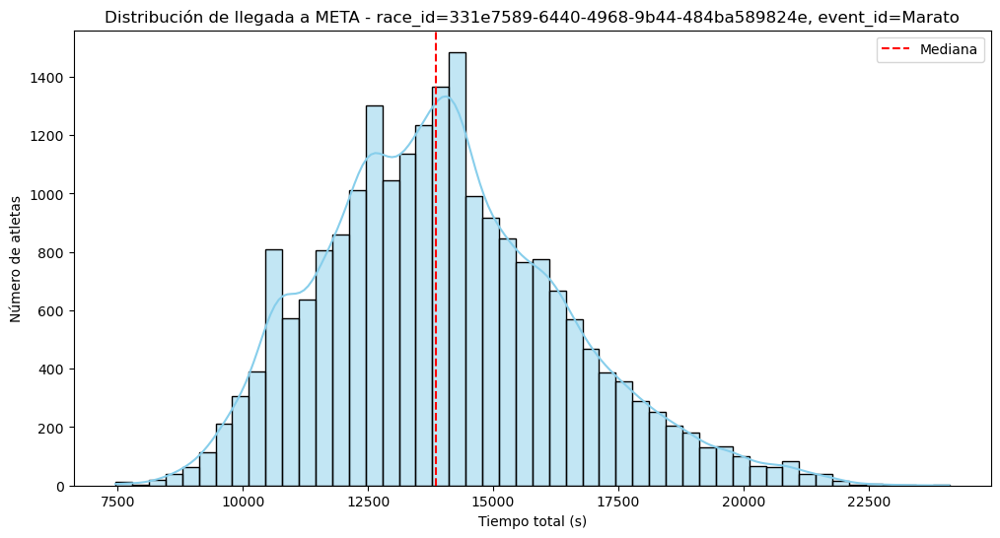

Mediana total a META: 13863.6 s
MAD: 1586.4 s
Atletas outliers MAD: 1097 de 22018
Atletas outliers percentil 1: 218
Atletas outliers percentil 99: 218

Ejemplos de outliers MAD:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
52534,114500005,0.20975,NaN,42195,Marato,NaN,NaN,,NaN,8847421.0,NaN,11,8850545.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 09:58:45.817,NaN,89,2025-03-16 09:58:48.620,TS2P8 5,114500005,False,,NaN,Meta,NaN,0.0,2025-03-16 09:58:45.817,2025-03-16 09:58:45.817,False,,2025-03-16T09:58:45.817Z,8850545.0,2025-03-16 09:58:45.817,8850545.0,2.0,True,Meta,8850545,11.999999,maraton,0 days 02:27:27.421000,0 days 02:27:30.545000,NaT,0 days 02:27:30.545000,0 days 02:27:30.545000,0 days 02:27:30.545000,2025-03-16 07:31:18.396,8847.421
52584,F413251A,0.49587,NaN,42195,Marato,NaN,NaN,,NaN,20747896.0,NaN,11,20923277.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 14:13:57.289,NaN,27268,2025-03-16 14:14:00.457,TS2P8 5,F413251A,False,,NaN,Meta,NaN,0.0,2025-03-16 14:13:57.289,2025-03-16 14:13:57.289,False,,2025-03-16T14:13:57.289Z,20923277.0,2025-03-16 14:13:57.289,20923277.0,2.0,True,Meta,20923277,11.999998,maraton,0 days 05:45:47.896000,0 days 05:48:43.277000,NaT,0 days 05:48:43.277000,0 days 05:48:43.277000,0 days 05:48:43.277000,2025-03-16 08:28:09.393,20747.896
52645,9C3A86D7,0.50901,NaN,42195,Marato,NaN,NaN,,NaN,21348422.0,NaN,11,21477791.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 14:23:11.803,NaN,25935,2025-03-16 14:23:14.913,TS2P8 5,9C3A86D7,False,,NaN,Meta,NaN,0.0,2025-03-16 14:23:11.803,2025-03-16 14:23:11.803,False,,2025-03-16T14:23:11.803Z,21477791.0,2025-03-16 14:23:11.803,21477791.0,2.0,True,Meta,21477791,11.999998,maraton,0 days 05:55:48.422000,0 days 05:57:57.791000,NaT,0 days 05:57:57.791000,0 days 05:57:57.791000,0 days 05:57:57.791000,2025-03-16 08:27:23.381,21348.422
52667,F7B42C9B,0.45656,NaN,42195,Marato,NaN,NaN,,NaN,19169022.0,NaN,11,19264420.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 13:36:09.540,NaN,21039,2025-03-16 13:36:12.602,TS2P8 5,F7B42C9B,False,,NaN,Meta,NaN,0.0,2025-03-16 13:36:09.540,2025-03-16 13:36:09.540,False,,2025-03-16T13:36:09.540Z,19264420.0,2025-03-16 13:36:09.540,19264420.0,2.0,True,Meta,19264420,11.999998,maraton,0 days 05:19:29.022000,0 days 05:21:04.420000,NaT,0 days 05:21:04.420000,0 days 05:21:04.420000,0 days 05:21:04.420000,2025-03-16 08:16:40.518,19169.022
52836,493C7YC2,0.20787,NaN,42195,Marato,NaN,NaN,,NaN,8764535.0,NaN,11,8771180.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 09:57:26.452,NaN,30357,2025-03-16 09:57:28.481,TS2P8 5,493C7YC2,False,,NaN,Meta,NaN,0.0,2025-03-16 09:57:26.452,2025-03-16 09:57:26.452,False,,2025-03-16T09:57:26.452Z,8771180.0,2025-03-16 09:57:26.452,8771180.0,2.0,True,Meta,8771180,11.999999,maraton,0 days 02:26:04.535000,0 days 02:26:11.180000,NaT,0 days 02:26:11.180000,0 days 02:26:11.180000,0 days 02:26:11.180000,2025-03-16 07:31:21.917,8764.535
52930,CD5589B3,0.50021,NaN,42195,Marato,NaN,NaN,,NaN,21079301.0,NaN,11,21106257.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 14:17:00.269,NaN,27124,2025-03-16 14:17:02.549,TS2P8 5,CD5589B3,False,,NaN,Meta,NaN,0.0,2025-03-16 14:17:00.269,2025-03-16 14:17:00.269,False,,2025-03-16T14:17:00.269Z,21106257.0,2025-03-16 14:17:00.269,21106257.0,2.0,True,Meta,21106257,11.999998,maraton,0 days 05:51:19.301000,0 days 05:51:46.257000,NaT,0 days 05:51:46.257000,0 days 05:51:46.257000,0 days 05:51:46.257000,2025-03-16 08:25:40.968,21079.301
52937,Z819FY2B,0.21402,NaN,42195,Marato,NaN,NaN,,NaN,9026208.0,NaN,11,9030417.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 10:01:45.689,NaN,432,2025-03-16 10:01:48.860,TS2P8 5,Z819FY2B,False,,NaN,Meta,NaN,0.0,2025-03-16 10:01:45.689,2025


Ejemplos de outliers percentiles:


,athlete_id,average,averageNet,distance,event_id,incidence,isBackup,location,net,netTime,offset,order,originalTime,race_id,rawTime,raw_backupOffset,raw_chip,raw_created,raw_device,raw_id,raw_import,raw_importId,raw_isBackup,raw_location,raw_manual,raw_offset,raw_originalTime,raw_rawTime,raw_rewind,raw_rewindId,raw_time,raw_times_official,raw_times_rawTime,raw_times_real,raw_type,raw_valid,split,time,weight,event_std,netTime_td,originalTime_td,raw_backupOffset_td,raw_times_official_td,raw_times_real_td,time_td,startRawTime,total_time_sec
52534,114500005,0.20975,NaN,42195,Marato,NaN,NaN,,NaN,8847421.0,NaN,11,8850545.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 09:58:45.817,NaN,89,2025-03-16 09:58:48.620,TS2P8 5,114500005,False,,NaN,Meta,NaN,0.0,2025-03-16 09:58:45.817,2025-03-16 09:58:45.817,False,,2025-03-16T09:58:45.817Z,8850545.0,2025-03-16 09:58:45.817,8850545.0,2.0,True,Meta,8850545,11.999999,maraton,0 days 02:27:27.421000,0 days 02:27:30.545000,NaT,0 days 02:27:30.545000,0 days 02:27:30.545000,0 days 02:27:30.545000,2025-03-16 07:31:18.396,8847.421
52836,493C7YC2,0.20787,NaN,42195,Marato,NaN,NaN,,NaN,8764535.0,NaN,11,8771180.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 09:57:26.452,NaN,30357,2025-03-16 09:57:28.481,TS2P8 5,493C7YC2,False,,NaN,Meta,NaN,0.0,2025-03-16 09:57:26.452,2025-03-16 09:57:26.452,False,,2025-03-16T09:57:26.452Z,8771180.0,2025-03-16 09:57:26.452,8771180.0,2.0,True,Meta,8771180,11.999999,maraton,0 days 02:26:04.535000,0 days 02:26:11.180000,NaT,0 days 02:26:11.180000,0 days 02:26:11.180000,0 days 02:26:11.180000,2025-03-16 07:31:21.917,8764.535
52869,YZ3YCCFZ,0.21751,NaN,42195,Marato,NaN,NaN,,NaN,9174822.0,NaN,11,9177968.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 10:04:13.240,NaN,367,2025-03-16 10:04:16.650,TS2P8 5,YZ3YCCFZ,False,,NaN,Meta,NaN,0.0,2025-03-16 10:04:13.240,2025-03-16 10:04:13.240,False,,2025-03-16T10:04:13.240Z,9177968.0,2025-03-16 10:04:13.240,9177968.0,2.0,True,Meta,9177968,11.999999,maraton,0 days 02:32:54.822000,0 days 02:32:57.968000,NaT,0 days 02:32:57.968000,0 days 02:32:57.968000,0 days 02:32:57.968000,2025-03-16 07:31:18.418,9174.822
52903,BYBD3635,0.22072,NaN,42195,Marato,NaN,NaN,,NaN,9284751.0,NaN,11,9313169.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 10:06:28.441,NaN,747,2025-03-16 10:06:31.564,TS2P8 5,BYBD3635,False,,NaN,Meta,NaN,0.0,2025-03-16 10:06:28.441,2025-03-16 10:06:28.441,False,,2025-03-16T10:06:28.441Z,9313169.0,2025-03-16 10:06:28.441,9313169.0,2.0,True,Meta,9313169,11.999999,maraton,0 days 02:34:44.751000,0 days 02:35:13.169000,NaT,0 days 02:35:13.169000,0 days 02:35:13.169000,0 days 02:35:13.169000,2025-03-16 07:31:43.690,9284.751
52937,Z819FY2B,0.21402,NaN,42195,Marato,NaN,NaN,,NaN,9026208.0,NaN,11,9030417.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 10:01:45.689,NaN,432,2025-03-16 10:01:48.860,TS2P8 5,Z819FY2B,False,,NaN,Meta,NaN,0.0,2025-03-16 10:01:45.689,2025-03-16 10:01:45.689,False,,2025-03-16T10:01:45.689Z,9030417.0,2025-03-16 10:01:45.689,9030417.0,2.0,True,Meta,9030417,11.999999,maraton,0 days 02:30:26.208000,0 days 02:30:30.417000,NaT,0 days 02:30:30.417000,0 days 02:30:30.417000,0 days 02:30:30.417000,2025-03-16 07:31:19.481,9026.208
52946,852F2Z64,0.20712,NaN,42195,Marato,NaN,NaN,,NaN,8733308.0,NaN,11,8739393.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 09:56:54.665,NaN,30467,2025-03-16 09:56:58.267,TS2P8 5,852F2Z64,False,,NaN,Meta,NaN,0.0,2025-03-16 09:56:54.665,2025-03-16 09:56:54.665,False,,2025-03-16T09:56:54.665Z,8739393.0,2025-03-16 09:56:54.665,8739393.0,2.0,True,Meta,8739393,11.999999,maraton,0 days 02:25:33.308000,0 days 02:25:39.393000,NaT,0 days 02:25:39.393000,0 days 02:25:39.393000,0 days 02:25:39.393000,2025-03-16 07:31:21.357,8733.308
52977,29FB888C,0.22227,NaN,42195,Marato,NaN,NaN,,NaN,9368853.0,NaN,11,9378812.0,331e7589-6440-4968-9b44-484ba589824e,2025-03-16 10:07:34.084,NaN,712,2025-03-16 10:07:37.288,TS2P8 5,29FB888C,False,,NaN,Meta,NaN,0.0,2025-03-16 10:07:34.084,2025-03-16 10:07:34.084,False,,202

In [ ]:
df_meta = athletes_time_df[athletes_time_df['split'] == 'Meta'].copy()

df_meta = df_meta.merge(
    athletes_events_df[['athlete_id', 'event_id', 'race_id', 'startRawTime']],
    on=['athlete_id', 'event_id', 'race_id'],
    how='left'
)

df_meta['total_time_sec'] = (df_meta['rawTime'] - df_meta['startRawTime']).dt.total_seconds()

min_atletas = 100

for race in df_meta['race_id'].unique():
    for event in df_meta[df_meta['race_id'] == race]['event_id'].unique():
        df_group = df_meta[(df_meta['race_id'] == race) & (df_meta['event_id'] == event)]
        
        if len(df_group) < min_atletas:
            print(f"Saltando race_id={race}, event_id={event}: menos de {min_atletas} atletas ({len(df_group)})")
            continue
        
        print(f"\n=== Análisis de META para race_id = {race}, event_id = {event} ===")
        
        # Histograma + KDE
        plt.figure(figsize=(12,6))
        sns.histplot(df_group['total_time_sec'], bins=50, kde=True, color='skyblue')
        plt.title(f"Distribución de llegada a META - race_id={race}, event_id={event}")
        plt.xlabel("Tiempo total (s)")
        plt.ylabel("Número de atletas")
        plt.axvline(df_group['total_time_sec'].median(), color='red', linestyle='--', label='Mediana')
        plt.legend()
        plt.show()
        
        median_time = np.median(df_group['total_time_sec'].dropna())
        mad_time = np.median(np.abs(df_group['total_time_sec'] - median_time).dropna())
        
        threshold_upper = median_time + 3 * mad_time
        threshold_lower = median_time - 3 * mad_time
        
        p1 = np.percentile(df_group['total_time_sec'].dropna(), 1)
        p99 = np.percentile(df_group['total_time_sec'].dropna(), 99)
        
        outliers_mad = df_group[(df_group['total_time_sec'] > threshold_upper) |
                                (df_group['total_time_sec'] < threshold_lower)]
        
        outliers_p1 = df_group[df_group['total_time_sec'] < p1]
        outliers_p99 = df_group[df_group['total_time_sec'] > p99]
        
        print(f"Mediana total a META: {median_time:.1f} s")
        print(f"MAD: {mad_time:.1f} s")
        print(f"Atletas outliers MAD: {len(outliers_mad)} de {len(df_group)}")
        print(f"Atletas outliers percentil 1: {len(outliers_p1)}")
        print(f"Atletas outliers percentil 99: {len(outliers_p99)}")
        
        if len(outliers_mad) > 0:
            print("\nEjemplos de outliers MAD:")
            display(outliers_mad.head(10))
        
        if len(outliers_p1) > 0 or len(outliers_p99) > 0:
            print("\nEjemplos de outliers percentiles:")
            display(pd.concat([outliers_p1, outliers_p99]).head(10))

Podemos ver como en todas las carreras también hay atletas con tiempos entre la salida y la llegada a la meta que se podrían considerar outliers

#### Normalidad total_time

In [57]:
resultados_normalidad = test_normalidad(df_meta, 'total_time_sec', group_col=['race_id', 'event_id'])
print(resultados_normalidad.head(10))

                                race_id           event_id      n  \
0  1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja  27055   
1  331e7589-6440-4968-9b44-484ba589824e             Marato  21776   
2  ad64fc28-2968-4993-a182-f642c0310a93  Carrera Profuturo   1914   
3  ad64fc28-2968-4993-a182-f642c0310a93      Medio Maratón  20636   
4  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 1    445   
5  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 2    443   
6  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 3    446   
7  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 4    426   
8  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 5    420   
9  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 6    433   

   shapiro_stat     shapiro_p  dagostino_stat    dagostino_p  anderson_stat  \
0           NaN           NaN      674.668021  3.145579e-147      35.473649   
1           NaN           NaN      704.025242  1.326970e-153      63.949733   
2  

In [58]:
resultados_normalidad = test_normalidad(df_meta, 'total_time_sec', group_col=['race_id', 'event_id'], transform='log')
print(resultados_normalidad.head(10))

                                race_id           event_id      n  \
0  1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja  27055   
1  331e7589-6440-4968-9b44-484ba589824e             Marato  21776   
2  ad64fc28-2968-4993-a182-f642c0310a93  Carrera Profuturo   1914   
3  ad64fc28-2968-4993-a182-f642c0310a93      Medio Maratón  20636   
4  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 1    445   
5  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 2    443   
6  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 3    446   
7  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 4    426   
8  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 5    420   
9  cf6f71f2-1235-45e3-802e-02833b71ae8b            Stage 6    433   

   shapiro_stat     shapiro_p  dagostino_stat   dagostino_p  anderson_stat  \
0           NaN           NaN      176.656989  4.359354e-39      23.511556   
1           NaN           NaN       32.426854  9.090715e-08       5.790252   
2     

Vemos que esta variable tampoco tiene pinta de ser normal, incluso con una transformación son pocos los p-valores que nos indican que hay normalidad

#### Status: incoherencias y aparición

- cond_finalizado_sin_meta: atletas que dicen "finished" pero no tienen registro de meta.

- cond_sin_salida_con_tiempo: atletas que dicen "notstarted" pero sí tienen tiempo de salida registrado.

- Se combinan ambas condiciones para encontrar los casos incoherentes → incoherentes.

También se van a ver las apariciones más frecuentes por categoría

Análisis de status y realStatus por carrera

=== Carrera: 1a83229e-2547-42a3-b5b4-36c7425c4d8f ===
Casos incoherentes en estados: 0

=== Frecuencia de status por categoría ===


status,disqualified,finished,notstarted,retired
category,,,,
,0,18,6,11
F35,4,1044,205,20
F40,4,876,147,14
F45,10,720,128,11
F50,11,544,88,11
F55,6,312,39,9
F60,0,124,21,3
F65,2,23,4,2
F70,0,7,3,2



=== Frecuencia de realStatus por categoría ===


realStatus,finished,notstarted,running
category,,,
,18,6,11
F35,1048,205,20
F40,880,147,14
F45,730,128,11
F50,555,88,11
F55,318,39,9
F60,124,21,3
F65,25,4,2
F70,7,3,2


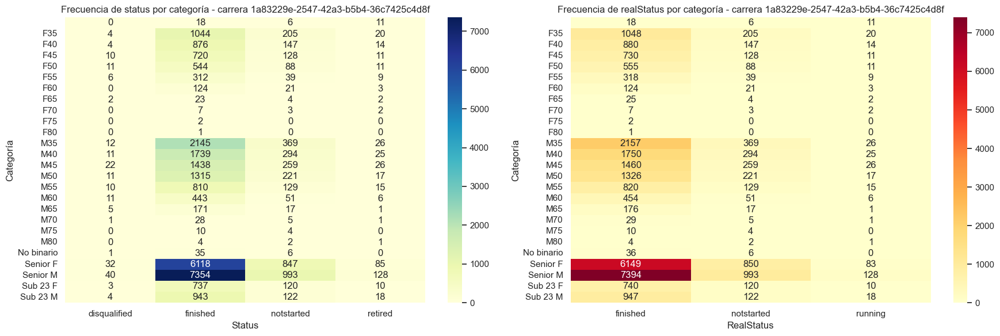


=== Carrera: cf6f71f2-1235-45e3-802e-02833b71ae8b ===
Casos incoherentes en estados: 0

=== Frecuencia de status por categoría ===


status,finished,notstarted,retired
category,,,
CORPORATE,83,6,1
ELITE,324,7,5
FEMALE DUO,48,0,0
FEMINA ELITE,171,15,6
FEMINA MASTER,80,4,0
MALE DUO,156,0,0
MASTER 40,648,30,12
MASTER 50,656,20,8
MASTER 60,314,1,3



=== Frecuencia de realStatus por categoría ===


realStatus,finished,notstarted,running
category,,,
CORPORATE,83,6,1
ELITE,324,7,5
FEMALE DUO,48,0,0
FEMINA ELITE,171,15,6
FEMINA MASTER,80,4,0
MALE DUO,156,0,0
MASTER 40,648,32,10
MASTER 50,656,21,7
MASTER 60,314,1,3


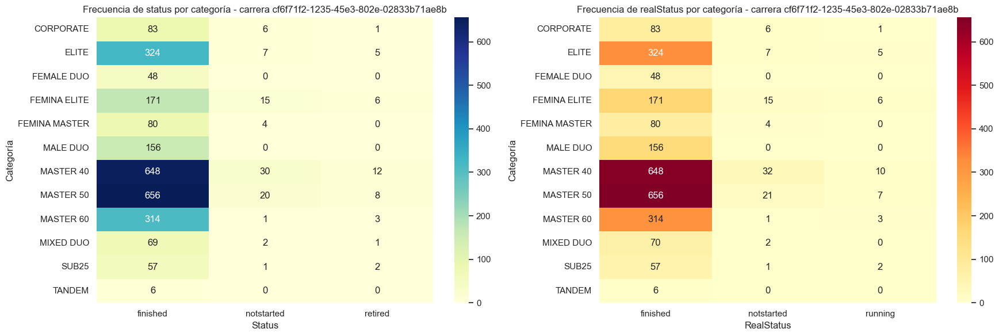


=== Carrera: 331e7589-6440-4968-9b44-484ba589824e ===
Casos incoherentes en estados: 0

=== Frecuencia de status por categoría ===


status,disqualified,finished,notstarted,quarantine,retired
category,,,,,
,3,18,1,0,6
F40,0,1,0,0,0
M35,20,2211,436,0,74
M40,26,2169,372,0,101
M45,38,1924,343,0,108
M50,38,1645,303,0,80
M55,20,928,175,0,45
M60,17,460,76,0,19
M65,5,170,39,0,12



=== Frecuencia de realStatus por categoría ===


realStatus,finished,notstarted,running
category,,,
,21,1,6
F40,1,0,0
M35,2231,436,74
M40,2195,372,101
M45,1962,343,108
M50,1683,303,80
M55,948,175,45
M60,477,76,19
M65,175,39,12


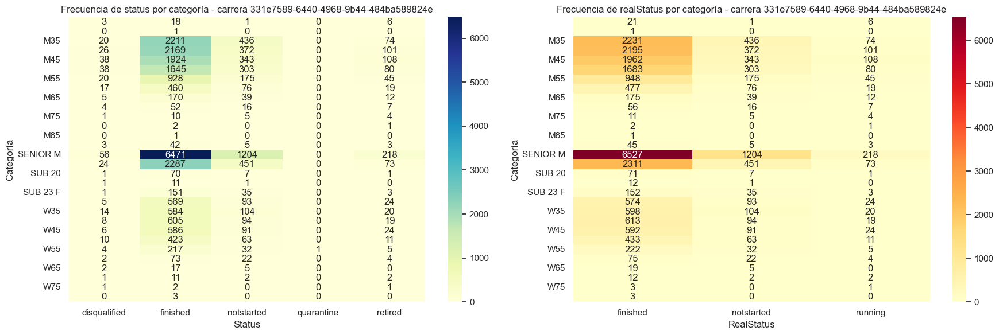

In [ ]:
print("Análisis de status y realStatus por carrera")

atletas_con_meta = athletes_time_df[athletes_time_df['split'] == 'Meta'][['athlete_id', 'event_id', 'race_id']]

for race in athletes_events_df['race_id'].unique():
    df_race = athletes_events_df[athletes_events_df['race_id'] == race].copy()
    print(f"\n=== Carrera: {race} ===")
    
    cond_finalizado_sin_meta = (
        (df_race['status'] == 'finished') & 
        (~df_race.set_index(['athlete_id','event_id','race_id']).index.isin(
            atletas_con_meta[atletas_con_meta['race_id'] == race]
            .set_index(['athlete_id','event_id','race_id']).index
        ))
    )
    
    cond_sin_salida_con_tiempo = (
        (df_race['status'] == 'notstarted') & 
        (df_race['startTime_td'].notna())
    )
    
    incoherentes = df_race[cond_finalizado_sin_meta | cond_sin_salida_con_tiempo]
    print(f"Casos incoherentes en estados: {len(incoherentes)}")
    if len(incoherentes) > 0:
        display(incoherentes[['athlete_id', 'event_id', 'status', 'realStatus', 'startTime_td']].head(10))
    
    status_summary = df_race.groupby(['category', 'status']).size().unstack(fill_value=0)
    realstatus_summary = df_race.groupby(['category', 'realStatus']).size().unstack(fill_value=0)
    
    print("\n=== Frecuencia de status por categoría ===")
    display(status_summary)
    
    print("\n=== Frecuencia de realStatus por categoría ===")
    display(realstatus_summary)
    
    fig, axes = plt.subplots(1, 2, figsize=(18, 6))
    
    sns.heatmap(status_summary, cmap="YlGnBu", ax=axes[0], annot=True, fmt="d")
    axes[0].set_title(f"Frecuencia de status por categoría - carrera {race}")
    axes[0].set_xlabel("Status")
    axes[0].set_ylabel("Categoría")
    
    sns.heatmap(realstatus_summary, cmap="YlOrRd", ax=axes[1], annot=True, fmt="d")
    axes[1].set_title(f"Frecuencia de realStatus por categoría - carrera {race}")
    axes[1].set_xlabel("RealStatus")
    axes[1].set_ylabel("Categoría")
    
    plt.tight_layout()
    plt.show()

status hace referencia al estado en carrera del atleta, y realstatus al estado automatico del mismo, sin intervención humana y sin que haya temrinado la carrera.

No se detectaron casos incoherentes, lo que indica que los registros de status y realStatus son consistentes con los tiempos de salida y meta neta. Al examinar la distribución por categoría, se observa que la mayoría de los atletas terminan la carrera (finished), mientras que una menor proporción corresponde a estados como notstarted, retired o disqualified. Los datos de realStatus reflejan un patrón muy similar, con predominancia de finished y algunos atletas en running o notstarted, confirmando la coherencia entre los registros oficiales y los observados. Esta consistencia sugiere que la gestión de resultados y la asignación de estados fue correcta y no se detectan anomalías significativas entre categorías ni géneros, incluyendo categorías especiales como Sub 23 y Senior.

Posiblemente campos como retired o disqualified estén bien mapeados en los issues, por lo que podemos buscar relaciones con los datos que ya tenemos para saber el porque de esas descalificaciones y retiros y observar como automatizarlos. 

- La mayoría de atletas completan la carrera en todas las categorías.

- Las retiradas y no iniciaciones aumentan ligeramente con la edad.

- Las descalificaciones son raras y distribuidas de forma homogénea.

- Las categorías con más participantes (Senior, M35-M55, F35-F50) concentran la mayor parte de los datos, pero siguen la misma tendencia.

#### StartNetTime con backup

Comprobamos la correlación entre estas dos variables

In [ ]:
print("Análisis de atletas con startNetTime nulo o negativo y backup en el split de salida")

df_salida = athletes_time_df[athletes_time_df['split'] == 'Salida'].copy()

if 'startNetTime' not in athletes_events_df.columns:
    raise KeyError("No se encontró la columna 'startNetTime' en athletes_events_df.")

df_salida = df_salida.merge(
    athletes_events_df[['athlete_id', 'race_id', 'startNetTime']],
    on=['athlete_id', 'race_id'],
    how='left'
)

if pd.api.types.is_timedelta64_dtype(df_salida['startNetTime']):
    df_salida['startNetTime_sec'] = df_salida['startNetTime'].dt.total_seconds()
else:
    df_salida['startNetTime_sec'] = pd.to_numeric(df_salida['startNetTime'], errors='coerce')

def resumen_startNetTime(df):
    cond_nulo_neg = df['startNetTime_sec'].isna() | (df['startNetTime_sec'] < 0)
    cond_backup = df['isBackup'] == True
    
    total = len(df)
    total_cond = cond_nulo_neg.sum()
    total_cond_backup = (cond_nulo_neg & cond_backup).sum()
    
    resumen = {
        'total_atletas': total,
        'n_nulo_neg': total_cond,
        'pct_nulo_neg': (total_cond / total * 100) if total > 0 else 0,
        'n_backup_dentro_cond': total_cond_backup,
        'pct_backup_dentro_cond': (total_cond_backup / total_cond * 100) if total_cond > 0 else 0,
        'pct_backup_sobre_total': (total_cond_backup / total * 100) if total > 0 else 0
    }
    
    ejemplos = df.loc[cond_nulo_neg & cond_backup,
                      ['athlete_id', 'race_id', 'split', 'startNetTime', 'startNetTime_sec', 'isBackup']]
    
    return resumen, ejemplos

for race in df_salida['race_id'].unique():
    df_race = df_salida[df_salida['race_id'] == race]
    resumen_race, ejemplos_race = resumen_startNetTime(df_race)
    
    print(f"\n=== Carrera {race} ===")
    print(f"Total atletas en split 'Salida': {resumen_race['total_atletas']}")
    print(f"Atletas con startNetTime nulo o negativo: {resumen_race['n_nulo_neg']} ({resumen_race['pct_nulo_neg']:.2f}%)")
    print(f"De esos, con isBackup=True: {resumen_race['n_backup_dentro_cond']} ({resumen_race['pct_backup_dentro_cond']:.2f}% de los afectados)")
    print(f"En total, {resumen_race['pct_backup_sobre_total']:.2f}% del total de atletas tienen startNetTime nulo/negativo y backup activo en salida")
    
    if len(ejemplos_race) > 0:
        print("\nEjemplos:")
        display(ejemplos_race.head(10))

print("\n=== Conjunto total de carreras ===")
resumen_total, ejemplos_total = resumen_startNetTime(df_salida)
print(f"Total atletas en split 'Salida': {resumen_total['total_atletas']}")
print(f"Atletas con startNetTime nulo o negativo: {resumen_total['n_nulo_neg']} ({resumen_total['pct_nulo_neg']:.2f}%)")
print(f"De esos, con isBackup=True: {resumen_total['n_backup_dentro_cond']} ({resumen_total['pct_backup_dentro_cond']:.2f}% de los afectados)")
print(f"En total, {resumen_total['pct_backup_sobre_total']:.2f}% del total de atletas tienen startNetTime nulo/negativo y backup activo en salida")

if len(ejemplos_total) > 0:
    print("\nEjemplos:")
    display(ejemplos_total.head(10))

Análisis de atletas con startNetTime nulo o negativo y backup en el split de salida

=== Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f ===
Total atletas en split 'Salida': 27466
Atletas con startNetTime nulo o negativo: 28 (0.10%)
De esos, con isBackup=True: 0 (0.00% de los afectados)
En total, 0.00% del total de atletas tienen startNetTime nulo/negativo y backup activo en salida

=== Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b ===
Total atletas en split 'Salida': 15876
Atletas con startNetTime nulo o negativo: 2786 (17.55%)
De esos, con isBackup=True: 0 (0.00% de los afectados)
En total, 0.00% del total de atletas tienen startNetTime nulo/negativo y backup activo en salida

=== Carrera ad64fc28-2968-4993-a182-f642c0310a93 ===
Total atletas en split 'Salida': 22892
Atletas con startNetTime nulo o negativo: 34 (0.15%)
De esos, con isBackup=True: 0 (0.00% de los afectados)
En total, 0.00% del total de atletas tienen startNetTime nulo/negativo y backup activo en salida

=== Carrera 331e75

Vemos como ninguno de os tiempos con un startNetTime negativo o nulo tiene un backup usado. Esto nos invita a pensar en la necesidad de poder imputar o interpolar estos tiempos. 

Hacemos lo mismo para rawTime

In [ ]:

print("Análisis de filas con rawTime nulo y flag de backup, por carrera y evento")

df = athletes_time_df.copy()

# Función de resumen
def resumen_rawTime(df):
    missing_raw = df['rawTime'].isna()
    total_missing = missing_raw.sum()
    
    backup_in_missing = df.loc[missing_raw, 'isBackup'] == True
    count_backup_true = backup_in_missing.sum()
    
    perc_backup = (count_backup_true / total_missing * 100) if total_missing > 0 else 0
    
    resumen = {
        'total_filas': len(df),
        'total_missing_rawTime': total_missing,
        'backup_true_en_missing': count_backup_true,
        'perc_backup_en_missing': perc_backup
    }
    
    ejemplos = df.loc[missing_raw & backup_in_missing]
    
    return resumen, ejemplos

# --- Por carrera y evento ---
for race in df['race_id'].unique():
    df_race = df[df['race_id'] == race]
    
    for event in df_race['event_id'].unique():
        df_group = df_race[df_race['event_id'] == event]
        
        # Saltar grupos muy pequeños
        if len(df_group) < 100:
            print(f"\n⚠️ Carrera {race}, Evento {event} tiene menos de 100 filas, se salta")
            continue
        
        resumen_group, ejemplos_group = resumen_rawTime(df_group)
        
        print(f"\n=== Carrera {race}, Evento {event} ===")
        print(f"Total filas: {resumen_group['total_filas']}")
        print(f"Filas con rawTime nulo: {resumen_group['total_missing_rawTime']}")
        print(f"De esas, con isBackup=True: {resumen_group['backup_true_en_missing']}")
        print(f"Porcentaje de filas con rawTime nulo y backup activo: {resumen_group['perc_backup_en_missing']:.2f}%")
        
        if len(ejemplos_group) > 0:
            print("\nEjemplos:")
            display(ejemplos_group.head(10))

# --- Conjunto total ---
print("\n=== Conjunto total de carreras y eventos ===")
resumen_total, ejemplos_total = resumen_rawTime(df)
print(f"Total filas: {resumen_total['total_filas']}")
print(f"Filas con rawTime nulo: {resumen_total['total_missing_rawTime']}")
print(f"De esas, con isBackup=True: {resumen_total['backup_true_en_missing']}")
print(f"Porcentaje de filas con rawTime nulo y backup activo: {resumen_total['perc_backup_en_missing']:.2f}%")

if len(ejemplos_total) > 0:
    print("\nEjemplos:")
    display(ejemplos_total.head(10))

Análisis de filas con rawTime nulo y flag de backup, por carrera y evento

=== Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f, Evento Mitja ===
Total filas: 162743
Filas con rawTime nulo: 0
De esas, con isBackup=True: 0
Porcentaje de filas con rawTime nulo y backup activo: 0.00%

=== Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b, Evento Stage 1 ===
Total filas: 4000
Filas con rawTime nulo: 0
De esas, con isBackup=True: 0
Porcentaje de filas con rawTime nulo y backup activo: 0.00%

=== Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b, Evento Stage 2 ===
Total filas: 1772
Filas con rawTime nulo: 0
De esas, con isBackup=True: 0
Porcentaje de filas con rawTime nulo y backup activo: 0.00%

=== Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b, Evento Stage 3 ===
Total filas: 4430
Filas con rawTime nulo: 0
De esas, con isBackup=True: 0
Porcentaje de filas con rawTime nulo y backup activo: 0.00%

=== Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b, Evento Stage 4 ===
Total filas: 3839
Filas con rawTime nulo

Todos los tiempos perdidos tienen un backup, pero aquí no lo podemos ver ya que esos tiempos perdidos fueron imputados dutrante la carrera de forma sencilla. Puede ser inetresante imputar los datos ya que en muchas ocasiones ni el rawTime ni el backup pueden guardar el dato por erores que afecten a ambos. 

#### StartTime vs edad/category

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


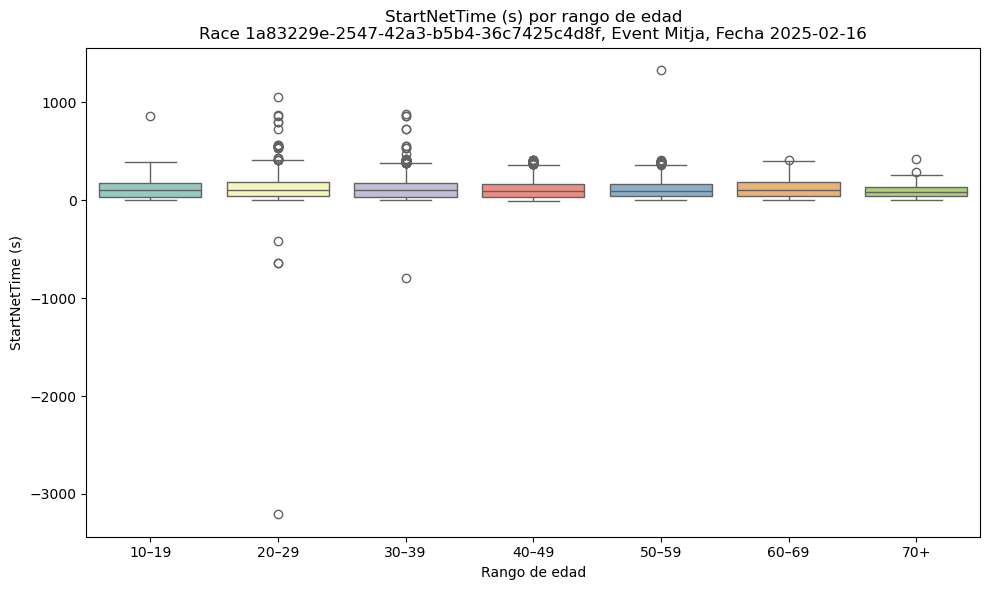

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


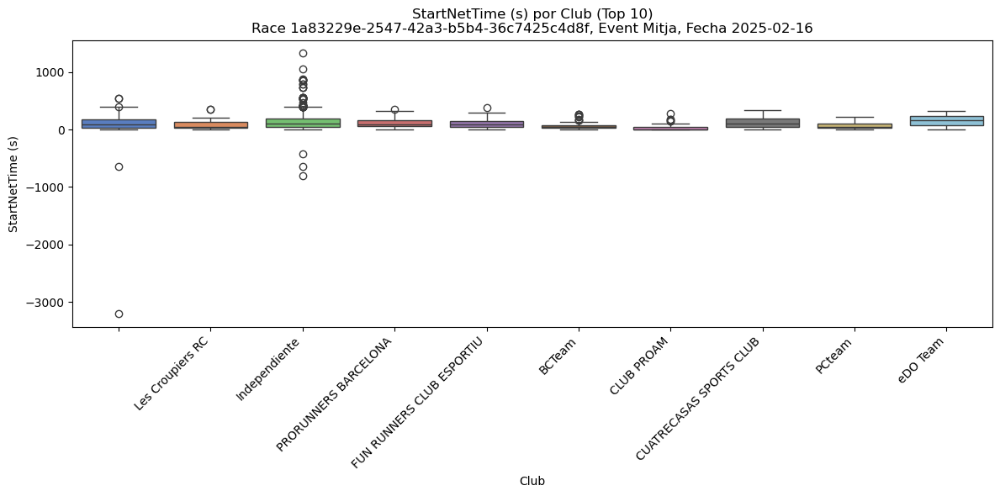

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


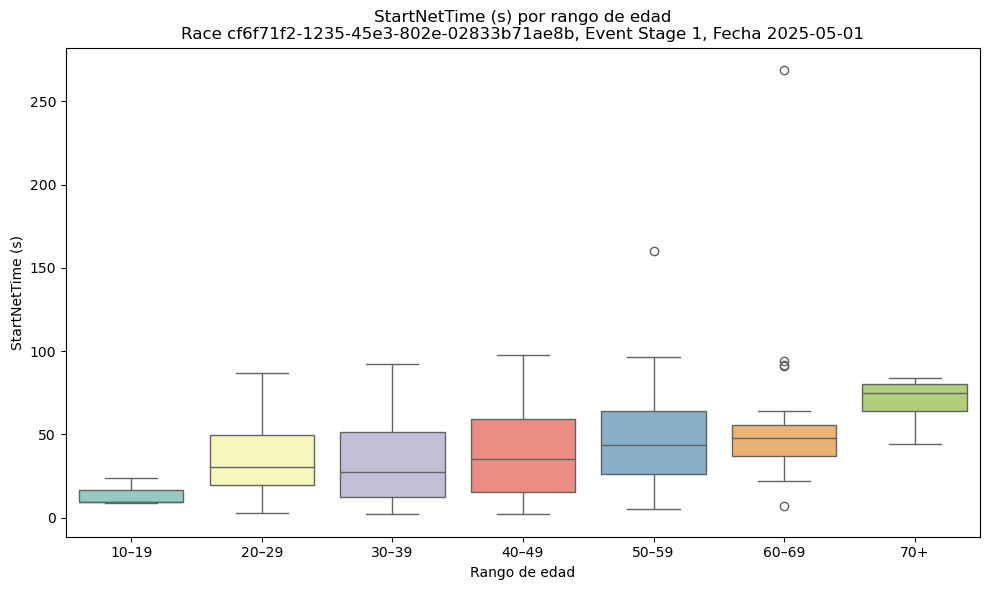

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


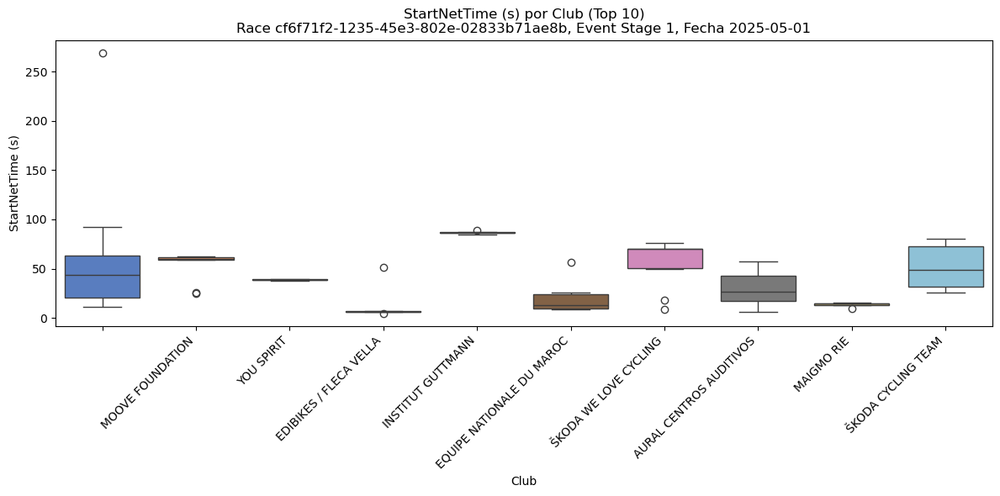

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


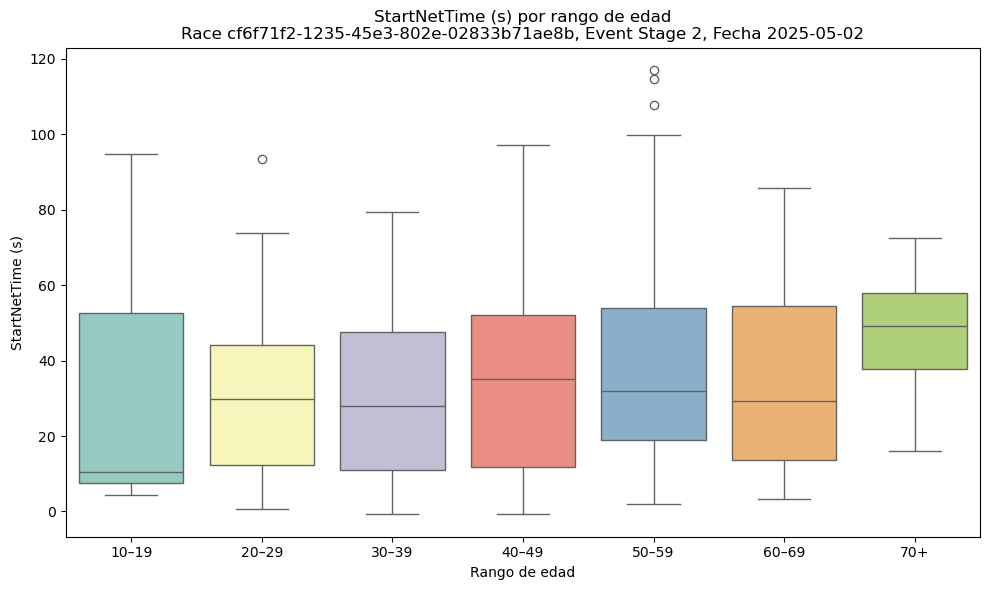

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


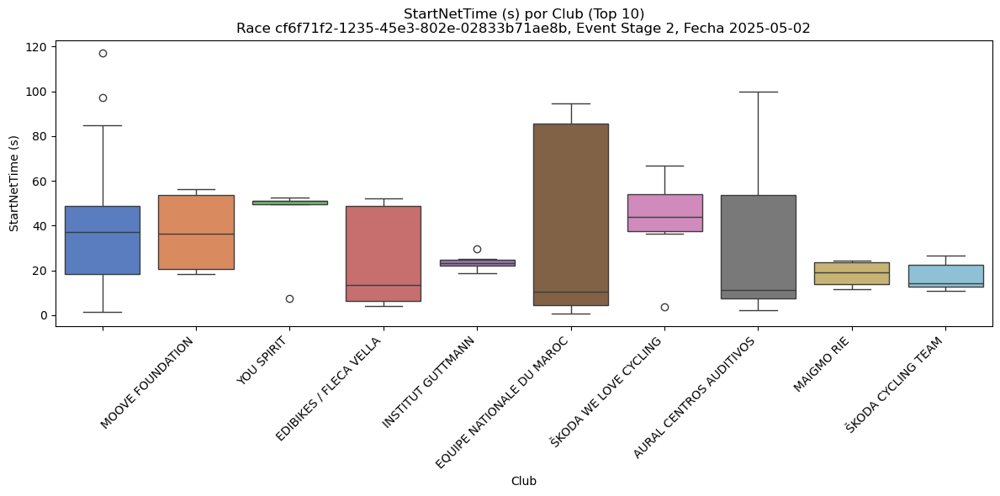

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


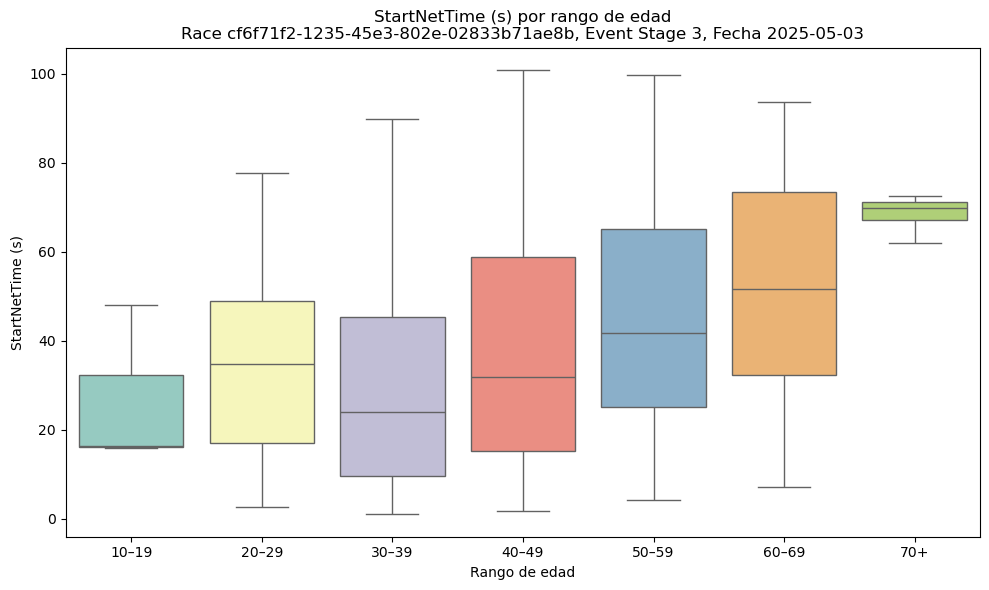

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


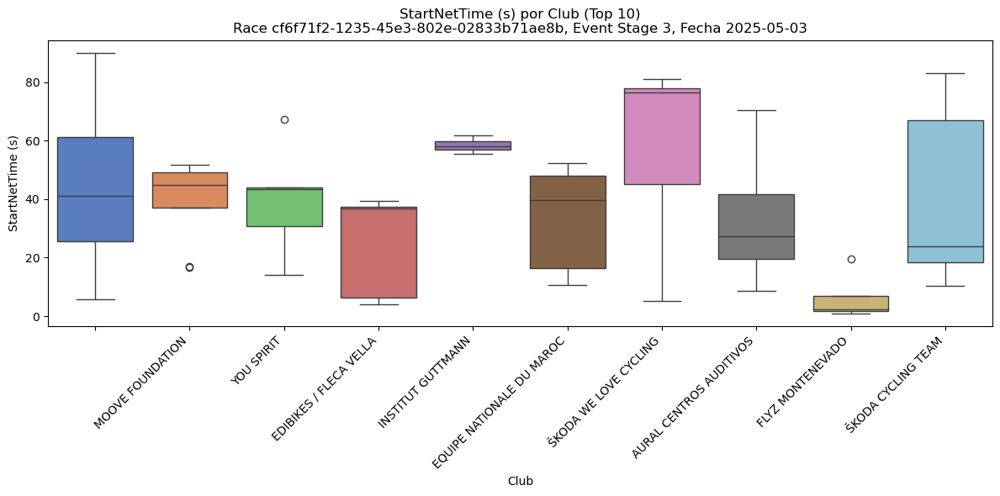

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


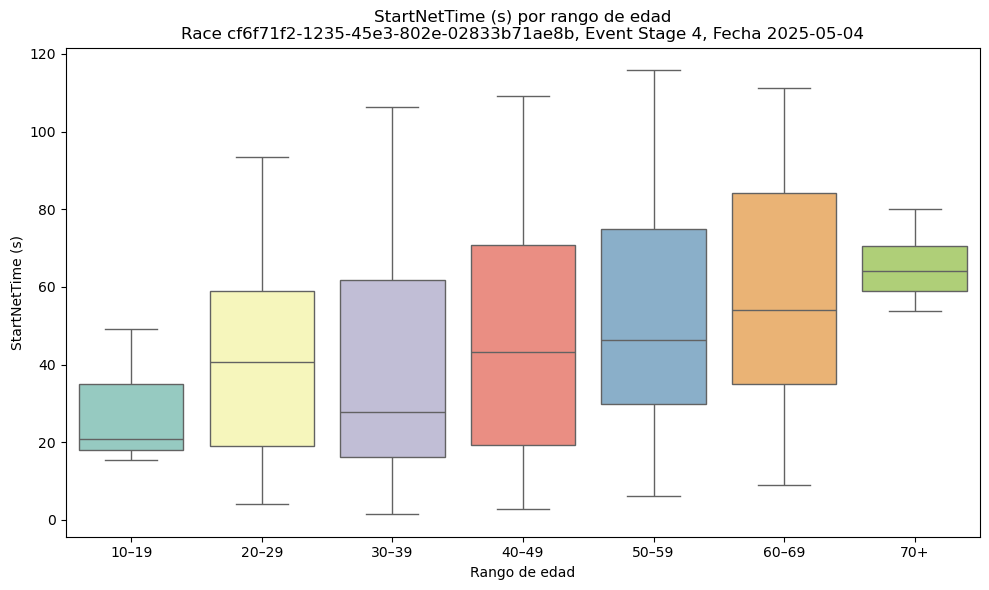

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


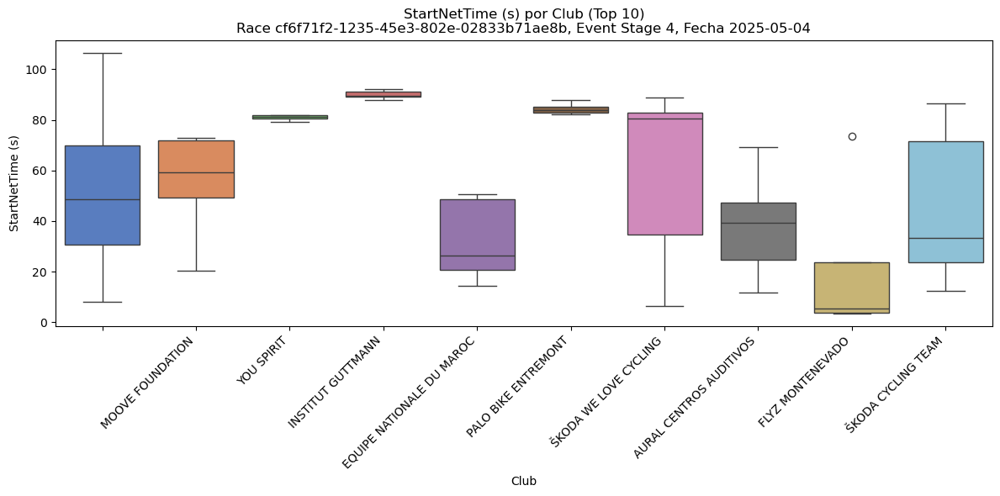

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


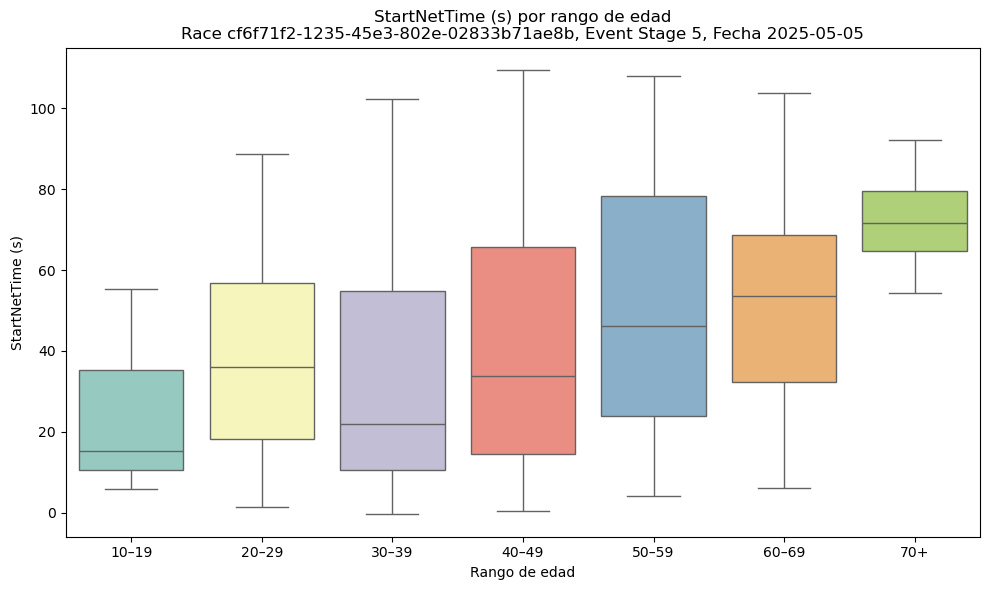

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


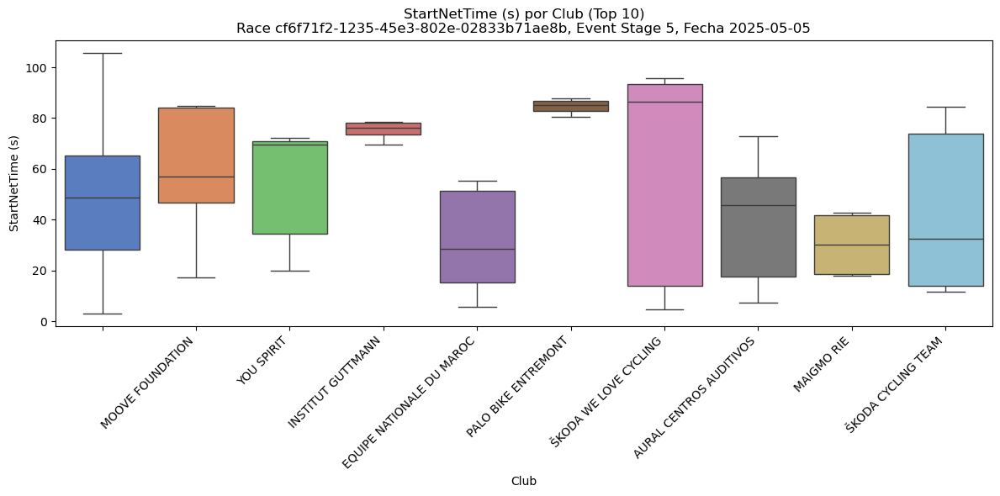

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


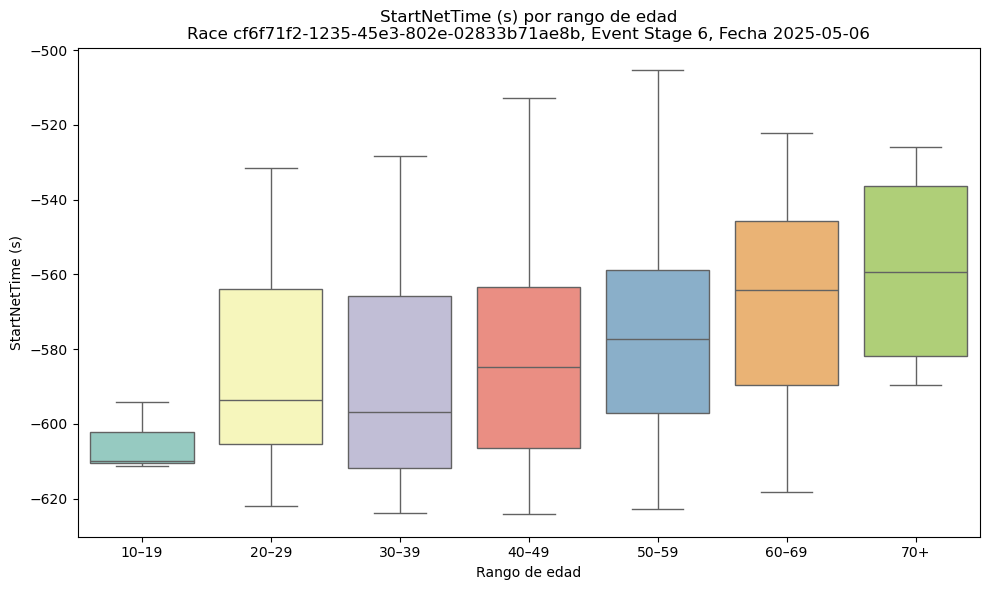

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


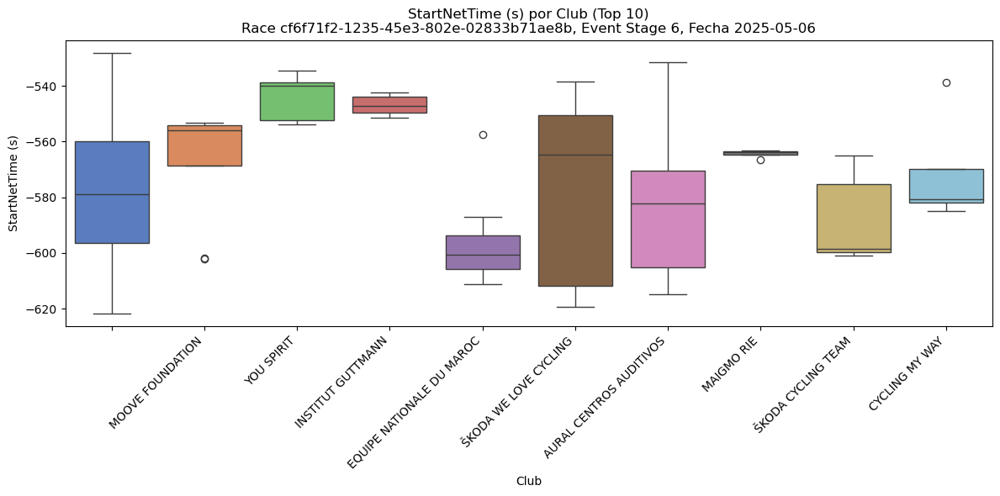

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


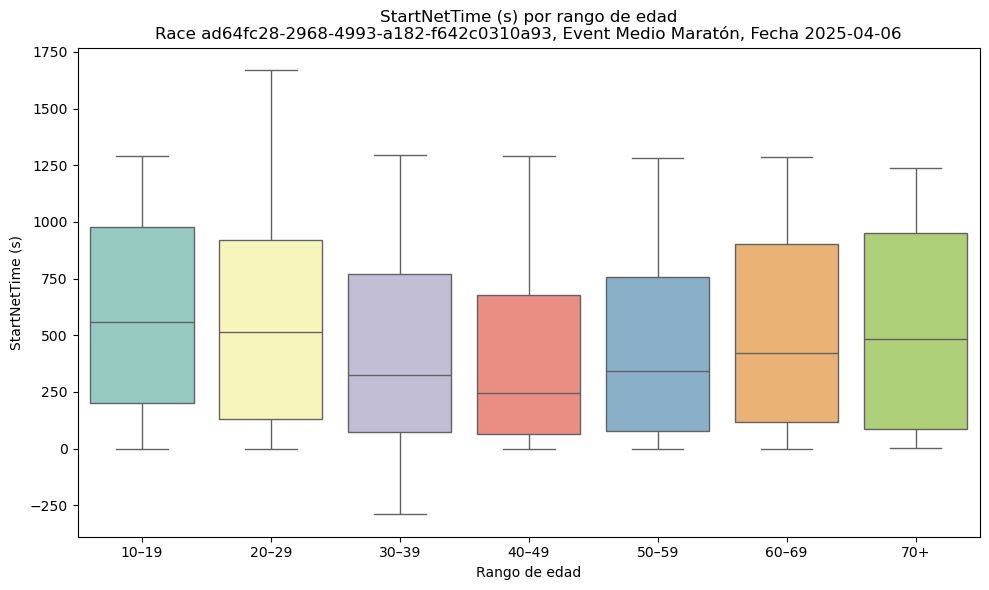

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


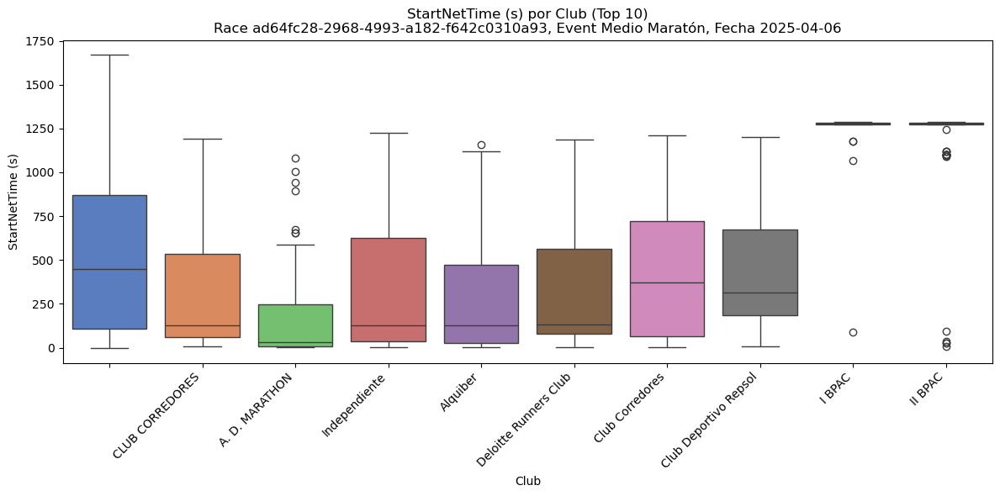

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


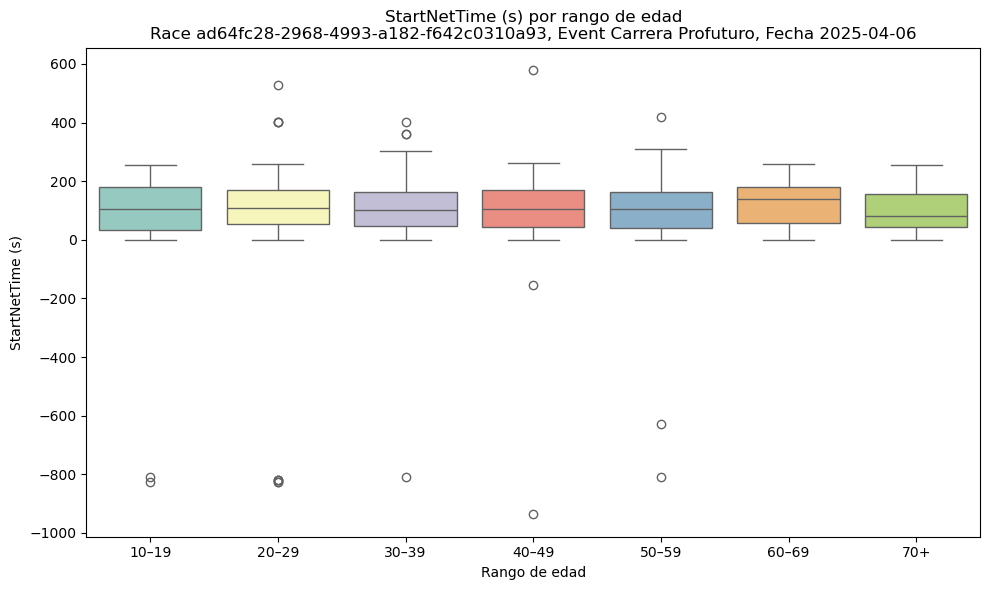

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


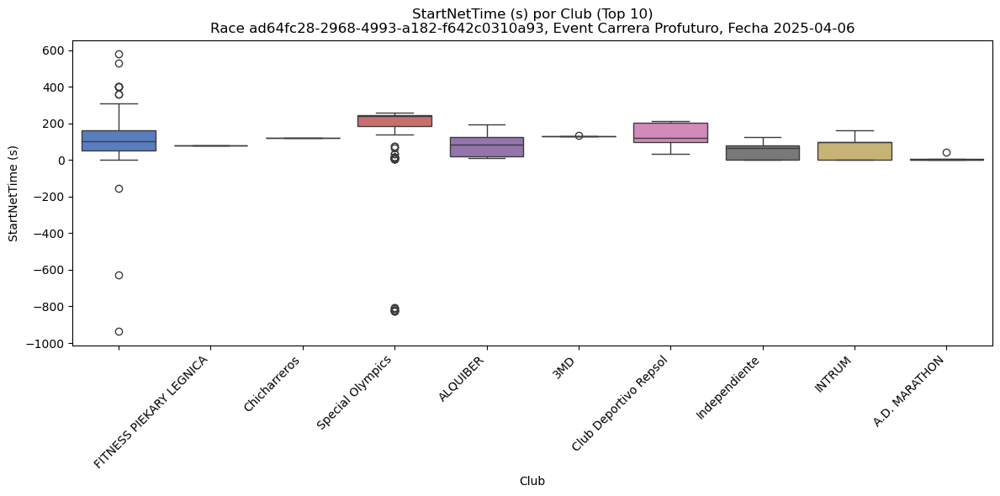

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


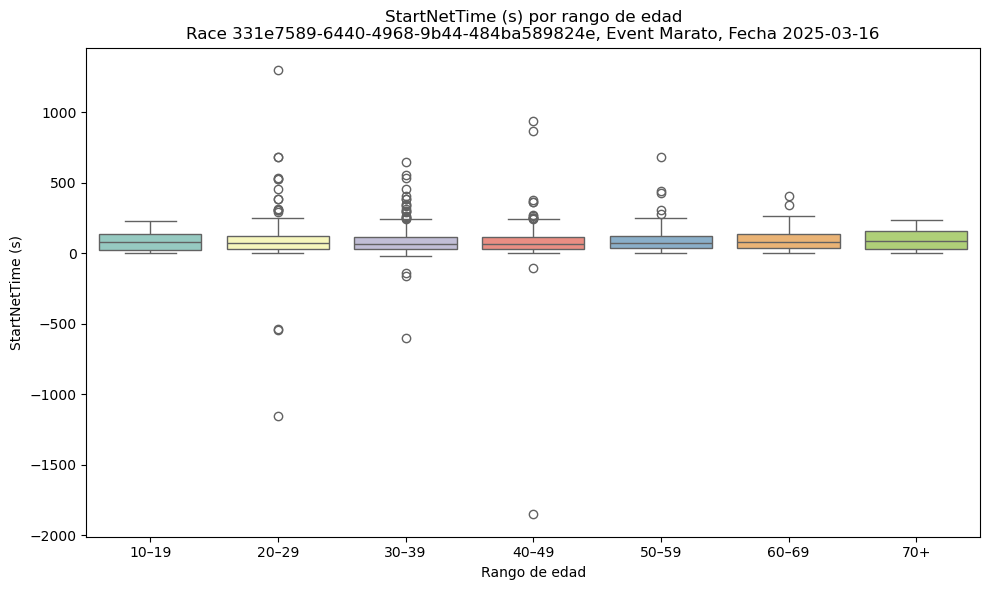

C:\Users\mario\AppData\Local\Temp\ipykernel_2248\679169210.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


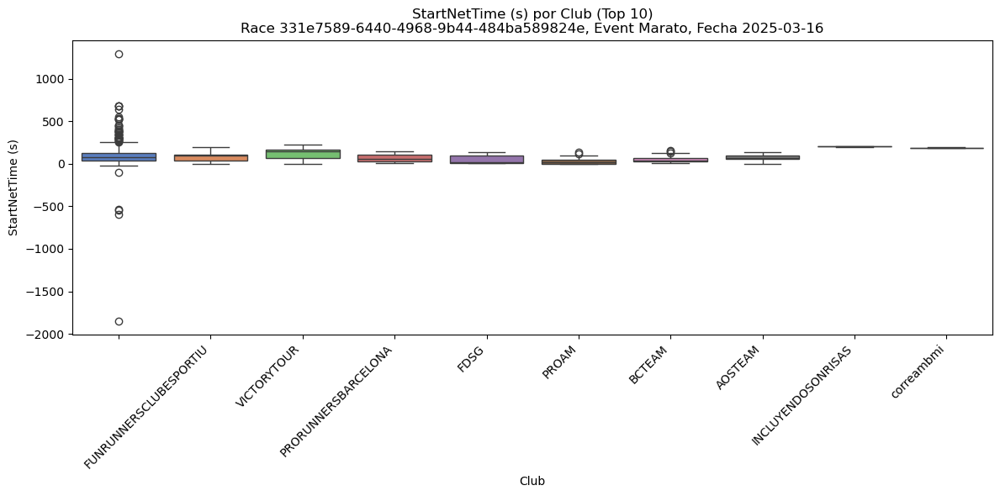

In [ ]:
merge_analisis = athletes_events_df.merge(
    athletes_df[['athlete_id', 'birthdate', 'club']],
    on='athlete_id',
    how='left'
).dropna(subset=['startRawTime', 'birthdate', 'club'])

for race in merge_analisis['race_id'].unique():
    df_race = merge_analisis[merge_analisis['race_id'] == race]

    for event in df_race['event_id'].unique():
        df_group = df_race[df_race['event_id'] == event].copy()

        if len(df_group) < 100:
            print(f"race_id={race}, event_id={event} tiene menos de 100 atletas. Saltando.")
            continue

        fecha_carrera = pd.to_datetime(df_group['startRawTime'].min().floor('D'))

        df_group['edad'] = (fecha_carrera - df_group['birthdate']).dt.days / 365.25
        df_group['edad'] = df_group['edad'].where(df_group['edad'].between(10, 100)).round(0)

        if 'startNetTime_td' in df_group.columns:
            df_group['startNetTime_td_sec'] = df_group['startNetTime_td'].dt.total_seconds()
        elif 'startNetTime' in df_group.columns:
            df_group['startNetTime_td_sec'] = df_group['startNetTime'] / 1000
        else:
            raise KeyError("No se encontró columna de startNetTime para convertir a segundos.")

        edad_bins = [10, 20, 30, 40, 50, 60, 70, 100]
        edad_labels = ['10–19','20–29','30–39','40–49','50–59','60–69','70+']
        df_group['rango_edad'] = pd.cut(df_group['edad'], bins=edad_bins, labels=edad_labels)
        df_group = df_group.dropna(subset=['rango_edad', 'startNetTime_td_sec', 'club'])
        df_group['rango_edad'] = df_group['rango_edad'].astype(str)

        plt.figure(figsize=(10, 6))
        sns.boxplot(
            data=df_group,
            x='rango_edad',
            y='startNetTime_td_sec',
            palette='Set3',
            order=edad_labels
        )
        plt.title(f"StartNetTime (s) por rango de edad\nRace {race}, Event {event}, Fecha {fecha_carrera.date()}")
        plt.xlabel("Rango de edad")
        plt.ylabel("StartNetTime (s)")
        plt.tight_layout()
        plt.show()

        top_clubs = df_group['club'].value_counts().head(10).index
        plt.figure(figsize=(12, 6))
        sns.boxplot(
            data=df_group[df_group['club'].isin(top_clubs)],
            x='club',
            y='startNetTime_td_sec',
            palette='muted'
        )
        plt.title(f"StartNetTime (s) por Club (Top 10)\nRace {race}, Event {event}, Fecha {fecha_carrera.date()}")
        plt.xlabel("Club")
        plt.ylabel("StartNetTime (s)")
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.show()

Podemos ver como los atletas independientes parecen tener más startTime mal puestos, al igual que los mismos atletas más jóvenes, sobre todo en carreras a pìe.

En el siguiente código veremos el conteo de missings

#### Missings: Conteo 


=== Análisis de splits missing – Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f ===
Resumen descriptivo de missing splits:
       splitsMissing  maxConsecutiveSplitsMissing
count   31683.000000                 31683.000000
mean        0.046776                     0.044977
std         0.320416                     0.308892
min         0.000000                     0.000000
25%         0.000000                     0.000000
50%         0.000000                     0.000000
75%         0.000000                     0.000000
max         5.000000                     5.000000

Porcentaje de atletas por número de 'splitsMissing':
splitsMissing
0    96.97
1     2.21
2     0.34
3     0.22
4     0.17
5     0.09
Name: count, dtype: float64

Porcentaje de atletas por número de 'maxConsecutiveSplitsMissing':
maxConsecutiveSplitsMissing
0    96.97
1     2.30
2     0.31
3     0.17
4     0.16
5     0.09
Name: count, dtype: float64


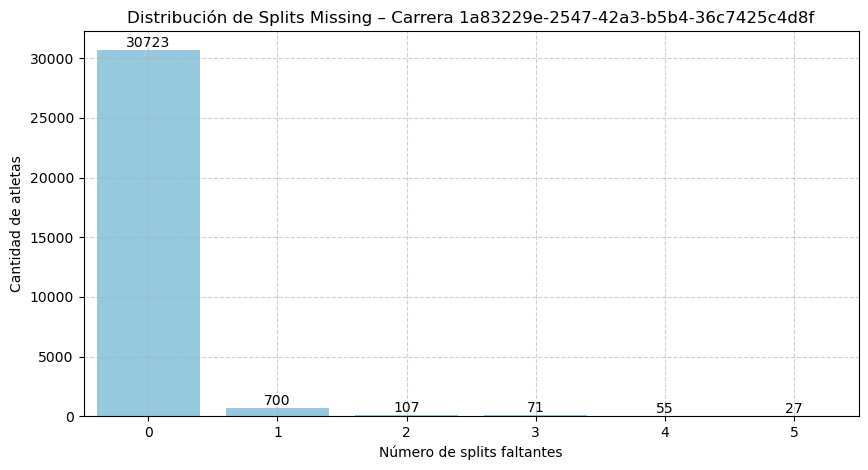

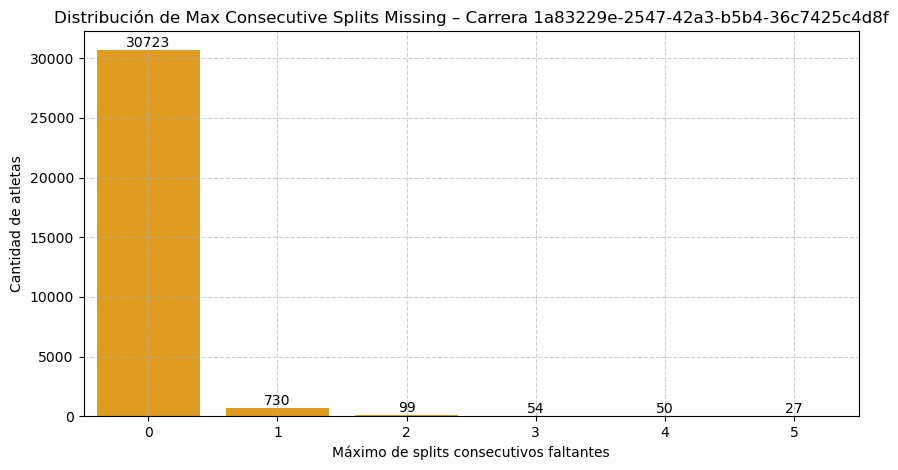

Número de atletas con seguimiento irregular (>3 splits faltantes): 82

=== Análisis de splits missing – Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b ===
Resumen descriptivo de missing splits:
       splitsMissing  maxConsecutiveSplitsMissing
count    3192.000000                  3192.000000
mean        0.371554                     0.357769
std         0.527922                     0.495491
min         0.000000                     0.000000
25%         0.000000                     0.000000
50%         0.000000                     0.000000
75%         1.000000                     1.000000
max         7.000000                     7.000000

Porcentaje de atletas por número de 'splitsMissing':
splitsMissing
0    64.54
1    34.02
2     1.32
3     0.09
7     0.03
Name: count, dtype: float64

Porcentaje de atletas por número de 'maxConsecutiveSplitsMissing':
maxConsecutiveSplitsMissing
0    64.54
1    35.31
2     0.13
7     0.03
Name: count, dtype: float64


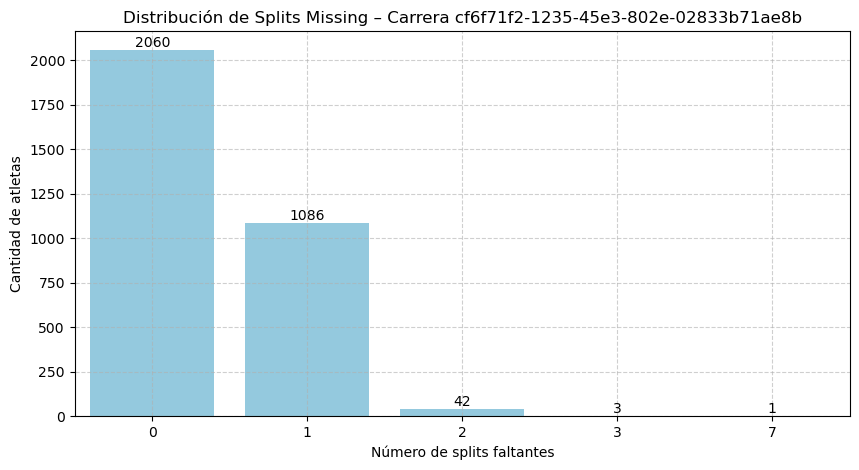

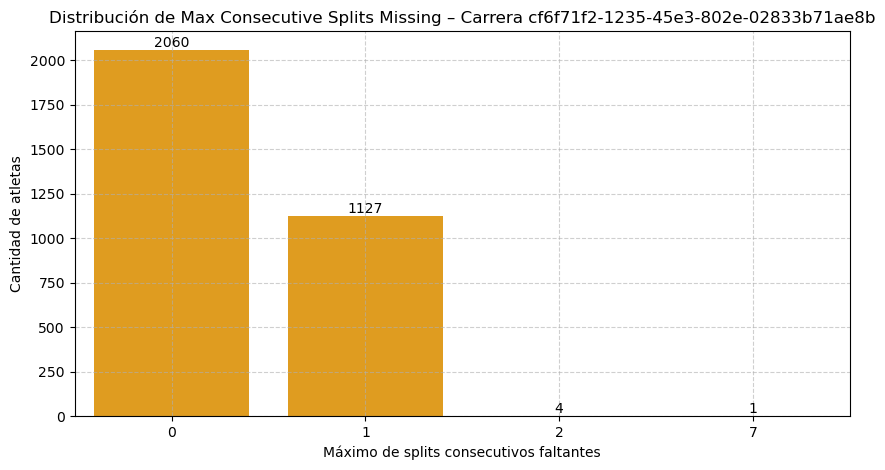

Número de atletas con seguimiento irregular (>3 splits faltantes): 1

=== Análisis de splits missing – Carrera ad64fc28-2968-4993-a182-f642c0310a93 ===
Resumen descriptivo de missing splits:
       splitsMissing  maxConsecutiveSplitsMissing
count   47902.000000                 47902.000000
mean        0.095528                     0.092334
std         0.356061                     0.339854
min         0.000000                     0.000000
25%         0.000000                     0.000000
50%         0.000000                     0.000000
75%         0.000000                     0.000000
max         5.000000                     5.000000

Porcentaje de atletas por número de 'splitsMissing':
splitsMissing
0    91.77
1     7.36
2     0.58
3     0.15
4     0.08
5     0.05
Name: count, dtype: float64

Porcentaje de atletas por número de 'maxConsecutiveSplitsMissing':
maxConsecutiveSplitsMissing
0    91.77
1     7.59
2     0.42
3     0.11
4     0.06
5     0.05
Name: count, dtype: float64


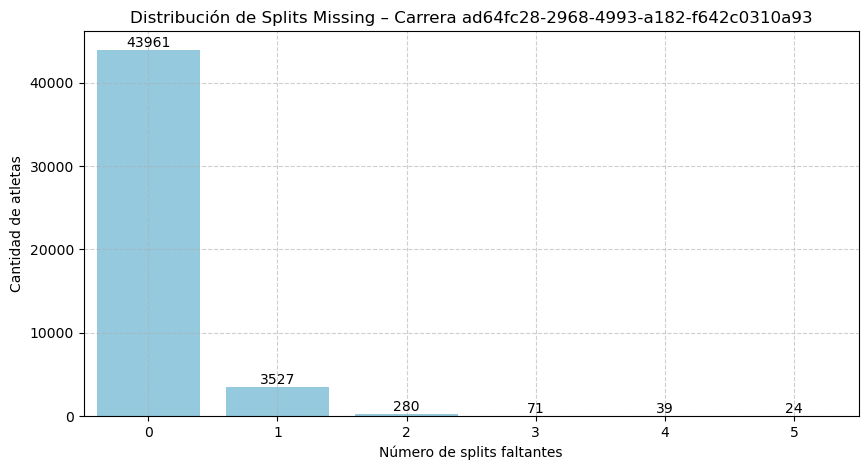

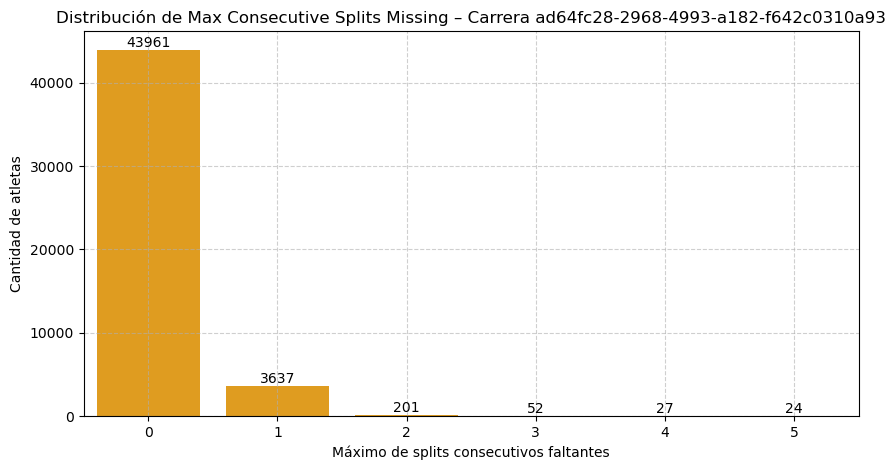

Número de atletas con seguimiento irregular (>3 splits faltantes): 63

=== Análisis de splits missing – Carrera 331e7589-6440-4968-9b44-484ba589824e ===
Resumen descriptivo de missing splits:
       splitsMissing  maxConsecutiveSplitsMissing
count   26865.000000                 26865.000000
mean        0.125851                     0.116843
std         0.740221                     0.695595
min         0.000000                     0.000000
25%         0.000000                     0.000000
50%         0.000000                     0.000000
75%         0.000000                     0.000000
max        10.000000                    10.000000

Porcentaje de atletas por número de 'splitsMissing':
splitsMissing
0     94.52
1      3.50
2      0.52
3      0.35
4      0.25
5      0.19
6      0.17
7      0.22
8      0.12
9      0.10
10     0.06
Name: count, dtype: float64

Porcentaje de atletas por número de 'maxConsecutiveSplitsMissing':
maxConsecutiveSplitsMissing
0     94.52
1      3.68
2      0.5

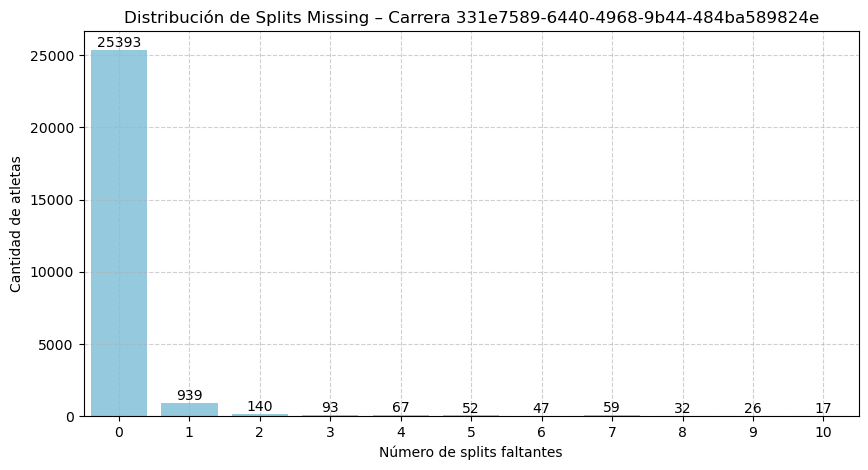

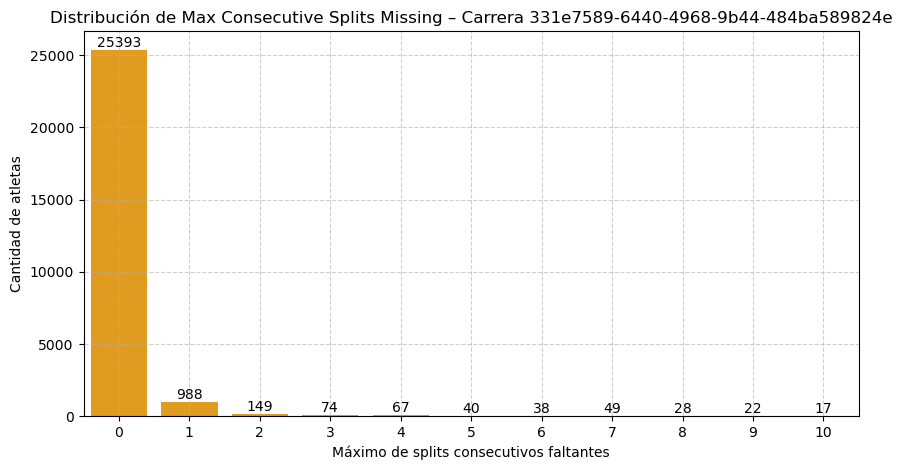

Número de atletas con seguimiento irregular (>3 splits faltantes): 300


In [ ]:
df = athletes_events_df.copy()

for race in df['race_id'].unique():
    df_race = df[df['race_id'] == race]
    print(f"\n=== Análisis de splits missing – Carrera {race} ===")
    
    summary = df_race[['splitsMissing', 'maxConsecutiveSplitsMissing']].describe()
    print("Resumen descriptivo de missing splits:")
    print(summary)
    
    count_splits = df_race['splitsMissing'].value_counts().sort_index()
    count_consecutive = df_race['maxConsecutiveSplitsMissing'].value_counts().sort_index()
    
    total = len(df_race)
    count_splits_pct = (count_splits / total * 100).round(2)
    count_consecutive_pct = (count_consecutive / total * 100).round(2)
    
    print("\nPorcentaje de atletas por número de 'splitsMissing':")
    print(count_splits_pct)
    
    print("\nPorcentaje de atletas por número de 'maxConsecutiveSplitsMissing':")
    print(count_consecutive_pct)
    
    plt.figure(figsize=(10,5))
    sns.barplot(x=count_splits.index, y=count_splits.values, color='skyblue')
    plt.title(f'Distribución de Splits Missing – Carrera {race}')
    plt.xlabel('Número de splits faltantes')
    plt.ylabel('Cantidad de atletas')
    plt.grid(True, linestyle='--', alpha=0.6)
    for i, v in enumerate(count_splits.values):
        plt.text(i, v + 0.5, str(v), ha='center', va='bottom')
    plt.show()
    
    plt.figure(figsize=(10,5))
    sns.barplot(x=count_consecutive.index, y=count_consecutive.values, color='orange')
    plt.title(f'Distribución de Max Consecutive Splits Missing – Carrera {race}')
    plt.xlabel('Máximo de splits consecutivos faltantes')
    plt.ylabel('Cantidad de atletas')
    plt.grid(True, linestyle='--', alpha=0.6)
    for i, v in enumerate(count_consecutive.values):
        plt.text(i, v + 0.5, str(v), ha='center', va='bottom')
    plt.show()
    
    # Seguimiento irregular (solo número)
    irregular_count = (df_race['splitsMissing'] > 3).sum()
    print(f"Número de atletas con seguimiento irregular (>3 splits faltantes): {irregular_count}")

Vemos como la mayoria de atletas no tienen muchos splits faltantes, de hecho más un 96% no tiene ninguno, esto es bastante bueno ya que vamos a poder tener datos completos de muchos atletas en todas las etapas de la carrera y nos van a servir para entender como se desarrollan los tiempos a muchos niveles. Por otro lado vemos como hay agunas personas con mas de 3 splits faltates que no han sido consecutivos, por lo que podriamos tener un precedente para analizar anomalias de falta de registros en carreras e identificar corredores a pone en cuarentena

### Nivel Atleta (Tiempos)

- Anomalías por reglas para las variables temporales más importantes. 
- Boxplots e histogramas de tiempos netos por split y velocidades medias por split
- Análisis de backups y datos válidos

Calculamos el tiempo por split. Creamos la variable en base a time_sec_spli, que sería una variable creada a partir de NetTime restada con el split anterior, para así obtener el tiempo por split. También se le añade una comparación de valor negativo para comprobar que todo ha salido bien con el tema del ordenamiento.

#### Calculo time_split

In [20]:
athletes_time_df = dfs['athletes_time_df']

df = athletes_time_df.copy()

df['netTime_sec'] = df['netTime_td'].dt.total_seconds()

df = df.sort_values(['athlete_id', 'race_id', 'event_id', 'netTime_sec'])

df['prev_netTime'] = df.groupby(['athlete_id', 'race_id', 'event_id'])['netTime_sec'].shift(1)
df['prev_split'] = df.groupby(['athlete_id', 'race_id', 'event_id'])['split'].shift(1)

df['first_split'] = df.groupby(['athlete_id', 'race_id', 'event_id']).cumcount() == 0

df['time_split_sec'] = 0.0
df.loc[df['split'] == 'Salida', 'time_split_sec'] = 0.0

mask_first = df['first_split'] & (df['split'] != 'Salida')
df.loc[mask_first, 'time_split_sec'] = df.loc[mask_first, 'netTime_sec']

mask_rest = ~df['first_split'] & (df['split'] != 'Salida')
df.loc[mask_rest, 'time_split_sec'] = df.loc[mask_rest, 'netTime_sec'] - df.loc[mask_rest, 'prev_netTime']

athletes_time_df['time_split_sec'] = df['time_split_sec']
athletes_time_df['prev_split'] = df['prev_split']

negativos = df[df['time_split_sec'] < 0]
display(negativos[['athlete_id','race_id','event_id','prev_split','split','netTime_td','time_split_sec']])


,athlete_id,race_id,event_id,prev_split,split,netTime_td,time_split_sec


Vemos como ningún valor ha salido negativo, por lo cual entendemos que ha salido bien el ordenamiento y, por tanto, el cálculo de time_sec_split.

#### Nomralidad time_split

Calculamos la normalidad:

In [7]:
resultados_normalidad = test_normalidad(df, 'time_split_sec', group_col=['event_id', 'race_id', 'split'])
print(resultados_normalidad.head(10))

c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: Input data has range zero. The results may not be accurate.
  res = hypotest_fun_out(*samples, **kwds)
c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_morestats.py:2248: RuntimeWarning: invalid value encountered in divide
  w = (y - xbar) / s
c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_distn_infrastructure.py:2071: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


            event_id                               race_id   split      n  \
0  Carrera Profuturo  ad64fc28-2968-4993-a182-f642c0310a93    2.5K   1774   
1  Carrera Profuturo  ad64fc28-2968-4993-a182-f642c0310a93    Meta   2005   
2  Carrera Profuturo  ad64fc28-2968-4993-a182-f642c0310a93  Salida   1933   
3             Marato  331e7589-6440-4968-9b44-484ba589824e     10K  22435   
4             Marato  331e7589-6440-4968-9b44-484ba589824e     15K  22349   
5             Marato  331e7589-6440-4968-9b44-484ba589824e     20K  22393   
6             Marato  331e7589-6440-4968-9b44-484ba589824e     25K  22158   
7             Marato  331e7589-6440-4968-9b44-484ba589824e     30K  21838   
8             Marato  331e7589-6440-4968-9b44-484ba589824e     35K  21797   
9             Marato  331e7589-6440-4968-9b44-484ba589824e     40K  21804   

   shapiro_stat     shapiro_p  dagostino_stat    dagostino_p  anderson_stat  \
0      0.507248  6.263558e-57     2418.732552   0.000000e+00     174.2515

In [8]:
resultados_normalidad = test_normalidad(df, 'time_split_sec', group_col=['event_id', 'race_id', 'split'], transform='sqrt')
print(resultados_normalidad.head(10))

c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: Input data has range zero. The results may not be accurate.
  res = hypotest_fun_out(*samples, **kwds)
c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_morestats.py:2248: RuntimeWarning: invalid value encountered in divide
  w = (y - xbar) / s
c:\Users\mario\anaconda3\Lib\site-packages\scipy\stats\_distn_infrastructure.py:2071: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


            event_id                               race_id   split      n  \
0  Carrera Profuturo  ad64fc28-2968-4993-a182-f642c0310a93    2.5K   1774   
1  Carrera Profuturo  ad64fc28-2968-4993-a182-f642c0310a93    Meta   2005   
2  Carrera Profuturo  ad64fc28-2968-4993-a182-f642c0310a93  Salida   1933   
3             Marato  331e7589-6440-4968-9b44-484ba589824e     10K  22435   
4             Marato  331e7589-6440-4968-9b44-484ba589824e     15K  22349   
5             Marato  331e7589-6440-4968-9b44-484ba589824e     20K  22393   
6             Marato  331e7589-6440-4968-9b44-484ba589824e     25K  22158   
7             Marato  331e7589-6440-4968-9b44-484ba589824e     30K  21838   
8             Marato  331e7589-6440-4968-9b44-484ba589824e     35K  21797   
9             Marato  331e7589-6440-4968-9b44-484ba589824e     40K  21804   

   shapiro_stat     shapiro_p  dagostino_stat    dagostino_p  anderson_stat  \
0      0.733398  1.068511e-46     1542.927437   0.000000e+00      91.4591

Se podría considerar que tampoco es normal, los warinigs son por el split de "salida"

#### Boxplots netTime

Aquí se va a ver en boxplots como funciona la variable netTime y se van a calcular outliers en base a la velocidad de los splits y el netTime con IQR


=== Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f ===


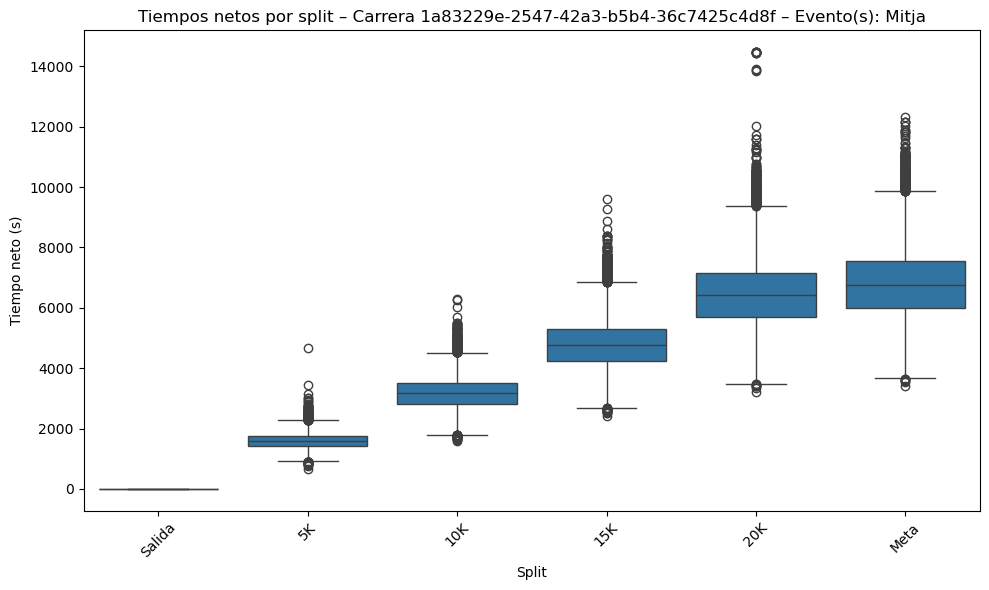


Número de anomalías por tipo:
anomaly_type
Outlier de tiempo    2920
Name: count, dtype: int64

Porcentaje de anomalías por split:
anomaly_type  Normal  Outlier de tiempo
split                                  
10K             98.0                2.0
15K             97.8                2.2
20K             97.7                2.3
5K              98.0                2.0
Meta            97.7                2.3
Salida         100.0                0.0

=== Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b ===


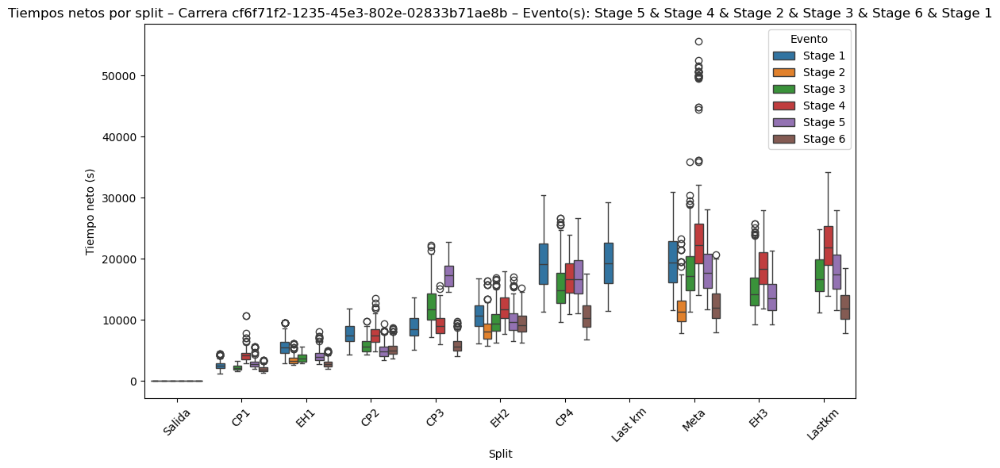


Número de anomalías por tipo:
anomaly_type
Velocidad imposible           1548
Outlier de tiempo              390
Ambas (velocidad y tiempo)     159
Name: count, dtype: int64

Porcentaje de anomalías por split:
anomaly_type  Ambas (velocidad y tiempo)  Normal  Outlier de tiempo  \
split                                                                 
CP1                                  0.6    80.8                2.9   
CP2                                  1.0    82.6                1.2   
CP3                                  1.0    87.6                2.7   
CP4                                  1.0    95.4                1.0   
EH1                                  1.0    77.0                4.1   
EH2                                  0.0    95.2                2.1   
EH3                                  1.0    96.0                1.9   
Last km                              1.1    96.4                1.1   
Lastkm                               0.8    95.9                1.4   
Meta    

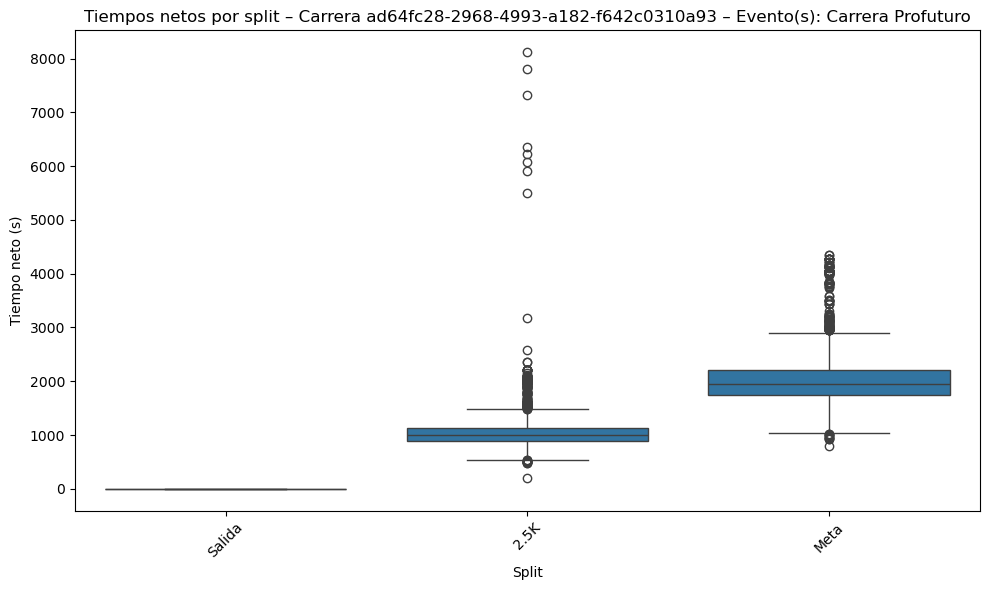

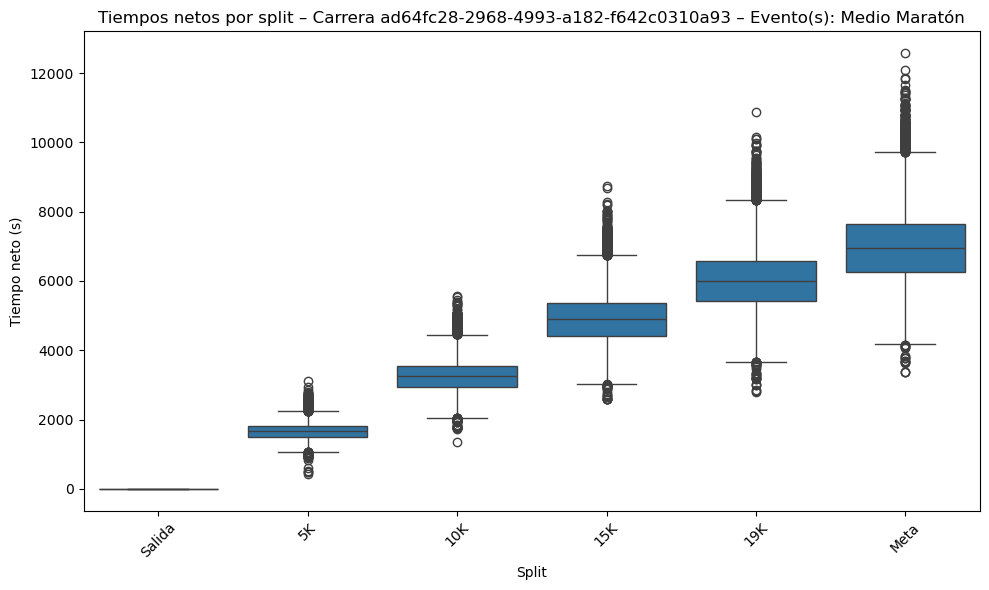


Número de anomalías por tipo:
anomaly_type
Outlier de tiempo    4275
Name: count, dtype: int64

Porcentaje de anomalías por split:
anomaly_type  Normal  Outlier de tiempo
split                                  
10K             97.6                2.4
15K             97.5                2.5
19K             97.5                2.5
2.5K            89.7               10.3
5K              97.6                2.4
Meta            90.5                9.5
Salida         100.0                0.0

=== Carrera 331e7589-6440-4968-9b44-484ba589824e ===


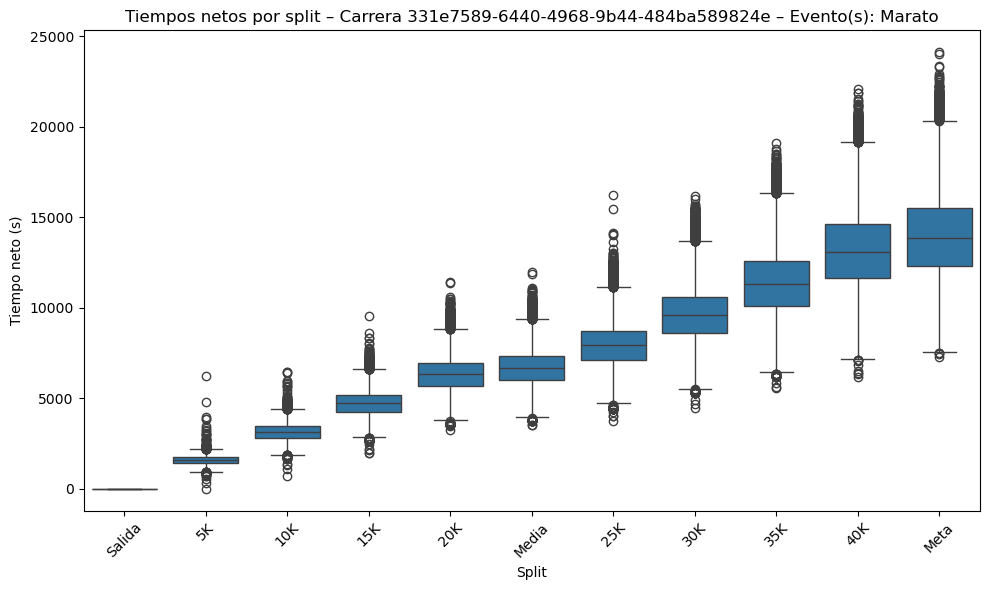


Número de anomalías por tipo:
anomaly_type
Outlier de tiempo    5118
Name: count, dtype: int64

Porcentaje de anomalías por split:
anomaly_type  Normal  Outlier de tiempo
split                                  
10K             97.9                2.1
15K             97.8                2.2
20K             97.6                2.4
25K             97.5                2.5
30K             97.5                2.5
35K             97.6                2.4
40K             97.7                2.3
5K              98.0                2.0
Media           97.5                2.5
Meta            97.7                2.3
Salida         100.0                0.0


In [ ]:
df_times = athletes_time_df.copy()
df_times['netTime_sec'] = df_times['netTime_td'].dt.total_seconds()
df_times['time_sec'] = df_times['time_td'].dt.total_seconds()

df_times['speed_m_per_s'] = np.where(df_times['average'] > 0, 1 / df_times['average'], np.nan)

def detect_anomalies_iqr(df):
    def outlier_iqr_percentiles(x):
        p1, q1, q3, p99 = np.nanpercentile(x, [1, 25, 75, 99])
        iqr = q3 - q1
        lower, upper = max(p1, q1 - 1.5 * iqr), min(p99, q3 + 1.5 * iqr)
        return (x < lower) | (x > upper)
    
    df['outlier_iqr'] = df.groupby('split')['netTime_sec'].transform(outlier_iqr_percentiles)
    df['speed_flag'] = df['speed_m_per_s'] > 7  

    df['anomaly_type'] = np.select(
        [
            df['speed_flag'] & df['outlier_iqr'],
            df['speed_flag'],
            df['outlier_iqr']
        ],
        [
            'Ambas (velocidad y tiempo)',
            'Velocidad imposible',
            'Outlier de tiempo'
        ],
        default='Normal'
    )
    
    return df

def group_events(event_list, max_dist=1):
    remaining = set(event_list)
    groups = []

    while remaining:
        start = remaining.pop()
        group = {start}
        queue = deque([start])
        while queue:
            current = queue.popleft()
            for other in list(remaining):
                if levenshtein_distance(current, other) <= max_dist:
                    group.add(other)
                    queue.append(other)
                    remaining.remove(other)
        groups.append(list(group))
    return groups

for race in df_times['race_id'].unique():
    print(f"\n=== Carrera {race} ===")
    df_race = df_times[df_times['race_id'] == race].copy()
    df_race = detect_anomalies_iqr(df_race)

    eventos = df_race['event_id'].unique().tolist()
    grupos_eventos = group_events(eventos, max_dist=1)

    for grupo in grupos_eventos:
        df_plot = df_race[df_race['event_id'].isin(grupo)].copy()
        nombre_comun = " & ".join(grupo)
        df_plot['event_group'] = nombre_comun

        plt.figure(figsize=(10,6))
        if len(grupo) > 1:
            sns.boxplot(data=df_plot, x='split', y='netTime_sec', hue='event_id')
            plt.legend(title='Evento')
        else:
            sns.boxplot(data=df_plot, x='split', y='netTime_sec')
            plt.legend([], [], frameon=False)

        plt.title(f"Tiempos netos por split – Carrera {race} – Evento(s): {nombre_comun}")
        plt.xlabel("Split")
        plt.ylabel("Tiempo neto (s)")
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()

    df_anomalies = df_race[df_race['anomaly_type'] != 'Normal']

    counts = df_anomalies['anomaly_type'].value_counts()
    print("\nNúmero de anomalías por tipo:")
    print(counts)

    summary_pct = (
        df_race.groupby('split')['anomaly_type']
        .value_counts(normalize=True)
        .unstack(fill_value=0)
        .round(3) * 100
    )
    print("\nPorcentaje de anomalías por split:")
    print(summary_pct)

- Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f

- - ÚNICAMENTE aparecen “Outliers de tiempo” (no hay velocidades imposibles).

- - El porcentaje de anomalías por split es muy bajo (≈2%), y bastante homogéneo.

- - En Salida = 0% anómalo, lo cual es normal porque todos suelen registrar el mismo tiempo o casi.


- Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b

- - Aquí sí aparecen tres tipos de anomalías:

- - Outliers de tiempo (390)

- - Splits como CP1, CP2, EH1 tienen anomalías totales entre 4% y 7%.

- - Salida = 0%, comportamiento normal.



- Carrera ad64fc28-2968-4993-a182-f642c0310a93

- - Solo aparecen outliers de tiempo, pero en mayor volumen (4275).

- - Splits con comportamiento normal (~2.4–2.5%) excepto:

- - 2.5K = 10.3% → MUY ALTO

- - Meta = 9.5% → también demasiado alto



- Carrera 331e7589-6440-4968-9b44-484ba589824e

- - Solo “Outlier de tiempo” (5118).

- - Porcentajes muy estables: 2%–2.5%.

- - Splits largos (10K, 15K, 20K, 25K…) todos consistentes.

- - Salida = 0%, correcto.

#### Time_split: histogramas por split 

In [19]:
athletes_df = dfs['athletes_df']


=== Outliers por split – Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b, Evento Stage 1 ===
Split CP1: 14 atletas outliers
Split CP2: 23 atletas outliers
Split CP3: 10 atletas outliers
Split CP4: 10 atletas outliers
Split EH1: 16 atletas outliers
Split EH2: 10 atletas outliers
Split Last km: 10 atletas outliers
Split Meta: 11 atletas outliers


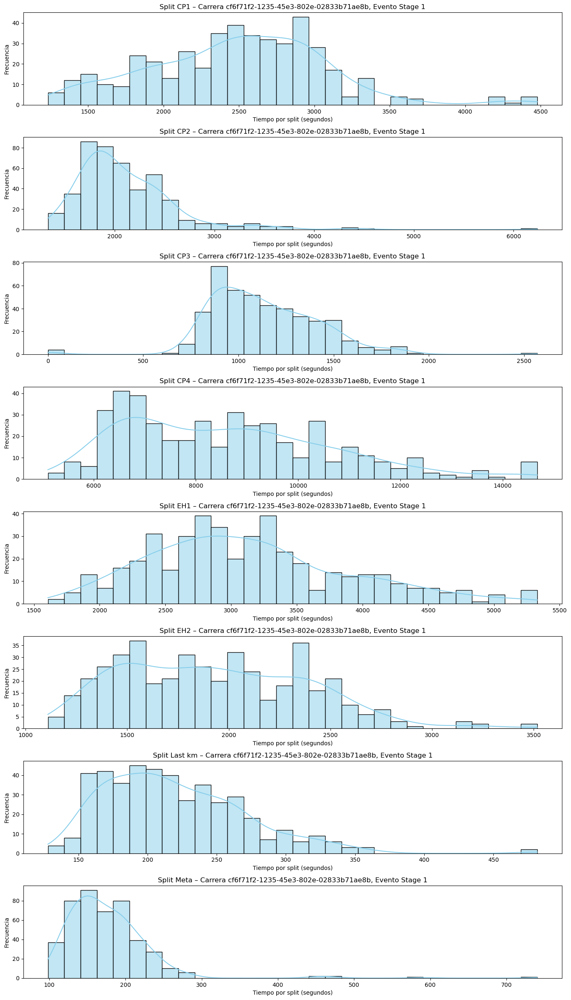


=== Outliers por split – Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b, Evento Stage 2 ===
Split EH1: 15 atletas outliers
Split EH2: 13 atletas outliers
Split Meta: 25 atletas outliers


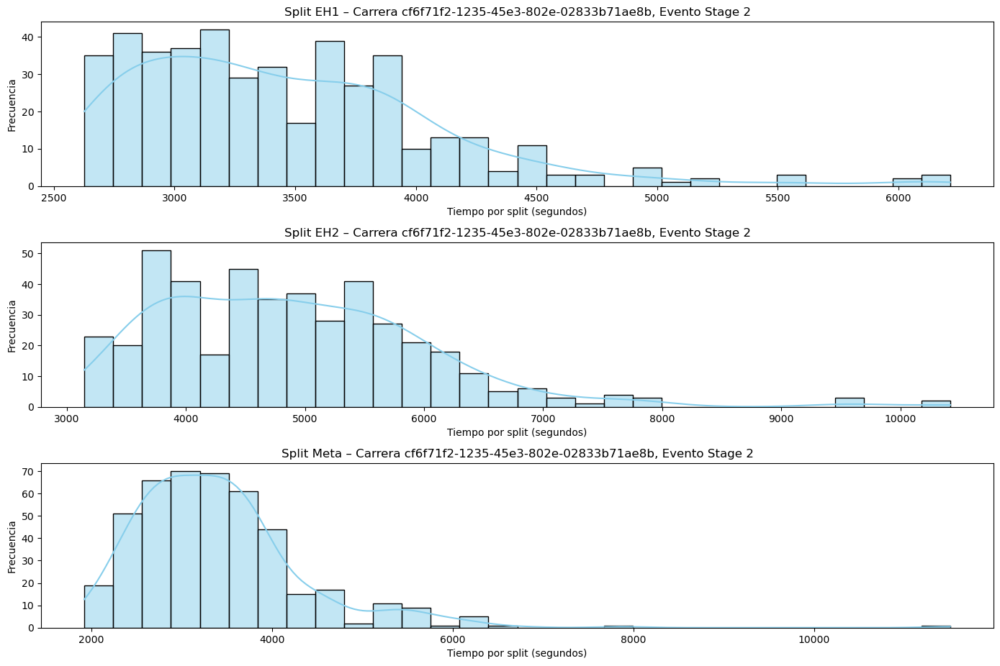


=== Outliers por split – Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b, Evento Stage 3 ===
Split CP1: 10 atletas outliers
Split CP2: 24 atletas outliers
Split CP3: 10 atletas outliers
Split CP4: 31 atletas outliers
Split EH1: 13 atletas outliers
Split EH2: 23 atletas outliers
Split EH3: 17 atletas outliers
Split Lastkm: 10 atletas outliers
Split Meta: 29 atletas outliers


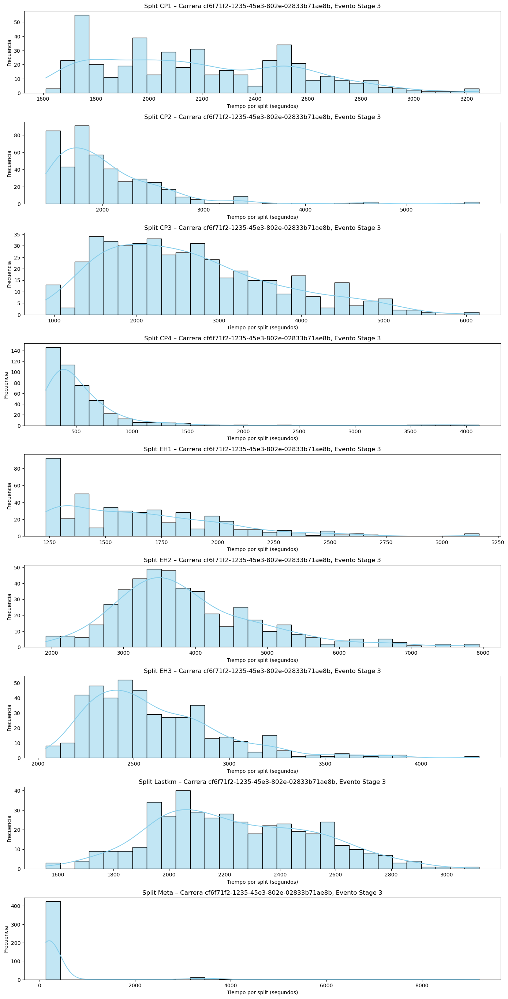


=== Outliers por split – Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b, Evento Stage 4 ===
Split CP1: 12 atletas outliers
Split CP2: 19 atletas outliers
Split CP3: 20 atletas outliers
Split CP4: 8 atletas outliers
Split EH2: 10 atletas outliers
Split EH3: 38 atletas outliers
Split Lastkm: 10 atletas outliers
Split Meta: 44 atletas outliers


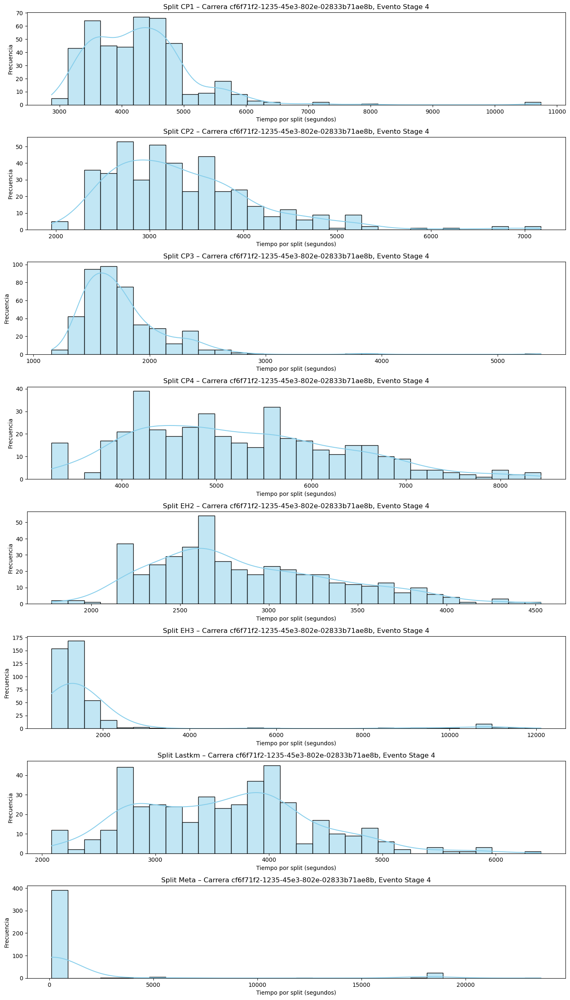


=== Outliers por split – Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b, Evento Stage 5 ===
Split CP1: 14 atletas outliers
Split CP2: 26 atletas outliers
Split CP3: 6 atletas outliers
Split CP4: 13 atletas outliers
Split EH1: 23 atletas outliers
Split EH2: 16 atletas outliers
Split EH3: 10 atletas outliers
Split Lastkm: 17 atletas outliers
Split Meta: 14 atletas outliers


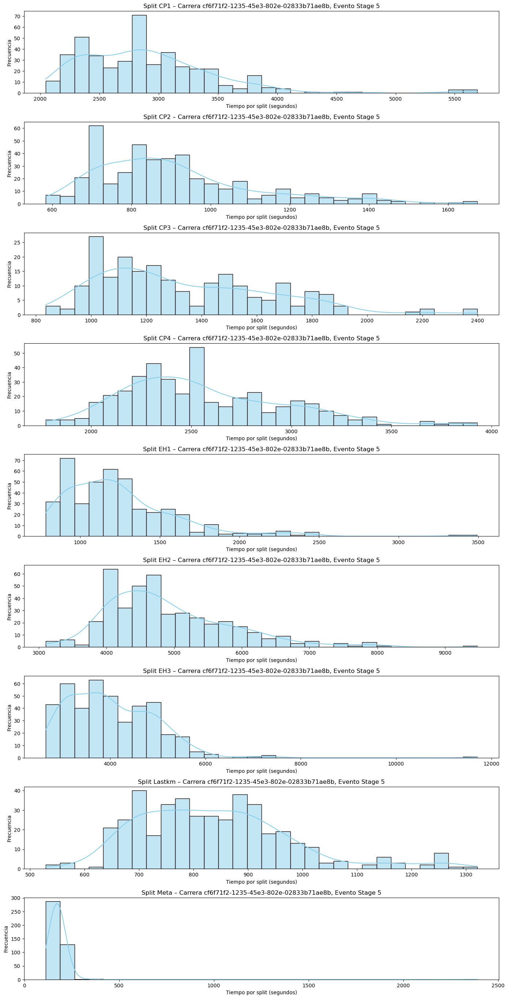


=== Outliers por split – Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b, Evento Stage 6 ===
Split CP1: 12 atletas outliers
Split CP2: 19 atletas outliers
Split CP3: 32 atletas outliers
Split CP4: 10 atletas outliers
Split EH1: 15 atletas outliers
Split EH2: 10 atletas outliers
Split Lastkm: 14 atletas outliers
Split Meta: 16 atletas outliers


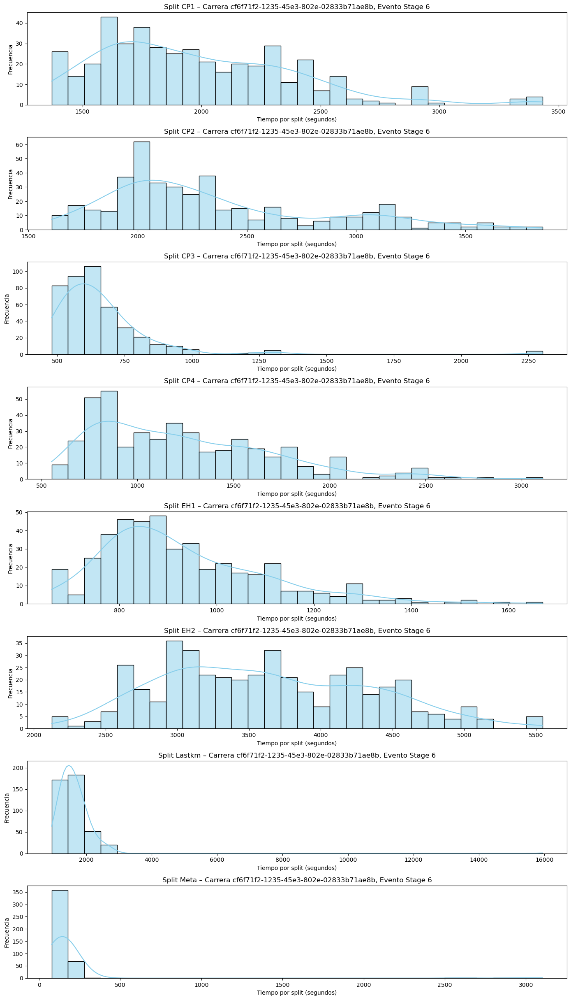


=== Outliers por split – Carrera ad64fc28-2968-4993-a182-f642c0310a93, Evento Carrera Profuturo ===
Split 2.5K: 179 atletas outliers
Split Meta: 296 atletas outliers


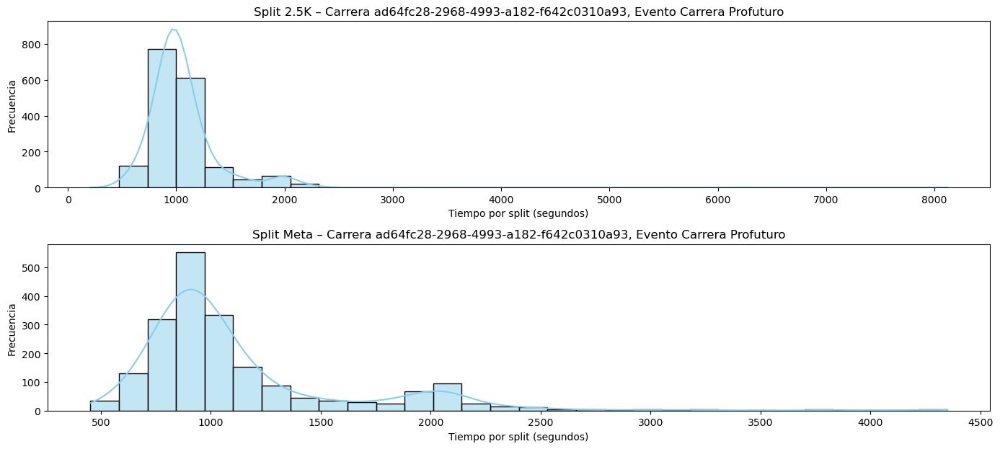


=== Outliers por split – Carrera ad64fc28-2968-4993-a182-f642c0310a93, Evento Medio Maratón ===
Split 10K: 1153 atletas outliers
Split 15K: 678 atletas outliers
Split 19K: 739 atletas outliers
Split 5K: 484 atletas outliers
Split Meta: 3002 atletas outliers


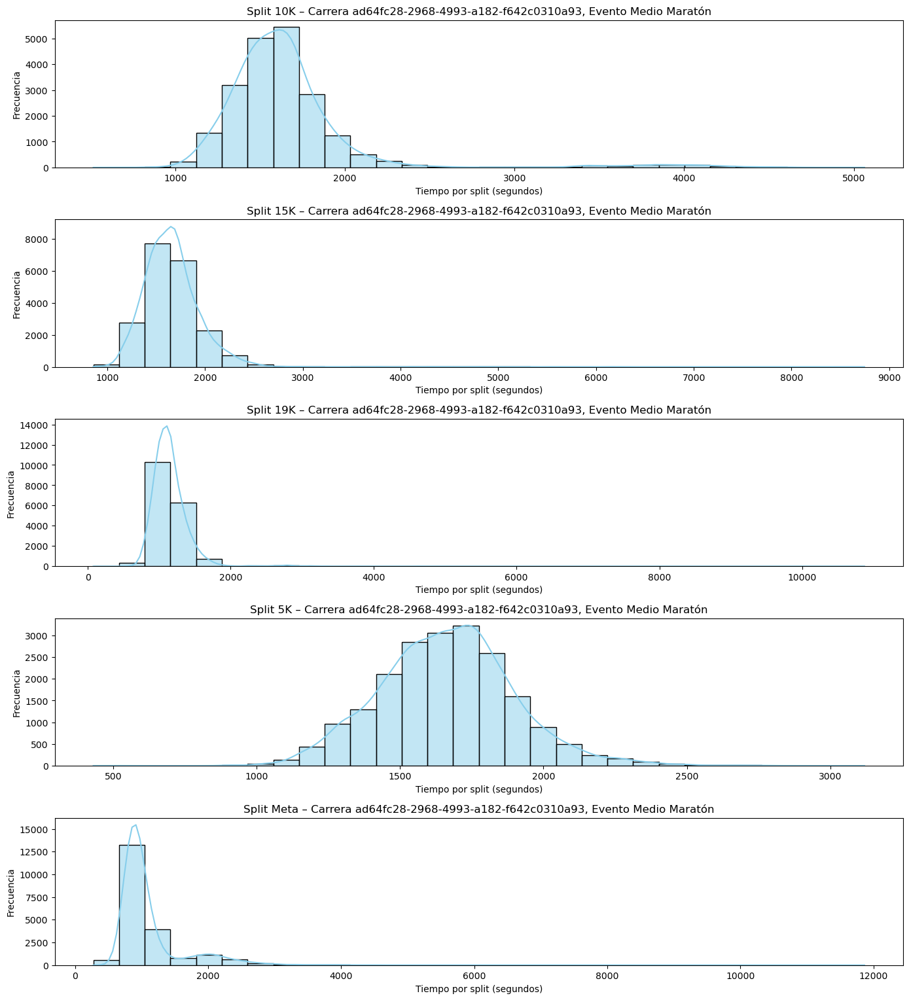


=== Outliers por split – Carrera 331e7589-6440-4968-9b44-484ba589824e, Evento Marato ===
Split 10K: 810 atletas outliers
Split 15K: 709 atletas outliers
Split 20K: 853 atletas outliers
Split 25K: 903 atletas outliers
Split 30K: 996 atletas outliers
Split 35K: 902 atletas outliers
Split 40K: 709 atletas outliers
Split 5K: 448 atletas outliers
Split Media: 1076 atletas outliers
Split Meta: 850 atletas outliers


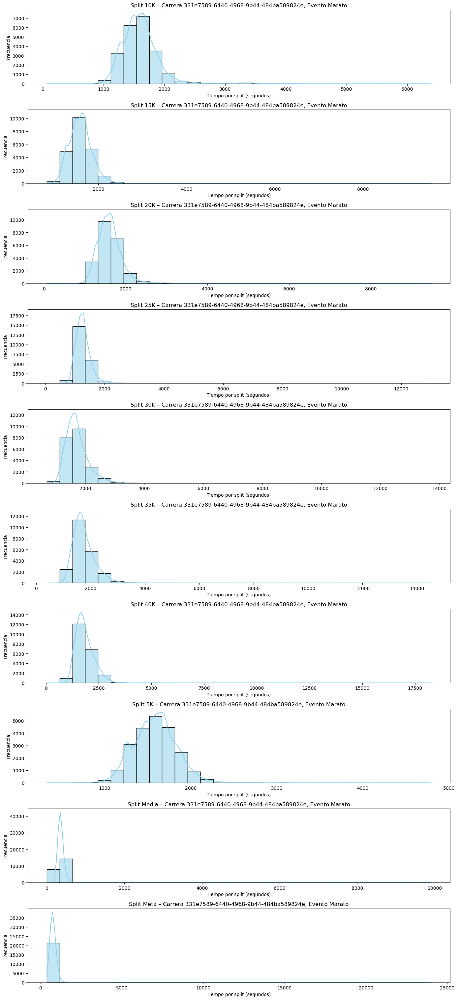


=== Outliers por split – Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f, Evento Mitja ===
Split 10K: 827 atletas outliers
Split 15K: 829 atletas outliers
Split 20K: 1122 atletas outliers
Split 5K: 546 atletas outliers
Split Meta: 1077 atletas outliers


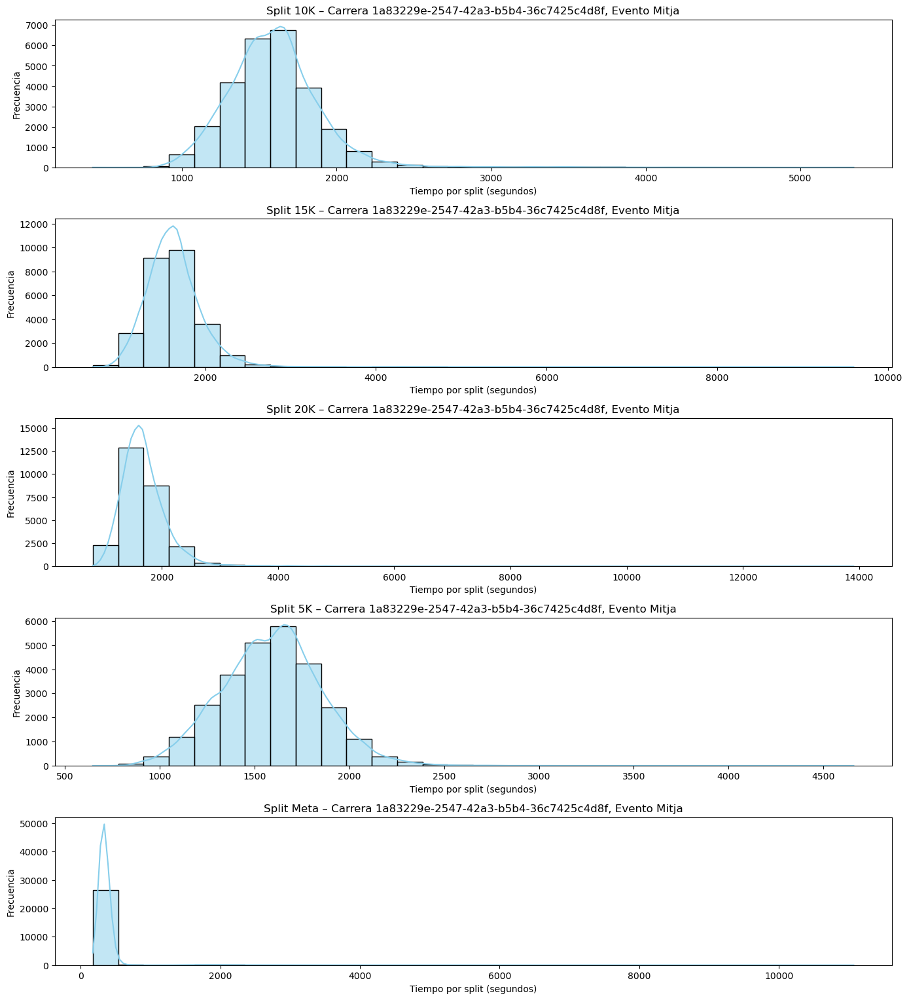

In [ ]:

df = athletes_time_df.copy()

if 'time_split_sec' not in df.columns:
    raise KeyError("No existe la columna 'time_split_sec'. Debe calcularse antes.")

df = df.merge(
    athletes_df[['athlete_id', 'birthdate', 'club']],
    on='athlete_id',
    how='left'
)

df['birthdate'] = pd.to_datetime(df['birthdate'], errors='coerce')
df['rawTime'] = pd.to_datetime(df['rawTime'], errors='coerce')
df = df.dropna(subset=['birthdate', 'rawTime'])

df = df.sort_values(['athlete_id', 'race_id', 'event_id', 'split'])

edad_bins = [10, 20, 30, 40, 50, 60, 70, 100]
edad_labels = ['10–19','20–29','30–39','40–49','50–59','60–69','70+']

for race in df['race_id'].unique():
    df_race = df[df['race_id'] == race]

    for event in df_race['event_id'].unique():
        df_event = df_race[df_race['event_id'] == event].copy()
        splits = sorted(df_event['split'].unique())
        n_splits = len(splits)

        if len(df_event) < 50:
            print(f"race_id={race}, event_id={event} tiene pocos registros. Saltando análisis.")
            continue

        print(f"\n=== Outliers por split – Carrera {race}, Evento {event} ===")

        fecha_evento = pd.to_datetime(df_event['rawTime'].min(), errors='coerce')
        if pd.isna(fecha_evento):
            fecha_evento = pd.Timestamp.now()

        df_event['edad'] = (fecha_evento - df_event['birthdate']).dt.days / 365.25
        df_event['edad'] = df_event['edad'].where(df_event['edad'].between(10, 100)).round(0)
        df_event['rango_edad'] = pd.cut(df_event['edad'], bins=edad_bins, labels=edad_labels)
        df_event = df_event.dropna(subset=['rango_edad', 'time_split_sec', 'club'])

        plt.figure(figsize=(14, 3 * n_splits))
        for i, sp in enumerate(splits):
            if sp == 'Salida':
                continue

            split_data = df_event[df_event['split'] == sp]['time_split_sec'].dropna()
            if len(split_data) == 0:
                continue

            q1, q3 = np.percentile(split_data, [25, 75])
            iqr = q3 - q1
            lower_bound = max(q1 - 1.5 * iqr, np.percentile(split_data, 1))
            upper_bound = min(q3 + 1.5 * iqr, np.percentile(split_data, 99))
            n_outliers = ((split_data < lower_bound) | (split_data > upper_bound)).sum()
            print(f"Split {sp}: {n_outliers} atletas outliers")

            plt.subplot(n_splits, 1, i + 1)
            sns.histplot(split_data, bins=30, kde=True, color='skyblue')
            plt.title(f'Split {sp} – Carrera {race}, Evento {event}')
            plt.xlabel('Tiempo por split (segundos)')
            plt.ylabel('Frecuencia')
        plt.tight_layout()
        plt.show()

Podemos ver que las variables no tienen una forma normal muy determinada. De hecho, es normal porque no habíamos determinado una forma normal con los test. También podemos ver que en muchos split hay una cantidad bastante grande de outliers, por lo cual lo tendremos en cuenta para ver otros cálculos como el detector de anomalías más adelante.

Ahora pasamos a calcular un JoinPlot para poder ver conjuntamente la distancia a la que se ha producido un evento y los tiempos de cada split.

A su vez vamos a visualizar Boxplot en cada uno de los split para poder ver de forma concisa cómo se distribuyen los outliers.


=== Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f ===


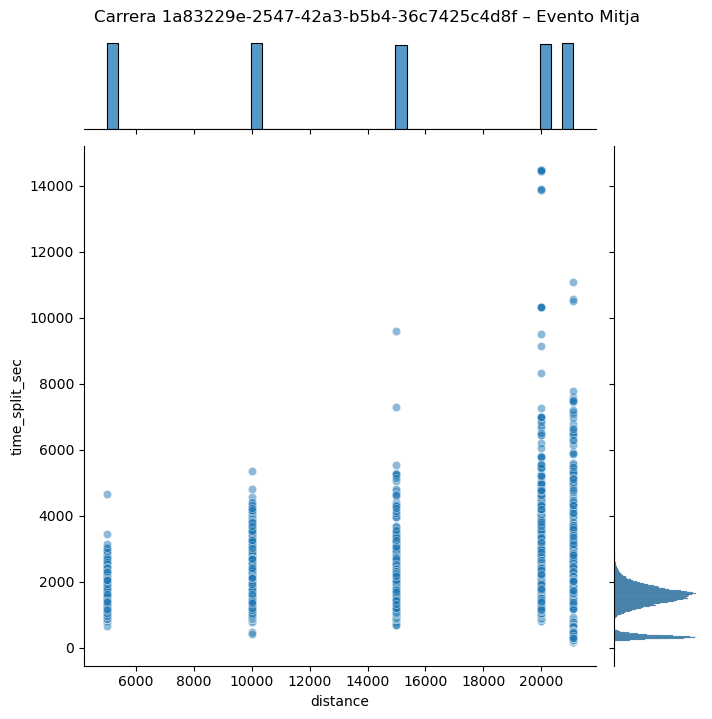

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\473977992.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


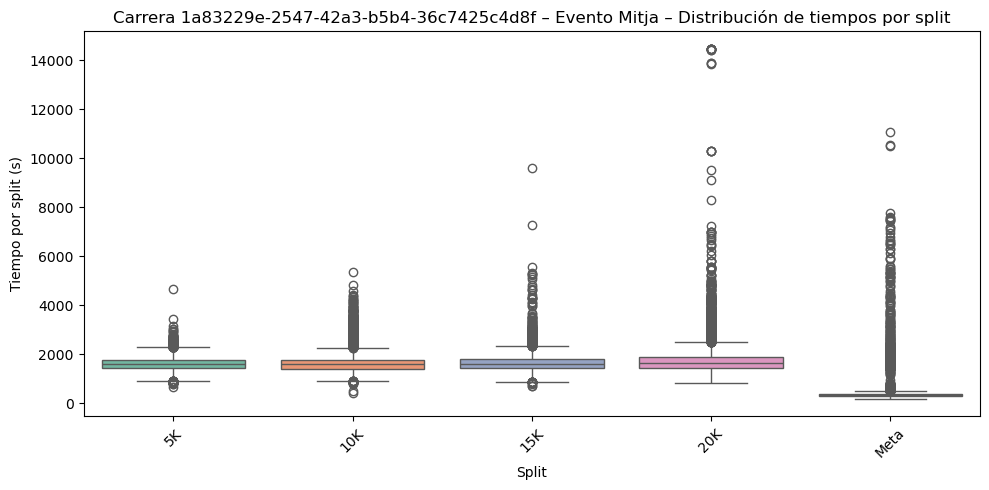


=== Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b ===


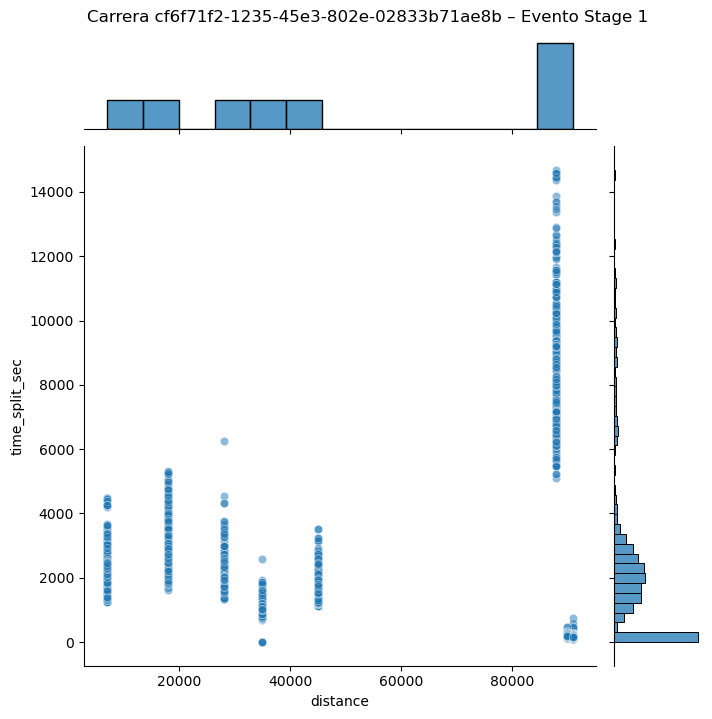

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\473977992.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


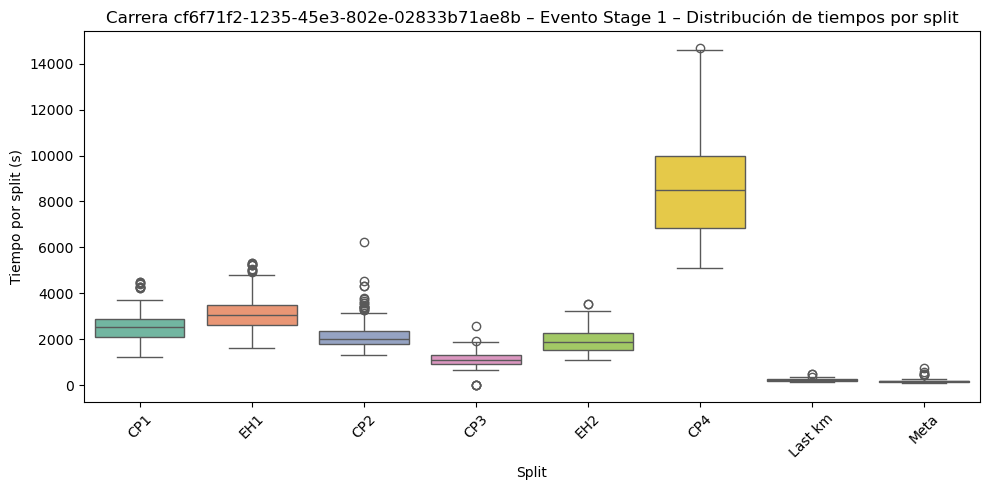

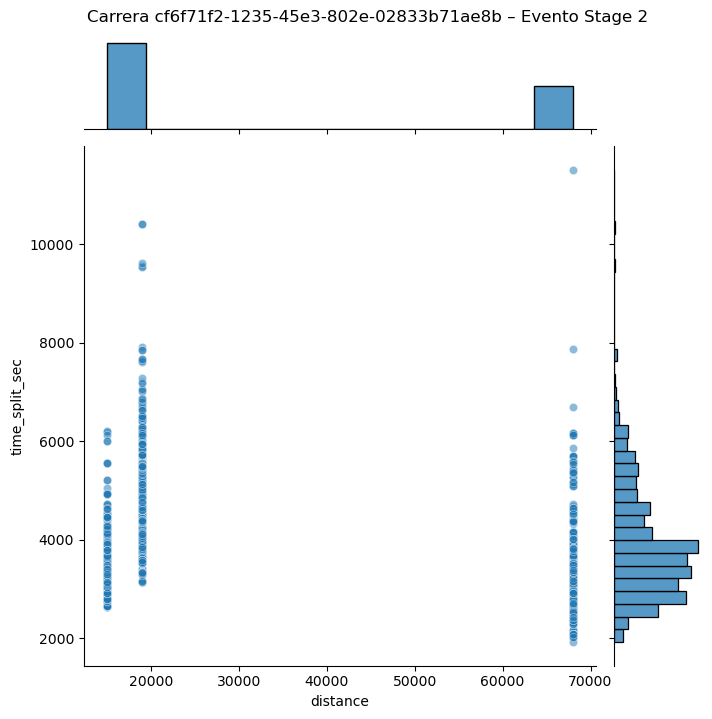

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\473977992.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


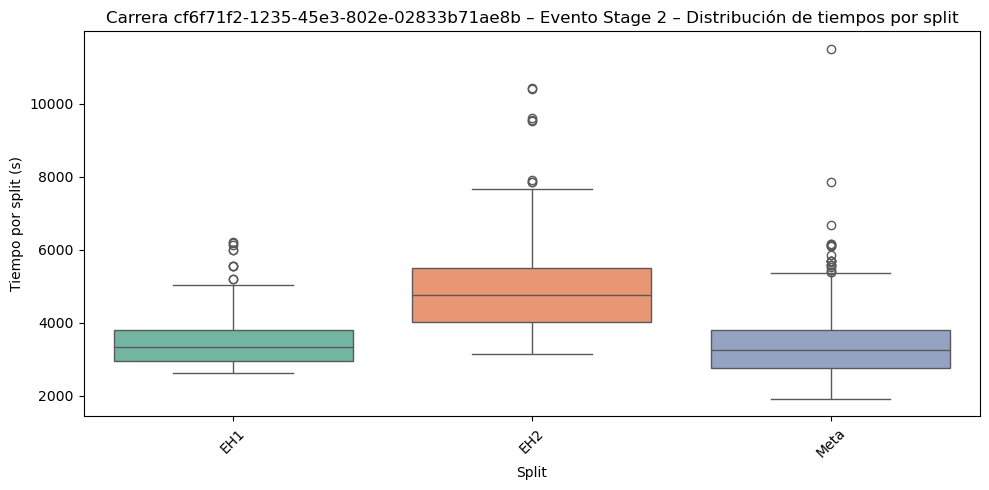

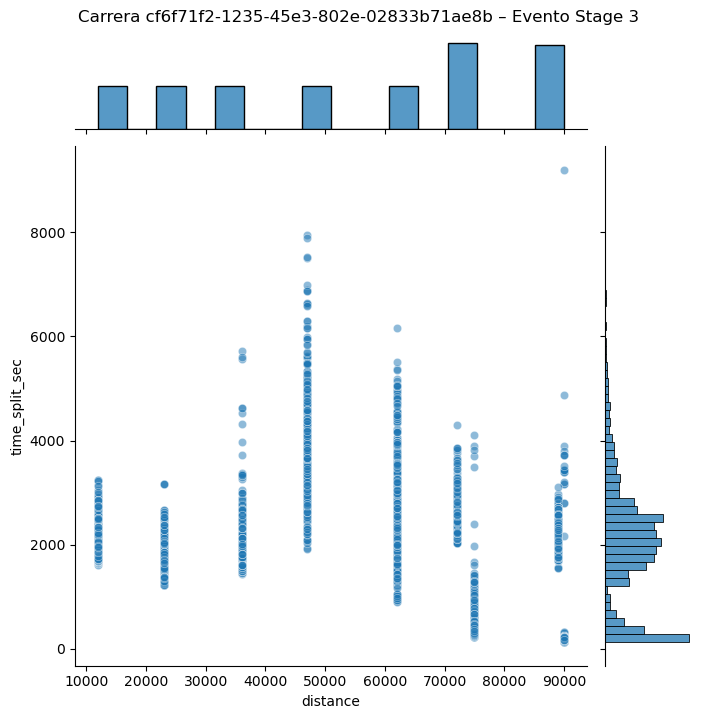

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\473977992.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


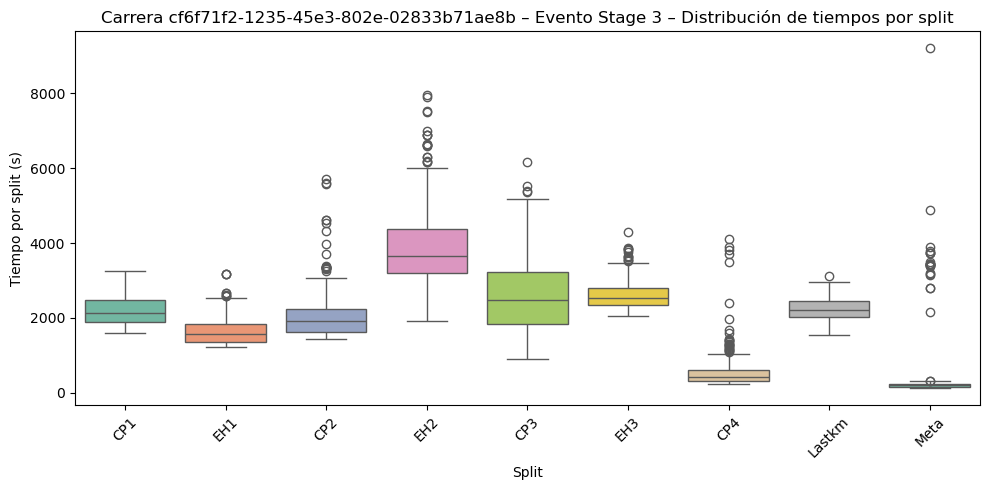

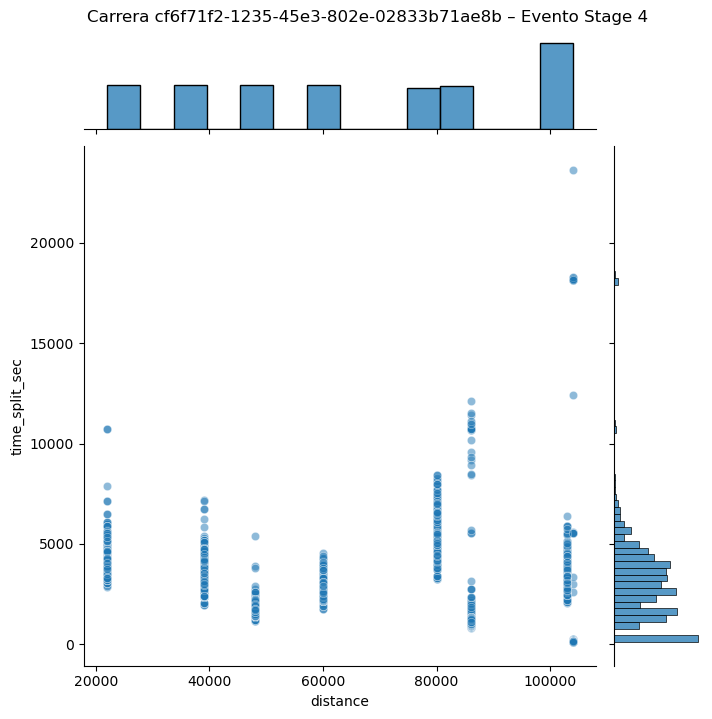

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\473977992.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


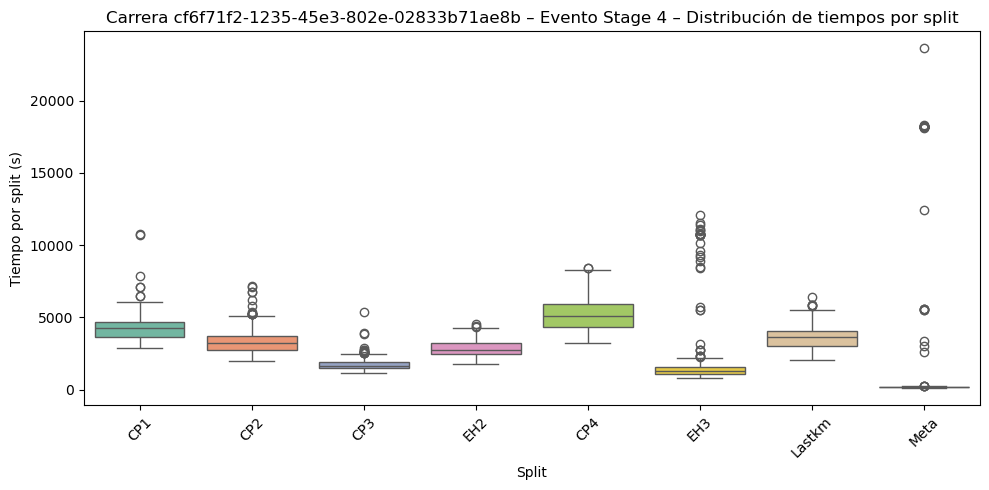

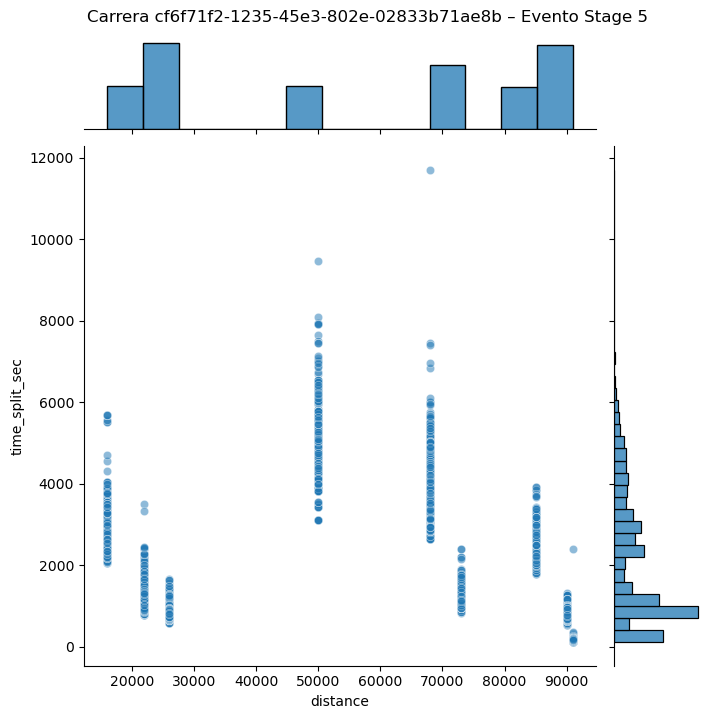

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\473977992.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


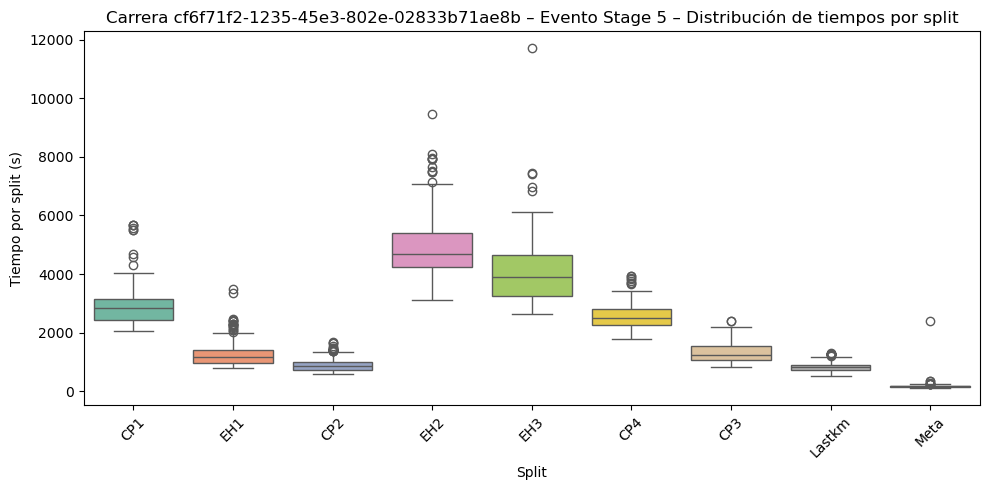

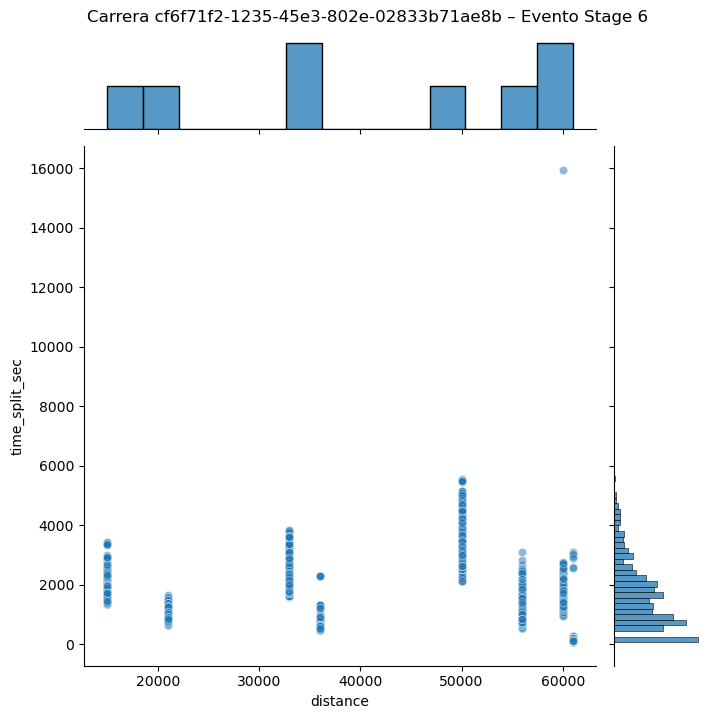

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\473977992.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


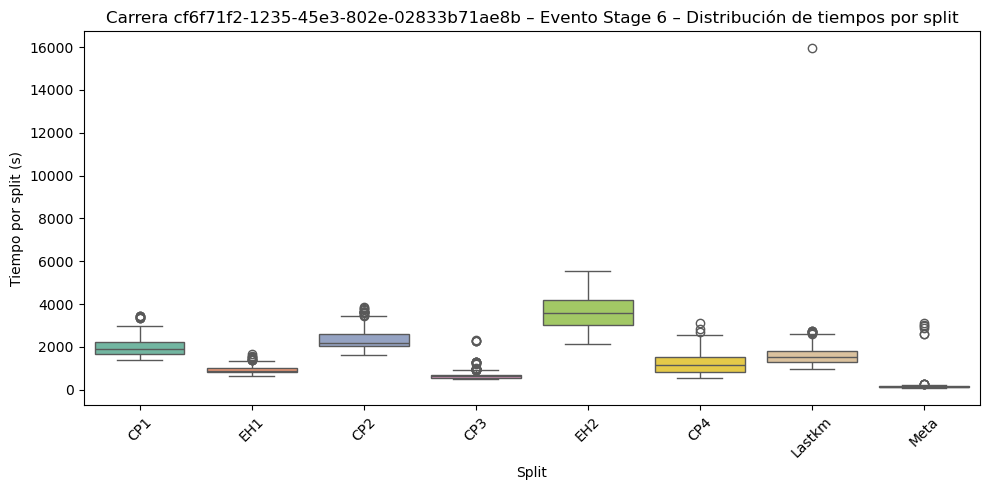


=== Carrera ad64fc28-2968-4993-a182-f642c0310a93 ===


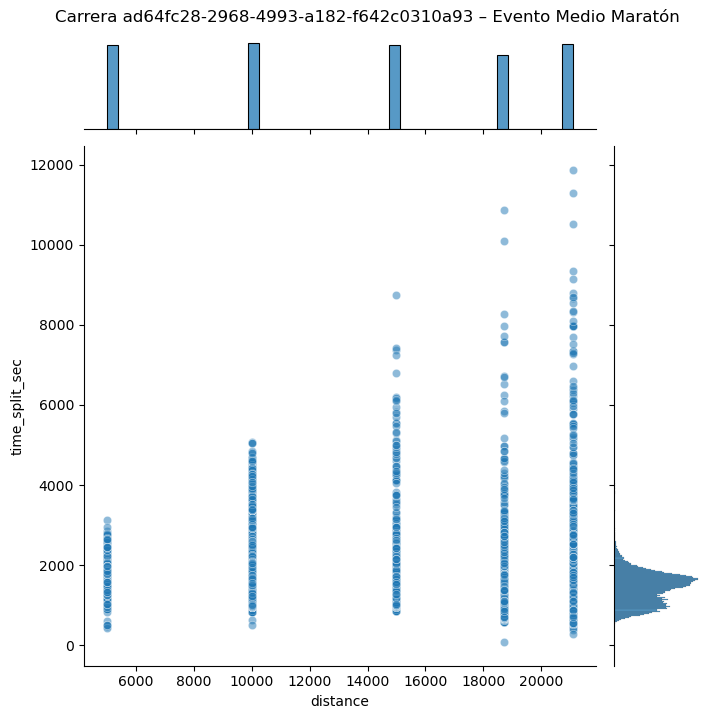

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\473977992.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


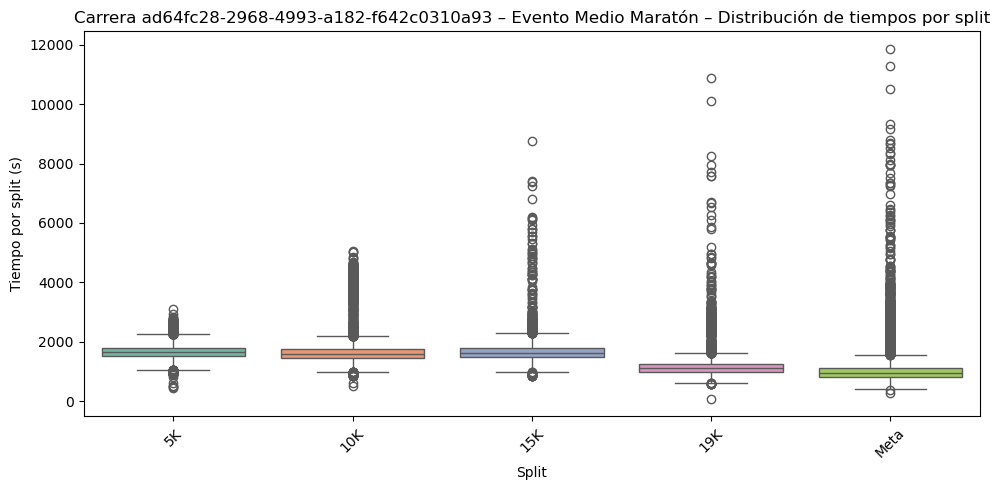

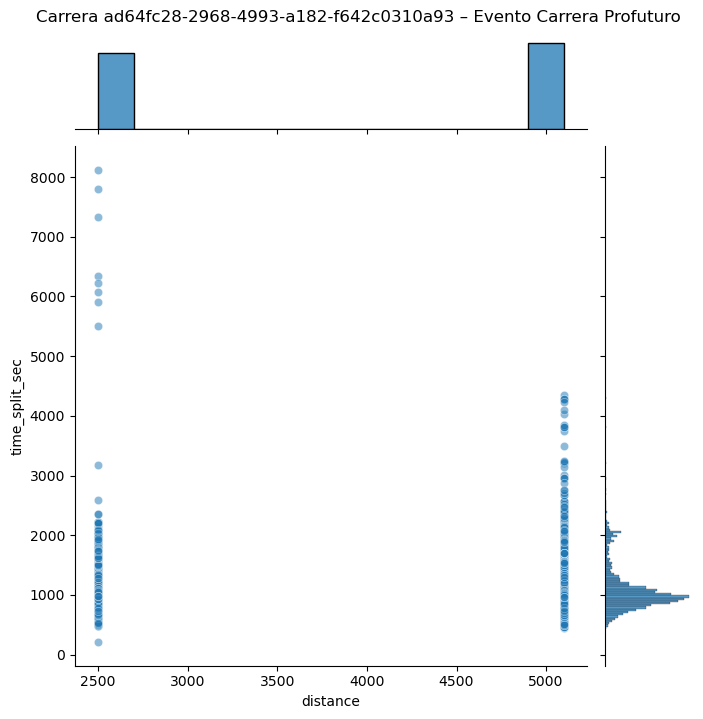

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\473977992.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


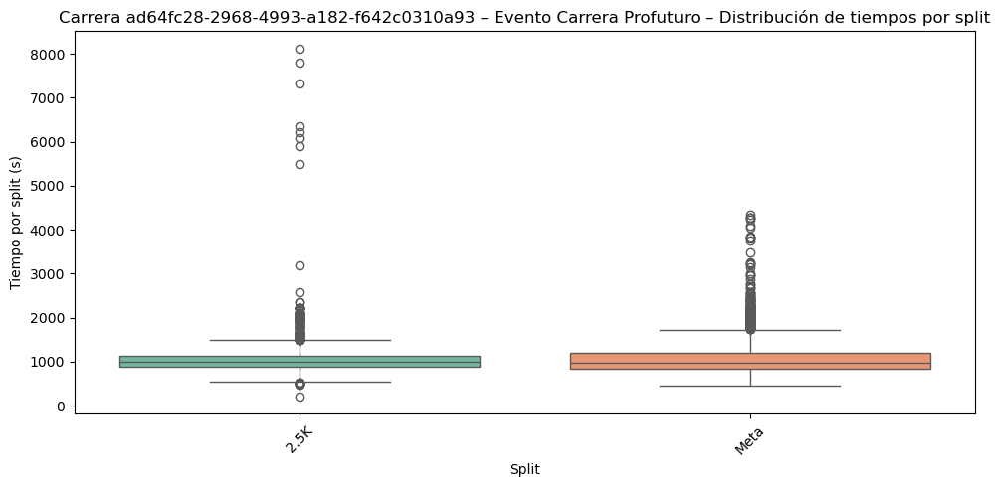


=== Carrera 331e7589-6440-4968-9b44-484ba589824e ===


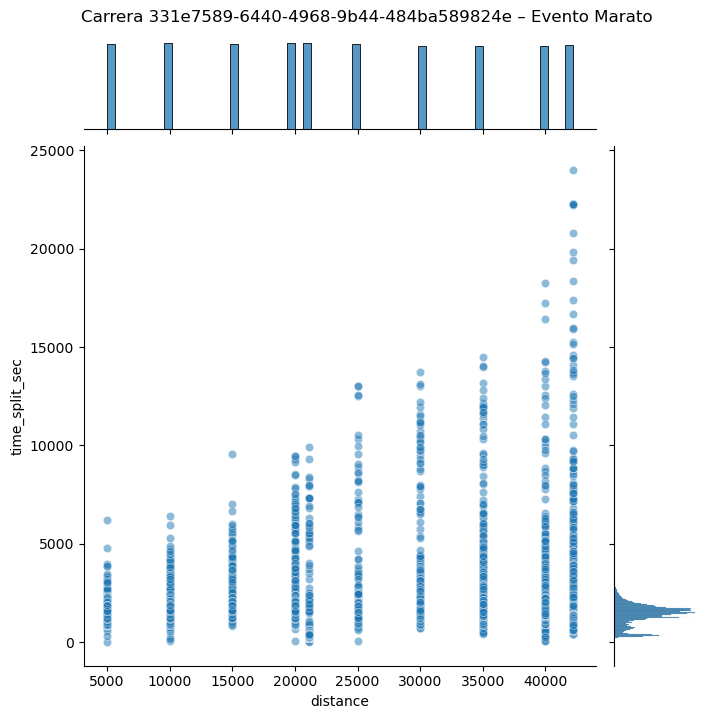

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\473977992.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


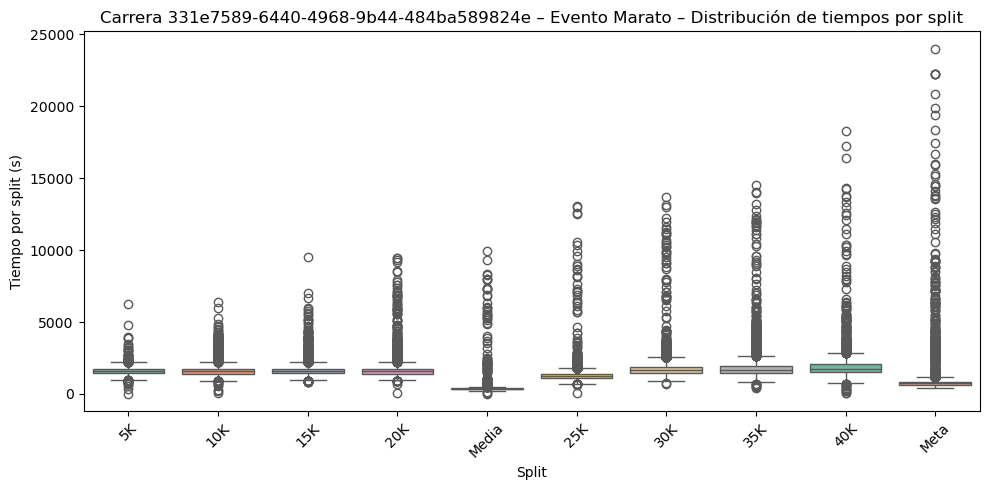

In [ ]:
df = athletes_time_df.copy()
if 'time_split_sec' not in df.columns:
    raise KeyError("No existe la columna 'time_split_sec'. Debe calcularse antes.")

for race in df['race_id'].unique():
    df_race = df[df['race_id'] == race]
    print(f"\n=== Carrera {race} ===")

    for event in df_race['event_id'].unique():
        if "General" in event:
            continue  

        df_event = df_race[df_race['event_id'] == event]

        sns.jointplot(
            data=df_event[df_event['split'] != 'Salida'],  
            x='distance', 
            y='time_split_sec', 
            kind='scatter', 
            alpha=0.5,
            height=7
        )
        plt.suptitle(f'Carrera {race} – Evento {event}', y=1.02)
        plt.show()

        split_order = (
            df_event[df_event['split'] != 'Salida']
            .groupby('split')['netTime']
            .mean()
            .sort_values()
            .index
        )

        plt.figure(figsize=(10,5))
        sns.boxplot(
            data=df_event[df_event['split'] != 'Salida'],
            x='split',
            y='time_split_sec',
            palette='Set2',
            order=split_order  
        )
        plt.title(f'Carrera {race} – Evento {event} – Distribución de tiempos por split')
        plt.xlabel('Split')
        plt.ylabel('Tiempo por split (s)')
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()


En los tiempos por split si que es más común encontrarnos con valores bastante outliers, lo que puede ser un indiativo clave para poder tener hacer un detector de anomalías de atletas con tiempos extraños. 

También el valor de algunos eventos de las bicicletas parece un poco raro con respecto a los otros eventos. El problema también que tienen las bicicletas es que hay subidas y bajadas y hay mucha variación en el tramo donde corren, por lo cual tampoco podemos estar seguros de si un split tiene tiempo raro o no, sin haber conocido la carrera.

#### Velocidad: Mismo análisis

En la velocidad se han calculado los mismos boxplot que para la sección anteriores. También se ha comparado con una velocidad creada por mí mismo para comprobar que esté bien, porque no estaba seguro de que la variable average pudiera dar la velocidad de forma concisa (queria comprobarlo antes de ponerme a hacer calculos con ella)

- Calcular velocidad basada en average.

- Detectar valores anómalos de velocidad usando IQR + percentiles.

- Ejemplos de anomalías.

- Comparar la velocidad original con la derivada.

- Visualizar distribuciones por split.

- Calcular correlación entre ambos métodos de velocidad.

- Dibujar scatterplot para ver si todo coincide o si hay inconsistencias.


--- Detección de anomalías en 1/average (m/s) por carrera y evento ---

=== Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f ===

--- Evento Mitja ---
Total filas en evento: 162743
Filas anómalas: 5091
Ejemplos de anomalías (primeras 10 filas):


,athlete_id,split,speed_from_average
1,31,5K,5.594093
3,159,5K,4.594955
4,159,10K,4.622567
5,159,15K,4.631345
6,159,20K,4.622354
7,159,Meta,4.635854
9,160,5K,4.860976
10,160,10K,4.883766
11,160,15K,4.868312
12,160,20K,4.823229



Resumen de anomalías por split (porcentaje y número):
        pct_outlier  num_outlier
split                           
10K        3.941230         1073
15K        3.851316         1033
20K        3.586592          963
5K         3.930356         1070
Meta       3.505155          952
Salida     0.000000            0


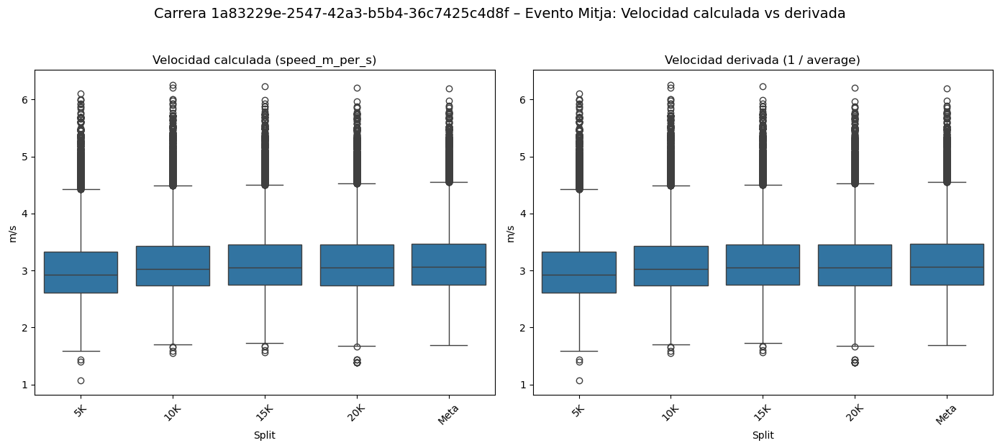

Correlación entre speed_m_per_s y 1/average: 1.000000
Diferencia media absoluta: 0.000000 m/s


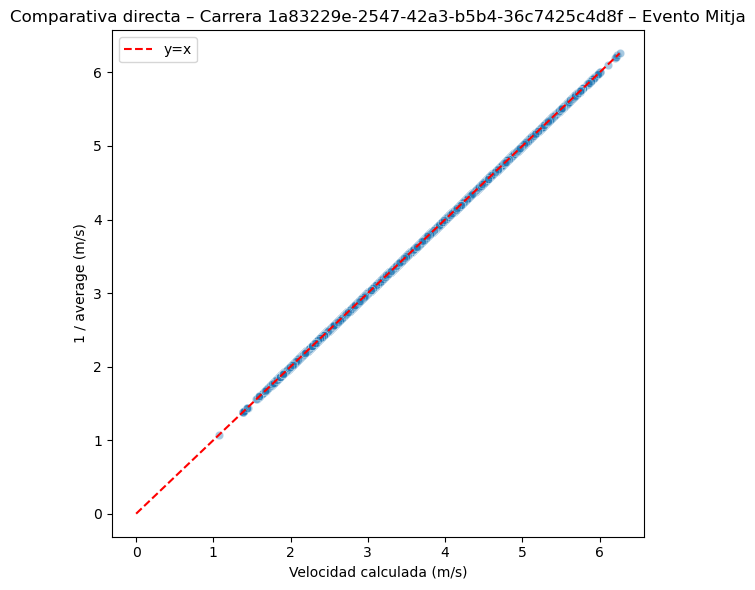


=== Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b ===

--- Evento Stage 1 ---
Total filas en evento: 4000
Filas anómalas: 109
Ejemplos de anomalías (primeras 10 filas):


,athlete_id,split,speed_from_average
162894,4d325944-3693-5adf-a199-43b47210f9db,EH1,5.660271
162895,4d325944-3693-5adf-a199-43b47210f9db,CP2,6.125950
162896,4d325944-3693-5adf-a199-43b47210f9db,CP3,6.667111
162897,4d325944-3693-5adf-a199-43b47210f9db,EH2,7.076139
162898,4d325944-3693-5adf-a199-43b47210f9db,CP4,7.674597
162899,4d325944-3693-5adf-a199-43b47210f9db,Last km,7.762167
162900,4d325944-3693-5adf-a199-43b47210f9db,Meta,7.782707
162993,c0150cab-39fc-575b-8006-e0594ad1d493,CP1,5.007511
163446,669a5031-96a3-59c2-be22-615414e928bd,CP1,4.663527
163751,26d88625-694b-5087-8cda-7a0645b3be29,CP3,2.599631



Resumen de anomalías por split (porcentaje y número):
         pct_outlier  num_outlier
split                            
CP1         6.966292           31
CP2         3.146067           14
CP3         2.262443           10
CP4         1.797753            8
EH1         4.279279           19
EH2         2.247191           10
Last km     2.036199            9
Meta        1.797753            8
Salida      0.000000            0


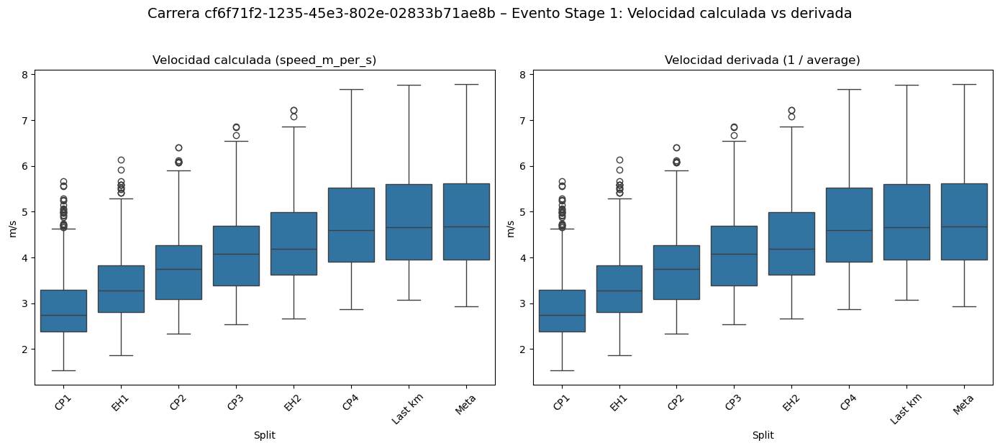

Correlación entre speed_m_per_s y 1/average: 1.000000
Diferencia media absoluta: 0.000000 m/s


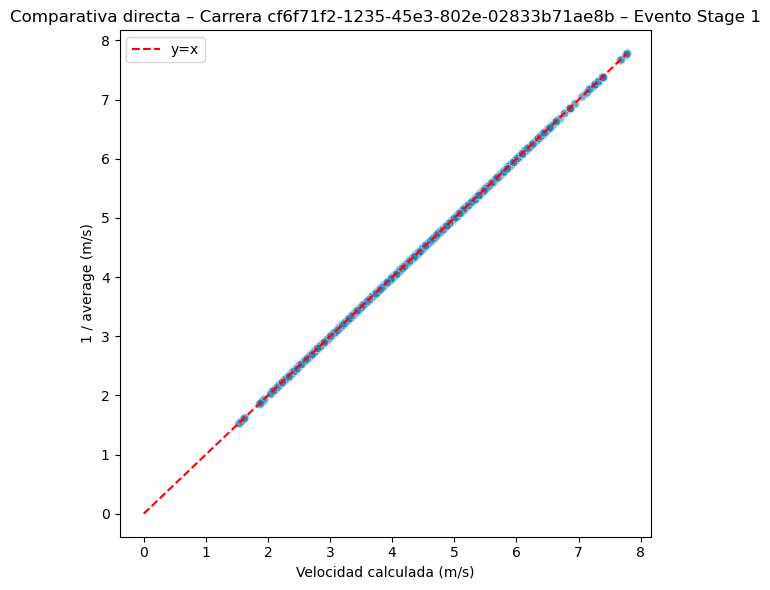


--- Evento Stage 2 ---
Total filas en evento: 1772
Filas anómalas: 28
Ejemplos de anomalías (primeras 10 filas):


,athlete_id,split,speed_from_average
162903,4d325944-3693-5adf-a199-43b47210f9db,EH2,3.270860
162904,4d325944-3693-5adf-a199-43b47210f9db,Meta,8.562377
163849,496b08ff-62c0-5a60-849f-1a99bcfe0f9e,EH1,5.642704
164152,4223896e-afbc-5a37-8ae5-624bdd24d9ed,EH1,2.402402
164153,4223896e-afbc-5a37-8ae5-624bdd24d9ed,EH2,1.201822
164782,74439deb-77eb-5293-9686-ada7b9b0457e,EH1,5.676980
166054,15dde7fc-54de-5aa0-8a4e-464aea30342d,EH1,2.473166
166055,15dde7fc-54de-5aa0-8a4e-464aea30342d,EH2,1.152605
166056,15dde7fc-54de-5aa0-8a4e-464aea30342d,Meta,3.008876
167710,35b3cb57-c982-559f-9b1b-4411975ea175,EH2,3.271288



Resumen de anomalías por split (porcentaje y número):
        pct_outlier  num_outlier
split                           
EH1        2.257336           10
EH2        2.262443           10
Meta       1.805869            8
Salida     0.000000            0


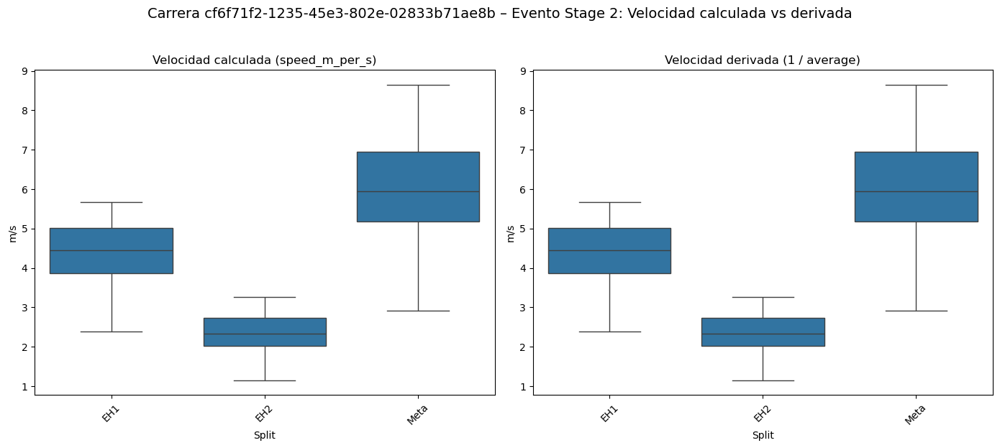

Correlación entre speed_m_per_s y 1/average: 1.000000
Diferencia media absoluta: 0.000000 m/s


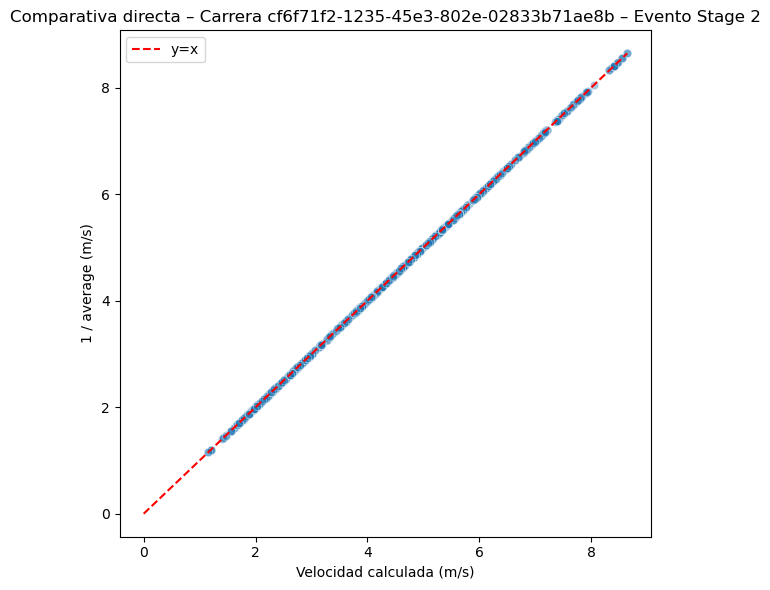


--- Evento Stage 3 ---
Total filas en evento: 4430
Filas anómalas: 89
Ejemplos de anomalías (primeras 10 filas):


,athlete_id,split,speed_from_average
162909,4d325944-3693-5adf-a199-43b47210f9db,EH2,7.359976
162910,4d325944-3693-5adf-a199-43b47210f9db,CP3,8.478169
162911,4d325944-3693-5adf-a199-43b47210f9db,EH3,7.692899
164788,74439deb-77eb-5293-9686-ada7b9b0457e,CP2,8.217602
166060,15dde7fc-54de-5aa0-8a4e-464aea30342d,CP2,3.664480
166061,15dde7fc-54de-5aa0-8a4e-464aea30342d,EH2,2.812940
166128,ca6a55fd-85ec-5ffd-ad6c-35253d539e84,CP1,3.642722
167129,ed3c0f57-5bc7-5670-8de2-a5a9456c534a,CP1,3.713607
167130,ed3c0f57-5bc7-5670-8de2-a5a9456c534a,CP2,4.090649
167132,ed3c0f57-5bc7-5670-8de2-a5a9456c534a,CP3,2.973978



Resumen de anomalías por split (porcentaje y número):
        pct_outlier  num_outlier
split                           
CP1        2.237136           10
CP2        2.237136           10
CP3        2.242152           10
CP4        2.242152           10
EH1        2.272727           10
EH2        2.237136           10
EH3        2.272727           10
Lastkm     2.358491           10
Meta       2.017937            9
Salida     0.000000            0


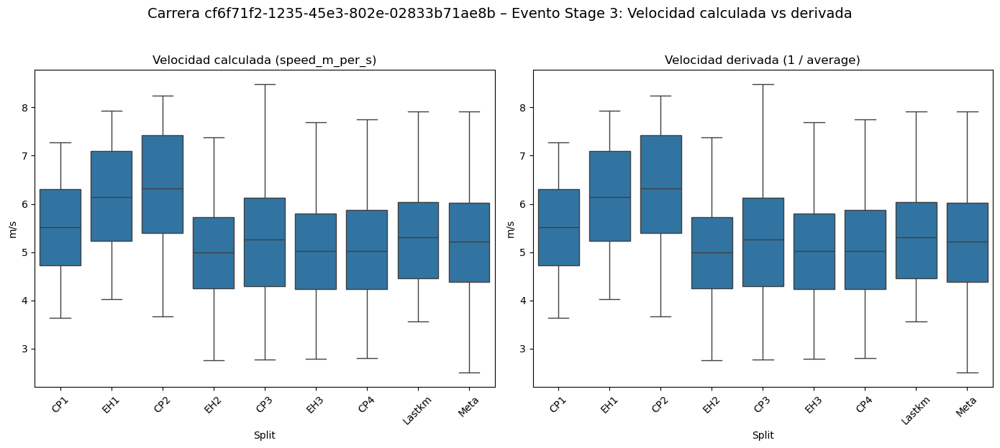

Correlación entre speed_m_per_s y 1/average: 1.000000
Diferencia media absoluta: 0.000000 m/s


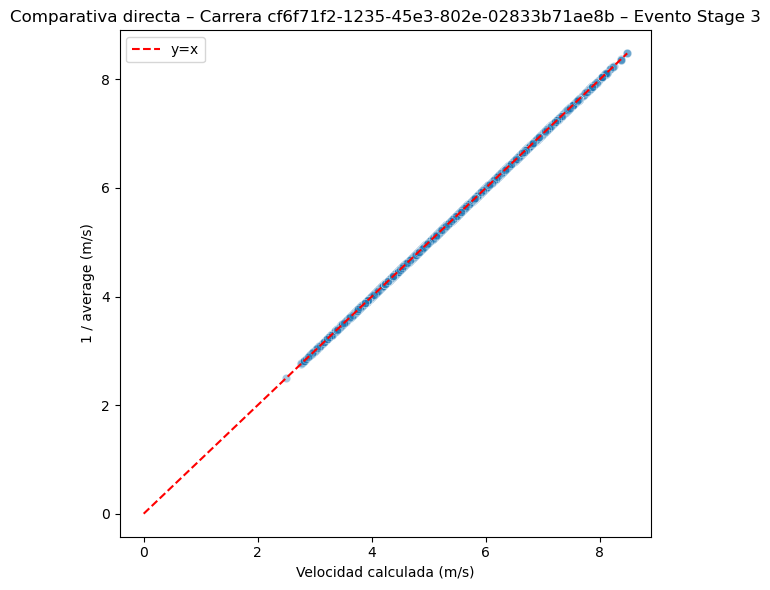


--- Evento Stage 4 ---
Total filas en evento: 3839
Filas anómalas: 73
Ejemplos de anomalías (primeras 10 filas):


,athlete_id,split,speed_from_average
162771,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,Lastkm,3.165058
162772,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,EH3,3.106844
162916,4d325944-3693-5adf-a199-43b47210f9db,CP1,7.544323
162917,4d325944-3693-5adf-a199-43b47210f9db,CP2,8.008970
162918,4d325944-3693-5adf-a199-43b47210f9db,CP3,7.966223
162919,4d325944-3693-5adf-a199-43b47210f9db,EH2,7.689350
162920,4d325944-3693-5adf-a199-43b47210f9db,CP4,7.231181
162921,4d325944-3693-5adf-a199-43b47210f9db,EH3,7.241654
162922,4d325944-3693-5adf-a199-43b47210f9db,Lastkm,7.378440
162923,4d325944-3693-5adf-a199-43b47210f9db,Meta,7.390983



Resumen de anomalías por split (porcentaje y número):
        pct_outlier  num_outlier
split                           
CP1        2.304147           10
CP2        2.325581           10
CP3        2.320186           10
CP4        1.995012            8
EH2        2.331002           10
EH3        2.122642            9
Lastkm     1.658768            7
Meta       2.112676            9
Salida     0.000000            0


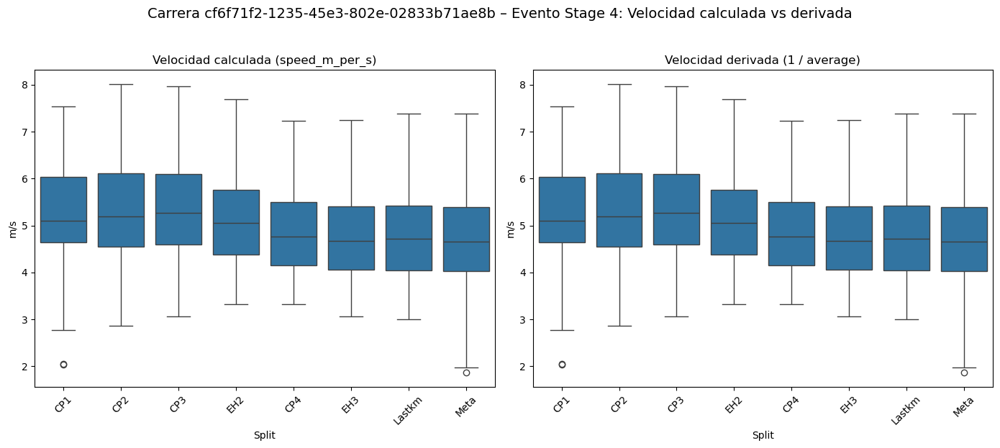

Correlación entre speed_m_per_s y 1/average: 1.000000
Diferencia media absoluta: 0.000000 m/s


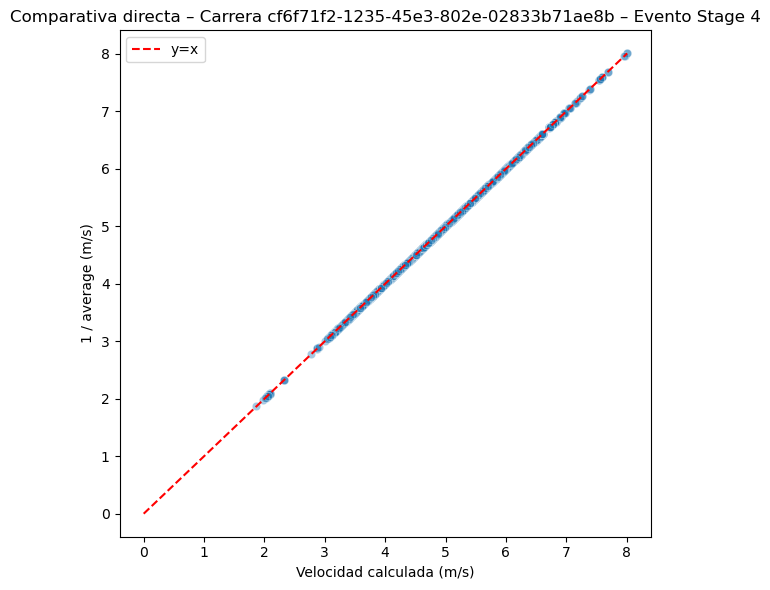


--- Evento Stage 5 ---
Total filas en evento: 4030
Filas anómalas: 85
Ejemplos de anomalías (primeras 10 filas):


,athlete_id,split,speed_from_average
162925,4d325944-3693-5adf-a199-43b47210f9db,CP1,7.723200
162926,4d325944-3693-5adf-a199-43b47210f9db,EH1,7.666948
162928,4d325944-3693-5adf-a199-43b47210f9db,EH2,7.544892
162929,4d325944-3693-5adf-a199-43b47210f9db,EH3,7.273256
162930,4d325944-3693-5adf-a199-43b47210f9db,CP4,7.641755
162931,4d325944-3693-5adf-a199-43b47210f9db,Lastkm,7.724394
162932,4d325944-3693-5adf-a199-43b47210f9db,Meta,7.733952
164479,aface548-6a92-5197-a8ea-7cd002d50382,CP1,2.857469
164480,aface548-6a92-5197-a8ea-7cd002d50382,EH1,2.979649
164481,aface548-6a92-5197-a8ea-7cd002d50382,CP2,3.146039



Resumen de anomalías por split (porcentaje y número):
        pct_outlier  num_outlier
split                           
CP1        2.325581           10
CP2        2.352941           10
CP3        2.816901            6
CP4        2.380952           10
EH1        2.336449           10
EH2        2.375297           10
EH3        2.137767            9
Lastkm     2.386635           10
Meta       2.380952           10
Salida     0.000000            0


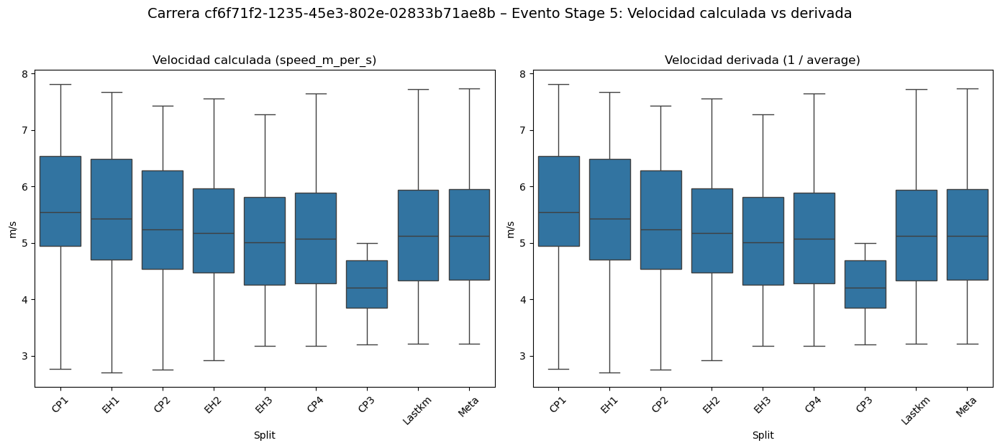

Correlación entre speed_m_per_s y 1/average: 1.000000
Diferencia media absoluta: 0.000000 m/s


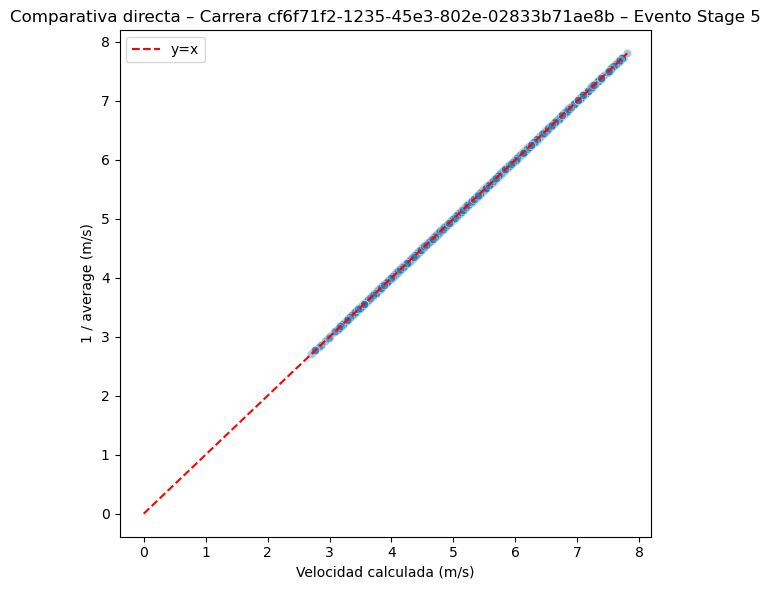


--- Evento Stage 6 ---
Total filas en evento: 3887
Filas anómalas: 79
Ejemplos de anomalías (primeras 10 filas):


,athlete_id,split,speed_from_average
162784,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,CP1,4.387889
162785,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,EH1,4.256587
162786,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,CP2,3.853119
162787,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,CP3,3.784725
162788,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,EH2,3.419271
162789,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,CP4,3.282886
162790,7b167227-8f2b-5f8c-8d1b-6202a946d7bf,Meta,3.044325
162938,4d325944-3693-5adf-a199-43b47210f9db,EH2,7.934619
162939,4d325944-3693-5adf-a199-43b47210f9db,CP4,8.165265
162940,4d325944-3693-5adf-a199-43b47210f9db,Lastkm,7.638836



Resumen de anomalías por split (porcentaje y número):
        pct_outlier  num_outlier
split                           
CP1        2.309469           10
CP2        2.331002           10
CP3        2.309469           10
CP4        2.309469           10
EH1        2.078522            9
EH2        2.314815           10
Lastkm     2.336449           10
Meta       2.309469           10
Salida     0.000000            0


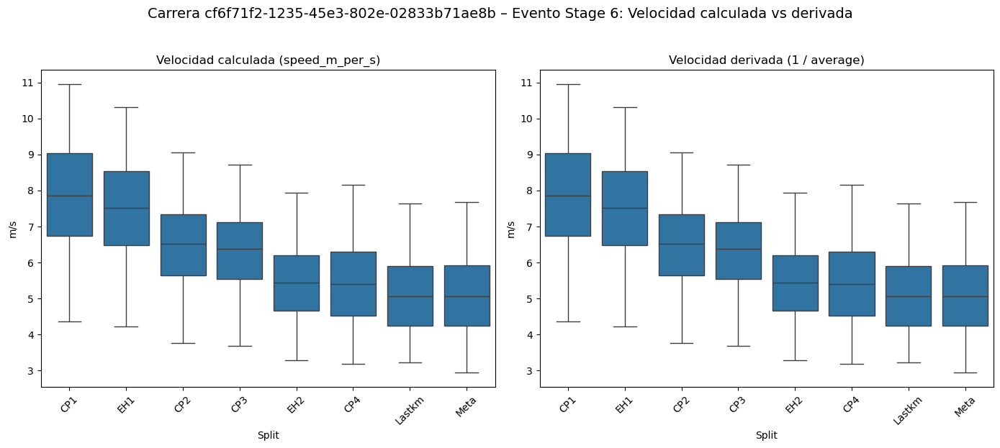

Correlación entre speed_m_per_s y 1/average: 1.000000
Diferencia media absoluta: 0.000000 m/s


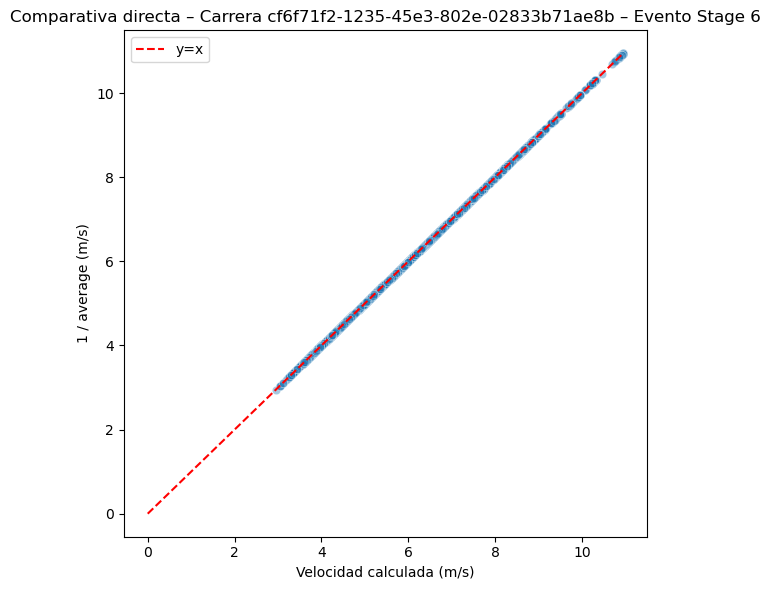


=== Carrera ad64fc28-2968-4993-a182-f642c0310a93 ===

--- Evento Medio Maratón ---
Total filas en evento: 121253
Filas anómalas: 2011
Ejemplos de anomalías (primeras 10 filas):


,athlete_id,split,speed_from_average
184702,1,5K,5.273983
184703,1,10K,5.403945
184704,1,15K,5.457026
184705,1,19K,5.566069
184706,1,Meta,5.477951
184708,2,5K,5.486065
184709,2,10K,5.717226
184710,2,15K,5.677302
184711,2,19K,5.722461
184712,2,Meta,5.589402



Resumen de anomalías por split (porcentaje y número):
        pct_outlier  num_outlier
split                           
10K        2.006336          418
15K        2.001171          410
19K        2.010275          360
5K         2.007578          408
Meta       2.000386          415
Salida     0.000000            0


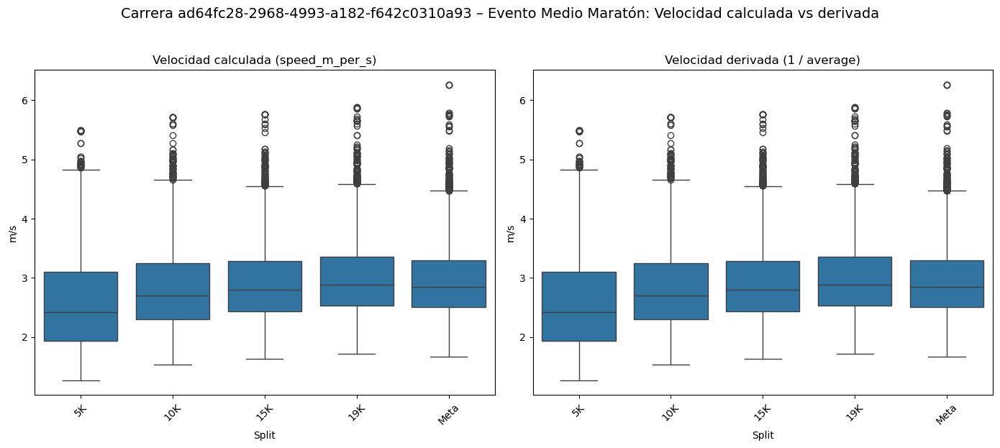

Correlación entre speed_m_per_s y 1/average: 1.000000
Diferencia media absoluta: 0.000000 m/s


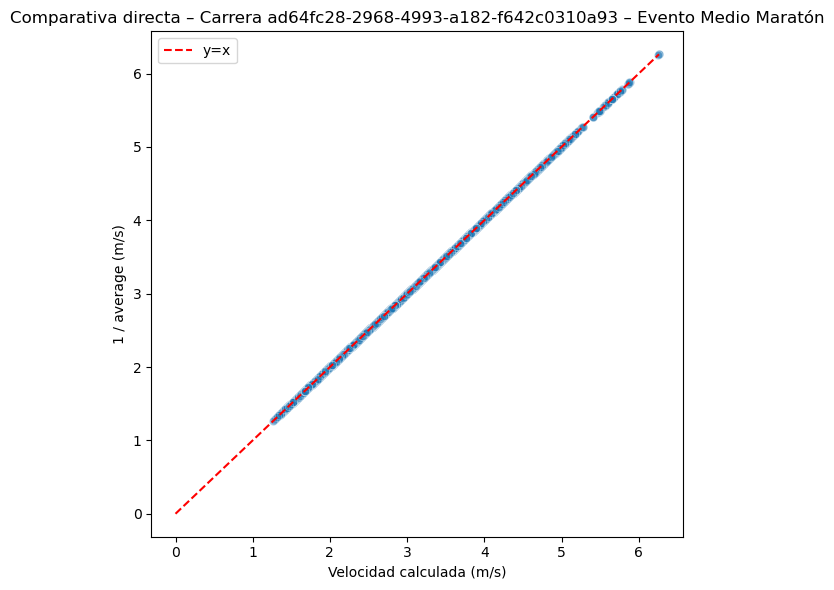


--- Evento Carrera Profuturo ---
Total filas en evento: 5712
Filas anómalas: 288
Ejemplos de anomalías (primeras 10 filas):


,athlete_id,split,speed_from_average
305494,ba75953f-62fc-5238-aad6-0e5d4f882c47,2.5K,4.149550
305495,ba75953f-62fc-5238-aad6-0e5d4f882c47,Meta,4.330879
305547,2b8d7297-0e26-56ec-a2e9-f4c14acf791d,2.5K,4.342917
305548,2b8d7297-0e26-56ec-a2e9-f4c14acf791d,Meta,4.535559
305571,fea7f073-bd94-57dd-84b8-cc5906568afc,Meta,1.190774
305627,11741458-5bda-53c6-81b5-1690ed0cb794,Meta,1.195072
305646,a7a87247-3258-5fed-b3cf-f4ac4b917a8b,Meta,4.210349
305671,42b15550-dc4d-5470-9437-a73e54beed2b,Meta,1.191938
305749,945dee60-125a-5f2a-9256-87796e1cfa71,2.5K,4.516100
305750,945dee60-125a-5f2a-9256-87796e1cfa71,Meta,4.462891



Resumen de anomalías por split (porcentaje y número):
        pct_outlier  num_outlier
split                           
2.5K       6.087937          108
Meta       8.977556          180
Salida     0.000000            0


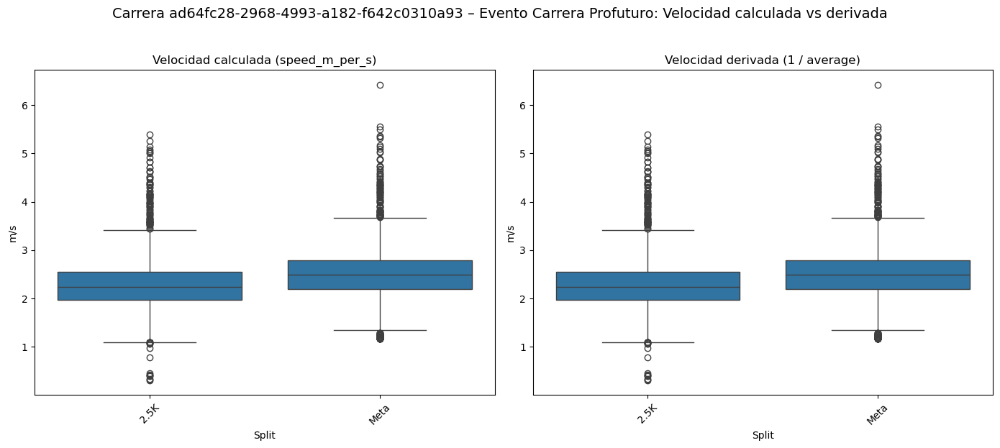

Correlación entre speed_m_per_s y 1/average: 1.000000
Diferencia media absoluta: 0.000000 m/s


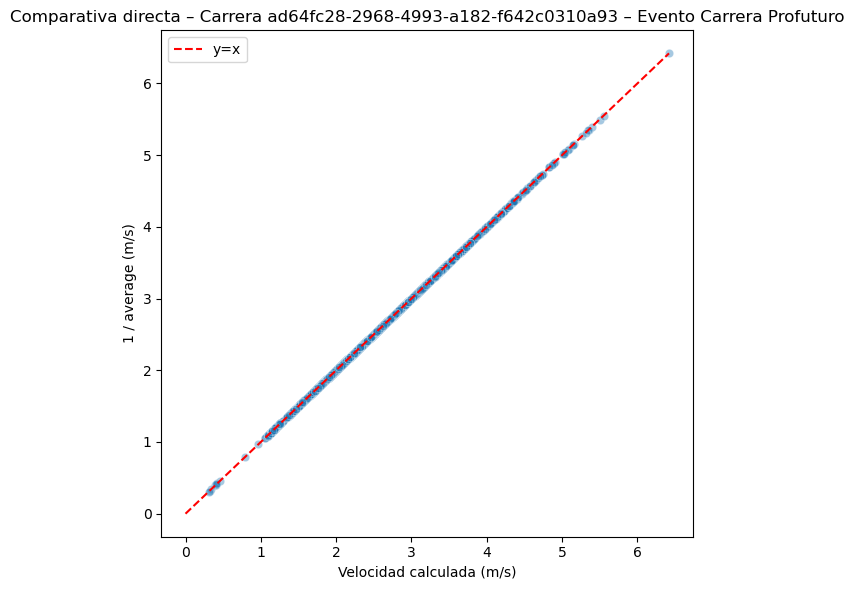


=== Carrera 331e7589-6440-4968-9b44-484ba589824e ===

--- Evento Marato ---
Total filas en evento: 244111
Filas anómalas: 5625
Ejemplos de anomalías (primeras 10 filas):


,athlete_id,split,speed_from_average
311681,114500003,5K,4.902441
311682,114500003,10K,4.906049
311683,114500003,15K,4.907253
311684,114500003,20K,4.914971
311685,114500003,Media,4.915213
311686,114500003,25K,4.916421
311687,114500003,30K,4.913763
311694,114500005,5K,4.712091
311695,114500005,10K,4.736643
311696,114500005,15K,4.729698



Resumen de anomalías por split (porcentaje y número):
        pct_outlier  num_outlier
split                           
10K        2.825942          634
15K        2.733903          611
20K        2.679409          600
25K        2.572434          570
30K        2.463596          538
35K        2.348947          512
40K        2.265639          494
5K         2.638534          589
Media      2.655776          595
Meta       2.189118          482
Salida     0.000000            0


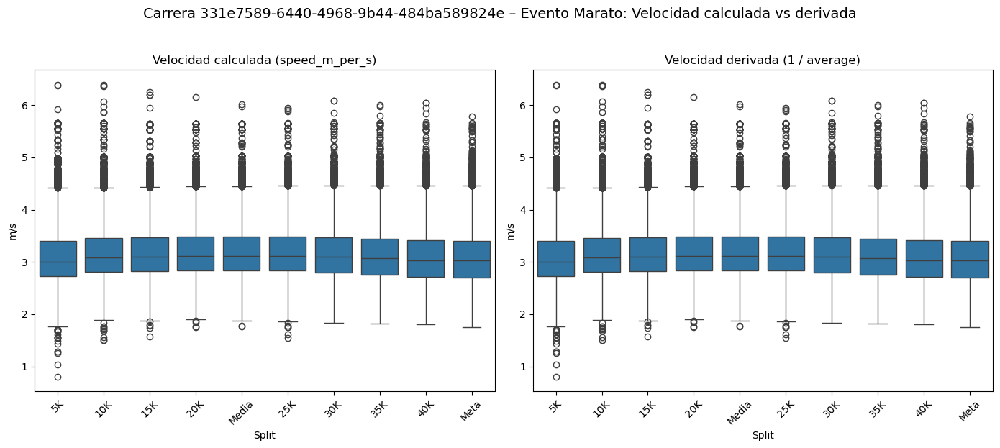

Correlación entre speed_m_per_s y 1/average: 1.000000
Diferencia media absoluta: 0.000000 m/s


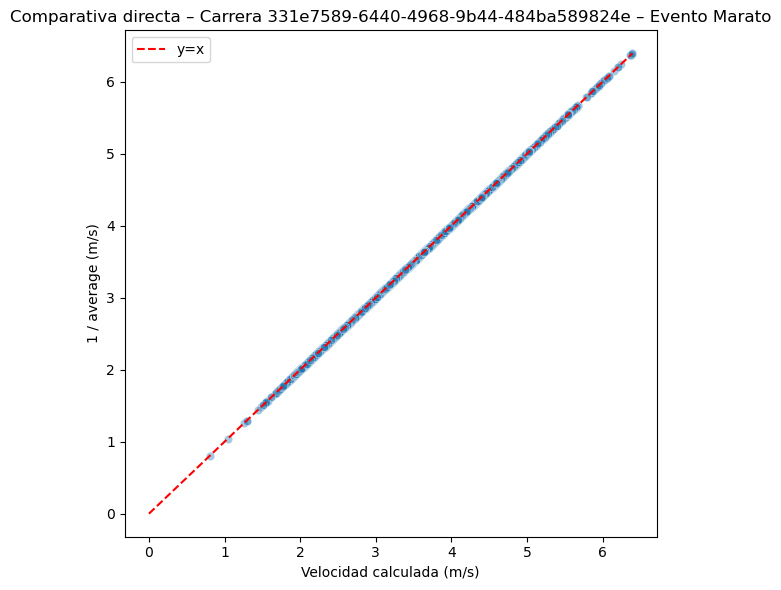

In [ ]:
print("\n--- Detección de anomalías en 1/average (m/s) por carrera y evento ---")

df_times = athletes_time_df.copy()
if 'speed_m_per_s' not in df_times.columns:
    df_times['speed_m_per_s'] = np.where(df_times['average'] > 0, 1 / df_times['average'], np.nan)
df_times['speed_from_average'] = np.where(df_times['average'] > 0, 1 / df_times['average'], np.nan)

for race in df_times['race_id'].unique():
    df_race = df_times[df_times['race_id'] == race]
    print(f"\n=== Carrera {race} ===")

    for event in df_race['event_id'].unique():
        if "General" in event:
            continue

        df_event = df_race[df_race['event_id'] == event].copy()
        print(f"\n--- Evento {event} ---")

        def outlier_iqr_percentiles(x):
            x_clean = x.dropna()
            if x_clean.empty:
                return pd.Series([False]*len(x), index=x.index)
            
            p1, p99 = np.percentile(x_clean, [1, 99])
            q1, q3 = np.percentile(x_clean, [25, 75])
            iqr = q3 - q1
            lower_iqr, upper_iqr = q1 - 1.5 * iqr, q3 + 1.5 * iqr
            
            outlier = (x < lower_iqr) | (x > upper_iqr) | (x < p1) | (x > p99)
            return outlier

        df_event['outlier_speed_flag'] = df_event.groupby('split')['speed_from_average'].transform(outlier_iqr_percentiles)

        df_speed_anomalies = df_event[df_event['outlier_speed_flag']].copy()
        print(f"Total filas en evento: {len(df_event)}")
        print(f"Filas anómalas: {len(df_speed_anomalies)}")
        if not df_speed_anomalies.empty:
            print("Ejemplos de anomalías (primeras 10 filas):")
            display(df_speed_anomalies[['athlete_id', 'split', 'speed_from_average']].head(10))

        summary_speed = (
            df_event.groupby('split')['outlier_speed_flag']
            .agg(['mean','sum'])
            .rename(columns={'mean':'pct_outlier','sum':'num_outlier'})
        )
        summary_speed['pct_outlier'] *= 100
        print("\nResumen de anomalías por split (porcentaje y número):")
        print(summary_speed)

        df_comp = df_event.dropna(subset=['speed_m_per_s', 'speed_from_average', 'netTime']).copy()
        split_order = df_comp.groupby('split')['netTime'].mean().sort_values().index

        fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharex=True)
        sns.boxplot(data=df_comp, x='split', y='speed_m_per_s', ax=axes[0], order=split_order)
        axes[0].set_title("Velocidad calculada (speed_m_per_s)")
        axes[0].set_xlabel("Split")
        axes[0].set_ylabel("m/s")
        axes[0].tick_params(axis='x', rotation=45)

        sns.boxplot(data=df_comp, x='split', y='speed_from_average', ax=axes[1], order=split_order)
        axes[1].set_title("Velocidad derivada (1 / average)")
        axes[1].set_xlabel("Split")
        axes[1].set_ylabel("m/s")
        axes[1].tick_params(axis='x', rotation=45)

        plt.suptitle(f"Carrera {race} – Evento {event}: Velocidad calculada vs derivada", fontsize=14, y=1.03)
        plt.tight_layout()
        plt.show()

        corr = df_comp[['speed_m_per_s', 'speed_from_average']].corr().iloc[0, 1]
        diff = (df_comp['speed_m_per_s'] - df_comp['speed_from_average']).abs().mean()

        print(f"Correlación entre speed_m_per_s y 1/average: {corr:.6f}")
        print(f"Diferencia media absoluta: {diff:.6f} m/s")

        plt.figure(figsize=(6,6))
        sns.scatterplot(
            data=df_comp, 
            x='speed_m_per_s', 
            y='speed_from_average', 
            alpha=0.4
        )
        max_val = df_comp[['speed_m_per_s','speed_from_average']].max().max()
        plt.plot([0, max_val], [0, max_val], color='red', linestyle='--', label='y=x')
        plt.title(f"Comparativa directa – Carrera {race} – Evento {event}")
        plt.xlabel("Velocidad calculada (m/s)")
        plt.ylabel("1 / average (m/s)")
        plt.legend()
        plt.tight_layout()
        plt.show()

Podemos ver que la velocidad se mantiene algo constante, no baja tanto como subia el tiempo, y suele estar sobre los 3 o 4 metros por segundo. Tambien vemos atletas con un tiempo alto desporporcionado que podrian estar ligados a errores de cálculo o de obtencion. 

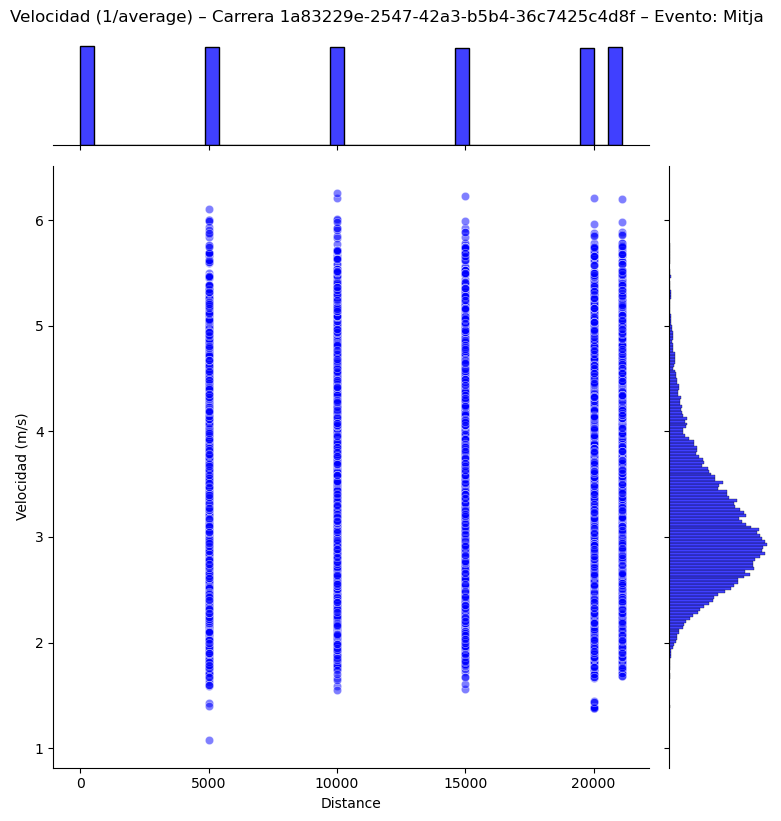

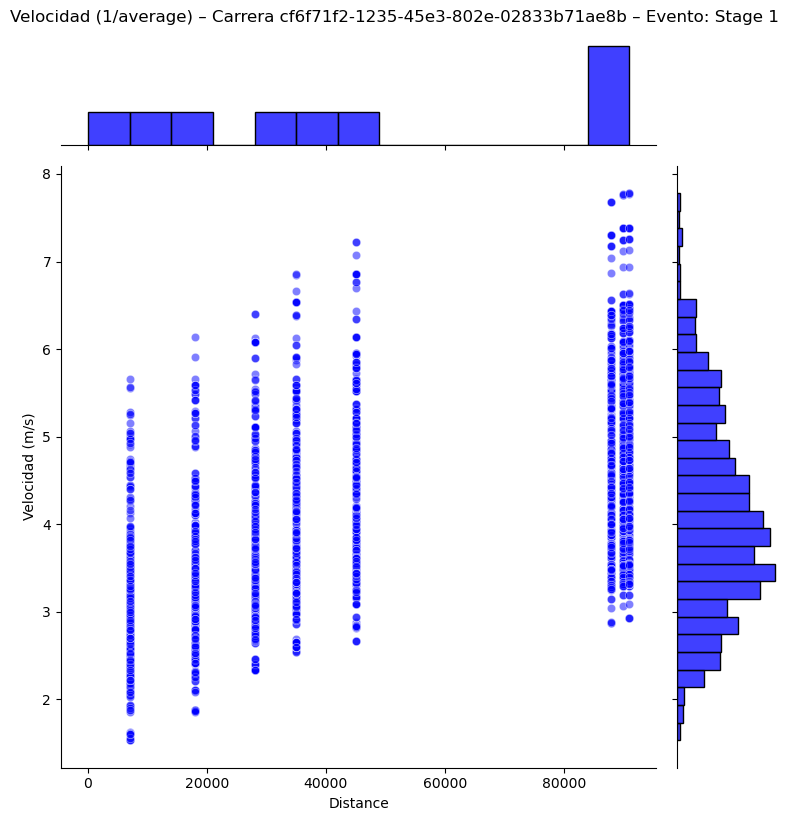

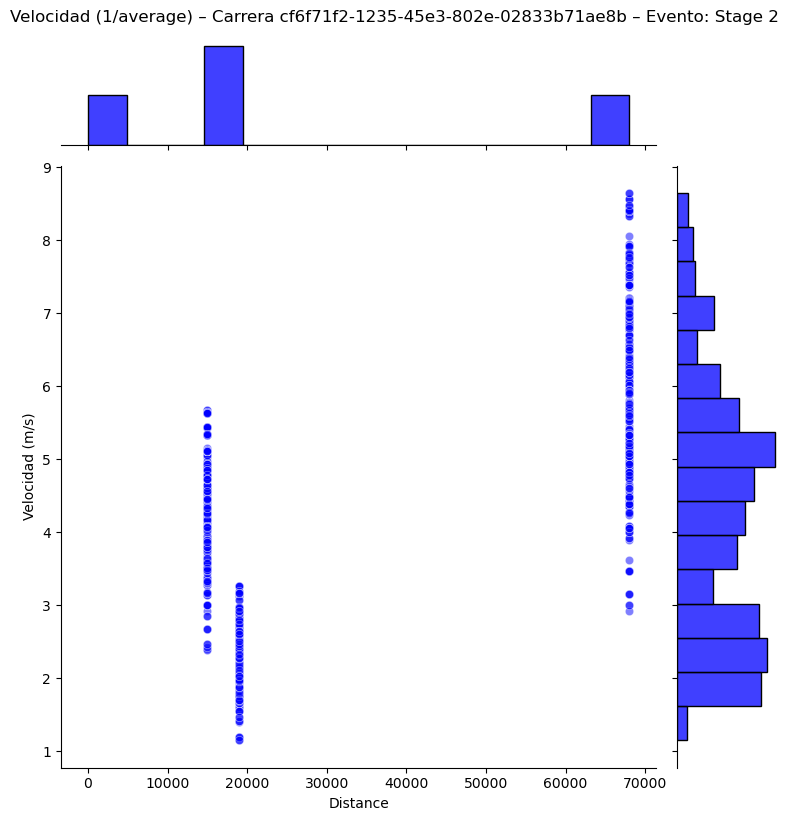

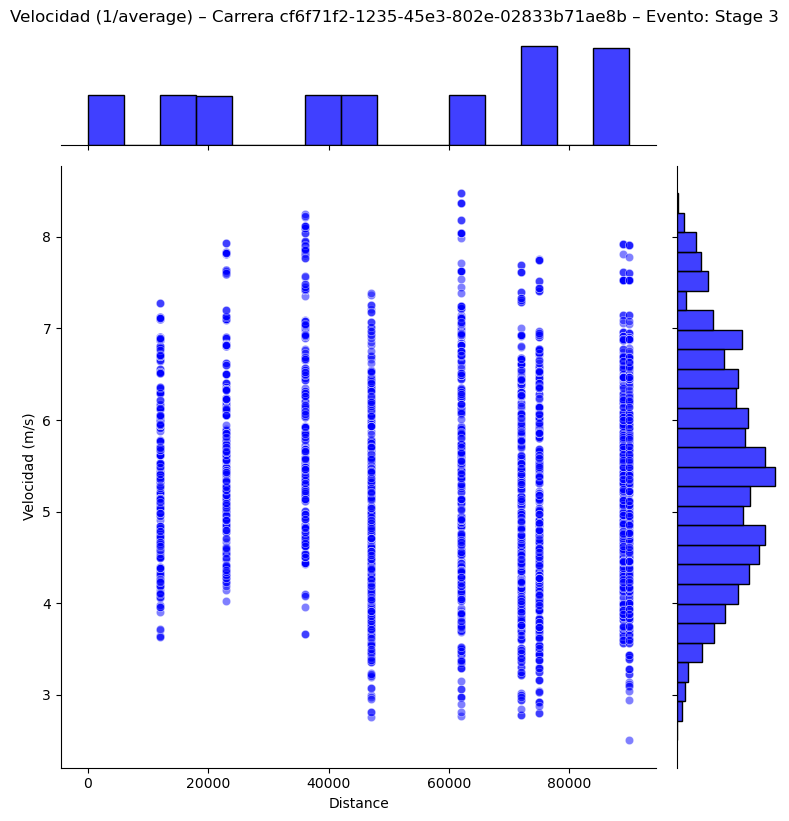

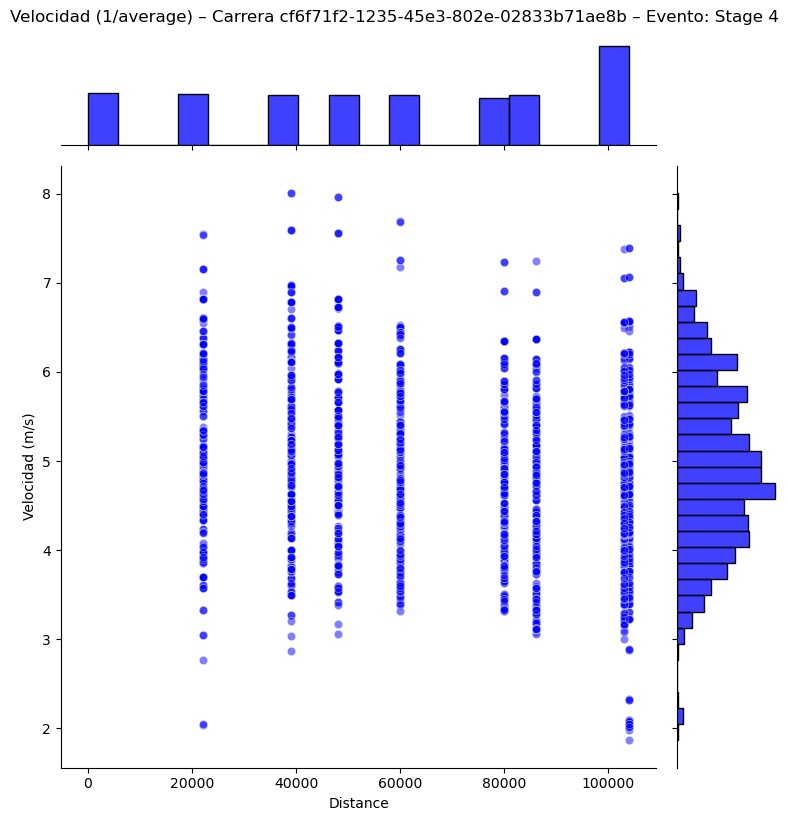

...

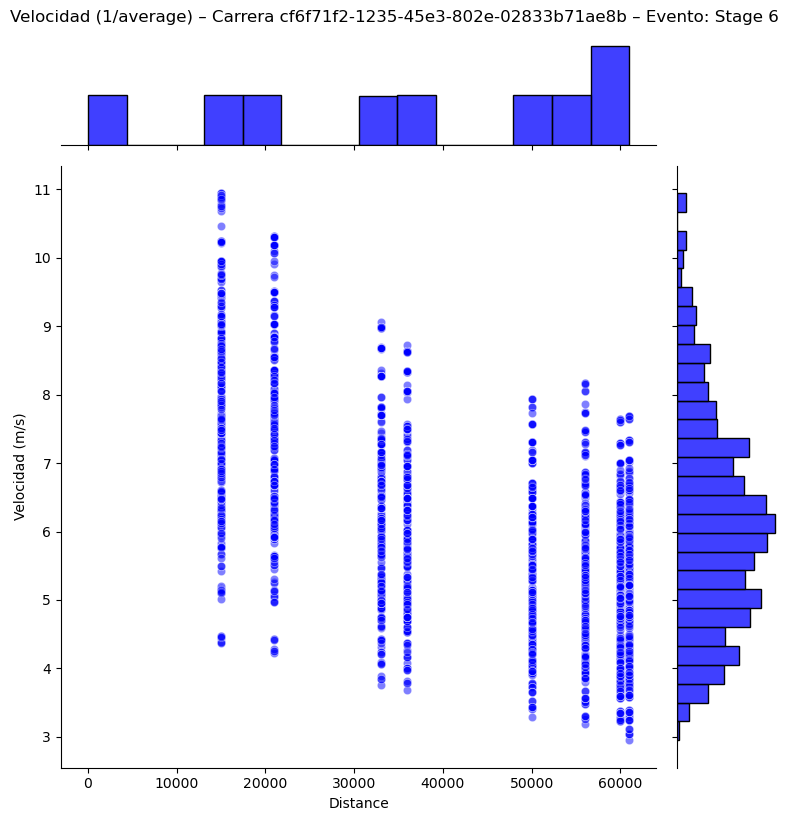

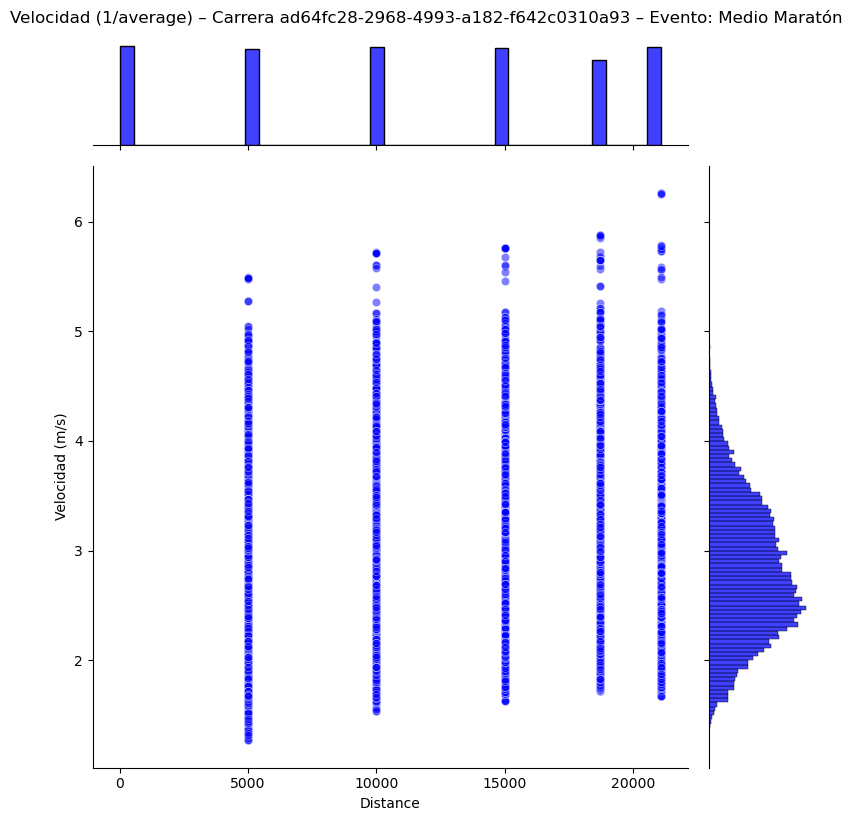

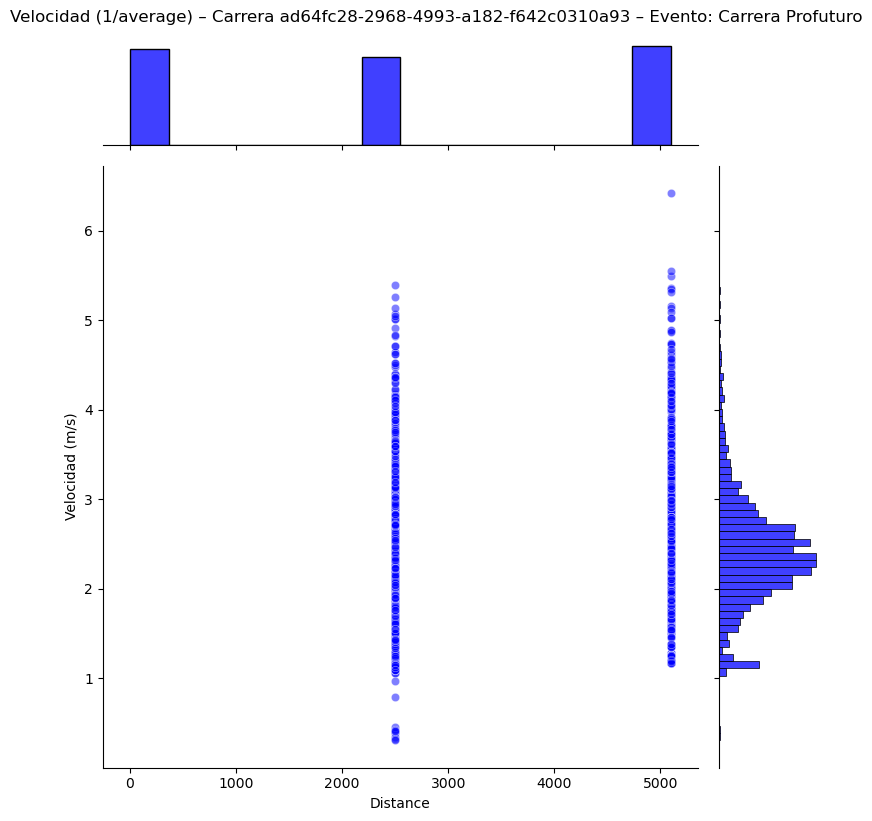

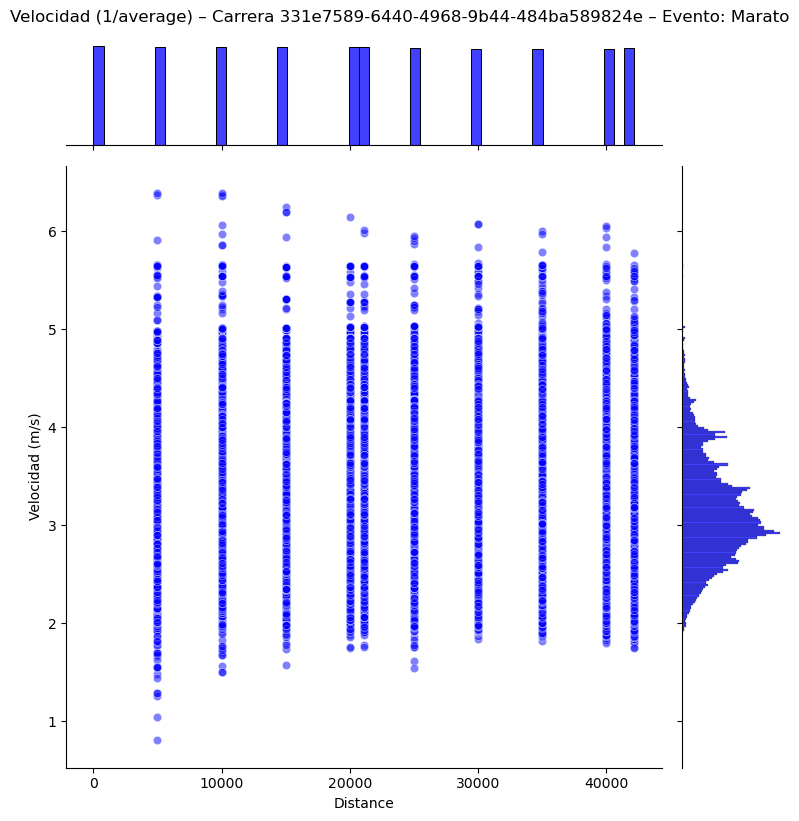

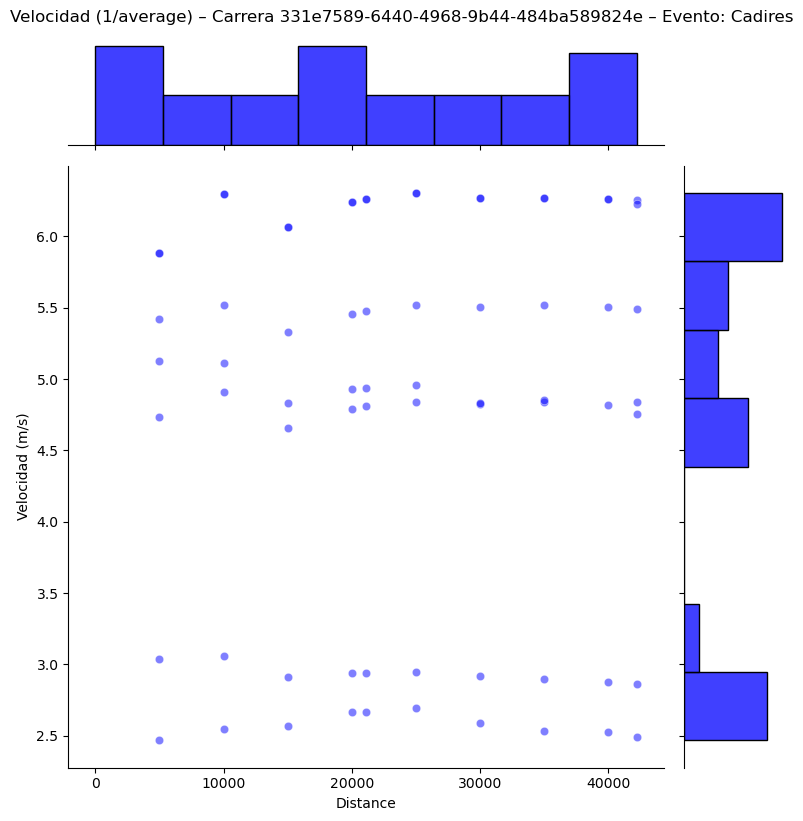

In [ ]:
df = athletes_time_df.copy()

df['speed_from_average'] = np.where(df['average'] > 0, 1 / df['average'], np.nan)

for race in df['race_id'].unique():
    df_race = df[df['race_id'] == race].copy()
    
    for event in df_race['event_id'].unique():
        if "General" in event:
            continue  
        
        df_event = df_race[df_race['event_id'] == event].copy()
        
        g = sns.jointplot(
            data=df_event,
            x='distance',
            y='speed_from_average',  
            kind='scatter',
            alpha=0.5,
            height=8,
            color='blue'
        )
        g.fig.suptitle(f"Velocidad (1/average) – Carrera {race} – Evento: {event}", y=1.02)
        g.set_axis_labels("Distance", "Velocidad (m/s)")
        plt.show()

### Relaciones

En esta parte vamos a buscar la relación entre las distintas variables. Vamos a comparar las temporales que nos interesen con algunas variables de los atletas que puedan ser identificadoras de algo que esté pasando. Vamos a usar lo siguiente test, que creemos que es lo más adecuados. 

1. **Spearman vs Pearson**

- Spearman: mide correlación monótona entre dos variables continuas.

- - No requiere que los datos tengan distribución normal.

- - Resistente a outliers.

- Pearson: mide correlación lineal entre dos variables continuas.

- - Requiere normalidad o al menos distribución aproximadamente lineal.

- Por qué se usa Spearman aquí:

- - edad, time_split_sec y velocidad pueden tener distribuciones sesgadas o outliers.

- - No buscamos exactamente linealidad, sino si a mayor edad o velocidad hay tendencia a mayor/menor tiempo → monotónica.

2. **Mann-Whitney vs t-test**

- Mann-Whitney: compara medianas entre dos grupos categóricos, no requiere normalidad.

- t-test: compara medias, requiere normalidad y varianzas similares.

- Por qué Mann-Whitney:

- - Los tiempos de carrera suelen estar sesgados y pueden tener outliers.

- - Es más robusto frente a estas condiciones que el t-test.

3. **Kruskal-Wallis vs ANOVA**

- Kruskal-Wallis: extensión de Mann-Whitney para >2 grupos, compara medianas, no requiere normalidad.

- ANOVA: compara medias de más de 2 grupos, requiere normalidad y homocedasticidad.

- Por qué Kruskal-Wallis:

- - club o category pueden tener tamaños muy desiguales o distribuciones sesgadas.

- - Evita supuestos estrictos de ANOVA.

In [ ]:
def analizar_relaciones(
    athletes_df,
    athletes_events_df,
    athletes_time_df,
    alpha=0.05
):
    results = []

    athletes_df['gender'] = (
        athletes_df['gender']
            .astype(str)
            .str.lower()
            .str.strip()
    )

    gender_map = {
        'h': 'male',
        'm': 'female',
        'hombre': 'male',
        'mujer': 'female',
        'masculino': 'male',
        'femenino': 'female',
        'male': 'male',
        'female': 'female'
    }

    athletes_df['gender'] = athletes_df['gender'].map(gender_map)

    athletes_df = athletes_df[athletes_df['gender'].isin(['male', 'female'])]

    df_eventos = athletes_events_df.merge(
        athletes_df[['athlete_id', 'birthdate', 'gender', 'club']],
        on='athlete_id', how='left'
    )

    if 'rawTime' in athletes_events_df.columns:
        df_eventos['fecha_evento'] = pd.to_datetime(df_eventos['rawTime'], errors='coerce')
    else:
        df_eventos['fecha_evento'] = pd.to_datetime(df_eventos['startTime'], errors='coerce')

    df_eventos['birthdate'] = pd.to_datetime(df_eventos['birthdate'], errors='coerce')
    df_eventos['edad'] = (df_eventos['fecha_evento'] - df_eventos['birthdate']).dt.days / 365.25

    df_splits = athletes_time_df.merge(
        athletes_df[['athlete_id', 'birthdate', 'gender', 'club']],
        on='athlete_id', how='left'
    ).merge(
        athletes_events_df[['athlete_id', 'race_id', 'event_id', 'category']],
        on=['athlete_id', 'race_id', 'event_id'], how='left'
    )

    if 'rawTime' in athletes_time_df.columns:
        df_splits['fecha_evento'] = pd.to_datetime(df_splits['rawTime'], errors='coerce')
    elif 'datetime' in df_splits.columns:
        df_splits['fecha_evento'] = pd.to_datetime(df_splits['datetime'], errors='coerce')
    else:
        df_splits['fecha_evento'] = pd.Timestamp.now()

    df_splits['birthdate'] = pd.to_datetime(df_splits['birthdate'], errors='coerce')
    df_splits['edad'] = (df_splits['fecha_evento'] - df_splits['birthdate']).dt.days / 365.25

    if 'average' in df_splits.columns:
        df_splits['velocidad'] = np.where(
            df_splits['average'] > 0,
            1 / df_splits['average'],
            np.nan
        )
    else:
        df_splits['velocidad'] = np.nan

    def correr_test(df, variable, metric, test_name):
        df = df.dropna(subset=[variable, metric])
        if df.empty:
            print(f"{metric} / {variable}: grupo vacío → no se calcula el test.")
            return None

        try:
            if test_name == "mannwhitney":
                grupos = df[variable].dropna().unique()
                if len(grupos) != 2:
                    print(f"{metric} / {variable}: solo hay {len(grupos)} grupo(s) → no se calcula Mann-Whitney.")
                    return None
                data1 = df[df[variable] == grupos[0]][metric]
                data2 = df[df[variable] == grupos[1]][metric]
                stat, p = stats.mannwhitneyu(data1, data2, alternative='two-sided')

            elif test_name == "kruskal":
                grupos = [g[metric].dropna() for _, g in df.groupby(variable)]
                grupos = [g for g in grupos if len(g) > 0]
                if len(grupos) < 2:
                    print(f"{metric} / {variable}: solo hay {len(grupos)} grupo(s) → no se calcula Kruskal.")
                    return None
                all_values = pd.concat(grupos).unique()
                if len(all_values) == 1:
                    print(f"{metric} / {variable}: todos los valores son iguales → test inválido.")
                    return None
                stat, p = stats.kruskal(*grupos)

            elif test_name == "spearman":
                if df[variable].nunique() < 2:
                    print(f"{metric} / {variable}: solo un valor único → no se calcula Spearman.")
                    return None
                stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')

            else:
                return None

            significant = p < alpha

            return dict(
                race_id=df['race_id'].iloc[0],
                event_id=df['event_id'].iloc[0],
                split=df['split'].iloc[0] if 'split' in df.columns else None,
                variable=variable,
                metric=metric,
                test=test_name,
                statistic=stat,
                p_value=p,
                significant=significant,
                n=len(df),
                n_groups=df[variable].nunique()
            )

        except Exception:
            return None

    for (race, event), df_group in df_eventos.groupby(['race_id', 'event_id']):
        for metric in ['startTime', 'netTime']:
            if metric not in df_group.columns:
                continue
            df_group[metric] = pd.to_numeric(df_group[metric], errors='coerce')
            for variable, test_name in [
                ('gender', 'mannwhitney'),
                ('club', 'kruskal'),
                ('category', 'kruskal'),
                ('edad', 'spearman')
            ]:
                r = correr_test(df_group, variable, metric, test_name)
                if r:
                    results.append(r)

    for (race, event, split), df_group in df_splits.groupby(['race_id', 'event_id', 'split']):

        if 'time_split_sec' in df_group.columns:
            df_group['time_split_sec'] = pd.to_numeric(df_group['time_split_sec'], errors='coerce')
            for variable, test_name in [
                ('gender', 'mannwhitney'),
                ('club', 'kruskal'),
                ('category', 'kruskal'),
                ('edad', 'spearman')
            ]:
                r = correr_test(df_group, variable, 'time_split_sec', test_name)
                if r:
                    results.append(r)

        if 'velocidad' in df_group.columns:
            df_group['velocidad'] = pd.to_numeric(df_group['velocidad'], errors='coerce')
            for variable, test_name in [
                ('gender', 'mannwhitney'),
                ('club', 'kruskal'),
                ('category', 'kruskal'),
                ('edad', 'spearman')
            ]:
                r = correr_test(df_group, variable, 'velocidad', test_name)
                if r:
                    results.append(r)

    results_df = pd.DataFrame(results)
    if results_df.empty:
        print("No se obtuvieron resultados.")
        return None, None

    summary_df = (
        results_df.groupby(['variable', 'metric'])['significant']
        .mean()
        .reset_index()
        .rename(columns={'significant':'prop_significant'})
        .sort_values('prop_significant', ascending=False)
    )

    print("\nAnálisis completado.")
    print(summary_df)

    return results_df, summary_df, df_eventos, df_splits

In [22]:
athletes_events_df = dfs['athletes_events_df']

In [23]:
results_df, summary_df, df_eventos, df_splits = analizar_relaciones(
    athletes_df,
    athletes_events_df,
    athletes_time_df,
    alpha=0.05
)

print(results_df[['race_id', 'event_id', 'split', 'variable', 'metric', 'significant', 'p_value']])

⚠️ startTime / club: todos los valores son iguales → test inválido.
⚠️ startTime / category: todos los valores son iguales → test inválido.


C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3490703453.py:107: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')


⚠️ time_split_sec / club: todos los valores son iguales → test inválido.
⚠️ time_split_sec / category: todos los valores son iguales → test inválido.
velocidad / gender: grupo vacío → no se calcula el test.
velocidad / club: grupo vacío → no se calcula el test.
velocidad / category: grupo vacío → no se calcula el test.
velocidad / edad: grupo vacío → no se calcula el test.


C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3490703453.py:107: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')


⚠️ time_split_sec / club: todos los valores son iguales → test inválido.
⚠️ time_split_sec / category: todos los valores son iguales → test inválido.
velocidad / gender: grupo vacío → no se calcula el test.
velocidad / club: grupo vacío → no se calcula el test.
velocidad / category: grupo vacío → no se calcula el test.
velocidad / edad: grupo vacío → no se calcula el test.


C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3490703453.py:107: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')


⚠️ time_split_sec / club: todos los valores son iguales → test inválido.
⚠️ time_split_sec / category: todos los valores son iguales → test inválido.
velocidad / gender: grupo vacío → no se calcula el test.
velocidad / club: grupo vacío → no se calcula el test.
velocidad / category: grupo vacío → no se calcula el test.
velocidad / edad: grupo vacío → no se calcula el test.


C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3490703453.py:107: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')


⚠️ time_split_sec / club: todos los valores son iguales → test inválido.
⚠️ time_split_sec / category: todos los valores son iguales → test inválido.
velocidad / gender: grupo vacío → no se calcula el test.
velocidad / club: grupo vacío → no se calcula el test.
velocidad / category: grupo vacío → no se calcula el test.
velocidad / edad: grupo vacío → no se calcula el test.


C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3490703453.py:107: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')


⚠️ time_split_sec / club: todos los valores son iguales → test inválido.
⚠️ time_split_sec / category: todos los valores son iguales → test inválido.
velocidad / gender: grupo vacío → no se calcula el test.
velocidad / club: grupo vacío → no se calcula el test.
velocidad / category: grupo vacío → no se calcula el test.
velocidad / edad: grupo vacío → no se calcula el test.


C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3490703453.py:107: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')


⚠️ time_split_sec / club: todos los valores son iguales → test inválido.
⚠️ time_split_sec / category: todos los valores son iguales → test inválido.
velocidad / gender: grupo vacío → no se calcula el test.
velocidad / club: grupo vacío → no se calcula el test.
velocidad / category: grupo vacío → no se calcula el test.
velocidad / edad: grupo vacío → no se calcula el test.


C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3490703453.py:107: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')


⚠️ time_split_sec / club: todos los valores son iguales → test inválido.
⚠️ time_split_sec / category: todos los valores son iguales → test inválido.
velocidad / gender: grupo vacío → no se calcula el test.
velocidad / club: grupo vacío → no se calcula el test.
velocidad / category: grupo vacío → no se calcula el test.
velocidad / edad: grupo vacío → no se calcula el test.


C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3490703453.py:107: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')


⚠️ time_split_sec / club: todos los valores son iguales → test inválido.
⚠️ time_split_sec / category: todos los valores son iguales → test inválido.
velocidad / gender: grupo vacío → no se calcula el test.
velocidad / club: grupo vacío → no se calcula el test.
velocidad / category: grupo vacío → no se calcula el test.
velocidad / edad: grupo vacío → no se calcula el test.


C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3490703453.py:107: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')


⚠️ time_split_sec / club: todos los valores son iguales → test inválido.
⚠️ time_split_sec / category: todos los valores son iguales → test inválido.
velocidad / gender: grupo vacío → no se calcula el test.
velocidad / club: grupo vacío → no se calcula el test.
velocidad / category: grupo vacío → no se calcula el test.
velocidad / edad: grupo vacío → no se calcula el test.


C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3490703453.py:107: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')


⚠️ time_split_sec / club: todos los valores son iguales → test inválido.
⚠️ time_split_sec / category: todos los valores son iguales → test inválido.
velocidad / gender: grupo vacío → no se calcula el test.
velocidad / club: grupo vacío → no se calcula el test.
velocidad / category: grupo vacío → no se calcula el test.
velocidad / edad: grupo vacío → no se calcula el test.

Análisis completado.
    variable          metric  prop_significant
2   category       velocidad          1.000000
3       club       startTime          1.000000
4       club  time_split_sec          1.000000
5       club       velocidad          1.000000
1   category  time_split_sec          0.970149
8       edad       velocidad          0.970149
11    gender       velocidad          0.955224
0   category       startTime          0.888889
7       edad  time_split_sec          0.831169
10    gender  time_split_sec          0.727273
6       edad       startTime          0.700000
9     gender       startTime          

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3490703453.py:107: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  stat, p = stats.spearmanr(df[variable], df[metric], nan_policy='omit')


                                  race_id           event_id    split  \
0    1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja     None   
1    1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja     None   
2    1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja     None   
3    1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja     None   
4    331e7589-6440-4968-9b44-484ba589824e             Marato     None   
5    331e7589-6440-4968-9b44-484ba589824e             Marato     None   
6    331e7589-6440-4968-9b44-484ba589824e             Marato     None   
7    331e7589-6440-4968-9b44-484ba589824e             Marato     None   
8    ad64fc28-2968-4993-a182-f642c0310a93  Carrera Profuturo     None   
9    ad64fc28-2968-4993-a182-f642c0310a93  Carrera Profuturo     None   
10   ad64fc28-2968-4993-a182-f642c0310a93  Carrera Profuturo     None   
11   ad64fc28-2968-4993-a182-f642c0310a93  Carrera Profuturo     None   
12   ad64fc28-2968-4993-a182-f642c0310a93      Medi

- “todos los valores son iguales → test inválido.”

- - El test estadístico no puede ejecutarse porque la variable que se quiere analizar tiene exactamente el mismo valor para todos los atletas dentro del grupo (carrera/evento/split) (por ejemplo, Salida).

- “grupo vacío → no se calcula el test.”

- - Después de filtrar datos para (race, event, split), no queda ninguna fila válida para esa variable.


- “solo hay X grupo(s) → no se calcula el test.”

- - El test necesita dos o más grupos para comparar, pero solo existe un grupo único.


- “ConstantInputWarning: input array is constant; correlation coefficient is not defined.”
- - Spearman no puede calcular correlación si una de las dos variables es constante (es decir, no cambia nada).

- La categoría

- - Afecta startTime, split times y velocidad.

- - La relación es muy estable, siempre significativa.


- El club

- - Tiene efecto significativo prácticamente siempre.

- - Esto ocurre incluso en splits.


- La edad (numérica)

- - Alta correlación significativa con:

- - - velocidad (97%)

- - - tiempos parciales (83%)

- - - startTime (70%)


- El género

- - - Para velocidad: 96% de significancia

- - - Para splits: 73%

- - - Para startTime: solo 30%



- ¿Cambian las conclusiones según carrera, evento o split?

- - Si, en algunas combinaciones el resultado cambia, pero la mayoría de patrones se mantienen estables.


- CATEGORY

- - Extremadamente estable.
- - Apenas cambia entre carreras, eventos o splits.

- - La división competitiva predice muy bien el rendimiento independientemente de la carrera o split.

- CLUB

- - También muy estable:

- - - Siempre significativo en startTime, splits y velocidad.


- EDAD (continua)

- - Más variable según split, pero suele salir significativa en 70–97% de casos


- GÉNERO

- - Es el que más cambia según carrera/evento/split:

- - Velocidad: casi siempre significativo

- - Splits: depende del split, baja a ~73%

- - startTime: muy variable, solo 30% significativo

- - El género afecta el rendimiento global, pero no tanto el comportamiento en salida.

#### Descriptivo por grupo

Tambié podemos ver los descriptivos por cada agrupacion

In [24]:
def estadisticas_descriptivas_por_variable(df_eventos, df_splits, variables, metricas_evento=['startTime', 'netTime'], metricas_split=['time_split_sec', 'velocidad']):
    """
    Calcula estadísticas descriptivas por grupo de cada variable, separando tablas por variable.
    """
    desc_eventos = {}
    desc_splits = {}

    for var in variables:
        tabla = []
        for (race, event), df_group in df_eventos.groupby(['race_id', 'event_id']):
            for metric in metricas_evento:
                if metric not in df_group.columns:
                    continue
                df_group[metric] = pd.to_numeric(df_group[metric], errors='coerce')
                for grupo_val, grupo_df in df_group.groupby(var):
                    tabla.append({
                        'group': grupo_val,
                        'race_id': race,
                        'event_id': event,
                        'metric': metric,
                        'mean': grupo_df[metric].mean(),
                        'std': grupo_df[metric].std(),
                        'median': grupo_df[metric].median(),
                        'min': grupo_df[metric].min(),
                        'max': grupo_df[metric].max(),
                        'count': len(grupo_df)
                    })
        desc_eventos[var] = pd.DataFrame(tabla)

    for var in variables:
        tabla = []
        for (race, event, split), df_group in df_splits.groupby(['race_id', 'event_id', 'split']):
            for metric in metricas_split:
                if metric not in df_group.columns:
                    continue
                df_group[metric] = pd.to_numeric(df_group[metric], errors='coerce')
                for grupo_val, grupo_df in df_group.groupby(var):
                    tabla.append({
                        'group': grupo_val,
                        'race_id': race,
                        'event_id': event,
                        'split': split,
                        'metric': metric,
                        'mean': grupo_df[metric].mean(),
                        'std': grupo_df[metric].std(),
                        'median': grupo_df[metric].median(),
                        'min': grupo_df[metric].min(),
                        'max': grupo_df[metric].max(),
                        'count': len(grupo_df)
                    })
        desc_splits[var] = pd.DataFrame(tabla)

    return desc_eventos, desc_splits

bins = [0, 19, 29, 39, 49, 59, 69, 79, 120]  
labels = ['<20','20-29','30-39','40-49','50-59','60-69','70-79','80+']
df_eventos['edad_group'] = pd.cut(df_eventos['edad'], bins=bins, labels=labels)
df_splits['edad_group'] = pd.cut(df_splits['edad'], bins=bins, labels=labels)

variables_a_analizar = ['gender', 'club', 'category', 'edad_group']
eventos_desc, splits_desc = estadisticas_descriptivas_por_variable(df_eventos, df_splits, variables_a_analizar)

C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3422162181.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for grupo_val, grupo_df in df_group.groupby(var):
C:\Users\mario\AppData\Local\Temp\ipykernel_22300\3422162181.py:37: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for grupo_val, grupo_df in df_group.groupby(var):


In [ ]:
print("Estadísticas descriptivas por género (evento):")
print(splits_desc['edad_group'].head())

📊 Estadísticas descriptivas por género (evento):
   group                               race_id event_id split          metric  \
0    <20  1a83229e-2547-42a3-b5b4-36c7425c4d8f    Mitja   10K  time_split_sec   
1  20-29  1a83229e-2547-42a3-b5b4-36c7425c4d8f    Mitja   10K  time_split_sec   
2  30-39  1a83229e-2547-42a3-b5b4-36c7425c4d8f    Mitja   10K  time_split_sec   
3  40-49  1a83229e-2547-42a3-b5b4-36c7425c4d8f    Mitja   10K  time_split_sec   
4  50-59  1a83229e-2547-42a3-b5b4-36c7425c4d8f    Mitja   10K  time_split_sec   

          mean         std     median      min       max  count  
0  1600.100509  274.322134  1588.4895  949.875  2643.912    108  
1  1598.158241  304.564175  1588.4545  475.506  5344.330   8692  
2  1565.517851  303.686120  1557.0370  422.564  4803.853   9161  
3  1581.506775  308.296454  1554.7360  882.126  4167.249   4953  
4  1647.172410  314.273260  1618.6125  948.825  4576.307   3252  


Mostrando datos para race_id=1a83229e-2547-42a3-b5b4-36c7425c4d8f, event_id=Mitja


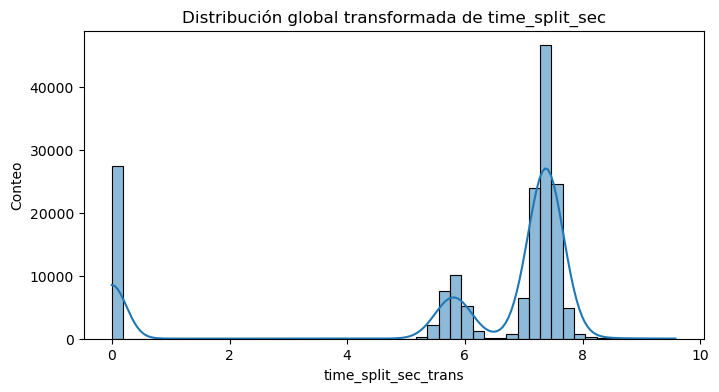

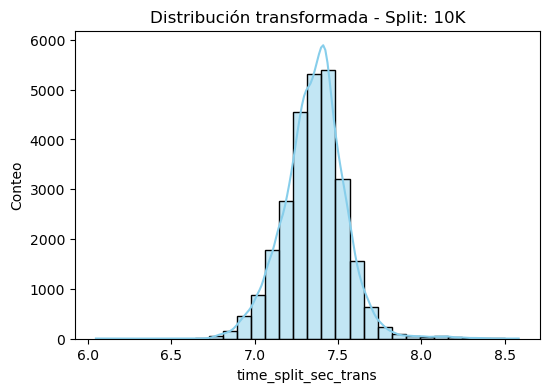

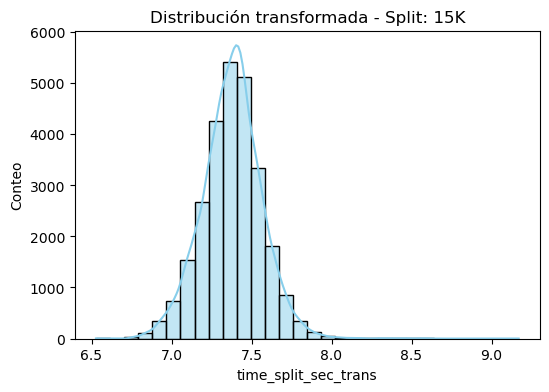

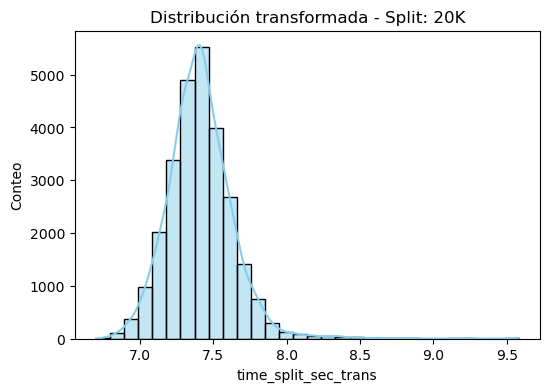

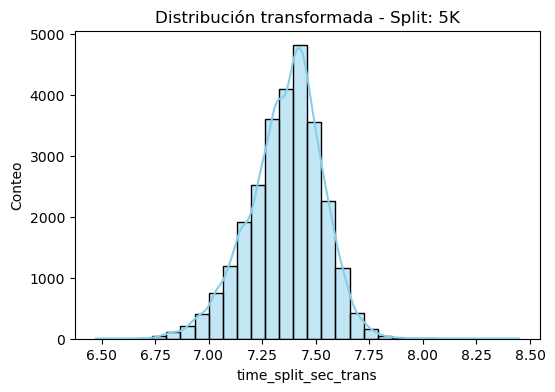

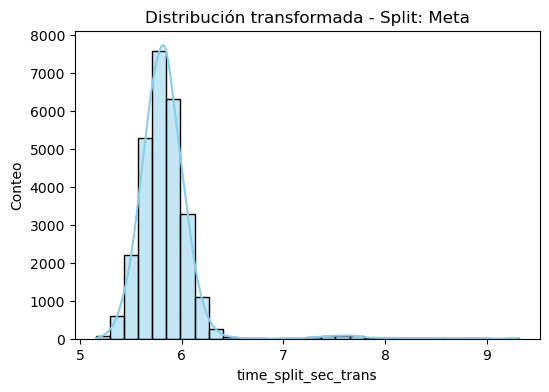

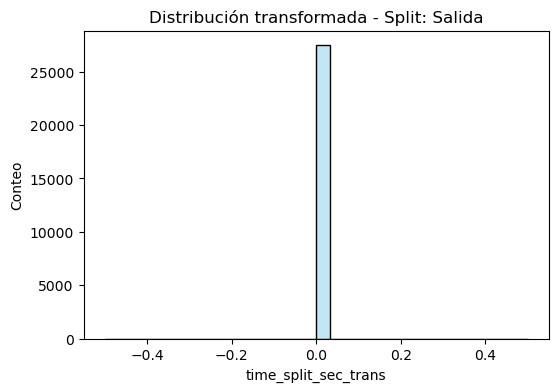

          count      mean       std       min       25%       50%       75%  \
split                                                                         
10K     27228.0  7.358222  0.183981  6.048705  7.248004  7.366324  7.467868   
15K     26825.0  7.378279  0.187280  6.527494  7.262246  7.382781  7.493184   
20K     26853.0  7.410630  0.224577  6.700731  7.272321  7.400250  7.532261   
5K      27228.0  7.358285  0.169574  6.472686  7.254863  7.376489  7.472174   
Meta    27163.0  5.837325  0.306755  5.156143  5.682181  5.811258  5.942797   
Salida  27466.0  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   

             max  
split             
10K     8.583979  
15K     9.169325  
20K     9.580164  
5K      8.446929  
Meta    9.312190  
Salida  0.000000  


In [ ]:
frac_sample = 1  # puedes ajustar el porcentaje de muestra
athletes_sample = athletes_df.sample(frac=frac_sample, random_state=42)
athletes_events_sample = athletes_events_df[athletes_events_df['athlete_id'].isin(athletes_sample['athlete_id'])]
athletes_time_sample = athletes_time_df[athletes_time_df['athlete_id'].isin(athletes_sample['athlete_id'])]

df_eventos = athletes_events_sample.merge(
    athletes_sample[['athlete_id', 'birthdate', 'gender', 'club']],
    on='athlete_id', how='left'
)

df_splits = athletes_time_sample.merge(
    athletes_sample[['athlete_id', 'birthdate', 'gender', 'club']],
    on='athlete_id', how='left'
).merge(
    athletes_events_sample[['athlete_id', 'race_id', 'event_id', 'category', 'event_std']],
    on=['athlete_id', 'race_id', 'event_id'], how='left'
)

for df in [df_eventos, df_splits]:
    df['birthdate'] = pd.to_datetime(df['birthdate'], errors='coerce')
    df['fecha_evento'] = pd.to_datetime(df.get('rawTime', pd.Timestamp.now()), errors='coerce')
    df['edad'] = (df['fecha_evento'] - df['birthdate']).dt.days / 365.25

gender_map = {'h':'male','m':'female','hombre':'male','mujer':'female','masculino':'male','femenino':'female'}
for df in [df_eventos, df_splits]:
    df['gender'] = df['gender'].astype(str).str.lower().str.strip().map(gender_map)
    df['club'] = df['club'].fillna('Unknown')
    if 'category' in df.columns:
        df['category'] = df['category'].fillna('Unknown')

if 'average' in df_splits.columns:
    df_splits['velocidad'] = np.where(df_splits['average'] > 0, 1 / df_splits['average'], np.nan)

race_random = df_splits['race_id'].dropna().sample(1, random_state=42).iloc[0]
event_random = df_splits[df_splits['race_id'] == race_random]['event_id'].dropna().sample(1, random_state=42).iloc[0]
df_example = df_splits[(df_splits['race_id'] == race_random) & 
                       (df_splits['event_id'] == event_random)].copy()

print(f"Mostrando datos para race_id={race_random}, event_id={event_random}")

df_example['time_split_sec_trans'] = np.log(df_example['time_split_sec'] + 1)

plt.figure(figsize=(8,4))
sns.histplot(df_example['time_split_sec_trans'], bins=50, kde=True)
plt.title("Distribución global transformada de time_split_sec")
plt.xlabel("time_split_sec_trans")
plt.ylabel("Conteo")
plt.show()

splits_unicos = df_example['split'].dropna().unique()
splits_unicos.sort()

for s in splits_unicos:
    plt.figure(figsize=(6,4))
    subset = df_example[df_example['split'] == s]
    sns.histplot(subset['time_split_sec_trans'], bins=30, kde=True, color='skyblue')
    plt.title(f"Distribución transformada - Split: {s}")
    plt.xlabel("time_split_sec_trans")
    plt.ylabel("Conteo")
    plt.show()

split_stats = df_example.groupby('split')['time_split_sec_trans'].describe()
print(split_stats)

### Relaciones multivariantes

Pasamos a la parte de las relaciones multivariantes. Para elegir el modelo a usar vamos a hacernos varias preguntas. 

#### Distribución variable objetivo

- time_split_sec suele ser:

- - Siempre > 0

- - Asimétrica a la derecha

- - Con colas largas

- - A veces lognormal

Por eso, antes de elegir modelo, hay que estudiar:

Histograma (ya lo hemos hecho, a veces puede ser lognormal y otras no, asimétrica a la derecha, y suele tener valores extremos)

QQ-plot (comparamos cuantiles de la variable para ver normalidad, aunque en este caso puede no ser requerido)

Skewness (para comprobar las colas largas, aunque en este caso ya hemos podido comprobar que existen)

Si hay ceros (algunos modelos pueden tener problemas si existen ceros en la variable dependiente, aunque en este caso no existen)

#### Multicolinealidad

- VIF ≥ 5 indica problemas

Una medida que podríamos implementar es la eliminación de la variable categoría, que aunque ya explica bastante de la variación entre grupos puede ser necesario al en principio estar muy correlacionada con la edad y el género, por lo que en principio se ha decidido usar edad (en grupo), género y club 

In [6]:
athletes_df = dfs['athletes_df']
athletes_events_df = dfs['athletes_events_df']
athletes_time_df = dfs['athletes_time_df']

In [21]:
import pandas as pd

# --- 1️⃣ Seleccionamos columnas necesarias de athletes_df ---
athletes_info = athletes_df[['athlete_id', 'birthdate', 'gender', 'club']]

# --- 2️⃣ Merge con athletes_time_df ---
df_multi = athletes_time_df.merge(
    athletes_info,
    on='athlete_id',
    how='left'  # LEFT merge asegura que no se pierdan filas de athletes_time_df
)

# --- 3️⃣ Convertir birthdate a datetime ---
df_multi['birthdate'] = pd.to_datetime(df_multi['birthdate'], errors='coerce')

# --- 4️⃣ Calcular edad ---
today = pd.Timestamp.today()
df_multi['edad'] = (today - df_multi['birthdate']).dt.days // 365

# --- 5️⃣ Crear grupos de edad ---
bins = [0, 17, 25, 35, 45, 55, 65, 120]  # Ajusta según tus necesidades
labels = ['<18', '18-25', '26-35', '36-45', '46-55', '56-65', '65+']
df_multi['edad_grupo'] = pd.cut(df_multi['edad'], bins=bins, labels=labels, right=True)

# --- 6️⃣ Rellenar club vacío o NaN con "independiente" ---
df_multi['club'] = df_multi['club'].fillna("independiente")
df_multi['club'] = df_multi['club'].replace('', "independiente")

# --- 7️⃣ Eliminar filas donde birthdate o gender sean NaN ---
df_multi = df_multi[df_multi['birthdate'].notna() & df_multi['gender'].notna()].reset_index(drop=True)

# --- 8️⃣ Comprobación ---
print(df_multi.head())

  athlete_id  average  averageNet  distance event_id incidence isBackup  \
0         31  0.00000         NaN         0    Mitja       NaN      NaN   
1         31  0.00000         NaN         0    Mitja       NaN      NaN   
2         31  0.17876         NaN      5000    Mitja       NaN      NaN   
3         31  0.17876         NaN      5000    Mitja       NaN      NaN   
4        159  0.00000         NaN         0    Mitja       NaN      NaN   

  location  net   netTime  offset  order  originalTime  \
0           NaN       0.0     NaN      1           NaN   
1           NaN       0.0     NaN      1           NaN   
2           NaN  891230.0     NaN      2           NaN   
3           NaN  891230.0     NaN      2           NaN   
4           NaN       0.0     NaN      1           NaN   

                                race_id                 rawTime  \
0  1a83229e-2547-42a3-b5b4-36c7425c4d8f 2025-02-16 07:31:08.560   
1  1a83229e-2547-42a3-b5b4-36c7425c4d8f 2025-02-16 07:31:08.560   

In [13]:
import pandas as pd
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm

df_vif = df_multi[['gender', 'edad', 'club']].copy()
df_vif = df_vif.drop_duplicates()

N = 50  
top_clubs = df_vif['club'].value_counts().nlargest(N).index
df_vif['club'] = df_vif['club'].where(df_vif['club'].isin(top_clubs), 'Otros')

In [18]:
# Supongamos que tu columna se llama 'club'
conteo_clubes = df_vif['club'].value_counts()
print(conteo_clubes)

club
Otros                           14966
independiente                     148
Independiente                     136
PRORUNNERS BARCELONA               61
Alquiber                           51
FUN RUNNERS CLUB ESPORTIU          50
Club Corredores                    50
Tigers Running Club                45
Club Deportivo Repsol              44
CLUB CORREDORES                    44
Les Croupiers RC                   35
BCTeam                             34
Deloitte Runners Club              34
CLUB PROAM                         33
A. D. MARATHON                     33
I BPAC                             30
INDEPENDIENTE                      29
FUNRUNNERSCLUBESPORTIU             29
No                                 29
PCteam                             27
eDO Team                           26
II BPAC                            26
Ackworth Road Runners              25
Run4you                            25
GUARDIA REAL                       24
AOSTEAM                            24
BCTEAM 

In [ ]:
df_vif_dummies = pd.get_dummies(df_vif, drop_first=True)
df_vif_dummies = df_vif_dummies.astype(int)

vif_data = pd.DataFrame()
vif_data["variable"] = df_vif_dummies.columns
vif_data["VIF"] = [variance_inflation_factor(df_vif_dummies.values, i)
                   for i in range(df_vif_dummies.shape[1])]

print(vif_data)

#### Estructura jerárquica

El dataset es longitudinal / jerárquico: Un atleta → muchos splits dentro de una carrera → varios eventos → varias carreras.

Por ejemplo, un mismo atleta se repite en varios splits, por lo que los datos no son independientes.

Es preferible usar modelos con efectos aleatorios: (GLMM Gamma con random intercept por atleta, Mixed-effects lognormal...) 

#### Conclusiones simples

- Independencia: probablemente violada si hay múltiples splits/atletas → considerar modelos mixtos o errores robustos.

- Homocedasticidad: puede estar violada → atletas jóvenes vs mayores o clubs grandes vs pequeños pueden tener varianza diferente en time_split_sec, verificar y usar errores robustos si hace falta.

- Normalidad de errores: Probablemente no haya.

- Multicolinealidad: En principio, al arreglar lo que dijimos no debería haber, aunque habrá que comprobarlo.

#### Modelo propuesto

- Variable dependiente

- - time_split_sec: tiempo de cada atleta en cada split dentro de un evento.


- Variables explicativas (efectos fijos)

- - edad (numérica) → explica diferencias promedio por año de edad.

- - gender (categórica) → explica diferencias promedio entre géneros.


- Efectos aleatorios (random intercepts)

- (1|athlete_id) → cada atleta tiene un intercepto aleatorio que captura la correlación entre múltiples splits.

- - (1|athlete_id:event_id) → cada evento de un atleta tiene su propio intercepto aleatorio, capturando variabilidad específica de cada evento dentro del mismo atleta.

- - Cada atleta puede participar en varios eventos dentro de la misma carrera, pero solo en una carrera. Esto significa que los splits del mismo atleta no son independientes. Los interceptos aleatorios permiten modelar esta dependencia sin sesgar los coeficientes de efectos fijos.

##### Forma del modelo

En notación matemática, el modelo se expresa como:

$$
\text{time\_split\_sec}_{ijk} \sim \text{Gamma}(\mu_{ijk}, \phi)
$$

$$
\log(\mu_{ijk}) = \beta_0 + \beta_1 \cdot \text{edad}_i + \beta_2 \cdot \text{gender}_i + u_j + v_{jk}
$$

donde:

- $i$ = observaciones individuales (splits)  
- $j$ = atleta  
- $k$ = evento dentro del atleta  
- $u_j \sim N(0, \sigma^2_\text{athlete})$ = random intercept por atleta  
- $v_{jk} \sim N(0, \sigma^2_\text{event})$ = random intercept por evento dentro del atleta  
- $\beta_0$ = intercepto global  
- $\beta_1, \beta_2$ = coeficientes de efectos fijos  
- $\phi$ = parámetro de dispersión de la Gamma  

Interpretación:

- **Efectos fijos:** representan la relación promedio de edad y género con los tiempos de split.  
- **Random intercepts:**  
  - $u_j$ captura que algunos atletas son sistemáticamente más rápidos o lentos que la media.  
  - $v_{jk}$ captura que ciertos eventos de un mismo atleta pueden ser más rápidos o lentos que otros, absorbiendo la dependencia intra-evento.

Justificación de esta estructura

- Dependencia jerárquica

- - Splits dentro de un evento y evento dentro de un atleta no son independientes → controlado con dos niveles de random intercept.

- Distribución de la variable dependiente

- - Gamma con link log maneja adecuadamente los tiempos positivos, asimétricos y con colas largas.

- Efectos fijos interpretables

- - Edad y género explican la variación promedio, manteniendo la interpretación simple.

In [ ]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from statsmodels.regression.mixed_linear_model import MixedLM

df_time = df_multi.copy()

df_time['log_time'] = np.log(df_time['time_split_sec'])

df_time = pd.get_dummies(df_time, columns=['gender'], drop_first=True)
df_time[['gender_male', 'gender_mixed']] = df_time[['gender_male', 'gender_mixed']].astype(int)

fixed_effects = ['edad', 'gender_male', 'gender_mixed']
X = sm.add_constant(df_time[fixed_effects])
y = df_time['log_time']

df_time['athlete_event'] = df_time['athlete_id'].astype(str) + ':' + df_time['event_id'].astype(str)

md = MixedLM(endog=y, exog=X, groups=df_time['athlete_id'])
mdf = md.fit()
print(mdf.summary())


c:\Users\mario\anaconda3\Lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
c:\Users\mario\anaconda3\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:508: RuntimeWarning: invalid value encountered in subtract
  return rhs / s - ql / s**2
c:\Users\mario\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
c:\Users\mario\anaconda3\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
c:\Users\mario\anaconda3\Lib\site-packages\numpy\linalg\linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)


KeyboardInterrupt: 

### Otras variables

Pasamos a estudiar algunas variables que también pueden ser interesantes

In [ ]:

def analyze_raw_quality(df: pd.DataFrame):
    """
    Analiza la calidad de los flags raw_manual, raw_valid, incidence.
    - True solo si el valor es exactamente True o 'true'/'True'.
    - Todo lo demás se considera False.
    - No modifica el dataframe original.
    - Devuelve un DataFrame con totales y porcentajes por race/event/split.
    """

    quality_cols = [col for col in ['raw_manual', 'raw_valid', 'incidence'] if col in df.columns]
    if not quality_cols:
        return pd.DataFrame()  # no hay columnas para analizar

    # --- Copia del DF para no modificar el original ---
    df_local = df.copy()

    # --- Normalizar a True SOLO si es explícitamente True ---
    for col in quality_cols:
        df_local[col] = df_local[col].apply(lambda x: True if (x is True or str(x).lower() == "true") else False)

    # --- Agrupación ---
    summary = (
        df_local.groupby(['race_id', 'event_id', 'split'])
        .agg(
            total_registros=('athlete_id', 'count'),
            **{f"{col}_true": (col, 'sum') for col in quality_cols}
        )
        .reset_index()
    )

    # --- Porcentajes ---
    for col in quality_cols:
        summary[f"pct_{col}_true"] = summary[f"{col}_true"] / summary['total_registros'] * 100

    # --- Devolver DataFrame completo sin imprimir ---
    return summary

In [26]:
analyze_raw_quality(dfs['athletes_time_df'])

=== Total registros analizados: 555777 ===
raw_manual: 0 (0.00%) filas con True
raw_valid: 554736 (99.81%) filas con True
incidence: 1041 (0.19%) filas con True

=== Resumen por race/event/split ===
                                race_id event_id   split  pct_raw_manual_true  \
0  1a83229e-2547-42a3-b5b4-36c7425c4d8f    Mitja     10K                  0.0   
1  1a83229e-2547-42a3-b5b4-36c7425c4d8f    Mitja     15K                  0.0   
2  1a83229e-2547-42a3-b5b4-36c7425c4d8f    Mitja     20K                  0.0   
3  1a83229e-2547-42a3-b5b4-36c7425c4d8f    Mitja      5K                  0.0   
4  1a83229e-2547-42a3-b5b4-36c7425c4d8f    Mitja    Meta                  0.0   
5  1a83229e-2547-42a3-b5b4-36c7425c4d8f    Mitja  Salida                  0.0   
6  331e7589-6440-4968-9b44-484ba589824e   Marato     10K                  0.0   
7  331e7589-6440-4968-9b44-484ba589824e   Marato     15K                  0.0   
8  331e7589-6440-4968-9b44-484ba589824e   Marato     20K                

,race_id,event_id,split,total_registros,raw_manual_true,raw_valid_true,incidence_true,pct_raw_manual_true,pct_raw_valid_true,pct_incidence_true
0,1a83229e-2547-42a3-b5b4-36c7425c4d8f,Mitja,10K,27225,0,27218,7,0.0,99.974288,0.025712
1,1a83229e-2547-42a3-b5b4-36c7425c4d8f,Mitja,15K,26822,0,26813,9,0.0,99.966445,0.033555
2,1a83229e-2547-42a3-b5b4-36c7425c4d8f,Mitja,20K,26850,0,26841,9,0.0,99.966480,0.033520
3,1a83229e-2547-42a3-b5b4-36c7425c4d8f,Mitja,5K,27224,0,27220,4,0.0,99.985307,0.014693
4,1a83229e-2547-42a3-b5b4-36c7425c4d8f,Mitja,Meta,27160,0,27127,33,0.0,99.878498,0.121502
5,1a83229e-2547-42a3-b5b4-36c7425c4d8f,Mitja,Salida,27462,0,27419,43,0.0,99.843420,0.156580
6,331e7589-6440-4968-9b44-484ba589824e,Marato,10K,22435,0,22399,36,0.0,99.839536,0.160464
7,331e7589-6440-4968-9b44-484ba589824e,Marato,15K,22349,0,22312,37,0.0,99.834444,0.165556
8,331e7589-6440-4968-9b44-484ba589824e,Marato,20K,22393,0,22356,37,0.0,99.834770,0.165230
9,331e7589-6440-4968-9b44-484ba589824e,Marato,25K,22158,0,22121,37,0.0,99.833017,0.166983


Vemos como dos de las variables tienen muy pocos datos, menos raw_valid que indica una validación para casi todas. 

In [28]:
def summarize_incidence(df: pd.DataFrame):
    df = df.copy()
    
    df['incidencia_fila'] = df['incidence'].notna().astype(int)  
    df['backup_usado_fila'] = (df['isBackup'] == True).astype(int)
    df['manual_fila'] = (df['raw_manual'] == True).astype(int)
    df['backup_resuelve_incidencia'] = ((df['isBackup'] == True) & df['incidence'].notna()).astype(int)
    
    summary = (
        df.groupby(['race_id', 'event_id', 'split'])
        .agg(
            total_filas=('athlete_id', 'count'),  
            filas_con_incidencia=('incidencia_fila', 'sum'),
            total_backups_usados=('backup_usado_fila', 'sum'),
            total_manuales=('manual_fila', 'sum'),
            total_backups_resuelven=('backup_resuelve_incidencia', 'sum')
        )
        .reset_index()
    )
    
    summary['pct_incidencias'] = summary['filas_con_incidencia'] / summary['total_filas'] * 100
    summary['pct_backups_usados'] = summary['total_backups_usados'] / summary['total_filas'] * 100
    summary['pct_manuales'] = summary['total_manuales'] / summary['total_filas'] * 100
    summary['pct_backups_resuelven'] = summary['total_backups_resuelven'] / summary['total_filas'] * 100
    
    print("Resumen de incidencias por split/event/race (primeras 10 filas):")
    print(summary)
    
    return summary

incidence_summary = summarize_incidence(dfs['athletes_time_df'])

Resumen de incidencias por split/event/race (primeras 10 filas):
                                 race_id           event_id    split  \
0   1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja      10K   
1   1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja      15K   
2   1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja      20K   
3   1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja       5K   
4   1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja     Meta   
5   1a83229e-2547-42a3-b5b4-36c7425c4d8f              Mitja   Salida   
6   331e7589-6440-4968-9b44-484ba589824e             Marato      10K   
7   331e7589-6440-4968-9b44-484ba589824e             Marato      15K   
8   331e7589-6440-4968-9b44-484ba589824e             Marato      20K   
9   331e7589-6440-4968-9b44-484ba589824e             Marato      25K   
10  331e7589-6440-4968-9b44-484ba589824e             Marato      30K   
11  331e7589-6440-4968-9b44-484ba589824e             Marato      35K   

Podemos verlo gráficamentr

In [ ]:
def plot_incidence_by_race_event(incidence_summary, athletes_df):
    """
    Genera gráficos por race_id y event_id,
    ordenando los splits según el netTime promedio.
    """

    race_event_pairs = incidence_summary[['race_id', 'event_id']].drop_duplicates()

    for _, row in race_event_pairs.iterrows():
        race = row['race_id']
        event = row['event_id']

        df_re = incidence_summary[
            (incidence_summary['race_id'] == race) &
            (incidence_summary['event_id'] == event)
        ]

        df_times = athletes_df[
            (athletes_df['race_id'] == race) &
            (athletes_df['event_id'] == event)
        ]

        if df_re.empty or df_times.empty:
            continue

        split_order = (
            df_times.groupby("split")["netTime"]
            .mean()
            .sort_values()
            .index
            .tolist()
        )

        df_re = df_re.copy()
        df_re["split"] = pd.Categorical(df_re["split"], categories=split_order, ordered=True)
        df_re = df_re.sort_values("split")

        plt.figure(figsize=(14, 7))
        sns.set_style("whitegrid")

        plt.plot(df_re['split'], df_re['pct_incidencias'], marker='o', label='Incidencias')
        plt.plot(df_re['split'], df_re['pct_backups_usados'], marker='s', label='Backups usados')
        plt.plot(df_re['split'], df_re['pct_manuales'], marker='^', label='Manuales')
        plt.plot(df_re['split'], df_re['pct_backups_resuelven'], marker='x', label='Backups resuelven')

        plt.title(f"Resumen de incidencias – Race {race} | Event {event}", fontsize=14)
        plt.xlabel("Split (ordenado por netTime)", fontsize=12)
        plt.ylabel("Porcentaje (%)", fontsize=12)
        plt.xticks(rotation=45)
        plt.legend()
        plt.tight_layout()
        plt.show()

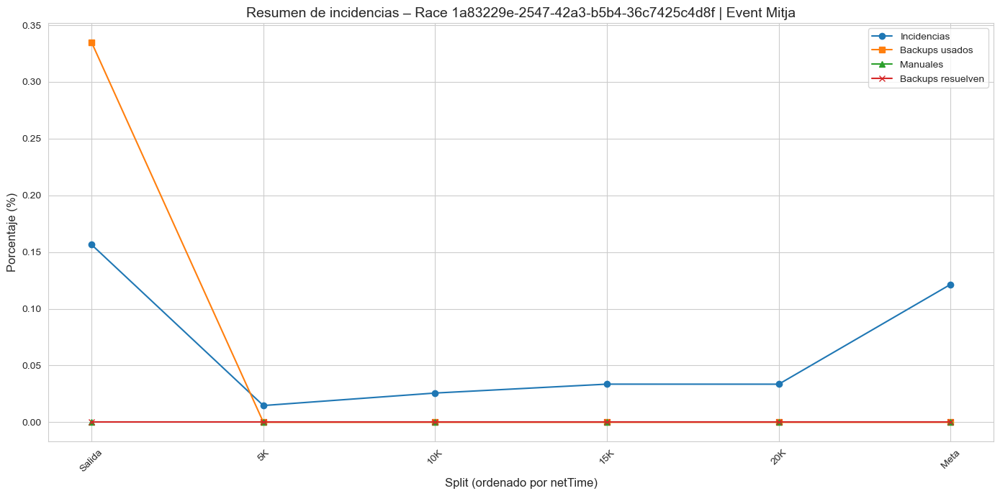

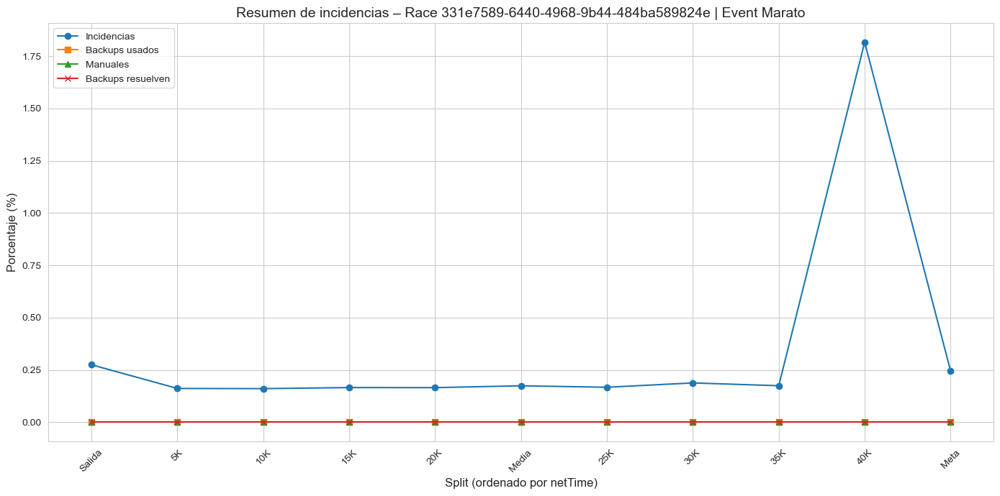

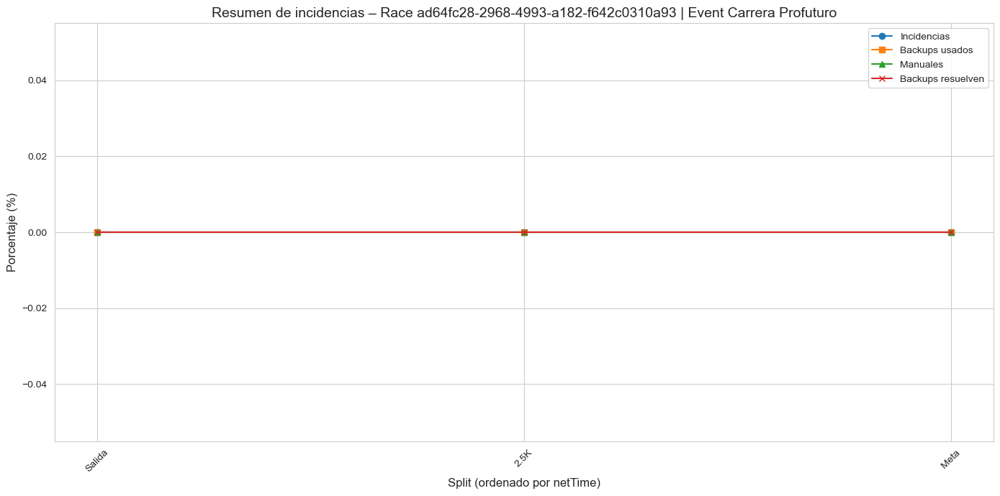

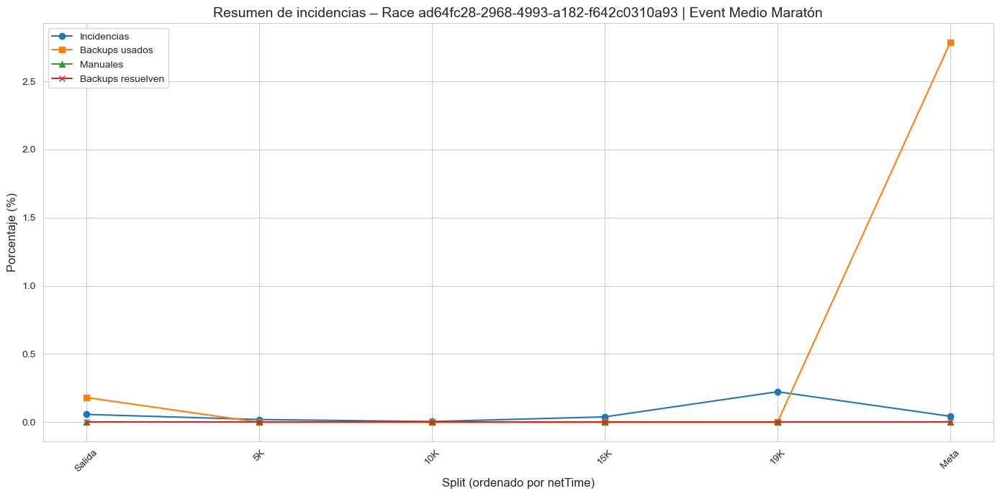

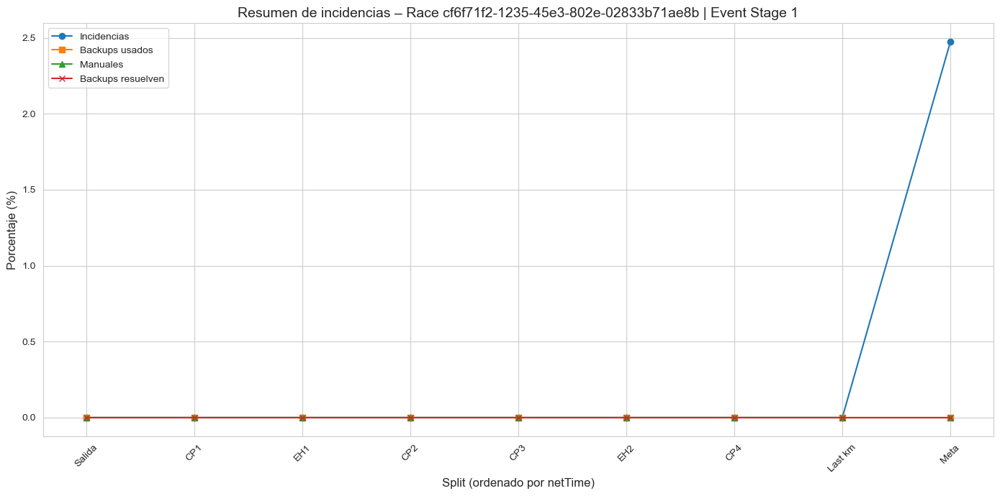

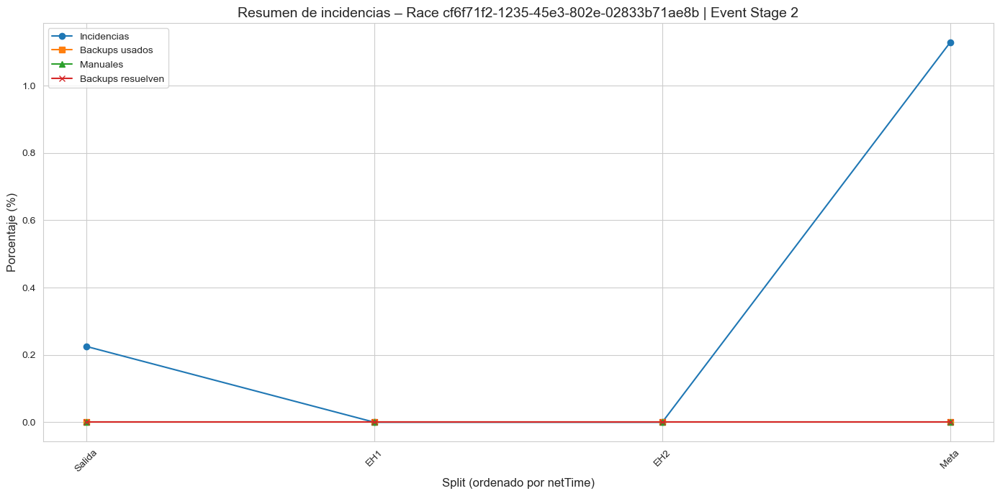

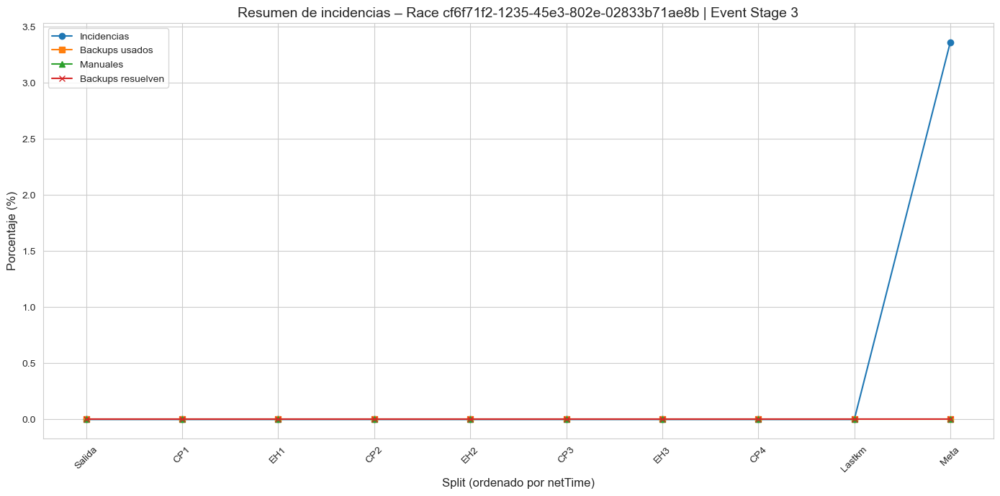

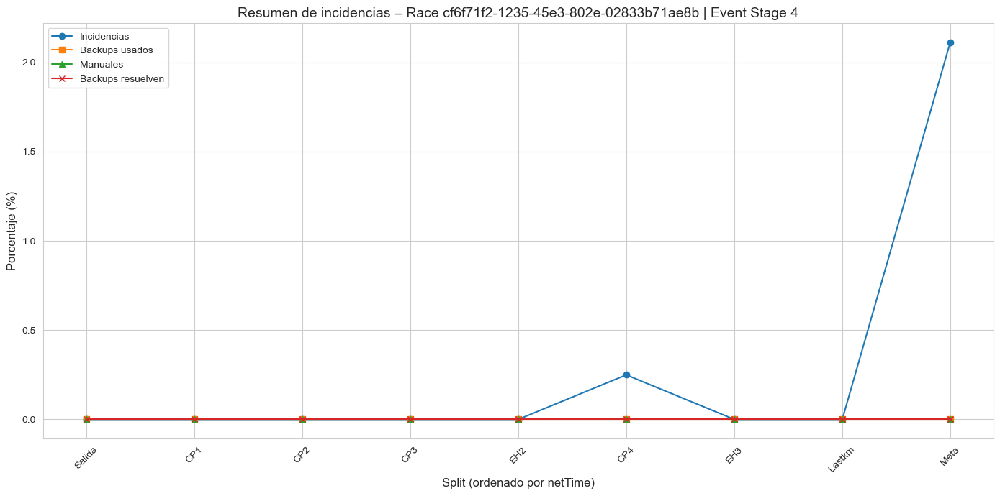

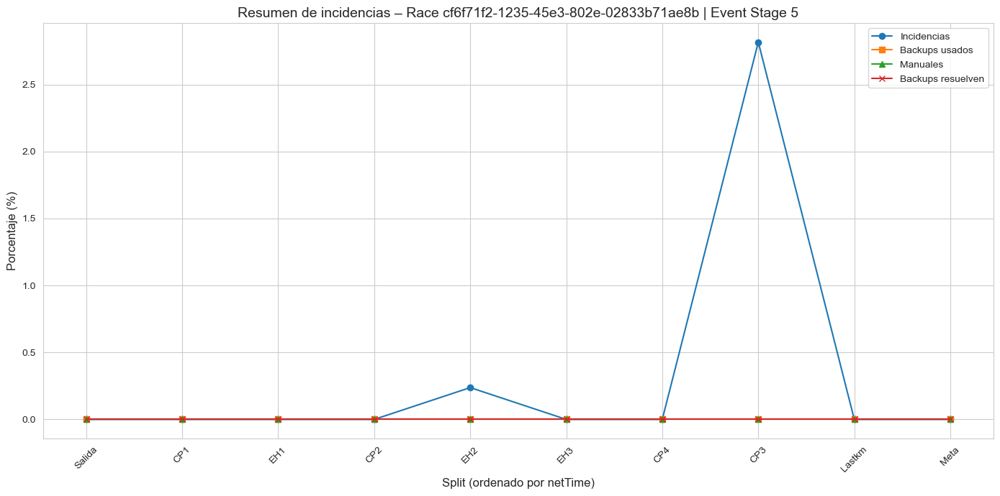

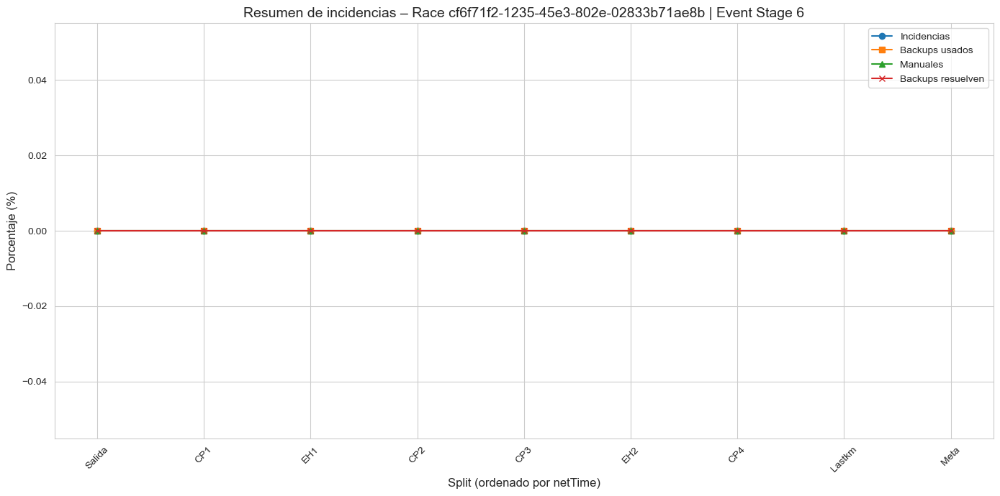

In [18]:
plot_incidence_by_race_event(incidence_summary, dfs['athletes_time_df'])

### Nivel issues 

Para los issues vamos a hacer transformaciones necesarias a los datos, pasando por crear columnas nuevas para identificar cuando ha sido el issue. Para ello sacamos los límites de cada carrera 

In [4]:
issues_df = dfs['issues_df']
issues_data_df = dfs['issues_data_df']
issues_events_df = dfs['issues_events_df']
issues_times_df = dfs['issues_times_df']

In [ ]:
race_filter = issues_df['race_id'] == '331e7589-6440-4968-9b44-484ba589824e'

issues_df.loc[race_filter, 'event_id'] = issues_df.loc[race_filter, 'event_id'].replace('Mitja', 'Marato')
issues_df.loc[race_filter, 'event_std'] = issues_df.loc[race_filter, 'event_std'].replace('media', 'maraton')

print(issues_df.loc[race_filter, ['race_id', 'event_id', 'event_std']].drop_duplicates())

                                     race_id       event_id      event_std
357150  331e7589-6440-4968-9b44-484ba589824e  independiente  independiente
357153  331e7589-6440-4968-9b44-484ba589824e         Marato        maraton


In [46]:
# Obtener combinaciones únicas
combinaciones = issues_df[['race_id', 'event_id', 'event_std']].drop_duplicates().reset_index(drop=True)

# Mostrar resultado
print(combinaciones)
print(f"\nTotal de combinaciones únicas: {len(combinaciones)}")

                                 race_id       event_id      event_std
0   1a83229e-2547-42a3-b5b4-36c7425c4d8f  independiente  independiente
1   1a83229e-2547-42a3-b5b4-36c7425c4d8f          Mitja          media
2   cf6f71f2-1235-45e3-802e-02833b71ae8b  independiente  independiente
3   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 1          stage
4   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 2          stage
5   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 3          stage
6   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 4          stage
7   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 5          stage
8   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 6          stage
9   ad64fc28-2968-4993-a182-f642c0310a93  independiente  independiente
10  ad64fc28-2968-4993-a182-f642c0310a93  Medio Maratón          media
11  331e7589-6440-4968-9b44-484ba589824e  independiente  independiente
12  331e7589-6440-4968-9b44-484ba589824e         Marato        maraton

Total

In [6]:
def get_event_time_ranges(df: pd.DataFrame, raw_col='rawTime'):
    """
    Obtiene para cada carrera y evento:
    - hora de inicio real (mínimo rawTime)
    - hora de finalización real (máximo rawTime)
    
    También añade un evento 'independiente' por carrera que abarca toda la carrera.
    """

    df = df.copy()
    df[raw_col] = pd.to_datetime(df[raw_col], errors='coerce')

    valid = df.dropna(subset=[raw_col])

    summary = (
        valid.groupby(['race_id', 'event_id'])
             .agg(
                 start_time=(raw_col, 'min'),
                 end_time=(raw_col, 'max'),
             )
             .reset_index()
    )

    independiente = (
        valid.groupby('race_id')
             .agg(
                 start_time=(raw_col, 'min'),
                 end_time=(raw_col, 'max')
             )
             .reset_index()
    )
    independiente['event_id'] = 'independiente'

    summary = pd.concat([summary, independiente], ignore_index=True)
    summary = summary.sort_values(['race_id', 'event_id'])

    return summary

event_time_ranges = get_event_time_ranges(dfs['athletes_time_df'], raw_col='rawTime')
print(event_time_ranges)

                                 race_id       event_id  \
0   1a83229e-2547-42a3-b5b4-36c7425c4d8f          Mitja   
9   1a83229e-2547-42a3-b5b4-36c7425c4d8f  independiente   
1   331e7589-6440-4968-9b44-484ba589824e         Marato   
10  331e7589-6440-4968-9b44-484ba589824e  independiente   
2   ad64fc28-2968-4993-a182-f642c0310a93  Medio Maratón   
11  ad64fc28-2968-4993-a182-f642c0310a93  independiente   
3   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 1   
4   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 2   
5   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 3   
6   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 4   
7   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 5   
8   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 6   
12  cf6f71f2-1235-45e3-802e-02833b71ae8b  independiente   

                start_time                end_time  
0  2025-02-16 07:16:41.474 2025-02-16 11:42:03.700  
9  2025-02-16 07:16:41.474 2025-02-16 11:42:03.700  
1  2025-03-16 

Clasificamos por fase de carrera, para poder discernir si un issue ha sido antes de la carrera, en la carrera o después

In [7]:
def assign_issue_race_phases_conditional(issues_df: pd.DataFrame, event_time_ranges: pd.DataFrame):
    """
    Asigna la fase temporal a cada incidencia en issues_df según los rangos de evento.
    Si event_id == 'independiente', se usa el rango total de la carrera.
    """
    df = issues_df.copy()
    df['datetime'] = pd.to_datetime(df['time'], unit='ms', errors='coerce')
    
    race_time_ranges = event_time_ranges.groupby('race_id').agg(
        race_start=('start_time', 'min'),
        race_end=('end_time', 'max')
    ).reset_index()
    
    df = df.merge(
        event_time_ranges[['race_id', 'event_id', 'start_time', 'end_time']],
        on=['race_id', 'event_id'],
        how='left'
    )
    
    df = df.merge(race_time_ranges, on='race_id', how='left')
    
    def fase(row):
        if pd.isna(row['datetime']):
            return "desconocido"
        if row['event_id'] == 'independiente':
            start = row['race_start']
            end = row['race_end']
        else:
            start = row['start_time']
            end = row['end_time']
        
        if row['datetime'] < start:
            return "pre-carrera"
        elif start <= row['datetime'] <= end:
            return "en carrera"
        else:
            return "post-carrera"
    
    df['fase_temporal'] = df.apply(fase, axis=1)
    
    df = df.drop(columns=['start_time', 'end_time', 'race_start', 'race_end'])
    
    return df

issues_df = assign_issue_race_phases_conditional(issues_df, event_time_ranges)
print(issues_df[['race_id','athlete_id','issue_id','datetime','fase_temporal']].head())

                                race_id athlete_id  \
0  1a83229e-2547-42a3-b5b4-36c7425c4d8f   L6554352   
1  1a83229e-2547-42a3-b5b4-36c7425c4d8f   L6554352   
2  1a83229e-2547-42a3-b5b4-36c7425c4d8f   L6554352   
3  1a83229e-2547-42a3-b5b4-36c7425c4d8f   L6554352   
4  1a83229e-2547-42a3-b5b4-36c7425c4d8f   L6554352   

                               issue_id                datetime fase_temporal  
0  af4215f0-e856-11ef-aee0-f3683f511a40 2025-02-11 09:00:47.695   pre-carrera  
1  c7e98b10-ebee-11ef-97b0-07dcca7a2d93 2025-02-15 22:47:08.006   pre-carrera  
2  8da78860-ebf0-11ef-87e3-356c9bdcf2f6 2025-02-15 22:59:49.649   pre-carrera  
3  edf66160-ec3a-11ef-af17-efadb2d90a76 2025-02-16 07:52:11.638    en carrera  
4  cb464900-ec4e-11ef-9fcb-9397285a81ad 2025-02-16 10:14:23.376    en carrera  


#### Tipos de errores 

Vamos a comprobar el número de errores de cada tipo


📊 Distribución de tipos de incidencias - Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f:
type
changeRanking     111979
importAthletes     61931
changeStatus         645
importSwap           281
athleteTime          116
athleteSwap           59
Name: count, dtype: int64


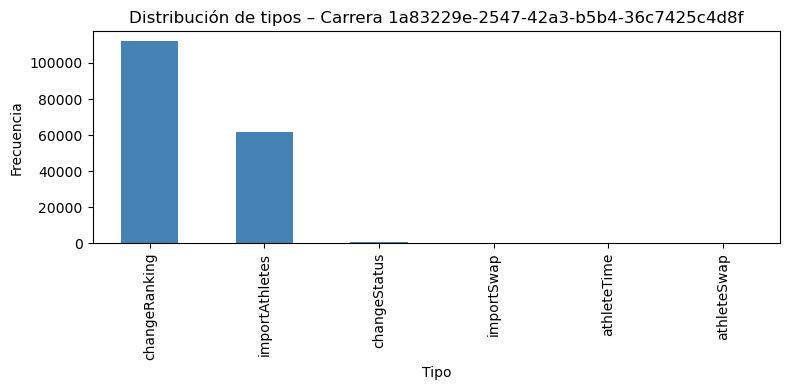

Conteo diario de incidencias - Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f:
datetime
2025-02-11    36596
2025-02-12        0
2025-02-13        4
2025-02-14       15
2025-02-15    62271
2025-02-16    75511
2025-02-17       35
2025-02-18      140
2025-02-19       43
2025-02-20        6
2025-02-21        1
2025-02-22        0
2025-02-23        0
2025-02-24        0
2025-02-25        1
2025-02-26        0
2025-02-27        0
2025-02-28      105
2025-03-01        0
2025-03-02        1
2025-03-03        0
2025-03-04      183
2025-03-05        0
2025-03-06        0
2025-03-07        0
2025-03-08        0
2025-03-09        0
2025-03-10        0
2025-03-11       81
2025-03-12        0
2025-03-13       17
2025-03-14        0
2025-03-15        0
2025-03-16        0
2025-03-17        0
2025-03-18        0
2025-03-19        0
2025-03-20        0
2025-03-21        0
2025-03-22        0
2025-03-23        0
2025-03-24        0
2025-03-25        0
2025-03-26        0
2025-03-27        0
2025-03-28    

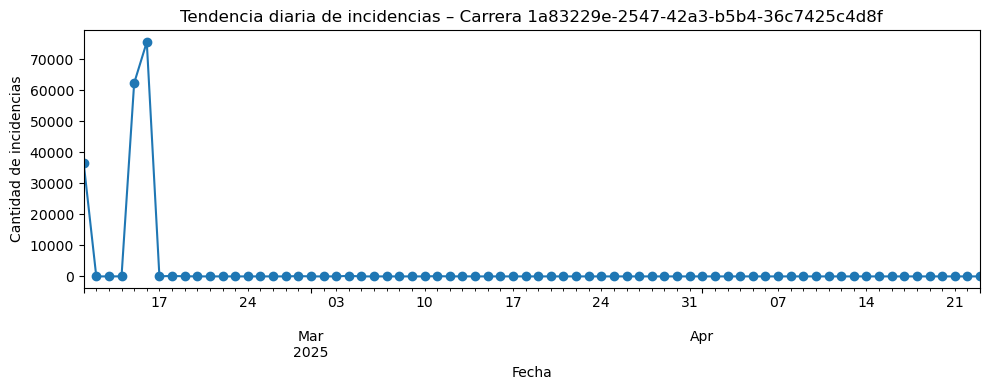


📊 Distribución de tipos de incidencias - Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b:
type
changeRanking    4522
athleteTime        57
changeStatus       46
athleteSwap        18
Name: count, dtype: int64


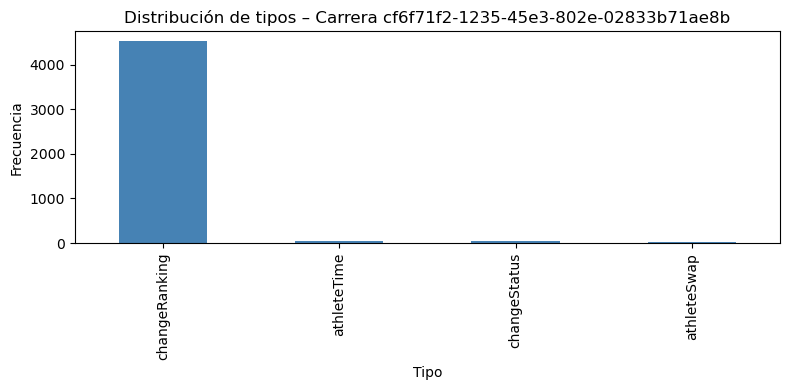

Conteo diario de incidencias - Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b:
datetime
2025-04-25       4
2025-04-26       0
2025-04-27       0
2025-04-28     191
2025-04-29     268
2025-04-30      59
2025-05-01     648
2025-05-02    1052
2025-05-03     499
2025-05-04     514
2025-05-05     492
2025-05-06     916
Freq: D, Name: id, dtype: int64


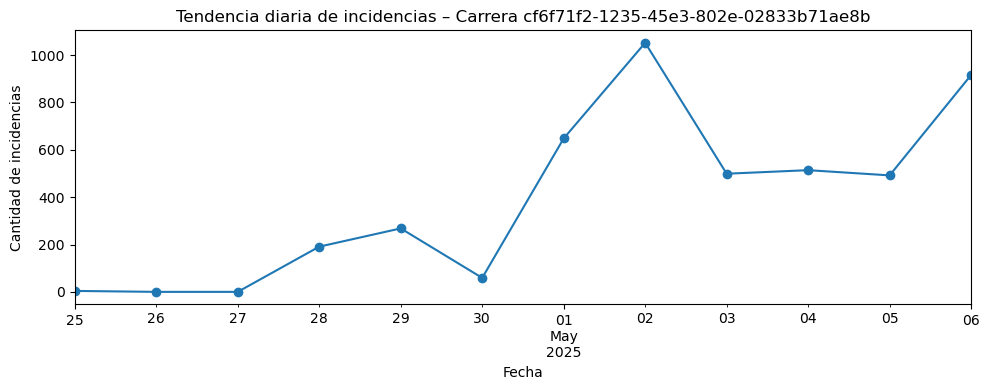


📊 Distribución de tipos de incidencias - Carrera ad64fc28-2968-4993-a182-f642c0310a93:
type
changeRanking    176747
changeStatus        663
athleteTime          77
athleteSwap           9
Name: count, dtype: int64


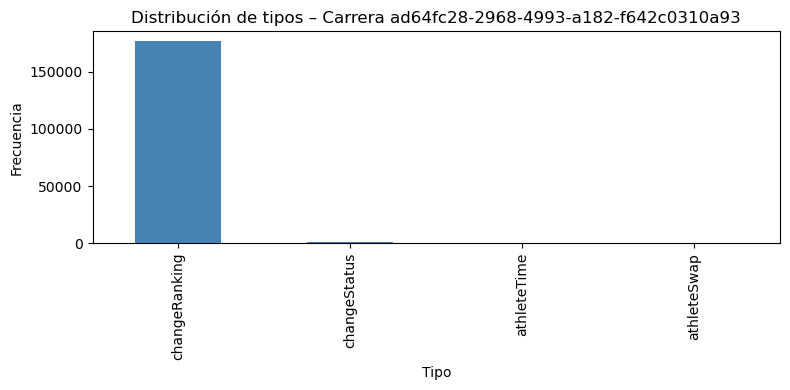

Conteo diario de incidencias - Carrera ad64fc28-2968-4993-a182-f642c0310a93:
datetime
2025-03-31    24582
2025-04-01    19450
2025-04-02       22
2025-04-03    38707
2025-04-04    34267
2025-04-05    12115
2025-04-06    48199
2025-04-07        1
2025-04-08       27
2025-04-09       21
2025-04-10        7
2025-04-11       94
2025-04-12        0
2025-04-13        0
2025-04-14        2
2025-04-15        1
2025-04-16        0
2025-04-17        0
2025-04-18        0
2025-04-19        0
2025-04-20        0
2025-04-21        0
2025-04-22        1
Freq: D, Name: id, dtype: int64


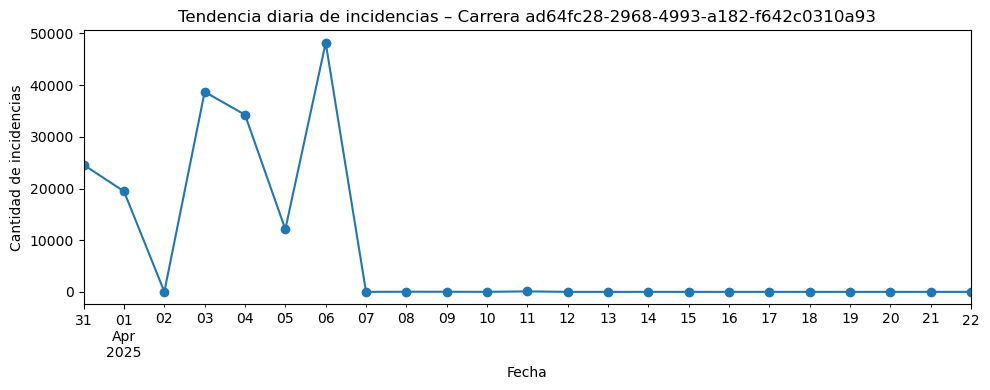


📊 Distribución de tipos de incidencias - Carrera 331e7589-6440-4968-9b44-484ba589824e:
type
changeRanking     111979
importAthletes     61931
changeStatus         645
importSwap           281
athleteTime          116
athleteSwap           59
Name: count, dtype: int64


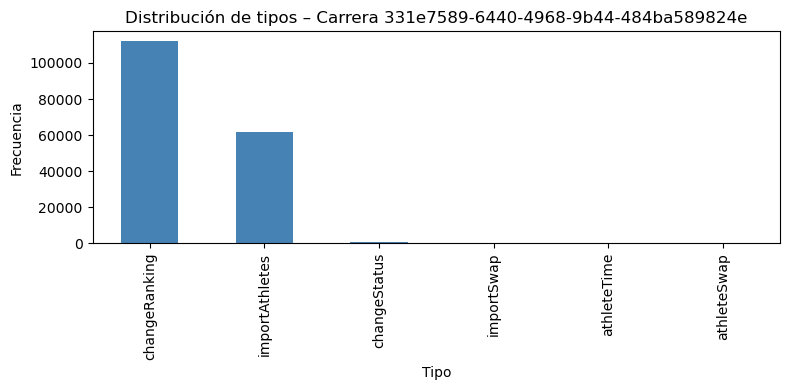

Conteo diario de incidencias - Carrera 331e7589-6440-4968-9b44-484ba589824e:
datetime
2025-02-11    36596
2025-02-12        0
2025-02-13        4
2025-02-14       15
2025-02-15    62271
2025-02-16    75511
2025-02-17       35
2025-02-18      140
2025-02-19       43
2025-02-20        6
2025-02-21        1
2025-02-22        0
2025-02-23        0
2025-02-24        0
2025-02-25        1
2025-02-26        0
2025-02-27        0
2025-02-28      105
2025-03-01        0
2025-03-02        1
2025-03-03        0
2025-03-04      183
2025-03-05        0
2025-03-06        0
2025-03-07        0
2025-03-08        0
2025-03-09        0
2025-03-10        0
2025-03-11       81
2025-03-12        0
2025-03-13       17
2025-03-14        0
2025-03-15        0
2025-03-16        0
2025-03-17        0
2025-03-18        0
2025-03-19        0
2025-03-20        0
2025-03-21        0
2025-03-22        0
2025-03-23        0
2025-03-24        0
2025-03-25        0
2025-03-26        0
2025-03-27        0
2025-03-28    

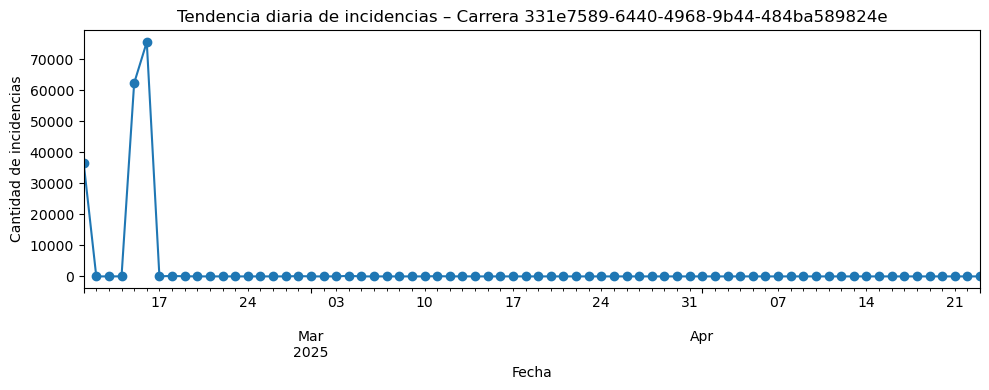


📊 Distribución de tipos de incidencias - Event Std independiente:
type
changeRanking     226227
importAthletes    123862
changeStatus        1027
importSwap           562
athleteSwap          138
Name: count, dtype: int64


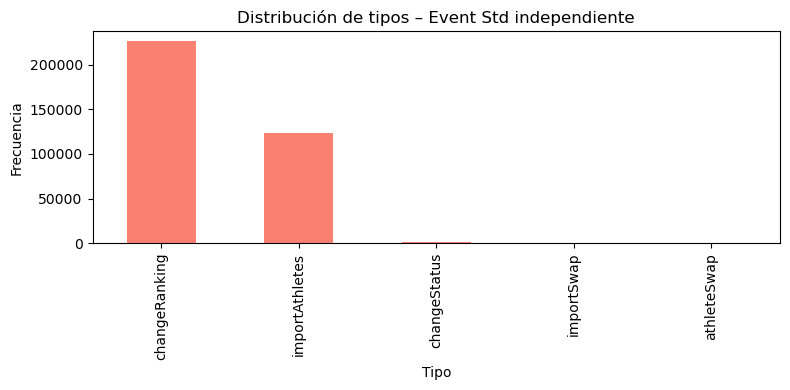

Conteo diario de incidencias - Event Std independiente:
datetime
2025-02-11     73192
2025-02-12         0
2025-02-13         8
2025-02-14        30
2025-02-15    124542
2025-02-16     43188
2025-02-17        48
2025-02-18       228
2025-02-19        42
2025-02-20         0
2025-02-21         0
2025-02-22         0
2025-02-23         0
2025-02-24         0
2025-02-25         2
2025-02-26         0
2025-02-27         0
2025-02-28       210
2025-03-01         0
2025-03-02         2
2025-03-03         0
2025-03-04       366
2025-03-05         0
2025-03-06         0
2025-03-07         0
2025-03-08         0
2025-03-09         0
2025-03-10         0
2025-03-11       162
2025-03-12         0
2025-03-13        34
2025-03-14         0
2025-03-15         0
2025-03-16         0
2025-03-17         0
2025-03-18         0
2025-03-19         0
2025-03-20         0
2025-03-21         0
2025-03-22         0
2025-03-23         0
2025-03-24         0
2025-03-25         0
2025-03-26         0
2025-03-27 

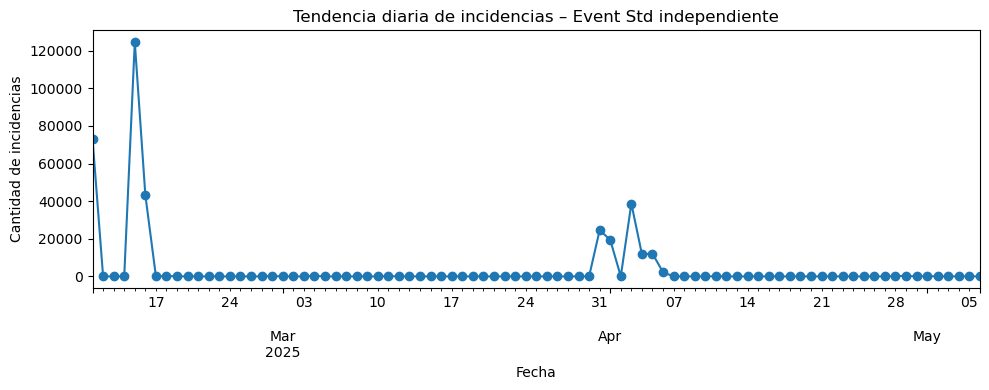


📊 Distribución de tipos de incidencias - Event Std media:
type
changeRanking    121792
changeStatus        537
athleteTime         193
Name: count, dtype: int64


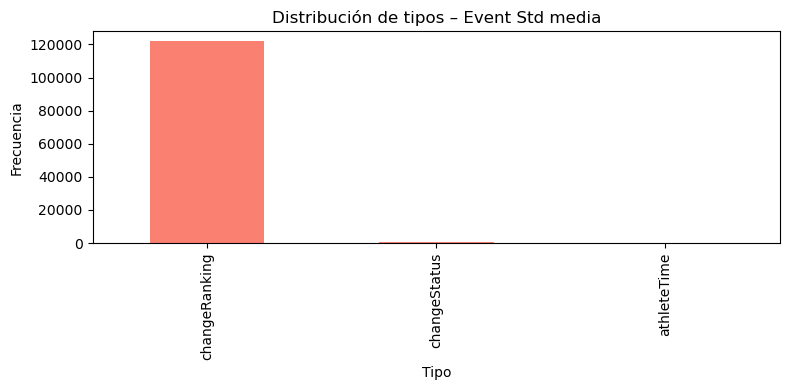

Conteo diario de incidencias - Event Std media:
datetime
2025-02-16    53917
2025-02-17       11
2025-02-18       26
2025-02-19       22
2025-02-20        6
2025-02-21        1
2025-02-22        0
2025-02-23        0
2025-02-24        0
2025-02-25        0
2025-02-26        0
2025-02-27        0
2025-02-28        0
2025-03-01        0
2025-03-02        0
2025-03-03        0
2025-03-04        0
2025-03-05        0
2025-03-06        0
2025-03-07        0
2025-03-08        0
2025-03-09        0
2025-03-10        0
2025-03-11        0
2025-03-12        0
2025-03-13        0
2025-03-14        0
2025-03-15        0
2025-03-16        0
2025-03-17        0
2025-03-18        0
2025-03-19        0
2025-03-20        0
2025-03-21        0
2025-03-22        0
2025-03-23        0
2025-03-24        0
2025-03-25        0
2025-03-26        0
2025-03-27        0
2025-03-28        0
2025-03-29        0
2025-03-30        0
2025-03-31        0
2025-04-01       24
2025-04-02        0
2025-04-03        2
202

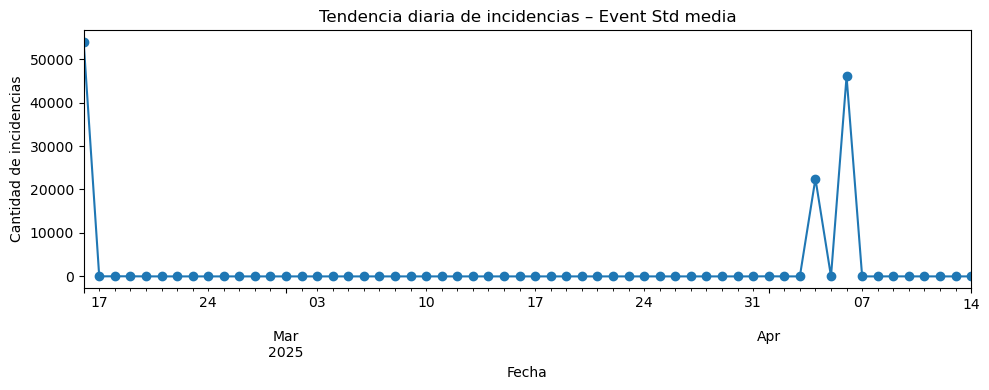


📊 Distribución de tipos de incidencias - Event Std stage:
type
changeRanking    3775
athleteTime        57
athleteSwap         7
changeStatus        1
Name: count, dtype: int64


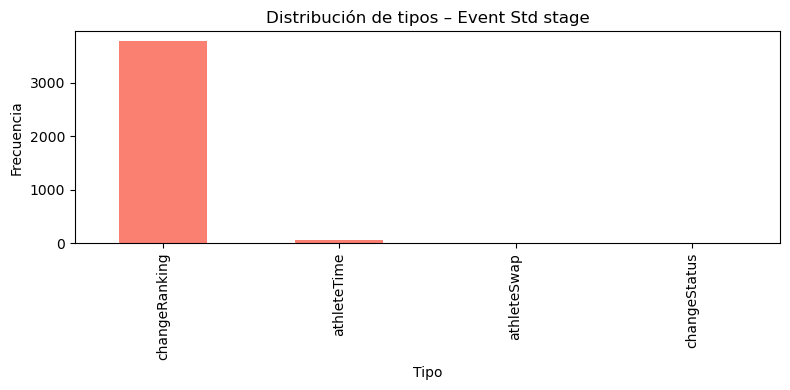

Conteo diario de incidencias - Event Std stage:
datetime
2025-05-01     468
2025-05-02    1045
2025-05-03     473
2025-05-04     475
2025-05-05     466
2025-05-06     913
Freq: D, Name: id, dtype: int64


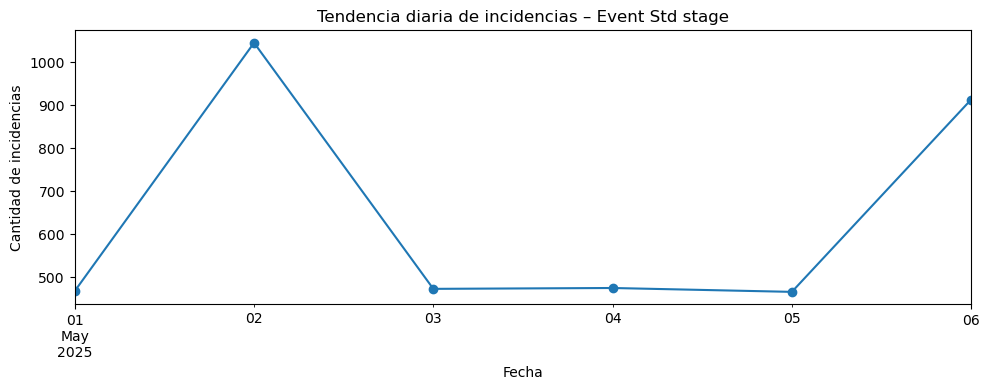


📊 Distribución de tipos de incidencias - Event Std maraton:
type
changeRanking    53433
changeStatus       434
athleteTime        116
Name: count, dtype: int64


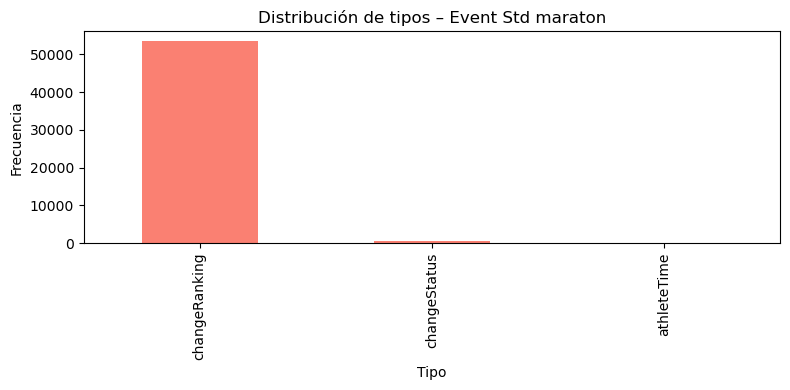

Conteo diario de incidencias - Event Std maraton:
datetime
2025-02-16    53917
2025-02-17       11
2025-02-18       26
2025-02-19       22
2025-02-20        6
2025-02-21        1
Freq: D, Name: id, dtype: int64


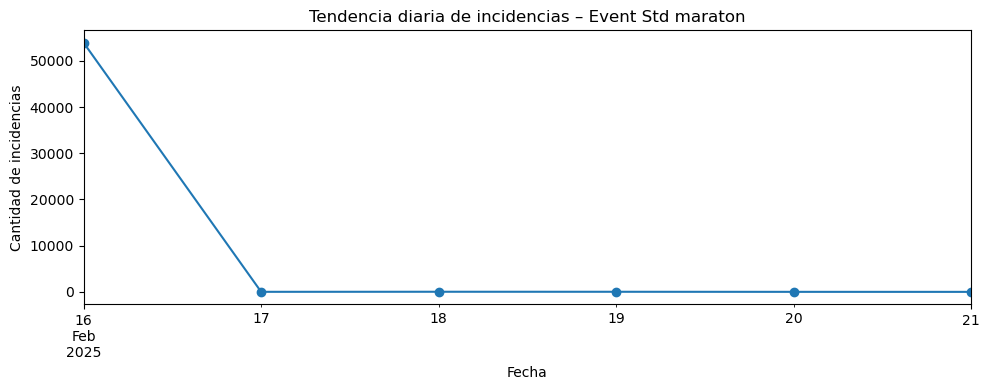

In [ ]:
issues_df['datetime'] = pd.to_datetime(issues_df['time'], unit='ms', errors='coerce')

for race in issues_df['race_id'].dropna().unique():
    df_race = issues_df[issues_df['race_id'] == race]

    type_counts = df_race['type'].value_counts().sort_values(ascending=False)
    print(f"\nDistribución de tipos de incidencias - Carrera {race}:")
    print(type_counts)

    plt.figure(figsize=(8,4))
    type_counts.plot(kind='bar', color='steelblue')
    plt.title(f"Distribución de tipos – Carrera {race}")
    plt.xlabel("Tipo")
    plt.ylabel("Frecuencia")
    plt.tight_layout()
    plt.show()

    incidencias_diarias = (
        df_race
        .set_index("datetime")['id']
        .resample("1D")
        .count()
    )
    print(f"Conteo diario de incidencias - Carrera {race}:")
    print(incidencias_diarias)

    plt.figure(figsize=(10,4))
    incidencias_diarias.plot(marker='o')
    plt.title(f"Tendencia diaria de incidencias – Carrera {race}")
    plt.xlabel("Fecha")
    plt.ylabel("Cantidad de incidencias")
    plt.tight_layout()
    plt.show()


for event_std in issues_df['event_std'].dropna().unique():
    df_event = issues_df[issues_df['event_std'] == event_std]

    type_counts = df_event['type'].value_counts().sort_values(ascending=False)
    print(f"\nDistribución de tipos de incidencias - Event Std {event_std}:")
    print(type_counts)

    plt.figure(figsize=(8,4))
    type_counts.plot(kind='bar', color='salmon')
    plt.title(f"Distribución de tipos – Event Std {event_std}")
    plt.xlabel("Tipo")
    plt.ylabel("Frecuencia")
    plt.tight_layout()
    plt.show()

    incidencias_diarias = (
        df_event
        .set_index("datetime")['id']
        .resample("1D")
        .count()
    )
    print(f"Conteo diario de incidencias - Event Std {event_std}:")
    print(incidencias_diarias)

    plt.figure(figsize=(10,4))
    incidencias_diarias.plot(marker='o')
    plt.title(f"Tendencia diaria de incidencias – Event Std {event_std}")
    plt.xlabel("Fecha")
    plt.ylabel("Cantidad de incidencias")
    plt.tight_layout()
    plt.show()

- En todas las carreras y eventos, changeRanking es con mucho el tipo de incidencia más frecuente. La mayoría de incidencias corresponden a cambios en el ranking de los atletas y cambios generales, probablemente reflejando ajustes automáticos o correcciones durante la carrera.

- Presencia de importaciones, algunas carreras tienen cargas de datos o ajustes de atletas importados. No todas las carreras muestran este tipo de incidencias.

- changeStatus es relativamente bajo, excepto en eventos con muchos ajustes.

- athleteTime y athleteSwap son minoritarios, la mayoría por debajo de 500 incidencias.

- Event Std independiente concentran la mayor cantidad de incidencias, lo que refleja que al agrupar todos los eventos de la carrera (“independiente”), los números se acumulan.

- Event Std stage tiene muy pocas incidencias, lo que indica que los eventos por etapas generan menos cambios o se registran de forma más estable.


📊 Distribución por fase temporal - Carrera 1a83229e-2547-42a3-b5b4-36c7425c4d8f:
fase_temporal
pre-carrera     98895
en carrera      74892
post-carrera     1224
Name: count, dtype: int64


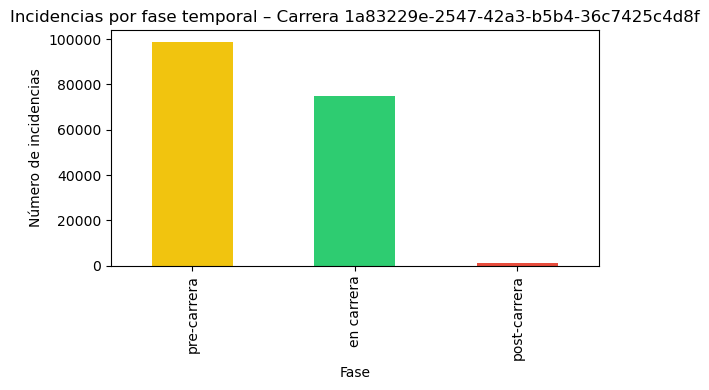


📊 Distribución por fase temporal - Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b:
fase_temporal
en carrera      4101
pre-carrera      532
post-carrera      10
Name: count, dtype: int64


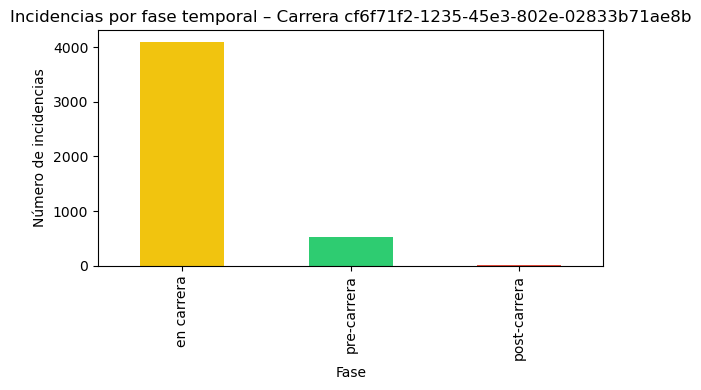


📊 Distribución por fase temporal - Carrera ad64fc28-2968-4993-a182-f642c0310a93:
fase_temporal
pre-carrera     129168
en carrera       47863
post-carrera       465
Name: count, dtype: int64


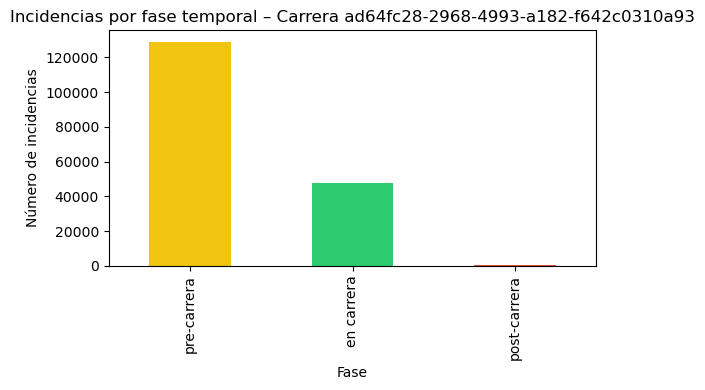


📊 Distribución por fase temporal - Carrera 331e7589-6440-4968-9b44-484ba589824e:
fase_temporal
pre-carrera     175010
post-carrera         1
Name: count, dtype: int64


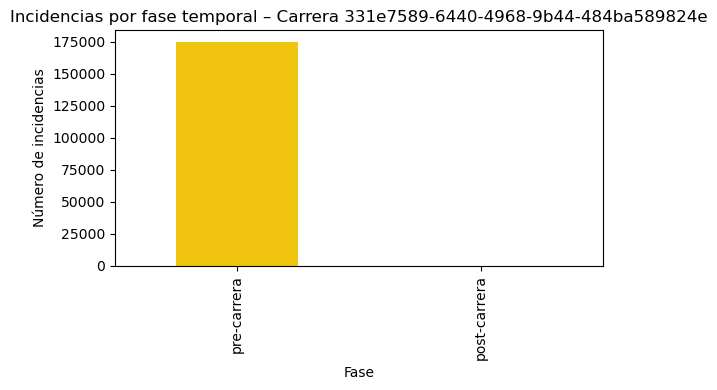


📊 Distribución por fase temporal - Event Std independiente:
fase_temporal
pre-carrera     327116
en carrera       23600
post-carrera      1100
Name: count, dtype: int64


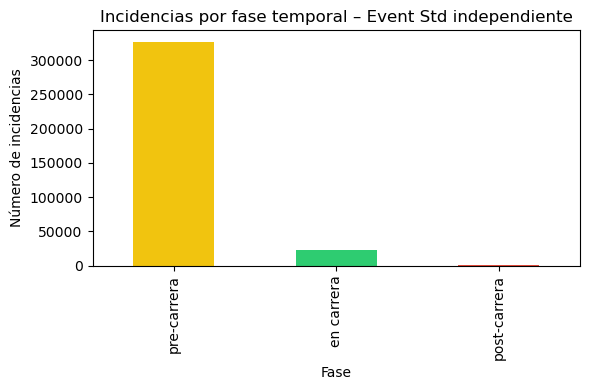


📊 Distribución por fase temporal - Event Std media:
fase_temporal
en carrera      99426
pre-carrera     22506
post-carrera      590
Name: count, dtype: int64


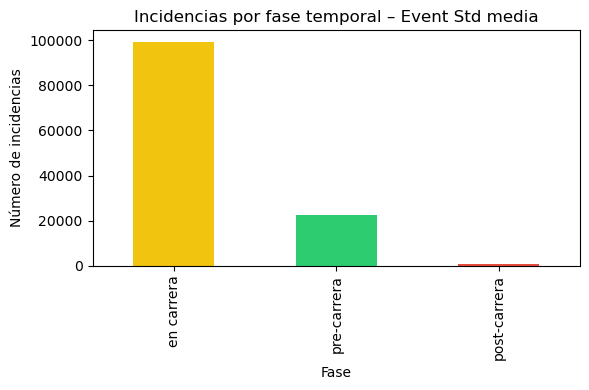


📊 Distribución por fase temporal - Event Std stage:
fase_temporal
en carrera      3830
post-carrera      10
Name: count, dtype: int64


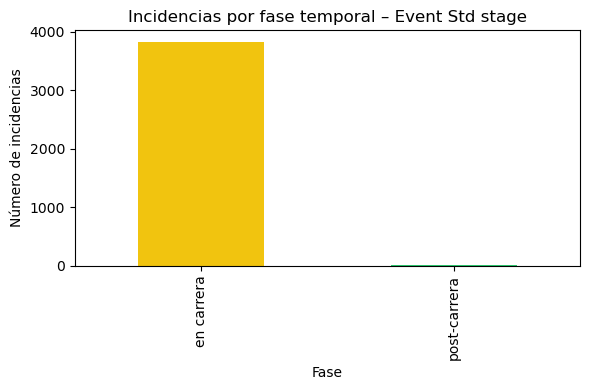


📊 Distribución por fase temporal - Event Std maraton:
fase_temporal
pre-carrera    53983
Name: count, dtype: int64


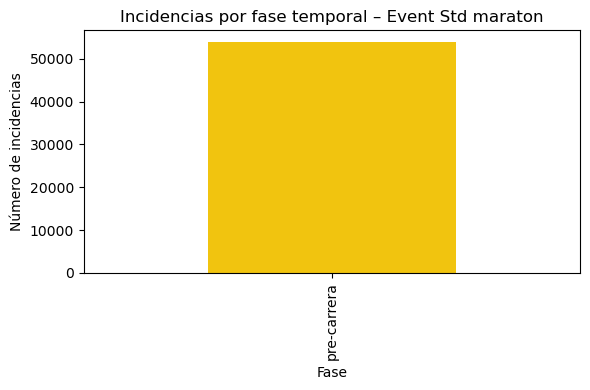

In [50]:
for race in issues_df['race_id'].dropna().unique():
    df_race = issues_df[issues_df['race_id'] == race]

    fase_counts = df_race['fase_temporal'].value_counts()
    print(f"\n📊 Distribución por fase temporal - Carrera {race}:")
    print(fase_counts)

    plt.figure(figsize=(6,4))
    fase_counts.plot(kind="bar", color=["#F1C40F","#2ECC71","#E74C3C"])
    plt.title(f"Incidencias por fase temporal – Carrera {race}")
    plt.xlabel("Fase")
    plt.ylabel("Número de incidencias")
    plt.tight_layout()
    plt.show()

for event_std in issues_df['event_std'].dropna().unique():
    df_event = issues_df[issues_df['event_std'] == event_std]

    fase_counts = df_event['fase_temporal'].value_counts()
    print(f"\n📊 Distribución por fase temporal - Event Std {event_std}:")
    print(fase_counts)

    plt.figure(figsize=(6,4))
    fase_counts.plot(kind="bar", color=["#F1C40F","#2ECC71","#E74C3C"])
    plt.title(f"Incidencias por fase temporal – Event Std {event_std}")
    plt.xlabel("Fase")
    plt.ylabel("Número de incidencias")
    plt.tight_layout()
    plt.show()

- Predominio de incidencias pre-carrera en algunas carreras, gran parte de las incidencias ocurre antes de que inicie la carrera, probablemente ajustes masivos de datos, importaciones...

- En ciertos eventos, hay muchas incidencias después de la carrera, posiblemente correcciones de tiempos, swaps o ajustes finales de ranking.

- Incidencias en carrera predominan en ciertos eventos, probablemente relacionadas con cambios de ranking dinámicos o ajustes de tiempo en tiempo real.

- Al sumar todos los eventos de la carrera (“independiente”), la mayoría de incidencias se concentran antes de la carrera, lo que refleja las cargas masivas de datos previas al inicio. 

Podemos verlo también en forma de mapa de calor

#### Mapa de calor: incidencia / fase temporal

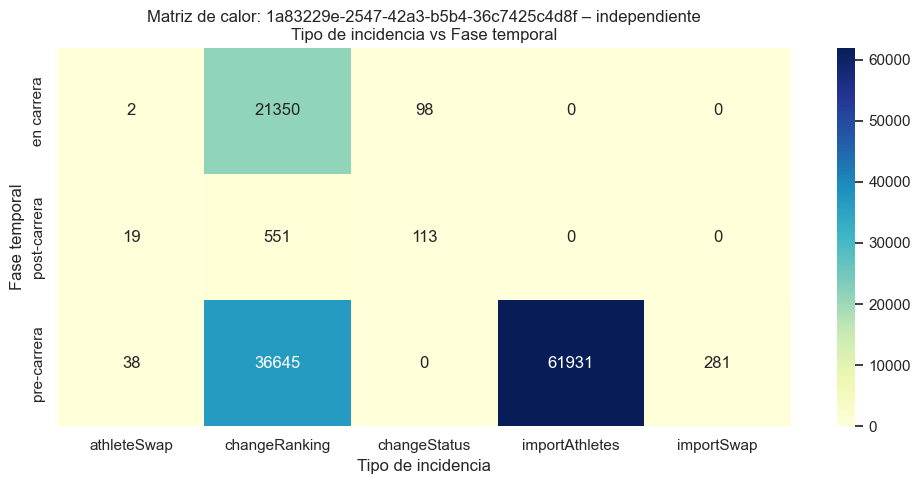

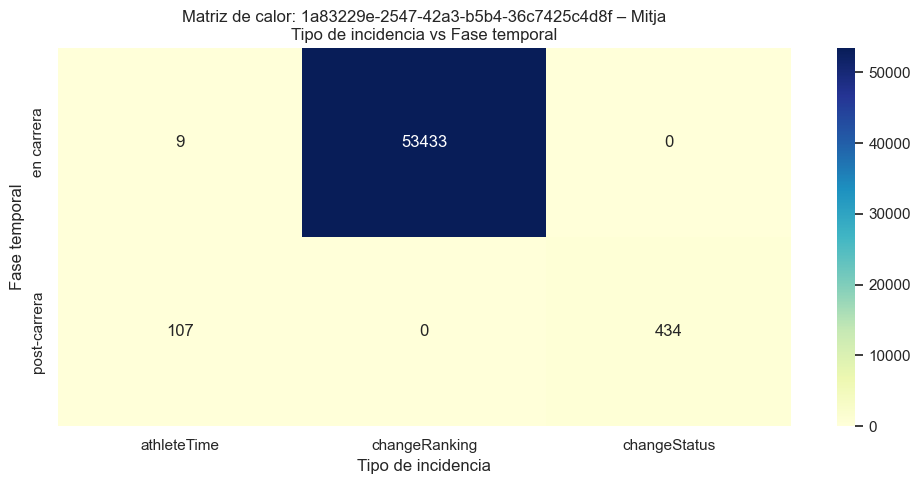

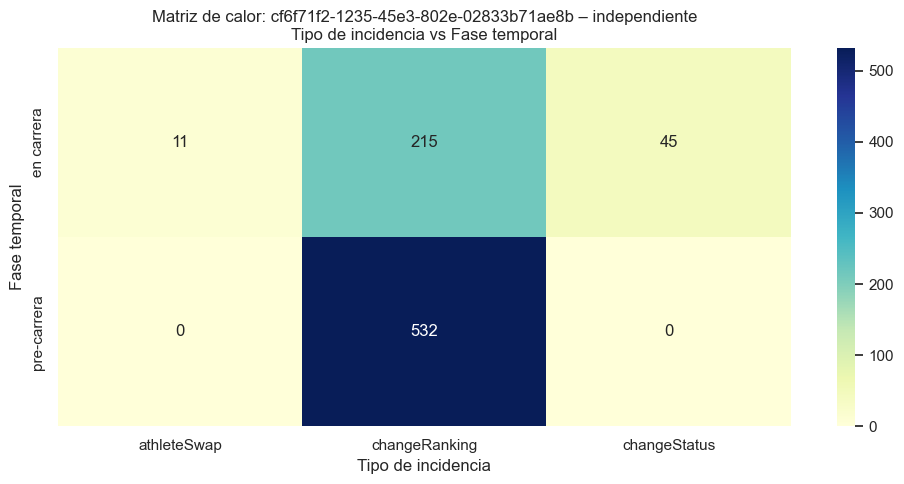

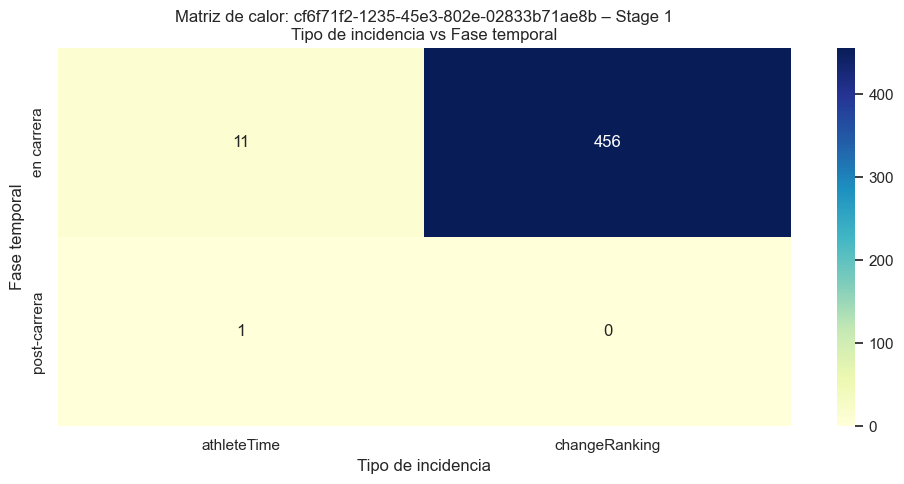

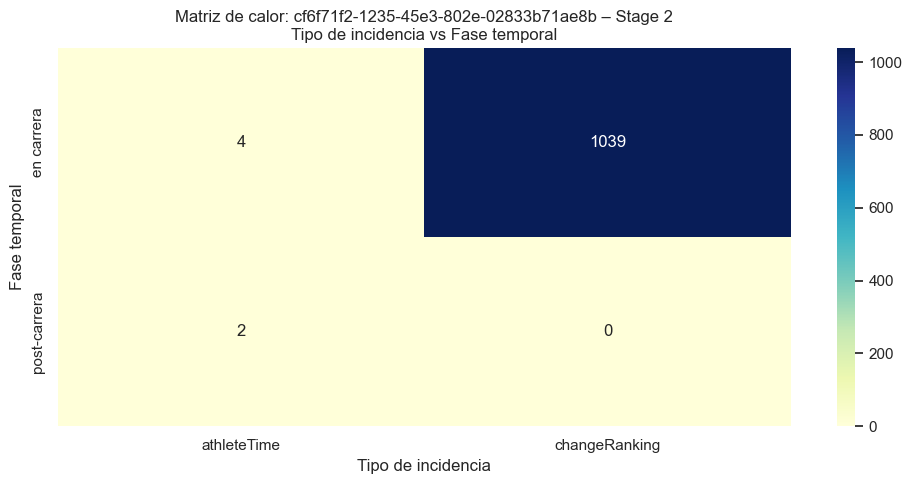

...

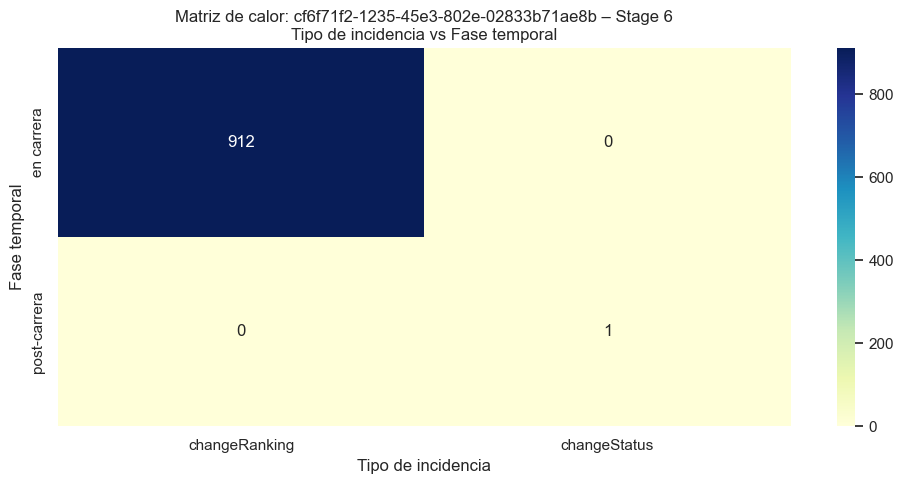

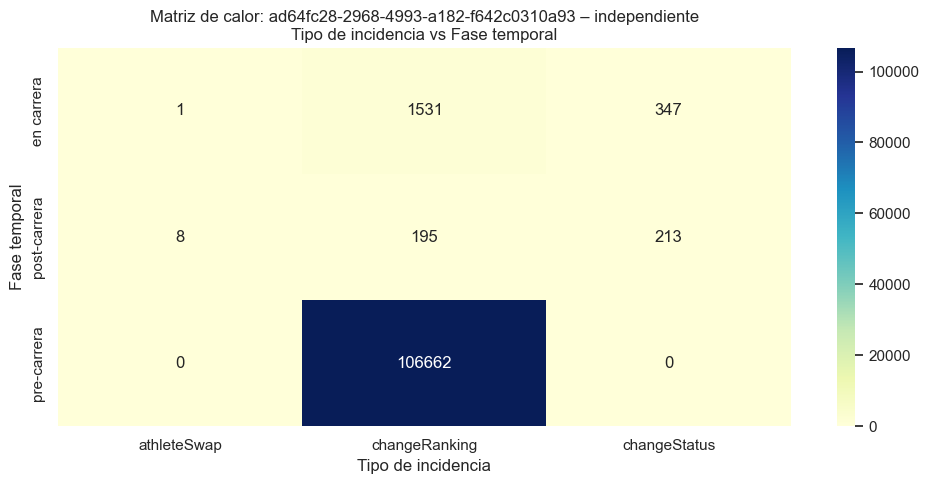

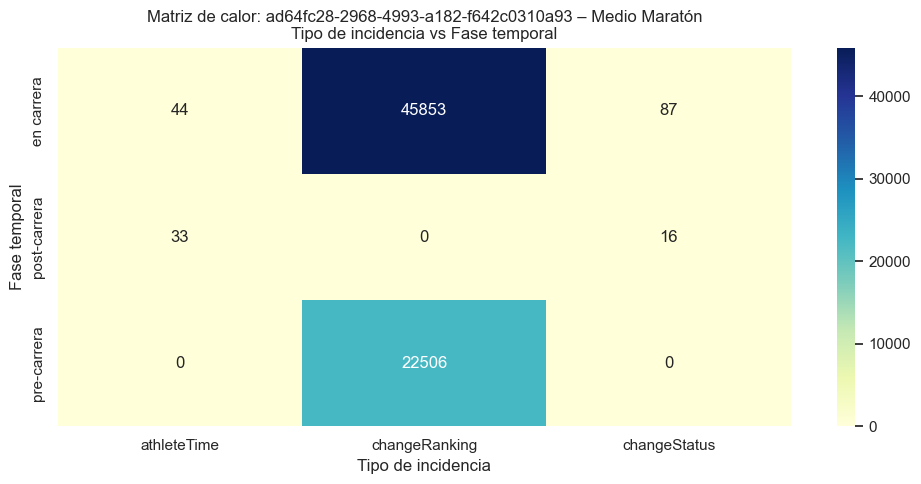

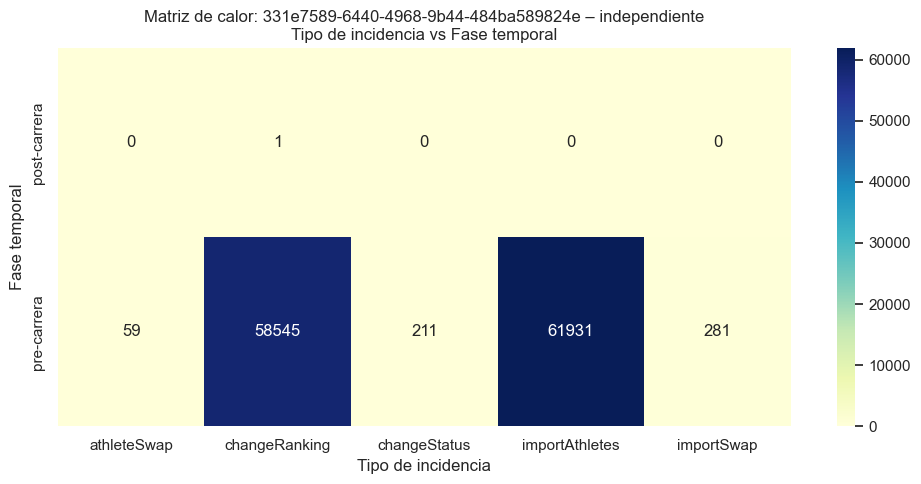

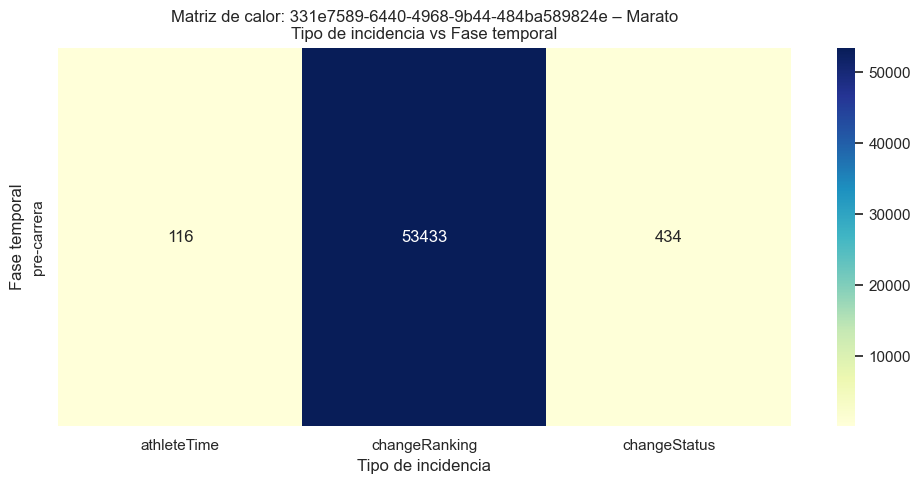

In [51]:
sns.set(style="whitegrid")

for race in issues_df['race_id'].dropna().unique():
    df_race = issues_df[issues_df['race_id'] == race]
    
    for event in df_race['event_id'].dropna().unique():
        df_event = df_race[df_race['event_id'] == event]
        
        pivot = pd.crosstab(df_event['fase_temporal'], df_event['type'])
        
        if pivot.empty:
            continue
        
        plt.figure(figsize=(10,5))
        sns.heatmap(pivot, annot=True, fmt="d", cmap="YlGnBu")
        plt.title(f"Matriz de calor: {race} – {event}\nTipo de incidencia vs Fase temporal")
        plt.xlabel("Tipo de incidencia")
        plt.ylabel("Fase temporal")
        plt.tight_layout()
        plt.show()

Vemos una predominancia clara de changeRanking, teniendo en cuenta que son eventos generales para cada carrera.  

#### Dataframe de estudio

In [31]:
num_ids_unicos = issues_df['issue_id'].nunique()
total_ids = len(issues_df)

print(f"Total de filas en issues_df: {total_ids}")
print(f"Número de ids únicos: {num_ids_unicos}")

num_duplicados = total_ids - num_ids_unicos
print(f"Número de ids duplicados: {num_duplicados}")

Total de filas en issues_df: 532161
Número de ids únicos: 35595
Número de ids duplicados: 496566


In [32]:
issues_df['race_id'].unique()

array(['1a83229e-2547-42a3-b5b4-36c7425c4d8f',
       'cf6f71f2-1235-45e3-802e-02833b71ae8b',
       'ad64fc28-2968-4993-a182-f642c0310a93',
       '331e7589-6440-4968-9b44-484ba589824e'], dtype=object)

Vamos a crear un datfarame nuevo para tener un estudio del mismo más sencillo

In [8]:
import pandas as pd

IA = issues_df[['issue_id', 'type', 'datetime', 'fase_temporal', 'priority', 
                'race_id', 'event_id', 'event_std', 'collection']]

athletes_info = issues_df.groupby('issue_id')['athlete_id'].agg(list).reset_index()
athletes_info['num_afectados'] = athletes_info['athlete_id'].apply(len)

athletes_info['athletes_afectados_str'] = athletes_info['athlete_id'].apply(
    lambda x: ", ".join(str(a) for a in x)
)

athletes_info = athletes_info.drop(columns=['athlete_id'])
IA = IA.merge(athletes_info, on='issue_id', how='left')

data_cols = [col for col in issues_data_df.columns if col.startswith('data_')]
events_cols = [col for col in issues_events_df.columns if col.startswith('data_events_')]

issues_data_grouped = issues_data_df[['issue_id'] + data_cols].groupby('issue_id').first().reset_index()
events_grouped = issues_events_df[['issue_id'] + events_cols].groupby('issue_id').first().reset_index()

IA = IA.merge(issues_data_grouped, on='issue_id', how='left')
IA = IA.merge(events_grouped, on='issue_id', how='left')

IA = IA.drop_duplicates(subset=['issue_id','race_id']).reset_index(drop=True)

print(IA.columns)


Index(['issue_id', 'type', 'datetime', 'fase_temporal', 'priority', 'race_id',
       'event_id', 'event_std', 'collection', 'num_afectados',
       'athletes_afectados_str', 'data_Dorsal entregado', 'data_LICENCIA',
       'data_Licencia', 'data_MEDALLA', 'data_TALLA', 'data_TIEMPO ESTIMADO',
       'data_Teléfono emergencia', 'data_birthdate', 'data_club',
       'data_document', 'data_e-mail', 'data_gender', 'data_name',
       'data_nationality', 'data_pais', 'data_phone', 'data_statusNote',
       'data_surname', 'data_events_attributes_ADVENTURE',
       'data_events_attributes_D. Fisico/Intelectual',
       'data_events_attributes_Discapacitado intelectual',
       'data_events_attributes_Discapacitado visual',
       'data_events_attributes_Españoles',
       'data_events_attributes_Fed. AD Maratón',
       'data_events_attributes_Sillas', 'data_events_auto_category',
       'data_events_auto_chip', 'data_events_category', 'data_events_dorsal',
       'data_events_gunTime', 'da

In [9]:
IA['athletes_afectados'] = IA['athletes_afectados_str'].apply(
    lambda x: [a.strip() for a in x.split(',')] if pd.notna(x) else []
)

In [ ]:
IA['num_afectados'].head()

0    8576
1    9988
2    9724
3    4746
4    4554
Name: num_afectados, dtype: int64

Ahora tenemos todos los issues en un solo dataframe que estudiaremos a nuestro antojo. 

Podemos ver números descriptivos de datos por atletas.

In [73]:
agrupado_race = IA.groupby(['race_id', 'type'])['num_afectados'].agg(['mean','max']).reset_index()
print("Agrupado por carrera:")
print(agrupado_race)

agrupado_event_std = IA.groupby(['event_std', 'type'])['num_afectados'].agg(['mean','max']).reset_index()
print("\nAgrupado por event_std:")
print(agrupado_event_std)

Agrupado por carrera:
                                 race_id            type         mean    max
0   1a83229e-2547-42a3-b5b4-36c7425c4d8f     athleteSwap     3.714286      4
1   1a83229e-2547-42a3-b5b4-36c7425c4d8f     athleteTime     2.936709     76
2   1a83229e-2547-42a3-b5b4-36c7425c4d8f   changeRanking   874.789062  15124
3   1a83229e-2547-42a3-b5b4-36c7425c4d8f    changeStatus    75.882353    846
4   1a83229e-2547-42a3-b5b4-36c7425c4d8f  importAthletes  8294.933333  10294
5   331e7589-6440-4968-9b44-484ba589824e     athleteSwap     3.714286      4
6   331e7589-6440-4968-9b44-484ba589824e     athleteTime     2.936709     76
7   331e7589-6440-4968-9b44-484ba589824e   changeRanking   874.789062  15124
8   331e7589-6440-4968-9b44-484ba589824e    changeStatus    75.882353    846
9   331e7589-6440-4968-9b44-484ba589824e  importAthletes  8294.933333  10294
10  ad64fc28-2968-4993-a182-f642c0310a93     athleteSwap     1.500000      2
11  ad64fc28-2968-4993-a182-f642c0310a93     athleteTi

- Dominio de changeRanking y importAthletes en volumen y máximos.

- Ajustes individuales (athleteTime, athleteSwap) son minoritarios.

- Eventos agregados (independiente, media) concentran incidencias masivas.

- Eventos Stage tienen incidencias moderadas. 

Vemos como hay tipos de errores que se aplican de forma masiva, y otros que no tanto, dando un poco de contexto de su utilidad. 

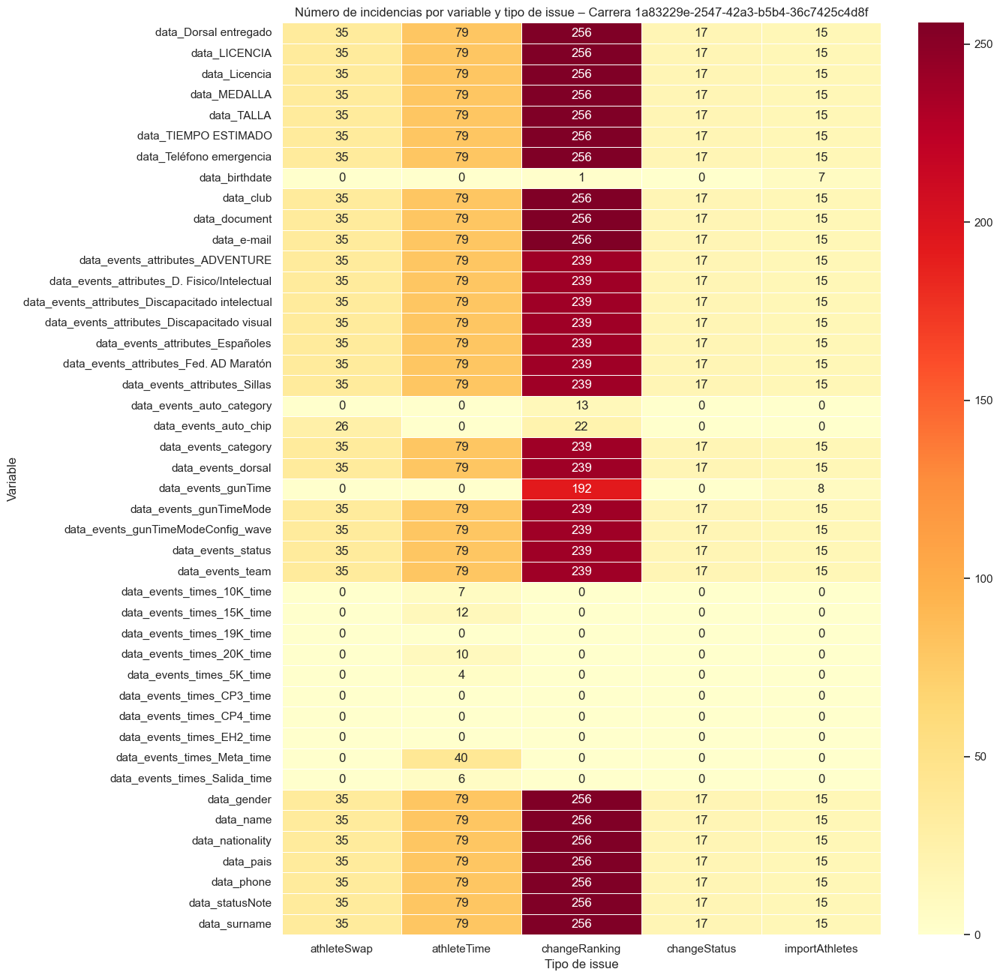

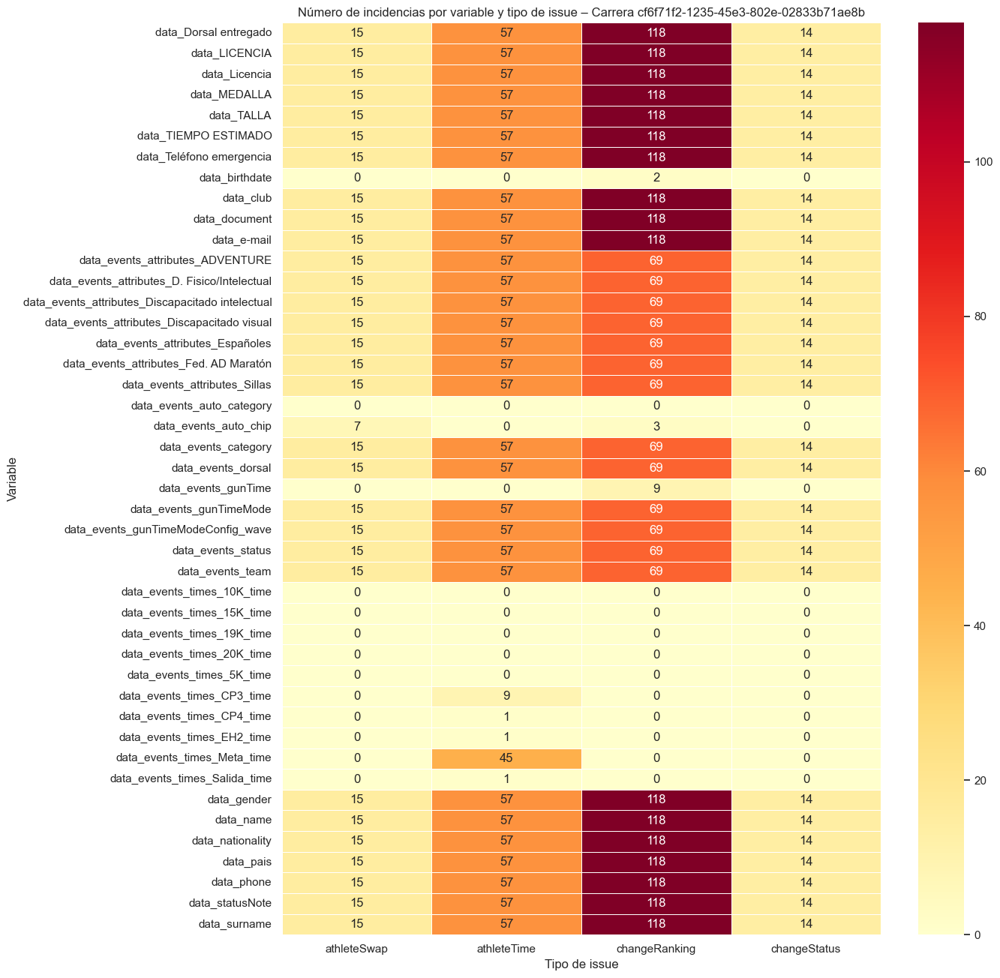

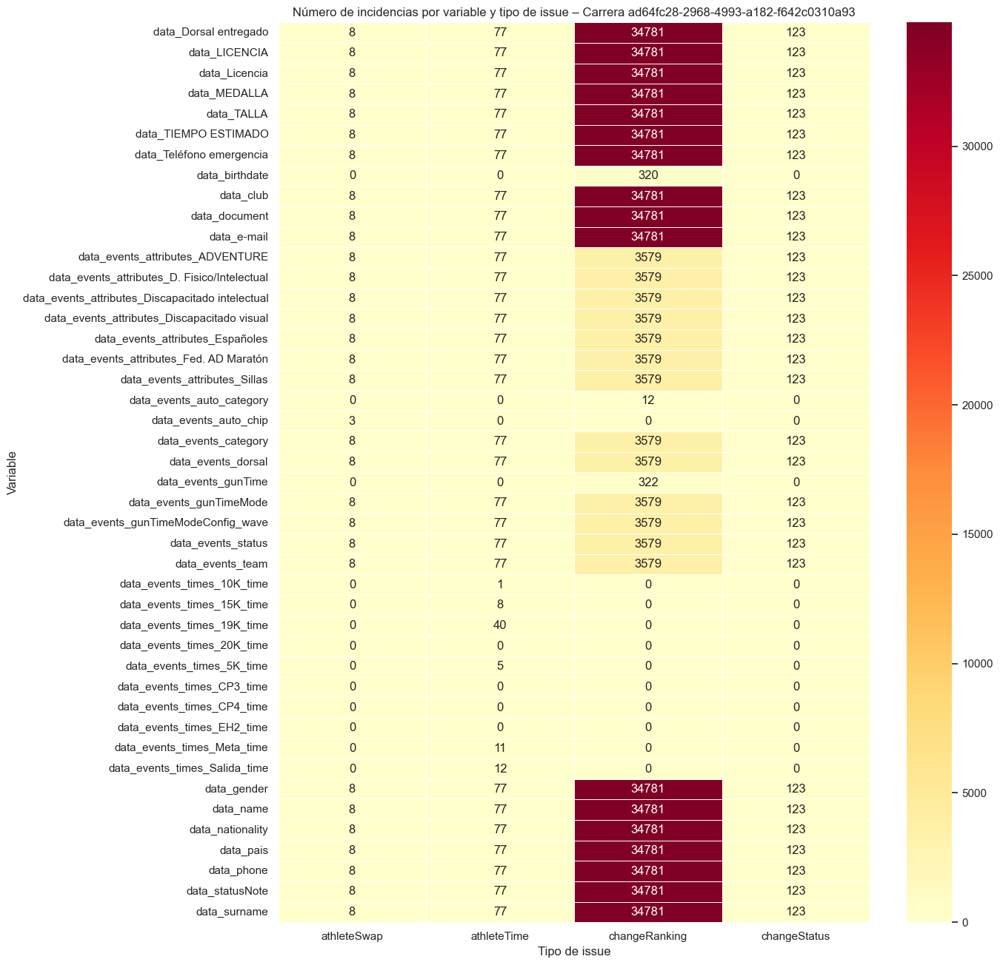

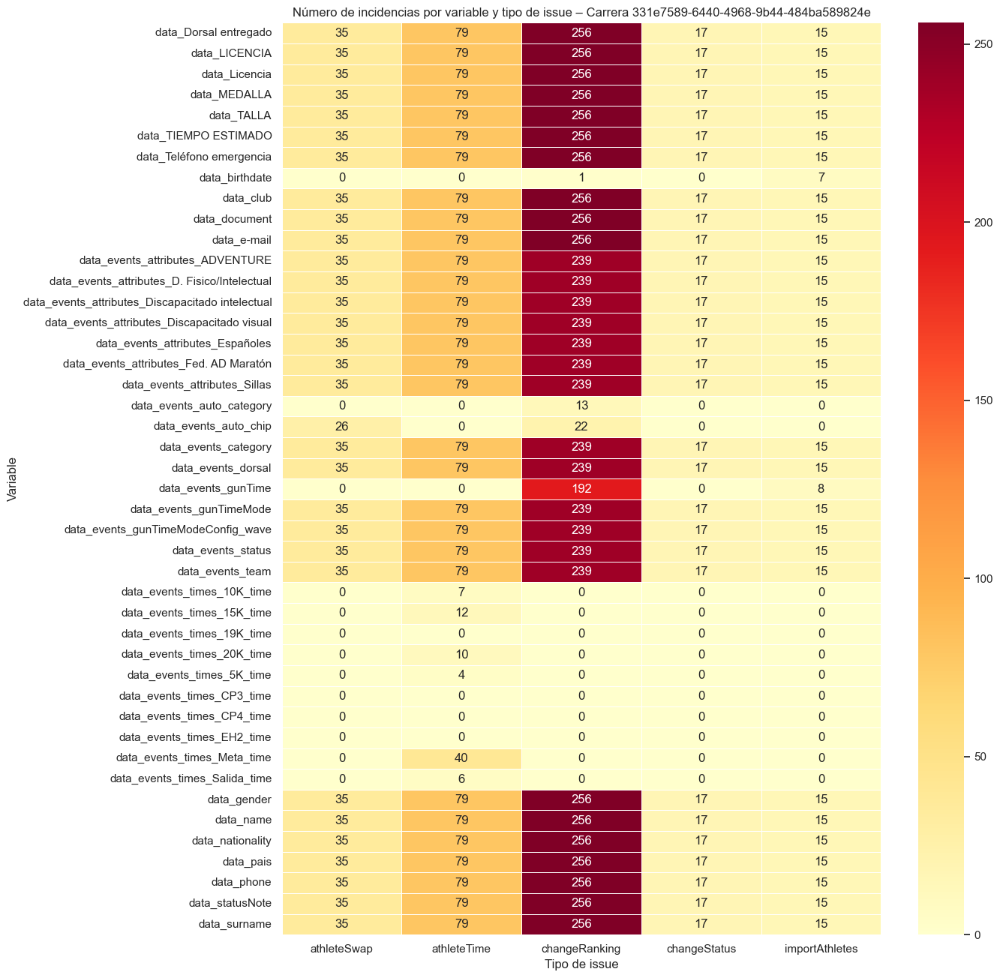

In [54]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

cols_data = [c for c in IA.columns if c.startswith('data_') or c.startswith('data_events_')]

for race in IA['race_id'].dropna().unique():
    IA_race = IA[IA['race_id'] == race]
    
    records = []
    for col in cols_data:
        summary = IA_race.groupby('type')[col].apply(lambda x: x.notna().sum())
        for issue_type, count in summary.items():
            records.append({'variable': col, 'type': issue_type, 'count': count})
    
    df_summary = pd.DataFrame(records)
    
    heatmap_data = df_summary.pivot(index='variable', columns='type', values='count').fillna(0)
    
    plt.figure(figsize=(14, max(6, len(heatmap_data)*0.3)))  
    sns.heatmap(
        heatmap_data, 
        annot=True, 
        fmt=".0f", 
        cmap="YlOrRd", 
        linewidths=0.5
    )
    plt.title(f"Número de incidencias por variable y tipo de issue – Carrera {race}")
    plt.ylabel("Variable")
    plt.xlabel("Tipo de issue")
    plt.tight_layout()
    plt.show()

- La mayoría de incidencias afectan variables como data_Dorsal entregado, data_LICENCIA, data_name, data_gender, data_nationality, data_pais, data_statusNote. También muchas incidencias afectan atributos de eventos (data_events_attributes_…). Lo que indica información mayoritariamente importada a los atletas.

- changeRanking y importAthletes son los que más incidencias registran, especialmente en carreras grandes. athleteTime y athleteSwap son relativamente menores. changeStatus suele tener valores intermedios.

- Carreras grandes tienen picos muy altos en changeRanking (hasta 34781 incidencias) → ajustes masivos de ranking.

- Algunas variables (data_birthdate, data_events_auto_chip, data_events_times_…) presentan pocas incidencias, lo que indica que solo un subconjunto de atletas se ve afectado.

- Las variables de identificación del atleta y atributos de evento son las más impactadas.

- Las incidencias menores (athleteSwap, athleteTime) afectan pocas variables y registros, pero son críticas para seguimiento individual en carrera.

- Carreras grandes muestran picos extremos en algunas incidencias, especialmente cambios de ranking masivos.

#### Dendograma de corrección de variables

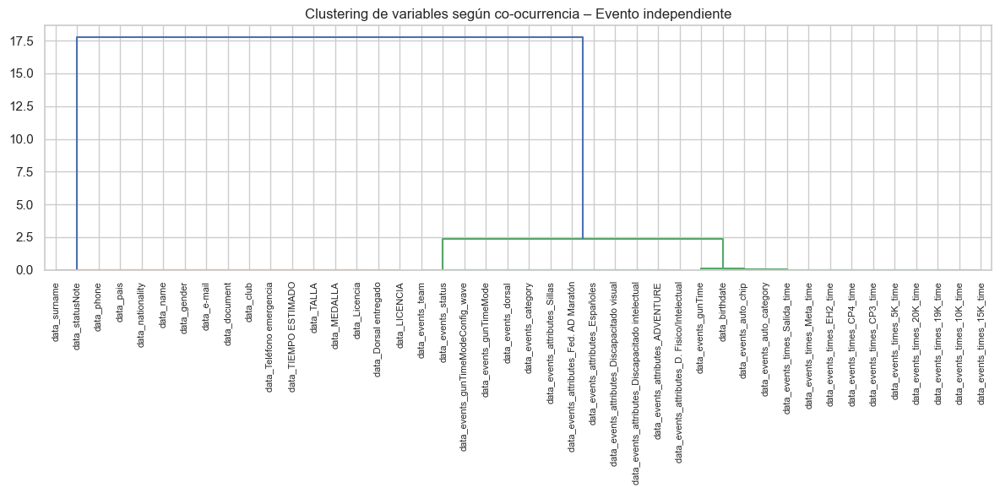

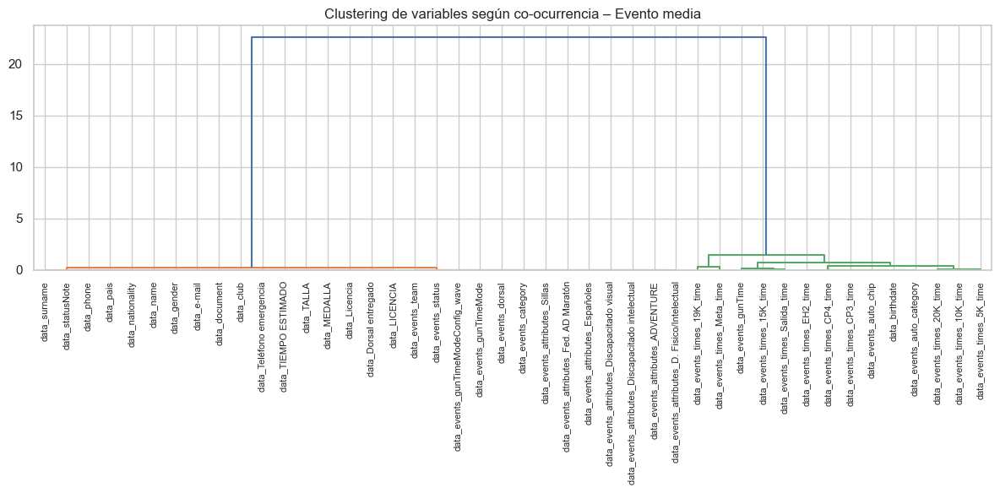

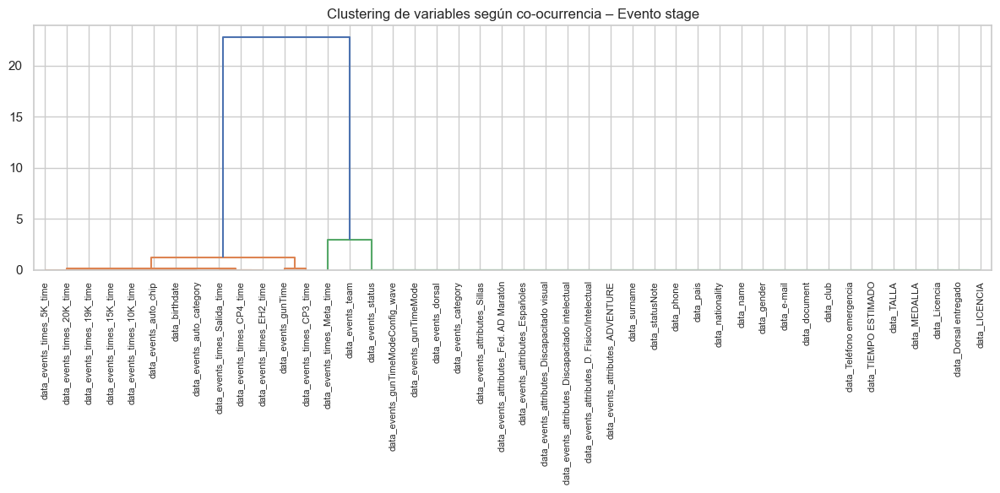

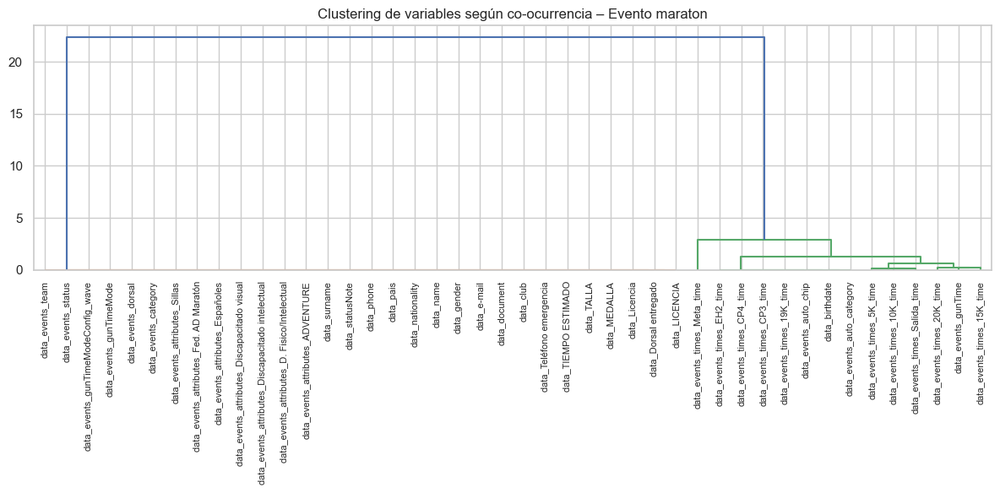

In [55]:
cols_data = [c for c in IA.columns if c.startswith('data_') or c.startswith('data_events_')]

for event in IA['event_std'].dropna().unique():

    sub = IA[IA['event_std'] == event]

    if len(sub) < 2:
        print(f"Evento {event}: muy pocos registros, se omite.")
        continue

    df_binary = sub[cols_data].notna().astype(int)

    cooccurrence = df_binary.T.dot(df_binary) / len(df_binary)

    dist_matrix = 1 - cooccurrence

    linked = linkage(dist_matrix, method='ward')

    plt.figure(figsize=(12, 6))
    dendrogram(
        linked,
        labels=cooccurrence.columns,
        leaf_rotation=90
    )
    plt.title(f"Clustering de variables según co-ocurrencia – Evento {event}")
    plt.tight_layout()
    plt.show()

Vemos que en algunas ocasiones la variable data_events_status aparce mucho conuntamente con las variables descriptivas, y otras veces con las variables de tiempo y gunTime, lo cuál nos dice que un cambio en el status se puede relacionar con ese tipo de variables y probablemente puedan ser causantes.

Las variables de tiempos y descriptivas también se cambian mucho conjuntamente, lo cuál puede indicar oleadas de cambios por algún ajuste de tiempo que afecte a todos o la importación de datops personales

In [56]:
value_cols = [c for c in IA.columns if c.startswith('data_') or c.startswith('data_events_')]

df_changes = IA.melt(
    id_vars=['issue_id', 'type', 'datetime', 'fase_temporal', 'athletes_afectados', 'num_afectados', 'event_std', 'race_id', 'event_id'],
    value_vars=value_cols,
    var_name='variable',
    value_name='valor'
)

df_changes = df_changes[df_changes['valor'].notna() & (df_changes['valor'] != "")]
df_changes['datetime'] = pd.to_datetime(df_changes['datetime'])

In [57]:
combinaciones = df_changes[['race_id', 'event_id']].drop_duplicates().reset_index(drop=True)
print(combinaciones)

                                 race_id       event_id
0   ad64fc28-2968-4993-a182-f642c0310a93  independiente
1   1a83229e-2547-42a3-b5b4-36c7425c4d8f  independiente
2   331e7589-6440-4968-9b44-484ba589824e  independiente
3   cf6f71f2-1235-45e3-802e-02833b71ae8b  independiente
4   ad64fc28-2968-4993-a182-f642c0310a93  Medio Maratón
5   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 1
6   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 2
7   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 3
8   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 4
9   cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 5
10  cf6f71f2-1235-45e3-802e-02833b71ae8b        Stage 6
11  1a83229e-2547-42a3-b5b4-36c7425c4d8f          Mitja
12  331e7589-6440-4968-9b44-484ba589824e         Marato


In [58]:
combinations_by_event = {}

for event in df_changes['event_std'].dropna().unique():

    df_event = df_changes[df_changes['event_std'] == event]
    combinations_by_event[event] = {}

    for tipo in df_event['type'].dropna().unique():

        df_tipo = df_event[df_event['type'] == tipo]
        grouped = df_tipo.groupby(['issue_id', 'datetime'])['variable'].apply(list)

        comb_counter = Counter()
        for vars_list in grouped:
            comb_counter.update(combinations(sorted(vars_list), 2))

        combinations_by_event[event][tipo] = comb_counter.most_common(10)

for event, tipos in combinations_by_event.items():
    print(f"\n==============================")
    print(f" EVENTO_STD: {event}")
    print(f"==============================")
    
    for tipo, combs in tipos.items():
        print(f"\n  ▶ Tipo de issue: {tipo}")
        print(f"  Top combinaciones de variables cambiadas:")
        for combo, count in combs:
            print(f"    {combo}: {count}")


 EVENTO_STD: independiente

  ▶ Tipo de issue: changeRanking
  Top combinaciones de variables cambiadas:
    ('data_events_gunTime', 'data_events_gunTimeModeConfig_wave'): 1026
    ('data_name', 'data_surname'): 338
    ('data_birthdate', 'data_name'): 310
    ('data_birthdate', 'data_surname'): 309
    ('data_document', 'data_name'): 291
    ('data_document', 'data_surname'): 290
    ('data_birthdate', 'data_document'): 289
    ('data_document', 'data_phone'): 233
    ('data_name', 'data_phone'): 231
    ('data_phone', 'data_surname'): 231

  ▶ Tipo de issue: importAthletes
  Top combinaciones de variables cambiadas:
    ('data_birthdate', 'data_document'): 28
    ('data_birthdate', 'data_events_gunTime'): 28
    ('data_birthdate', 'data_nationality'): 28
    ('data_document', 'data_events_gunTime'): 28
    ('data_document', 'data_nationality'): 28
    ('data_events_gunTime', 'data_nationality'): 28
    ('data_events_gunTime', 'data_events_gunTimeModeConfig_wave'): 24
    ('data_birt

- En los **independientes**, hay muchas combinaciones repetidas de variables importantes de los atletas (data_name, data_surname, data_birthdate, data_document, data_phone). La combinación más frecuente: ('data_events_gunTime', 'data_events_gunTimeModeConfig_wave') con 1026 ocurrencias. Esto indica que los cambios de ranking suelen venir acompañados de actualizaciones de tiempo de evento y su configuración. En eventos independientes (que abarcan toda la carrera), los cambios de ranking y de importación de atletas tienden a afectar múltiples datos de manera simultánea.

- En las carreras por **stage**, combinaciones de variables relacionadas con los tiempos y dorsales (data_events_dorsal, data_events_gunTime, data_events_gunTimeModeConfig_wave), aunque con menos frecuencia. Los cambios son principalmente sobre los tiempos y dorsales, reflejando ajustes parciales de etapas concretas.

- Eventos largos tipo maratón y media: los cambios suelen afectar tiempos globales y datos personales, probablemente por la cantidad masiva de atletas, lo que impacta el ranking general.

- Eventos tipo stage (con splits): los cambios afectan más los tiempos parciales y la relación entre dorsal y tiempos, probablemente porque los datos se registran en múltiples checkpoints menos espaciados.

#### Representación errores durante el tiempo

In [74]:
graficos = {} 

grupos = df_changes[['race_id', 'event_id']].drop_duplicates()

for _, row in grupos.iterrows():
    r = row['race_id']
    e = row['event_id']

    df_sub = df_changes[(df_changes['race_id'] == r) &
                        (df_changes['event_id'] == e)].copy()

    if df_sub.empty:
        continue

    total_athletes_event = (
        df_sub['athletes_afectados'].explode().nunique()
    )

    if total_athletes_event == 0:
        df_sub["pct_afectados"] = 0
    else:
        df_sub["pct_afectados"] = (
            df_sub["num_afectados"] / total_athletes_event * 100
        )

    titulo = f"Cambios de variables — Race {r} | Event {e}"

    fig = px.scatter(
        df_sub,
        x='datetime',
        y='variable',
        color='type',
        hover_data=['pct_afectados', 'num_afectados'],
        title=titulo,
        size_max=12
    )

    fig.show()

    graficos[(r, e)] = fig

In [75]:

race_ids = df_changes['race_id'].dropna().unique()

if len(race_ids) == 0:
    raise ValueError("df_changes no contiene ningún race_id válido.")

race_random = np.random.choice(race_ids)
print(f"Carrera seleccionada aleatoriamente: {race_random}")


df_race = df_changes[df_changes['race_id'] == race_random].copy()

if df_race.empty:
    raise ValueError(f"No hay datos de cambios para la carrera {race_random}")

total_athletes_race = df_race['athletes_afectados'].explode().nunique()

if total_athletes_race == 0:
    df_race['pct_afectados'] = 0
else:
    df_race['pct_afectados'] = (
        df_race['num_afectados'] / total_athletes_race * 100
    )

color_map = {
    'athleteTime': 'blue',
    'changeRanking': 'red',
    'athleteSwap': 'green',
    'importAthletes': 'orange',
    'changeStatus': 'purple',
    'other': 'brown'
}


for tipo in df_race['type'].unique():
    df_tipo = df_race[(df_race['type'] == tipo) & (df_race['pct_afectados'].notna())]

    if df_tipo.empty:
        continue  

    color = color_map.get(tipo, 'gray')

    fig = px.scatter(
        df_tipo,
        x='datetime',
        y='variable',
        color_discrete_sequence=[color],
        size_max=12,
        hover_data=['pct_afectados'],
        title=f'Race {race_random} — Cambios de variables a lo largo del tiempo — Tipo: {tipo}'
    )

    fig.update_layout(
        dragmode='zoom',
        hovermode='closest',
        yaxis={'categoryorder':'total ascending'}
    )

    fig.show(config={'scrollZoom': True, 'displayModeBar': True})

Carrera seleccionada aleatoriamente: 331e7589-6440-4968-9b44-484ba589824e


- **importAthletes**: Datos importados de atletas, normalmente pre-carrera y de información personal
- **changeRanking**: Datos de cambio de los atletas, normalmente información del ranking, que suele ser personal o de tiempos de salida y atributos. No tienen un patrón claro pero suelen aparecer mayoritariuamente antes y en la carrera.
- **athletesSwap**: Datos de cambio entre variables y atletas, posiblemente por equivocación anterior. Suelen ser cambios atómicos. 
- **change_status**: Cambio de status del atleta, también suelen ser atómicos y pueden tener correlación con otros errores o fenómenos del atleta que causen su cambio de status. 
- **athleteTime**: Cambio en el tiempo de los splits del atleta, son dados consecutivamente en tandas por cambios posiblemente en variables como gunTime. 

In [68]:
race_ids = df_changes['race_id'].dropna().unique()
race_random = np.random.choice(race_ids)
print(f"Carrera seleccionada: {race_random}")

df_race = df_changes[df_changes['race_id'] == race_random].copy()

event_ids = df_race['event_id'].dropna().unique()
event_random = np.random.choice(event_ids)
print(f"Evento seleccionado: {event_random}")

df_event = df_race[df_race['event_id'] == event_random].copy()

row_event = event_time_ranges[
    (event_time_ranges['race_id'] == race_random) &
    (event_time_ranges['event_id'] == event_random)
]

if row_event.empty:
    raise ValueError("No se encontró start/end time para esa carrera+evento")

start_time = row_event['start_time'].iloc[0]
end_time   = row_event['end_time'].iloc[0]

total_issues = len(df_event)
pct_before = (df_event['datetime'] < start_time).sum() / total_issues * 100
pct_during = ((df_event['datetime'] >= start_time) & (df_event['datetime'] <= end_time)).sum() / total_issues * 100
pct_after  = (df_event['datetime'] > end_time).sum() / total_issues * 100

print(f"Carrera {race_random}, Evento {event_random}")
print(f"Porcentaje de incidencias antes del evento: {pct_before:.2f}%")
print(f"Porcentaje de incidencias durante el evento: {pct_during:.2f}%")
print(f"Porcentaje de incidencias después del evento: {pct_after:.2f}%")

print(f"Inicio del evento: {start_time}")
print(f"Fin del evento:    {end_time}")

total_athletes_event = df_event['athletes_afectados'].explode().nunique()

df_event['pct_afectados'] = (
    df_event['num_afectados'] / total_athletes_event * 100
    if total_athletes_event > 0 else 0
)

fig = px.scatter(
    df_event,
    x="datetime",
    y="variable",
    color="type",
    hover_data=["pct_afectados"],
    title=f"Cambios de variables – Race {race_random} – Event {event_random}",
    size_max=10
)

start_time_dt = pd.to_datetime(start_time)
end_time_dt   = pd.to_datetime(end_time)

fig.add_shape(
    type="line",
    x0=start_time_dt, x1=start_time_dt,
    y0=0, y1=1,
    xref="x", yref="paper",
    line=dict(color="green", width=2, dash="dash"),
)
fig.add_shape(
    type="line",
    x0=end_time_dt, x1=end_time_dt,
    y0=0, y1=1,
    xref="x", yref="paper",
    line=dict(color="red", width=2, dash="dash"),
)

fig.update_layout(
    dragmode="zoom",
    hovermode="closest",
    yaxis={'categoryorder': 'total ascending'},
)

fig.show(config={'scrollZoom': True, 'displayModeBar': True})

Carrera seleccionada: cf6f71f2-1235-45e3-802e-02833b71ae8b
Evento seleccionado: Stage 5
Carrera cf6f71f2-1235-45e3-802e-02833b71ae8b, Evento Stage 5
Porcentaje de incidencias antes del evento: 0.00%
Porcentaje de incidencias durante el evento: 90.91%
Porcentaje de incidencias después del evento: 9.09%
Inicio del evento: 2025-05-05 07:03:17.549000
Fin del evento:    2025-05-05 14:54:05.536000


In [64]:
crosstab_list = []

for (race_id, event_id), df_sub in IA.groupby(['race_id', 'event_id']):
    # Resumen para todos los issues
    ct_all = pd.DataFrame({
        'type': ['all_issues'],  
        **df_sub['fase_temporal'].value_counts(normalize=True).to_dict()
    })
    ct_all['race_id'] = race_id
    ct_all['event_id'] = event_id
    crosstab_list.append(ct_all)

crosstab_all = pd.concat(crosstab_list, ignore_index=True)
print(crosstab_all)

          type  post-carrera  en carrera  \
0   all_issues      0.765957    0.234043   
1   all_issues      0.246753    0.506494   
2   all_issues           NaN         NaN   
3   all_issues      0.003247         NaN   
4   all_issues      0.196629    0.780899   
5   all_issues      0.000919    0.001063   
6   all_issues      0.076923    0.923077   
7   all_issues      0.222222    0.777778   
8   all_issues           NaN    1.000000   
9   all_issues      0.250000    0.750000   
10  all_issues      0.090909    0.909091   
11  all_issues      0.333333    0.666667   
12  all_issues           NaN    0.653846   

                                 race_id       event_id  pre-carrera  
0   1a83229e-2547-42a3-b5b4-36c7425c4d8f          Mitja          NaN  
1   1a83229e-2547-42a3-b5b4-36c7425c4d8f  independiente     0.246753  
2   331e7589-6440-4968-9b44-484ba589824e         Marato     1.000000  
3   331e7589-6440-4968-9b44-484ba589824e  independiente     0.996753  
4   ad64fc28-2968-4993-a182-

In [26]:
race_ids = df_changes['race_id'].dropna().unique()
race_random = np.random.choice(race_ids)
print(f"Carrera seleccionada: {race_random}")

df_race = df_changes[df_changes['race_id'] == race_random]

event_ids = df_race['event_id'].dropna().unique()
event_random = np.random.choice(event_ids)
print(f"Evento seleccionado: {event_random}")

df_event = df_race[df_race['event_id'] == event_random]

counts = df_event.groupby(['type', 'variable'])['valor'].count().unstack(fill_value=0)
counts_pct = counts.div(counts.sum(axis=1), axis=0) * 100

pd.set_option('display.max_columns', None)
print(f"\nPorcentaje de registros que afectan a cada variable\nCarrera: {race_random}, Evento: {event_random}")
print(counts_pct.round(1))

Carrera seleccionada: 1a83229e-2547-42a3-b5b4-36c7425c4d8f
Evento seleccionado: Mitja

Porcentaje de registros que afectan a cada variable
Carrera: 1a83229e-2547-42a3-b5b4-36c7425c4d8f, Evento: Mitja
variable       data_events_gunTime  data_events_status  \
type                                                     
athleteTime                    0.0                 0.0   
changeRanking                100.0                 0.0   
changeStatus                   0.0               100.0   

variable       data_events_times_10K_time  data_events_times_15K_time  \
type                                                                    
athleteTime                           8.9                        15.2   
changeRanking                         0.0                         0.0   
changeStatus                          0.0                         0.0   

variable       data_events_times_20K_time  data_events_times_5K_time  \
type                                                                   

#### Correlaciones de los issues con las variables

Anteriormente hemos obtenido algunas conclusiones en base a los tipos de error, y creemos que los errores de tipo changeranking, athleteswap e importathletes no entran en nuestro estudio por diferentes moticos (poca abstraccion y contexto e importaciones generales). Por lo que nuestro estudio se centrará en changestatus y athlete time, de las cuáles intentaremos predecir el porque un atleta cambia su estatus de carrera o modifica su tiempo en base a los datos de carrera. 

Identificar qué causas explican (o se asocian con alta probabilidad) la aparición de issues tipo:

- changeStatus — cambios de estado del atleta (p.ej. pasa a retired, DSQ, etc.)

- athleteTime — cambios de tiempos (errores o correcciones de cronometraje).

Y esas causas pueden venir de dos fuentes:

- Variables del atleta (athletes_df, athletes_events_df, …)

- Otros issues sobre el mismo atleta o variable, en momentos cercanos (correlación espacial-temporal).

In [103]:
df_changes.head()

,id,type,datetime,fase_temporal,afectados,athletes_afectados,variable,valor
79,2e616100-eec0-11ef-ba02-2d3eb2d81d1f,athleteTime,2025-02-19 12:51:05.104,post-carrera,0.000032,[19477A97],data_events_times_5K_time,1609398.0
140,5c88e2a0-ee94-11ef-9ab3-55798f1380ce,athleteTime,2025-02-19 07:37:24.682,post-carrera,0.000032,[28B12198],data_events_times_5K_time,1581000.0
336,ccb409f0-ed37-11ef-9ac5-999bc91314b6,athleteTime,2025-02-17 14:02:18.511,post-carrera,0.000032,[52674F19],data_events_times_5K_time,1499877.0
401,ff1b2cd0-edd6-11ef-b1a8-0779410a0038,athleteTime,2025-02-18 09:01:53.053,post-carrera,0.000032,[4D831Z6B],data_events_times_5K_time,1368000.0
427,11a62f30-edd7-11ef-b1a8-0779410a0038,athleteTime,2025-02-18 09:02:24.163,post-carrera,0.000032,[4D831Z6B],data_events_times_10K_time,2503000.0


Primero filtramos por issues relevantes

In [ ]:
df_filtrado = df_changes[df_changes['type'].isin(['changeStatus', 'athleteTime'])].copy()

df_filtrado['datetime'] = pd.to_datetime(df_filtrado['datetime'])

print("Tipos de issue incluidos:", df_filtrado['type'].unique())
print("Filas seleccionadas:", len(df_filtrado))
df_filtrado.head()

Tipos de issue incluidos: ['athleteTime' 'changeStatus']
Filas seleccionadas: 96


,id,type,datetime,fase_temporal,afectados,athletes_afectados,variable,valor
79,2e616100-eec0-11ef-ba02-2d3eb2d81d1f,athleteTime,2025-02-19 12:51:05.104,post-carrera,0.000032,[19477A97],data_events_times_5K_time,1609398.0
140,5c88e2a0-ee94-11ef-9ab3-55798f1380ce,athleteTime,2025-02-19 07:37:24.682,post-carrera,0.000032,[28B12198],data_events_times_5K_time,1581000.0
336,ccb409f0-ed37-11ef-9ac5-999bc91314b6,athleteTime,2025-02-17 14:02:18.511,post-carrera,0.000032,[52674F19],data_events_times_5K_time,1499877.0
401,ff1b2cd0-edd6-11ef-b1a8-0779410a0038,athleteTime,2025-02-18 09:01:53.053,post-carrera,0.000032,[4D831Z6B],data_events_times_5K_time,1368000.0
427,11a62f30-edd7-11ef-b1a8-0779410a0038,athleteTime,2025-02-18 09:02:24.163,post-carrera,0.000032,[4D831Z6B],data_events_times_10K_time,2503000.0


In [ ]:
df_exploded = (
    df_filtrado
    .explode('athletes_afectados')
    .rename(columns={'athletes_afectados': 'athlete_id'})
)

df_exploded['athlete_id'] = df_exploded['athlete_id'].astype(str).str.strip()

print("Filas después de expandir:", len(df_exploded))
print("Ejemplo de athlete_id:", df_exploded['athlete_id'].unique()[:10])
df_exploded.head()

Filas después de expandir: 761
Ejemplo de athlete_id: ['19477A97' '28B12198' '52674F19' '4D831Z6B' 'D43Y2162' 'ZC3F3D71'
 'B4AC91Z4' '6F2A8Y61' 'A1Z3B616' 'BD2YBD42']


,id,type,datetime,fase_temporal,afectados,athlete_id,variable,valor
79,2e616100-eec0-11ef-ba02-2d3eb2d81d1f,athleteTime,2025-02-19 12:51:05.104,post-carrera,0.000032,19477A97,data_events_times_5K_time,1609398.0
140,5c88e2a0-ee94-11ef-9ab3-55798f1380ce,athleteTime,2025-02-19 07:37:24.682,post-carrera,0.000032,28B12198,data_events_times_5K_time,1581000.0
336,ccb409f0-ed37-11ef-9ac5-999bc91314b6,athleteTime,2025-02-17 14:02:18.511,post-carrera,0.000032,52674F19,data_events_times_5K_time,1499877.0
401,ff1b2cd0-edd6-11ef-b1a8-0779410a0038,athleteTime,2025-02-18 09:01:53.053,post-carrera,0.000032,4D831Z6B,data_events_times_5K_time,1368000.0
427,11a62f30-edd7-11ef-b1a8-0779410a0038,athleteTime,2025-02-18 09:02:24.163,post-carrera,0.000032,4D831Z6B,data_events_times_10K_time,2503000.0


In [ ]:
df_status = df_exploded[
    (df_exploded['type'] == 'changeStatus') &
    (df_exploded['fase_temporal'].str.lower().str.contains('post'))
].copy()

print(f"Total de changeStatus post-carrera: {len(df_status)}")
print("Tipos de estado detectados:")
print(df_status['valor'].value_counts())

Total de changeStatus post-carrera: 636
Tipos de estado detectados:
valor
retired         434
disqualified    200
quarantine        2
Name: count, dtype: int64


In [ ]:
status_types = df_status['valor'].unique()

status_dict = {
    s: set(df_status.loc[df_status['valor'] == s, 'athlete_id'])
    for s in status_types
}

for s in status_types:
    col_name = f'has_status_{s}'
    athletes_events_df[col_name] = athletes_events_df['athlete_id'].isin(status_dict[s]).astype(int)

for s in status_types:
    col_name = f'has_status_{s}'
    athletes_time_df[col_name] = athletes_time_df['athlete_id'].isin(status_dict[s]).astype(int)

for s in status_types:
    col_name = f'has_status_{s}'
    athletes_df[col_name] = athletes_df['athlete_id'].isin(status_dict[s]).astype(int)

In [94]:
athletes_df.columns

Index(['Licencia', 'TIEMPO ESTIMADO', 'athlete_id', 'birthdate', 'club',
       'color', 'featured', 'fullName', 'gender', 'id', 'importId', 'name',
       'nationality', 'race_id', 'statusNote', 'surname', 'user_id',
       'club_clean', 'nationality_clean', 'has_status_disqualified',
       'has_status_retired', 'has_status_quarantine'],
      dtype='object')

In [ ]:
race_date = pd.Timestamp('2025-02-16')

athletes_df['age'] = (race_date - athletes_df['birthdate']).dt.days // 365

bins = [0, 25, 35, 45, 100]  
labels = ['<25', '25-34', '35-44', '45+']

athletes_df['age_group'] = pd.cut(athletes_df['age'], bins=bins, labels=labels, right=False)

athletes_df[['age', 'age_group']].head(10)

athletes_df['age_group'] = athletes_df['age_group'].astype('category')

In [113]:
print(athletes_df['age_group'].dtype)

category


In [75]:
athletes_df.columns

Index(['Licencia', 'TIEMPO ESTIMADO', 'athlete_id', 'birthdate', 'club',
       'color', 'featured', 'fullName', 'gender', 'id', 'importId', 'name',
       'nationality', 'race_id', 'statusNote', 'surname', 'user_id',
       'has_status_disqualified', 'has_status_retired',
       'has_status_quarantine', 'age', 'age_group'],
      dtype='object')

In [79]:
athletes_df['has_status_retired'].value_counts()

has_status_retired
0    31249
1      434
Name: count, dtype: int64

In [ ]:
def cramers_v(confusion_matrix):
    """Calcula V de Cramer para tablas de contingencia"""
    chi2, _, _, _ = chi2_contingency(confusion_matrix)
    n = confusion_matrix.sum().sum()
    k = min(confusion_matrix.shape) - 1
    return np.sqrt(chi2 / (n * k))

def analyze_dataframe(df, dummy_cols, max_categories=20):
    """
    Analiza un DataFrame comparando variables categóricas, numéricas y timedelta frente a dummies.
    Incluye:
      - Chi² y Fisher (para categóricas)
      - t-test y Mann-Whitney (para numéricas)
      - Regresión logística balanceada (odds ratio)
    """
    results = {'categorical': [], 'numerical': []}

    numeric_cols = df.select_dtypes(include=[np.number, 'timedelta']).columns.difference(dummy_cols)
    categorical_cols = df.select_dtypes(include=['object', 'category']).columns

    for cat_col in categorical_cols:
        n_categories = df[cat_col].nunique()
        if n_categories > max_categories:
            continue

        for dummy in dummy_cols:
            try:
                table = pd.crosstab(df[cat_col], df[dummy])

                if table.shape[0] > 1 and table.shape[1] > 1:
                    chi2, p_chi2, _, _ = chi2_contingency(table)
                    v = cramers_v(table)

                    p_fisher = np.nan
                    if table.shape == (2, 2):
                        _, p_fisher = fisher_exact(table)

                    results['categorical'].append({
                        'categorical_var': cat_col,
                        'dummy': dummy,
                        'chi2': chi2,
                        'p_chi2': p_chi2,
                        'p_fisher': p_fisher,
                        'cramers_v': v
                    })
            except Exception as e:
                print(f"Error en {cat_col} vs {dummy}: {e}")
                continue

    for num_col in numeric_cols:
        for dummy in dummy_cols:
            col_data = df[num_col]

            if np.issubdtype(col_data.dtype, np.timedelta64):
                col_data = col_data.dt.total_seconds()

            group0 = col_data[df[dummy] == 0].dropna()
            group1 = col_data[df[dummy] == 1].dropna()

            if len(group0) == 0 or len(group1) == 0:
                continue

            try:
                t_stat, t_p = ttest_ind(group0, group1, nan_policy='omit')

                u_stat, u_p = mannwhitneyu(group0, group1, alternative='two-sided')

                valid_idx = df[[num_col, dummy]].dropna().index
                X = df.loc[valid_idx, [num_col]].astype(float)
                y = df.loc[valid_idx, dummy].astype(int)

                logit = LogisticRegression(class_weight='balanced', solver='liblinear')
                logit.fit(X, y)

                coef = logit.coef_[0][0]
                odds_ratio = np.exp(coef)

                results['numerical'].append({
                    'numeric_var': num_col,
                    'dummy': dummy,
                    't_stat': t_stat,
                    't_pvalue': t_p,
                    'mannwhitney_u': u_stat,
                    'mannwhitney_pvalue': u_p,
                    'logit_coef': coef,
                    'odds_ratio': odds_ratio
                })

            except Exception as e:
                print(f"Error en {num_col} vs {dummy}: {e}")
                continue

    return results


dummy_cols = ['has_status_retired', 'has_status_disqualified']

analysis_results = analyze_dataframe(athletes_df, dummy_cols, max_categories=20)

cat_results_df = pd.DataFrame(analysis_results['categorical'])
num_results_df = pd.DataFrame(analysis_results['numerical'])

print("=== Resultados categóricos ===")
print(cat_results_df)

print("\n=== Resultados numéricos (con regresión logística balanceada) ===")
print(num_results_df)

=== Resultados categóricos ===
    categorical_var                    dummy          chi2        p_chi2  \
0   TIEMPO ESTIMADO       has_status_retired    223.364116  4.759258e-41   
1   TIEMPO ESTIMADO  has_status_disqualified     18.285532  1.072918e-01   
2             color       has_status_retired      9.977400  3.523180e-01   
3             color  has_status_disqualified     10.174898  3.365128e-01   
4            gender       has_status_retired      0.669888  7.153781e-01   
5            gender  has_status_disqualified      2.842526  2.414090e-01   
6          importId       has_status_retired    345.806557  1.581937e-64   
7          importId  has_status_disqualified     12.067927  6.738803e-01   
8        statusNote       has_status_retired      1.840983  1.748357e-01   
9        statusNote  has_status_disqualified  30726.815447  0.000000e+00   
10        age_group       has_status_retired      1.658274  6.462499e-01   
11        age_group  has_status_disqualified     54.23330

In [ ]:
dummy_cols = ['has_status_quarantine', 'has_status_retired', 'has_status_disqualified']
analysis_results = analyze_dataframe(athletes_events_df, dummy_cols, max_categories=20)

cat_results_df = pd.DataFrame(analysis_results['categorical'])
num_results_df = pd.DataFrame(analysis_results['numerical'])

print("Categorical results:")
print(cat_results_df)

print("\nNumerical results:")
print(num_results_df)

Error en leader_time_td vs has_status_quarantine: Cannot cast TimedeltaArray to dtype float64
Error en leader_time_td vs has_status_retired: Cannot cast TimedeltaArray to dtype float64
Error en leader_time_td vs has_status_disqualified: Cannot cast TimedeltaArray to dtype float64
Error en startNetTime_td vs has_status_retired: Cannot cast TimedeltaArray to dtype float64
Error en startNetTime_td vs has_status_disqualified: Cannot cast TimedeltaArray to dtype float64
Error en startTime_td vs has_status_retired: Cannot cast TimedeltaArray to dtype float64
Error en startTime_td vs has_status_disqualified: Cannot cast TimedeltaArray to dtype float64
Categorical results:
                         categorical_var                    dummy  \
0   attributes_Discapacitado intelectual    has_status_quarantine   
1   attributes_Discapacitado intelectual       has_status_retired   
2   attributes_Discapacitado intelectual  has_status_disqualified   
3        attributes_Discapacitado visual    has_st

In [ ]:
dummy_cols = ['has_status_quarantine', 'has_status_retired', 'has_status_disqualified']
analysis_results = analyze_dataframe(athletes_time_df, dummy_cols, max_categories=20)

cat_results_df = pd.DataFrame(analysis_results['categorical'])
num_results_df = pd.DataFrame(analysis_results['numerical'])

print("Categorical results:")
print(cat_results_df)

print("\nNumerical results:")
print(num_results_df)

Error en netTime_td vs has_status_quarantine: Cannot cast TimedeltaArray to dtype float64
Error en netTime_td vs has_status_retired: Cannot cast TimedeltaArray to dtype float64
Error en netTime_td vs has_status_disqualified: Cannot cast TimedeltaArray to dtype float64
Error en offset_td vs has_status_retired: Cannot cast TimedeltaArray to dtype float64
Error en offset_td vs has_status_disqualified: Cannot cast TimedeltaArray to dtype float64
Error en originalTime_td vs has_status_quarantine: Cannot cast TimedeltaArray to dtype float64
Error en originalTime_td vs has_status_disqualified: Cannot cast TimedeltaArray to dtype float64
Error en raw_backupOffset_td vs has_status_retired: Cannot cast TimedeltaArray to dtype float64
Error en raw_backupOffset_td vs has_status_disqualified: Cannot cast TimedeltaArray to dtype float64
Error en raw_times_official_td vs has_status_quarantine: Cannot cast TimedeltaArray to dtype float64
Error en raw_times_official_td vs has_status_retired: Cannot cas

**Retired**: average, netTime, order, splitsMissing,
**Disqualified**: age, issuesCount_data, splitsMissing, statusNote. 

In [ ]:
df_splits = athletes_events_df[['athlete_id', 'splitsMissing', 'has_status_disqualified']]

merged = df_splits.merge(df_status, on='athlete_id', how='left')
disqualified = merged[merged['has_status_disqualified'] == 1]

count_by_missing_splits = disqualified['splitsMissing'].value_counts().sort_index()

proportion_by_missing_splits = (count_by_missing_splits / count_by_missing_splits.sum()) * 100

print("Conteo de atletas descalificados por número de splits faltantes:")
print(count_by_missing_splits)

print("\nProporción (%):")
print(proportion_by_missing_splits.round(2))

Conteo de atletas descalificados por número de splits faltantes:
splitsMissing
0     2
2    79
3    58
4    37
5    26
Name: count, dtype: int64

Proporción (%):
splitsMissing
0     0.99
2    39.11
3    28.71
4    18.32
5    12.87
Name: count, dtype: float64


#### Change status: correlacion temporal

Posible modelo de hawkess

In [ ]:
df = df_changes.copy()
df['datetime'] = pd.to_datetime(df['datetime'])
df = df.sort_values('datetime')
df['type'] = df['type'].astype(str)

print("Rango temporal:", df['datetime'].min(), "→", df['datetime'].max())
print("\nNúmero de eventos por tipo:\n", df['type'].value_counts())

Rango temporal: 2025-02-11 08:57:51.349000 → 2025-04-23 07:48:44.243000

Número de eventos por tipo:
 type
changeRanking     452
athleteTime        79
importAthletes     45
athleteSwap        30
changeStatus       17
Name: count, dtype: int64


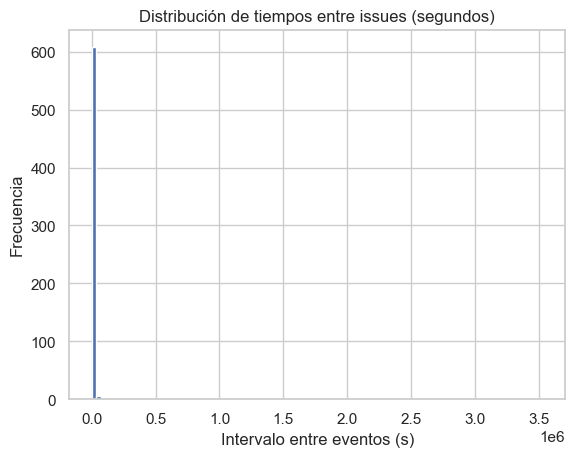

Media: 9855.71 segundos
Desviación estándar: 145613.42
Coeficiente de variación (CV): 14.77


In [ ]:
df_sorted = df.sort_values('datetime')
dt = df_sorted['datetime'].diff().dt.total_seconds().dropna()

plt.hist(dt, bins=100)
plt.title('Distribución de tiempos entre issues (segundos)')
plt.xlabel('Intervalo entre eventos (s)')
plt.ylabel('Frecuencia')
plt.show()

print("Media:", round(dt.mean(), 2), "segundos")
print("Desviación estándar:", round(dt.std(), 2))
print("Coeficiente de variación (CV):", round(dt.std()/dt.mean(), 2))

In [ ]:
def proportion_preceded(df, type_a, type_b, window_s=300):
    """
    Devuelve la proporción de eventos de tipo B que tienen al menos un A
    en los window_s segundos anteriores.
    """
    t0 = df['datetime'].min()
    df['t'] = (df['datetime'] - t0).dt.total_seconds()

    A_times = df.loc[df['type'] == type_a, 't'].values
    B_times = df.loc[df['type'] == type_b, 't'].values

    count_preceded = 0
    for tb in B_times:
        if np.any((A_times < tb) & (A_times > tb - window_s)):
            count_preceded += 1

    return count_preceded / len(B_times) if len(B_times) > 0 else np.nan

In [109]:
types = ['changeRanking', 'athleteTime', 'importAthletes', 'athleteSwap']

for t in types:
    prop = proportion_preceded(df_changes, t, 'changeStatus', window_s=300)
    print(f"{t} → changeStatus: {prop:.2%}")

changeRanking → changeStatus: 29.41%
athleteTime → changeStatus: 11.76%
importAthletes → changeStatus: 0.00%
athleteSwap → changeStatus: 0.00%


In [ ]:
window_s = 300  
target_type = 'changeStatus'
reference_types = ['changeRanking', 'athleteTime', 'importAthletes', 'athleteSwap']

df_changes = df_changes.sort_values('datetime').reset_index(drop=True)
target_events = df_changes[df_changes['type'] == target_type].copy()
target_events['status_value'] = target_events['valor'].astype(str).str.lower()

results = []

for status in ['disqualified']:
    targets = target_events[target_events['status_value'].str.contains(status, na=False)]
    
    for ref_type in reference_types:
        ref_events = df_changes[df_changes['type'] == ref_type]
        
        for _, target in targets.iterrows():
            nearby = ref_events[
                (ref_events['datetime'] <= target['datetime']) &
                (ref_events['datetime'] >= target['datetime'] - pd.Timedelta(seconds=window_s))
            ]
            for _, nb in nearby.iterrows():
                results.append({
                    'status': status,
                    'changeStatus_id': target['id'],
                    'preceding_type': ref_type,
                    'preceding_variable': nb['variable'],
                    'preceding_valor': nb['valor'],
                    'time_diff_s': (target['datetime'] - nb['datetime']).total_seconds()
                })

df_prox = pd.DataFrame(results)

summary_vars = (
    df_prox.groupby(['status', 'preceding_type', 'preceding_variable'])
    .size()
    .reset_index(name='count')
)

summary_time = (
    df_prox.groupby(['status', 'preceding_type', 'preceding_variable'])['time_diff_s']
    .mean()
    .reset_index(name='avg_seconds_before')
)

summary = (
    summary_vars.merge(summary_time, on=['status', 'preceding_type', 'preceding_variable'])
    .sort_values(['status', 'avg_seconds_before', 'count'], ascending=[True, True, False])
    .reset_index(drop=True)
)

print("=== Variables precedentes antes de cada tipo de changeStatus (ordenadas) ===")
print(summary.head(30))

numeric_subset = df_prox[
    pd.to_numeric(df_prox['preceding_valor'], errors='coerce').notnull()
].copy()
numeric_subset['preceding_valor'] = numeric_subset['preceding_valor'].astype(float)

mean_values = (
    numeric_subset.groupby(['status', 'preceding_variable'])['preceding_valor']
    .mean()
    .reset_index()
    .sort_values(['status', 'preceding_valor'], ascending=[True, False])
)

print("\n=== Valores promedio de variables que preceden a cada tipo de changeStatus ===")
print(mean_values.head(20))

=== Variables precedentes antes de cada tipo de changeStatus (ordenadas) ===
         status preceding_type                  preceding_variable  count  \
0  disqualified  changeRanking           data_events_auto_category      1   
1  disqualified  changeRanking                     data_statusNote      1   
2  disqualified    athleteTime          data_events_times_20K_time      1   
3  disqualified    athleteTime          data_events_times_15K_time      1   
4  disqualified  changeRanking                 data_events_gunTime      2   
5  disqualified  changeRanking  data_events_gunTimeModeConfig_wave      2   
6  disqualified  changeRanking                        data_surname      1   
7  disqualified  changeRanking               data_events_auto_chip      1   

   avg_seconds_before  
0              6.1950  
1              6.1950  
2             99.5930  
3            111.0310  
4            112.4925  
5            112.4925  
6            122.2960  
7            181.5730  

=== Valores 